# Import

In [1]:
# Standard operational package imports.
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats

from sklearn.preprocessing import LabelEncoder

import math

import statsmodels.formula.api as smf

import pylab

from scipy.stats import spearmanr
from scipy.stats import mannwhitneyu
from scipy.stats import kruskal
from statsmodels.sandbox.stats.multicomp import multipletests

## Load the dataset

**Dataframe used in this lab**

* df_original: original dataset read from csv file, renamed columns
* df_trans: copied from df_original, created new features
* data_cat: copied from df_trans, transformed some columns into categorical type, log transformed delay time

In [2]:
pd.set_option('display.max_columns', None)
#set maximum width in characters of a column
pd.set_option('display.max_colwidth', 150)

input_file_path='/kaggle/input/airline-csv/'

import warnings
warnings.filterwarnings('ignore')

In [3]:
# Dataset from Google Advanced Data Analytics Certificate by Coursera
df_original = pd.read_csv(input_file_path+"Invistico_Airline.csv")

## Output the first 10 rows

Output the first 10 rows of data.

In [4]:
df_original.head(10)

,satisfaction,Customer Type,Age,Type of Travel,Class,Flight Distance,Seat comfort,Departure/Arrival time convenient,Food and drink,Gate location,Inflight wifi service,Inflight entertainment,Online support,Ease of Online booking,On-board service,Leg room service,Baggage handling,Checkin service,Cleanliness,Online boarding,Departure Delay in Minutes,Arrival Delay in Minutes
0,satisfied,Loyal Customer,65,Personal Travel,Eco,265,0,0,0,2,2,4,2,3,3,0,3,5,3,2,0,0.0
1,satisfied,Loyal Customer,47,Personal Travel,Business,2464,0,0,0,3,0,2,2,3,4,4,4,2,3,2,310,305.0
2,satisfied,Loyal Customer,15,Personal Travel,Eco,2138,0,0,0,3,2,0,2,2,3,3,4,4,4,2,0,0.0
3,satisfied,Loyal Customer,60,Personal Travel,Eco,623,0,0,0,3,3,4,3,1,1,0,1,4,1,3,0,0.0
4,satisfied,Loyal Customer,70,Personal Travel,Eco,354,0,0,0,3,4,3,4,2,2,0,2,4,2,5,0,0.0
5,satisfied,Loyal Customer,30,Personal Travel,Eco,1894,0,0,0,3,2,0,2,2,5,4,5,5,4,2,0,0.0
6,satisfied,Loyal Customer,66,Personal Travel,Eco,227,0,0,0,3,2,5,5,5,5,0,5,5,5,3,17,15.0
7,satisfied,Loyal Customer,10,Personal Travel,Eco,1812,0,0,0,3,2,0,2,2,3,3,4,5,4,2,0,0.0
8,satisfied,Loyal Customer,56,Personal Travel,Business,73,0,0,0,3,5,3,5,4,4,0,1,5,4,4,0,0.0
9,satisfied,Loyal Customer,22,Personal Travel,Eco,1556,0,0,0,3,2,0,2,2,2,4,5,3,4,2,30,26.0


## Familiar with variables

**Info of Class**

Reference:
* [ANA booking](https://www.ana.co.jp/en/us/plan-book/how-to-manage-your-booking/branded-fare/)
* [ANA class](https://www.ana.co.jp/en/us/the-ana-experience/flight_service/)
* [ANA](https://www.ana.co.jp/en/us/the-ana-experience/business-class/)
* [qatarairways Class](https://www.qatarairways.com/en/onboard.html)

Class Related to:
* Free Baggage Allowance
* Advance Seat Reservation
* Seats
* Dining/Drinks
* Lounge
* Wi-Fi
* Entertainment
* In-Flight Duty-Free Shopping
* Amenities
* check-in
* Priority Baggage
* Fast Track Security
* Priority Boarding
* Disembarking

Some rating items might associated with Class

**Rating**
* 0 meaning “not at all satisfied” and 5 meaning “very satisfied.”


**Info of flight distance(Unit unkonwn)**

Reference:
* [WIKI](https://en.wikipedia.org/wiki/Flight_length#:~:text=Wragg%20classifies%20air%20services%20as,long%2Dhaul%20as%20the%20opposite.)
* [What is considered a short-Haul, medium-Haul and long-haul flight?](https://www.pointhacks.com.au/differences-short-medium-long-haul-flights/#:~:text=Short%2Dhaul%20(%3C3%20hours,%2Dlong%2Dhaul%20(12+))
* [Long-Haul Flight](https://www.globeair.com/g/long-haul-flight#:~:text=Long%2Dhaul%20flights%20refer%20to,with%20international%20or%20intercontinental%20flights.)
* [Inflight dining menu](https://www.united.com/en/us/fly/travel/inflight/dining-menu.html)

related to:
* compensation amount(when delay)
* Airplane size/type (longer distance wider plane)
* Delay
* flight time 
* direct(non-stop) or not
* time schedule (longer distance less/limited than short)
* usage (long-haul combines country or continent, international flight(language support and so on))
* passenger health care
* MileagePlus miles
* Food (some short trip only provide snack)

|Distance|Food|Description|
|:-|:-|:-|
|All|[Free Non-alcoholic drinks](https://www.united.com/en/us/fly/travel/inflight/dining-menu.html)||
|> 300 miles|[Alcoholic drinks](https://www.united.com/en/us/fly/travel/inflight/dining-menu.html)|Drinks are available to buy all day on flights over 300 miles within the U.S., Canada, Latin America, and the Caribbean.|
|> 300 miles|[Free snacks](https://www.united.com/en/us/fly/travel/inflight/dining-menu.html)|Free snacks are available for United Economy® travelers on flights over 300 miles.|
|> 500 miles|[Snacks](https://www.united.com/en/us/fly/travel/inflight/dining-menu.html)|Available to buy all day on select flights over 500 miles within the U.S., Canada, Latin America, and the Caribbean.|
|> 1,190 miles|[Bistro](https://www.united.com/en/us/fly/travel/inflight/dining-menu.html)|On longer U.S. flights, we offer our fresh Bistro on Board menu. Both hot and cold meals are available for purchase on flights over 1,190 miles.<BR/>Bistro on board is also available on select flights over 1,190 miles from Canada to the U.S.<BR/>Bistro on board is also available on select flights over 1,190 miles from Latin America and the Caribbean to the U.S., excluding long-haul routes with free meal service in Economy class.|
|> 2,000 miles|[Special meal](https://www.united.com/en/us/fly/travel/inflight/special-meals.html)| Not all special meal options are available for international long-haul flights.|

* On international flights(	Flights to or from Asia, Europe, the Middle East, the South Pacific and select destinations in Latin America.), free bread, salad, a main entree and dessert are available.

It seems no international standard definition of flight distance

* short-haul: <3 hours
* medium-haul: 3-6 hours
* long-haul: 6-12 hours
* ultra-long-haul: >12 hours

* short-haul: <700 miles
* medium-haul: 700-3000 miles
* long-Haul: >3000 miles

**Info of Delay**

Reference:
* [wiki](https://en.wikipedia.org/wiki/Flight_cancellation_and_delay#:~:text=A%20flight%20delay%20occurs%20when,all%20for%20a%20certain%20reason)
* [Flight Delay Compensation Claims EU](https://www.bottonline.co.uk/flight-delay-compensation)
* [Flight Delays and Cancellations Canada](https://otc-cta.gc.ca/eng/publication/flight-delays-and-cancellations-a-guide)
* [Percent of Flight Delay by Delay Cause 2010-2022](https://www.bts.gov/browse-statistical-products-and-data/info-gallery/percent-flight-delay-delay-cause-2010-2022)
* [Understanding the Reporting of Causes of Flight Delays and Cancellations](https://www.bts.gov/topics/airlines-and-airports/understanding-reporting-causes-flight-delays-and-cancellations)
* [Air Traffic Control System Command Center](https://www.fly.faa.gov/flyfaa/usmap.jsp?legacy=true)
    * 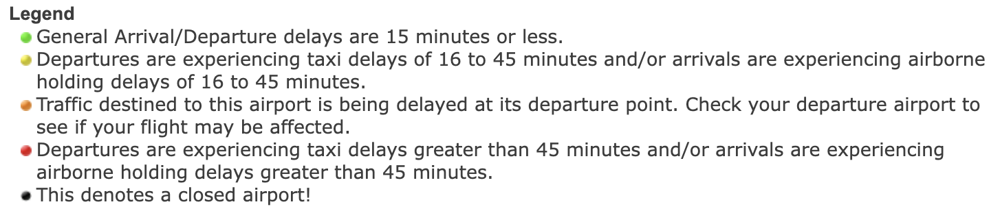
* [Types_of_Delay](https://aspm.faa.gov/aspmhelp/index/Types_of_Delay.html)
* [classification of flight delay](https://www.researchgate.net/figure/Classification-of-flight-delays_tbl1_367205996)


Delay time related to:
* [A flight is counted as "on time" if it operated less than 15 minutes later than the scheduled time shown in the carriers' Computerized Reservations Systems (CRS). ](https://www.bts.gov/explore-topics-and-geography/topics/airline-time-performance-and-causes-flight-delays#:~:text=from%20U.S.%20airports.-,How%20are%20flight%20delays%20calculated?,on%20departure%20from%20the%20gate.)
* care and assistance from the airline (Over 1 hour, based on country)
* food and drinks (Over 2 hours, based on country)
* compensation (Over around 3-4 hours, based on country)
* alternative flight to your destination (Over around 4 hours, based on country)
* offer hotel or other comparable accommodation (Overnight)

[Delay Type](https://aspm.faa.gov/aspmhelp/index/Types_of_Delay.html):
* Carrier Delay
* Late Arrival Delay
* NAS Delay
* Security Delay
* Weather Delay
* OPSNET Delay Cause


**Info of Age**
* [Passengers traveling with infants or small children (International Flights)](https://www.ana.co.jp/en/jp/guide/reservation/support/international/family/)
* [Elderly passengers (International Flights)](https://www.ana.co.jp/en/jp/guide/reservation/support/international/senior/#:~:text=Support%20(International%20Flights)-,Note%20to%20passengers%20using%20a%20wheelchair,minutes%20prior%20to%20your%20departure.)
* [Age limit/restrictions for elderly travellers](https://www.tripadvisor.com/ShowTopic-g1-i10702-k9898217-o10-Age_limit_restrictions_for_elderly_travellers-Air_Travel.html)
* [Special regulations for the elderly when flying: Did you know?](https://www.vietjetair.com/en/pages/special-regulations-for-the-elderly-when-flying-did-you-know-1711510174274)
* [qatarairways Child](https://www.qatarairways.com/en/family/child-fares-baggage.html)
* [Travelling with animals and birds](https://www.qatarairways.com/en/baggage/animals.html)
* [Ageing passenger perceptions of ground access journeys to airports: A survey of UK residents](https://www.sciencedirect.com/science/article/pii/S0969699722001570)
* [A Guide to Airline Age Policies](https://www.touramerica.ie/a-guide-to-airline-age-policies/)
* [When Kids Fly Alone](https://www.transportation.gov/sites/dot.gov/files/docs/Kids_Fly_Alone.pdf)
* [National Levels of Life Expectancy by Income](https://pmc.ncbi.nlm.nih.gov/articles/PMC4866586/#:~:text=per%20100%20000.-,National%20Levels%20of%20Life%20Expectancy%20by%20Income,women%20in%20the%20bottom%201%25.)

Related to:
* Accompanying Passenger 
* permitted to travel or not (e.g. Less than 8 days after birth)
* Applicable Fare
* Facility/Equipment (e.g. Bassinet, carry-on beds, Paper diapers, Baby stroller, Wheelchair)
* Food (e.g. Baby meals/child meals/special meals, Powdered milk)
* Goods/Toy
* boarding assistance
* different health care
* travel/health insurance (e.g. age limit under 70)
* seat selection (e.g. passenger with child)
* Service dogs
* Income
* Society Role





Age by Airline(based on country, airline, route)
* Infants	0<age<2
* Children	2<=age<12
* Young-Adult	12<=age<18
* Adult	>=18
* Senior	>65

|Classification|Age(United Airline)|Age(ANA)|Description|
|:-|:-|:-|:-|
|Infants|[<2](https://www.united.com/en/us/fly/travel/accessibility-and-assistance/traveling-with-children.html)|[<2](https://www.ana.co.jp/en/jp/guide/reservation/support/international/family/)|Infants on lap:Children under two can sit on a parent’s lap during flights to any destination.<BR/>Infant seats: infants can have their own seat if you bring an approved car seat.|
|Children|[2<=age<18](https://www.united.com/en/us/fly/travel/accessibility-and-assistance/traveling-with-children.html)||Children two and older will need a ticket and their own seat on the plane.|
|Children|[2<=age<12](https://www.united.com/en/us/fly/travel/accessibility-and-assistance/traveling-with-children.html)||If you’re traveling with children under 12, they won’t have to sit by themselves. The first adult listed on the reservation can sit next to up to two children in their party for free.|
|Children May Fly Alone(Unaccompanied minor service required)|[5–14](https://www.united.com/en/us/fly/travel/accessibility-and-assistance/unaccompanied-minors.html)|[5-11](https://www.ana.co.jp/en/jp/guide/reservation/support/international/family/)||
|Children May Fly Alone(Unaccompanied minor service optional)|[15–17](https://www.united.com/en/us/fly/travel/accessibility-and-assistance/unaccompanied-minors.html)|[>=12](https://www.ana.co.jp/en/jp/guide/reservation/support/international/family/)||
|Gen Z travelers|[18–23](https://www.united.com/en/us/fly/mileageplus/young-adult-discount.html)|| Young Adult discount: 5% discount for MileagePlus® members ages 18–23 when you book through the United app.|
|Senior 65+|[>=65](https://www.united.com/en/us/fly/travel/accessibility-and-assistance/seniors.html#planning-your-trip)||Some trips have senior discount|

**[In-Flight Entertainment](https://www.qatarairways.com/en-jp/ife-homepage.html)**

* Movies/TV/Audios/Games

**Travel Type**
* [40+ business travel statistics for 2024](https://use.expensify.com/blog/business-travel-statistics)
* [Business Travel Statistics](https://www.condorferries.co.uk/business-travel-statistics#:~:text=Just%20under%2020%25%20of%20all,seating%20and%20more%20onboard%20spending.)

It's said that around 12% of airline's passengers are made up of corporate travelers.


**Info of Aircraft**

* This table collaborated with AI(Gemini)

| Body Type | Aircraft | Economy | Economy Plus | Polaris | United Polaris Business | Business | Premium Plus | First | United First | Audio | Video | AC Power | Internet | Food | Infants |
|---|---|---|---|---|---|---|---|---|---|---|---|---|---|---|---|
| Widebody Jets | [Boeing 767-300ER (76A) Layout 1](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_767-300_V3.php) | 138 | 46 | 30 | N/A | N/A | N/A | N/A | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Widebody Jets | [Boeing 767-300ER (76C) Layout 3](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_767_300_ER.php) | 135 | 49 | 30 | N/A | N/A | N/A | N/A | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Widebody Jets | [Boeing 767-300ER (76L) Layout 2](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_UA_Boeing_767-300ER_E.php) | 99 | N/A | 46 | N/A | N/A | 22 | N/A | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Widebody Jets | [Boeing 767-400ER (764)](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_767_400_ER.php) | 133 | 70 | 39 | N/A | N/A | N/A | N/A | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Widebody Jets | [Boeing 777-200 (772) Layout 1](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_777-200_2_New.php) | 108 | 113 | 40 | N/A | N/A | N/A | 8 | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Widebody Jets | [Boeing 777-200 (772) Layout 2](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_777-200_6.php) | 145 | 72 | 50 | N/A | N/A | N/A | N/A | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Widebody Jets | [Boeing 777-200 (772) Layout 3](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_777-200_9.php) | 234 | 102 | 28 | N/A | N/A | N/A | N/A | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Widebody Jets | [Boeing 777-200 (772) Layout 4](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_777-200_V7.php) | 258 | 78 | N/A | N/A | N/A | N/A | 28 | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Widebody Jets | [Boeing 777-200 (772) Layout 5](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_777-200_V6.php) | 156 | 46 | N/A | 50 | N/A | 24 | N/A | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Widebody Jets | [Boeing 777-300ER (77W)](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_UA_Boeing_777-300ER_A.php) | 204 | 62 | 60 | N/A | N/A | 24 | N/A | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Widebody Jets | [Boeing 787-10 (781)](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_UA_Boeing_787-10.php) | 199 | 54 | 44 | N/A | N/A | 21 | N/A | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Widebody Jets | [Boeing 787-8 (788) Layout 1](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_787-800.php) | 113 | 70 | 36 | N/A | N/A | N/A | N/A | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Widebody Jets | [Boeing 787-8 (788) Layout 2](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_UA_Boeing_787-8_B.php) | 158 | 36 | 28 | N/A | N/A | 21 | N/A | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Widebody Jets | [Boeing 787-9 (789) Layout 1](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_787-900.php) | 116 | 88 | 48 | N/A | N/A | N/A | N/A | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Widebody Jets | [Boeing 787-9 (789) Layout 2](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_UA_Boeing_787-9_B.php) | 149 | 39 | 48 | N/A | N/A | 21 | N/A | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Narrowbody Jets | [Airbus A319 (319) Layout 1](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Airbus_A319_V1.php) | 78 | 42 | N/A | N/A | N/A | N/A | 8 | N/A | | | ◯ | ◯ | ◯ | |
| Narrowbody Jets | [Airbus A319 (319) Layout 2](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Airbus_A319_V2.php) | 78 | 36 | N/A | N/A | N/A | N/A | 12 | N/A | | | ◯ | ◯ | ◯ | |
| Narrowbody Jets | [Airbus A320 (320)](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Airbus_A320_V3.php) | 96 | 42 | N/A | N/A | N/A | N/A | 12 | N/A | | | ◯ | ◯ | ◯ | |
| Narrowbody Jets | [Boeing 737 MAX 9 (7M9)](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_737_MAX_9.php) | 117 | 42 | N/A | N/A | N/A | N/A | 20 | N/A | | | ◯ | ◯ | ◯ | |
| Narrowbody Jets | [Boeing 737-700 (737) Domestic Layout 1](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_737-700_A.php) | 66 | 40 | N/A | N/A | N/A | N/A | 12 | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Narrowbody Jets | [Boeing 737-700 (737) Domestic Layout 2](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_737-700_C.php) | 78 | 36 | N/A | N/A | 12 | N/A | N/A | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Narrowbody Jets | [Boeing 737-700 (737) Micronesia](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_737-700_B.php) | 104 | 8 | N/A | N/A | N/A | N/A | 12 | N/A | ◯ | ◯ | | ◯ | ◯ | |
| Narrowbody Jets | [Boeing 737-800 (738) Layout 1](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_737-800_C.php) | 90 | 48 | N/A | N/A | N/A | N/A | 16 | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Narrowbody Jets | [Boeing 737-800 (738) Layout 2](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_737-800_F.php) | 102 | 48 | N/A | N/A | N/A | N/A | 16 | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Narrowbody Jets | [Boeing 737-800 (738) Layout 3](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_737-800_G.php) | 96 | 54 | N/A | N/A | N/A | N/A | 16 | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Narrowbody Jets | [Boeing 737-800 (738) Layout 4](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_737-800_H.php) | 108 | 42 | N/A | N/A | 16 | N/A | N/A | N/A | ◯ | ◯ | ◯ | | ◯ | |
| Narrowbody Jets | [Boeing 737-900 (739) Layout 1](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_737-900_A.php) | 96 | 51 | N/A | N/A | N/A | N/A | 20 | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Narrowbody Jets | [Boeing 737-900 (739) Layout 2](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_737-900_E.php) | 117 | 42 | N/A | N/A | N/A | N/A | 20 | N/A |  |  | ◯ | ◯ | ◯ | |
| Narrowbody Jets | [Boeing 737-900 (739) Layout 3](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_737-900_F.php) | 120 | 39 | N/A | N/A | N/A | N/A | 20 | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Narrowbody Jets | [Boeing 757-200 (752) Layout 1](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_757-200_Flat.php) | 108 | 45 | 16 | N/A | N/A | N/A | N/A | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Narrowbody Jets | [Boeing 757-200 (752) Layout 2](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_757-200_C_new.php) | 72 | 42 | N/A | N/A | 28 | N/A | N/A | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Narrowbody Jets | [Boeing 757-200 (752) Layout 3](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_757-200_V3.php) | 118 | 42 | 16 | N/A | N/A | N/A | N/A | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Narrowbody Jets | [Boeing 757-300 (753)](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Boeing_757-300_V2.php) | 158 | 50 | N/A | N/A | N/A | N/A | 24 | N/A | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Narrowbody Jets | [Embraer EMB 170 (E70)](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Embraer_EMB-170.php) | 48 | 16 | N/A | N/A | N/A | N/A | 6 | N/A | | | | ◯ | ◯ | |
| Narrowbody Jets | [Embraer EMB 175 (E75)](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Embraer_Emb_175.php) | 48 | 16 | N/A | N/A | N/A | N/A | 12 | N/A |  | | ◯ | ◯ | ◯ | |
| Narrowbody Jets | [Embraer ERJ-175 (E75) [SkyWest]](https://www.seatguru.com/airlines/United_Airlines/United_SkyWest_ERJ175.php) | 52 | 12 | N/A | N/A | N/A | N/A | 12 | N/A | | | ◯ | ◯ | ◯ | |
| Regional Jets | [Bombardier CRJ-200 (CR2)](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Bombardier_CRJ200.php) | 46 | 4 | N/A | N/A | N/A | N/A | N/A | N/A | | | | | ◯ | |
| Regional Jets | [Bombardier CRJ-550 (CRJ)](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_UA_Bombardier_CRJ-550_A.php) | 20 | 20 | N/A | N/A | N/A | N/A | N/A | 10 | ◯ | ◯ | ◯ | ◯ | ◯ | |
| Regional Jets | [Bombardier CRJ-700 (CR7)](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Canadair_CRJ700_D.php) | 48 | 16 | N/A | N/A | N/A | N/A | 6 | N/A | | | | | | |
| Regional Jets | [Embraer ERJ-135 (ER3)](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Embraer_ERJ-135.php) | 31 | 6 | N/A | N/A | N/A | N/A | N/A | N/A | | | | | ◯ | |
| Regional Jets | [Embraer ERJ-145 (ERJ)](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Embraer_ERJ-145_B.php) | 44 | 6 | N/A | N/A | N/A | N/A | N/A | N/A | | | | | ◯ | |
| Turboprops | [Bombardier Q200 (DH2)](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Q200.php) | 37 | N/A | N/A | N/A | N/A | N/A | N/A | N/A | | | | | ◯ | |
| Turboprops | [Bombardier Q300 (DH3)](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Bombardier_Q300.php) | 50 | N/A | N/A | N/A | N/A | N/A | N/A | N/A | | | | | ◯ | |
| Turboprops | [Bombardier Q400 (DH4) Layout 1](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Q400_A.php) | 54 | 10 | N/A | N/A | N/A | N/A | 7 | N/A | | | | | ◯ | |
| Turboprops | [Bombardier Q400 (DH4) Layout 2](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Q400_C.php) | 70 | 4 | N/A | N/A | N/A | N/A | N/A | N/A | | | | | ◯ | |
| Turboprops | [Embraer EMB-120 (EM2) Layout 1](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Embraer_EMB-120.php) | 30 | N/A | N/A | N/A | N/A | N/A | N/A | N/A | | | | | ◯ | |
| Turboprops | [Embraer EMB-120 (EM2) Layout 2](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_Embraer_EMB-120_B.php) | 30 | N/A | N/A | N/A | N/A | N/A | N/A | N/A | | | | | ◯ | |
| Turboprops | [Saab 340B (SF3)](https://www.seatguru.com/airlines/United_Airlines/United_Airlines_SAAB_340.php) | 34 | N/A | N/A | N/A | N/A | N/A | N/A | N/A | | | | | ◯ | |

* N/A: This type of seat Not Applicable
* ◯: The related service(e.g. TV) available
* For infants, refer [Traveling with children](https://www.united.com/en/us/fly/travel/accessibility-and-assistance/traveling-with-children.html).

Reference:
* [United (UA) Aircraft Summary](https://www.seatguru.com/airlines/United_Airlines/information.php)  Note: This dataset is at least 7 years ago, confirmed in 2025, aircraft may different from 7 years ago
* [United’s fleet](https://www.united.com/en/us/fly/company/aircraft/uniteds-fleet.html)
* [Traveling with children](https://www.united.com/en/us/fly/travel/accessibility-and-assistance/traveling-with-children.html): 'Find the seat width in your cabin and measure your car seat to check that it fits'

# Data exploration

### Explore the data

Check the data type of each column. 

1.	satisfaction
2.	Customer Type
3.	Age
4.	Type of Travel
5.	Class
6.	Flight Distance
7.	Seat comfort
8.	Departure/Arrival time convenient
9.	Food and drink
10.	Gate location
11.	Inflight wifi service
12.	Inflight entertainment
13.	Online support
14.	Ease of Online booking
15.	On-board service
16.	Leg room service
17.	Baggage handling
18.	Checkin service
19.	Cleanliness
20.	Online boarding
21.	Departure Delay in Minutes
22.	Arrival Delay in Minutes

In [5]:
df_original.info()
#=>missing values in "Arrival Delay in Minutes"
#=>spaces in column names
#Type of Travel, Class, satisfaction, Customer Type were object
#logistic regression models expect numeric data, the above columns need to be transformed(if use them to build models)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 129880 entries, 0 to 129879
Data columns (total 22 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   satisfaction                       129880 non-null  object 
 1   Customer Type                      129880 non-null  object 
 2   Age                                129880 non-null  int64  
 3   Type of Travel                     129880 non-null  object 
 4   Class                              129880 non-null  object 
 5   Flight Distance                    129880 non-null  int64  
 6   Seat comfort                       129880 non-null  int64  
 7   Departure/Arrival time convenient  129880 non-null  int64  
 8   Food and drink                     129880 non-null  int64  
 9   Gate location                      129880 non-null  int64  
 10  Inflight wifi service              129880 non-null  int64  
 11  Inflight entertainment             1298

In [6]:
df_original.describe(include="all")
#=>0 rating exists
#=>Departure Delay in Minutes and Arrival Delay in Minutes had many 0

,satisfaction,Customer Type,Age,Type of Travel,Class,Flight Distance,Seat comfort,Departure/Arrival time convenient,Food and drink,Gate location,Inflight wifi service,Inflight entertainment,Online support,Ease of Online booking,On-board service,Leg room service,Baggage handling,Checkin service,Cleanliness,Online boarding,Departure Delay in Minutes,Arrival Delay in Minutes
count,129880,129880,129880.000000,129880,129880,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129487.000000
unique,2,2,NaN,2,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,satisfied,Loyal Customer,NaN,Business travel,Business,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,71087,106100,NaN,89693,62160,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,39.427957,NaN,NaN,1981.409055,2.838597,2.990645,2.851994,2.990422,3.249130,3.383477,3.519703,3.472105,3.465075,3.485902,3.695673,3.340807,3.705759,3.352587,14.713713,15.091129
std,NaN,NaN,15.119360,NaN,NaN,1027.115606,1.392983,1.527224,1.443729,1.305970,1.318818,1.346059,1.306511,1.305560,1.270836,1.292226,1.156483,1.260582,1.151774,1.298715,38.071126,38.465650
min,NaN,NaN,7.000000,NaN,NaN,50.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,NaN,NaN,27.000000,NaN,NaN,1359.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,3.000000,2.000000,3.000000,2.000000,3.000000,3.000000,3.000000,2.000000,0.000000,0.000000
50%,NaN,NaN,40.000000,NaN,NaN,1925.000000,3.000000,3.000000,3.000000,3.000000,3.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,3.000000,4.000000,4.000000,0.000000,0.000000
75%,NaN,NaN,51.000000,NaN,NaN,2544.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,5.000000,5.000000,4.000000,5.000000,5.000000,4.000000,5.000000,4.000000,12.000000,13.000000


## Check for missing values

In [7]:
pd.isna(df_original).any(axis=1).sum()

393

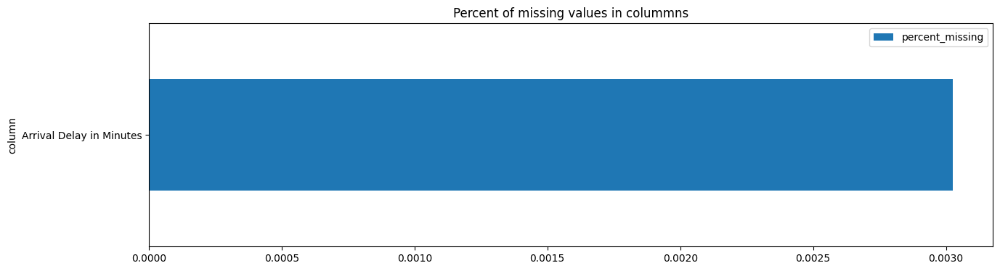

In [8]:
# https://marloz.github.io/projects/sklearn/pipeline/missing/preprocessing/2020/03/20/sklearn-pipelines-missing-values.html
def plot_missing_values(df):
    """ For each column with missing values plot proportion that is missing."""
    data = [(col, df[col].isnull().sum() / len(df)) 
            for col in df.columns if df[col].isnull().sum() > 0]
    col_names = ['column', 'percent_missing']
    missing_df = pd.DataFrame(data, columns=col_names).sort_values('percent_missing')
    pylab.rcParams['figure.figsize'] = (15, 4)
    missing_df.plot(kind='barh', x='column', y='percent_missing'); 
    plt.title('Percent of missing values in colummns');

plot_missing_values(df_original)

## Validate data

In [9]:
#################################################
#Check duplicated data
#################################################
print(f'Duplicated row: {df_original.duplicated().sum()}')

#################################################
#Check Age
#################################################
age_min=df_original["Age"].min()
age_max=df_original["Age"].max()
range_age=set(range(age_min,age_max+1))
unique_age=set(df_original["Age"].unique())

age_notin=range_age.symmetric_difference(unique_age)
print(f'Age ranges from {age_min} to {age_max}')
print(f'{age_notin} were not in the range')
#=>Some passenger group(e.g. Infants) is not included in this dataset
#=>the ratio of some age groups are far high than others
#=>If the purpose of this survey is to improve the satisfaction of all passengers
#=>this dataset may have bias


#################################################
#Check Flight Distance
#################################################
#https://en.wikipedia.org/wiki/Flight_length#:~:text=The%20Westray%20to%20Papa%20Westray,scheduled%20flight%20time%20including%20taxiing.
#The Westray to Papa Westray flight in Orkney, operated by Loganair, is the shortest commercial flight in the world, covering 2.8 km (1.7 mi) .
#https://en.wikipedia.org/wiki/Longest_flights
#World shortest commercial flight: 2.8 km
#World longest commercial flight: 9,537 miles (15,349 km)
distance_min=df_original["Flight Distance"].min()
distance_max=df_original["Flight Distance"].max()
print(f'Flight Distance ranges from {distance_min} to {distance_max}')


#################################################
#Check Class
#################################################
#seat numbers by class: https://www.routesonline.com/suppliers/10554/capa-centre-for-aviation/news/299661788/flying-with-frills-global-airlines-ranked-by-first-class-and-premium-seat-numbers/#:~:text=First%20class%20accounts%20for%20just,class%20for%2012.2%25%20of%20seats.
print("\nClass Proportion:")
print(df_original["Class"].value_counts(normalize=True))
#=>business and first class seats number ratio of many airlines are less than 12%~15%
##in this dataset business class almost equal to eco + eco plus class
##If the purpose of this survey is to improve the satisfaction of all passengers, this dataset may have bias

#################################################
#Check Type of Travel
#################################################
print("\nValidate Type of Travel:")
type_of_travel_valid_values=['business','personal']
if set(df_original['Type of Travel']).issubset(set(type_of_travel_valid_values)):
    print('Type of Travel validate OK')
else:
    print(f"Type of Travel validate NG, values in dataframe were {df_original['Type of Travel'].unique()}")

print("\nType of Travel Proportion:")
print(df_original["Type of Travel"].value_counts(normalize=True))
#=>In US business trip is around 12%(airline)
##in this dataset business trip is around 69%
#=>If the purpose of this survey is to improve the satisfaction of all passengers
#=>this dataset may have bias

#################################################
#Check Rating 
#################################################
#check survey rating is 0,1,2,3,4,5
valid_rating_list=[0,1,2,3,4,5]
rating_col_list=['Seat comfort', 'Departure/Arrival time convenient',
       'Food and drink', 'Gate location', 'Inflight wifi service',
       'Inflight entertainment', 'Online support', 'Ease of Online booking',
       'On-board service', 'Leg room service', 'Baggage handling',
       'Checkin service', 'Cleanliness', 'Online boarding']

print("\nValidate Survey Rating:")
for rating_col in rating_col_list:
    if set(df_original[rating_col]).issubset(set(valid_rating_list)):
        print(f'{rating_col} validate OK')
    else:
        print(f'{rating_col} validate NG')


#################################################
#Check Departure Delay in Minutes 
#################################################
#check departure_delay_in_minutes>=0
print("\nValidate Departure Delay in Minutes:")
departure_delay_min=df_original["Departure Delay in Minutes"].min()
if departure_delay_min>=0:
    print('Departure Delay in Minutes validate OK')
else:
    print(f"Departure Delay in Minutes validate NG, minimum value is {departure_delay_min}")

#################################################
#Check Arrival Delay in Minutes 
#################################################
#check Arrival Delay in Minutes>=0
print("\nValidate Arrival Delay in Minutes:")
arrival_delay_min=df_original["Arrival Delay in Minutes"].min()
if arrival_delay_min>=0:
    print('Arrival Delay in Minutes validate OK')
else:
    print(f"Arrival Delay in Minutes validate NG, minimum value is {arrival_delay_min}")

#################################################
#Check satisfaction 
#################################################
print("\nValidate satisfaction:")
satisfaction_valid_values=['satisfied','dissatisfied']
if set(df_original['satisfaction']).issubset(set(satisfaction_valid_values)):
    print('satisfaction validate OK')
else:
    print(f"satisfaction validate NG, values in dataframe were {df_original['satisfaction'].unique()}")


#################################################
#Check Customer Type 
#################################################
print("\nValidate Customer Type:")
customer_type_valid_values=['Loyal Customer','Disloyal Customer']
if set(df_original['Customer Type']).issubset(set(customer_type_valid_values)):
    print('Customer Type validate OK')
else:
    print(f"Customer Type validate NG, values in dataframe were {df_original['Customer Type'].unique()}")

#################################################
#Check Class 
#################################################
print("\nValidate Class:")
class_valid_values=['Business','Eco', 'Eco Plus']
if set(df_original['Class']).issubset(set(class_valid_values)):
    print('Class validate OK')
else:
    print(f"Class validate NG, values in dataframe were {df_original['Class'].unique()}")

Duplicated row: 0
Age ranges from 7 to 85
{81, 82, 83, 84} were not in the range
Flight Distance ranges from 50 to 6951

Class Proportion:
Class
Business    0.478596
Eco         0.448945
Eco Plus    0.072459
Name: proportion, dtype: float64

Validate Type of Travel:
Type of Travel validate NG, values in dataframe were ['Personal Travel' 'Business travel']

Type of Travel Proportion:
Type of Travel
Business travel    0.690584
Personal Travel    0.309416
Name: proportion, dtype: float64

Validate Survey Rating:
Seat comfort validate OK
Departure/Arrival time convenient validate OK
Food and drink validate OK
Gate location validate OK
Inflight wifi service validate OK
Inflight entertainment validate OK
Online support validate OK
Ease of Online booking validate OK
On-board service validate OK
Leg room service validate OK
Baggage handling validate OK
Checkin service validate OK
Cleanliness validate OK
Online boarding validate OK

Validate Departure Delay in Minutes:
Departure Delay in Minute

## Renaming columns

In [10]:
#################################################
#Rename all columns in data that not suitable
#all column names should be consistent
#################################################
def convert_column_name(org_df):
    replace_dict={
        " ": "_",
        "-": "_",
        "(": "",
        ")": "",
        "/": "_",
    }
    org_col_list=org_df.columns.to_list()
    new_col_list=[]
    for org_col in org_col_list:
        #to lower case
        new_col=org_col.lower()
        for replace_from,replace_to in zip(replace_dict.keys(),replace_dict.values()):
            new_col=new_col.replace(replace_from, replace_to)
        new_col_list.append(new_col)
    rename_dic=dict(zip(org_col_list, new_col_list))
    updated_df=org_df.rename(columns=rename_dic)
    return updated_df

print(f"Column names before updating:{df_original.columns}")
df_original=convert_column_name(df_original)
print(f"Column names after updating:{df_original.columns}")


Column names before updating:Index(['satisfaction', 'Customer Type', 'Age', 'Type of Travel', 'Class',
       'Flight Distance', 'Seat comfort', 'Departure/Arrival time convenient',
       'Food and drink', 'Gate location', 'Inflight wifi service',
       'Inflight entertainment', 'Online support', 'Ease of Online booking',
       'On-board service', 'Leg room service', 'Baggage handling',
       'Checkin service', 'Cleanliness', 'Online boarding',
       'Departure Delay in Minutes', 'Arrival Delay in Minutes'],
      dtype='object')
Column names after updating:Index(['satisfaction', 'customer_type', 'age', 'type_of_travel', 'class',
       'flight_distance', 'seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding',
       

## Convert values to lower case

We could observe that values in some columns(e.g. `Customer Type`) were inconsistent<BR/>
Convert these column values to make them consistent

|Column        | Convert Approach|
|:-            |:-               |
|satisfaction  |lower case       |
|customer_type |title case       |
|type_of_travel|title case       |
|class         |title case       |

In [11]:
#define columns that need to convert to title case
#col_list=list(df_original.select_dtypes(include=[object,'category']).columns)
title_col_list=['customer_type','type_of_travel','class']
lower_col_list=['satisfaction']
for col in title_col_list:
    print(f"{col} before updating: {df_original[col].unique()}")
    #Make column title case (first letter of each word capitalized)
    df_original[col]=df_original[col].str.title()
    print(f"{col} after updating: {df_original[col].unique()}")

for col in lower_col_list:
    print(f"{col} before updating: {df_original[col].unique()}")
    #Make column title case (first letter of each word capitalized)
    df_original[col]=df_original[col].str.lower()
    print(f"{col} after updating: {df_original[col].unique()}")

customer_type before updating: ['Loyal Customer' 'disloyal Customer']
customer_type after updating: ['Loyal Customer' 'Disloyal Customer']
type_of_travel before updating: ['Personal Travel' 'Business travel']
type_of_travel after updating: ['Personal Travel' 'Business Travel']
class before updating: ['Eco' 'Business' 'Eco Plus']
class after updating: ['Eco' 'Business' 'Eco Plus']
satisfaction before updating: ['satisfied' 'dissatisfied']
satisfaction after updating: ['satisfied' 'dissatisfied']


## Set common variables

In [12]:
RANDOM_STATE=7

#hue order of satisfaction
satisfaction_hue_order=["dissatisfied","satisfied"]

#hue order of Class
class_hue_order=["Eco","Eco Plus","Business"]
class_merge_hue_order=["Eco&EcoPlus","Business"]

#hue order of customer_type
customer_type_hue_order=['Disloyal Customer','Loyal Customer']

#hue order of type_of_travel
travel_type_hue_order=["Personal Travel","Business Travel"]

#hue order of flight_distance_range
distance_range_hue_order=["<1K","[1K,3K)","[3K,4K)",">=4K"]


#hue order of flight_distance_class
distance_type_hue_order=["Short-Haul","Medium-Haul","Long-Haul"]

#hue order of age
age_class_hue_order=['Infants','Children','Young-Adult','Adult','Senior']
age_range_hue_order=['<10','[10,20)','[20,30)','[30,40)','[40,50)','[50,60)','[60,70)','>=70']

#hue order of rating
rating_hue_order=['0','1','2','3','4','5']

rating_class_hue_order=['Low','Median','High']

#hue order of delay_class
delay_class_hue_order=["No Delay","Minor Delay","Moderate Delay","Significant Delay"]

## Set common function

In [13]:
#https://stackoverflow.com/questions/53782591/how-to-display-actual-values-instead-of-percentages-on-my-pie-chart-using-matplo    
#format of pie plot
def autopct_format(values):
    def my_format(pct):
        total = sum(values)
        val = int(round(pct*total/100.0))
        return '{:.1f}%\n({v:d})'.format(pct, v=val)
    return my_format

def show_test_result(statistic, p_value,significance_level):
    """
        Show hypothesis test result
    """
    if p_value <= significance_level:
        print(f'Reject H0 at significance level {significance_level} (Pvalue={round(p_value,3)}, Statistic={round(statistic,2)})')
    else:
        print(f'Fail to reject H0 at significance level {significance_level} (Pvalue={round(p_value,3)}, Statistic={round(statistic,2)})')

def report_convidence_intervals(low,upper,convidence_level,statistic_type=None):
    if statistic_type is not None:
        print(f'Percentile bootstrap of {statistic_type} {convidence_level:.0%} CI [{round(low,2)}, {round(upper,2)}]')
    else:
        print(f'Percentile bootstrap {convidence_level:.0%} CI [{round(low,2)}, {round(upper,2)}]')

#https://galton.uchicago.edu/~yibi/teaching/stat222/2019/C05_2019.pdf
def pairwise_mannwhitneyu(data, val_col, group_col, alpha=0.05, p_adjust='bonferroni'):
    """
    Performs pairwise Mann-Whitney U tests with p-value correction.
    
    Author: AI(Gemini)
    Args:
        data (pd.DataFrame): DataFrame containing the data.
        val_col (str): Name of the column containing the values.
        group_col (str): Name of the column containing the group identifiers.
        alpha (float, optional): Significance level. Defaults to 0.05.
        p_adjust (str, optional): P-value correction method (e.g., 'bonferroni', 'holm').
                                See statsmodels.sandbox.stats.multicomp.multipletests for options.
                                Defaults to 'holm'.

    Returns:
        pd.DataFrame: DataFrame containing the pairwise p-values and significance.
    """
    unique_groups = sorted(data[group_col].unique())
    num_groups = len(unique_groups)
    results = pd.DataFrame(index=unique_groups, columns=unique_groups)
    p_values = []
    comparisons = []

    for i in range(num_groups):
        for j in range(i + 1, num_groups):
            group1 = unique_groups[i]
            group2 = unique_groups[j]
            data1 = data[val_col][data[group_col] == group1]
            data2 = data[val_col][data[group_col] == group2]
            u_statistic, p_value = mannwhitneyu(data1, data2, alternative='two-sided')
            p_values.append(p_value)
            comparisons.append(f"{group1} vs {group2}")
            results.loc[group1, group2] = p_value
            results.loc[group2, group1] = p_value

    # Apply p-value correction
    reject, p_corrected, _, _ = multipletests(p_values, alpha=alpha, method=p_adjust)

    corrected_results = pd.DataFrame(index=comparisons, columns=['p_uncorrected', 'p_corrected', 'reject_null'])
    corrected_results['p_uncorrected'] = p_values
    corrected_results['p_corrected'] = p_corrected
    corrected_results['reject_null'] = reject

    return results, corrected_results


def test_multiple_non_parametric_ordered_means(data, val_col, group_col, groups_order, alpha=0.05, p_adjust='holm'):
    """
    Tests if the central tendency (based on ranks) of multiple non-normal,
    skewed samples follows a specific ordered relationship using Kruskal-Wallis
    and subsequent pairwise Mann-Whitney U tests with p-value correction.
    
    Author: AI(Gemini)
    Args:
        data (pd.DataFrame): DataFrame with values and group identifiers.
        val_col (str): Name of the column containing the values.
        group_col (str): Name of the column containing the group identifiers.
        groups_order (list): List of group names in the hypothesized order
                             (e.g., ['A', 'B', 'C']).
        alpha (float, optional): Significance level. Defaults to 0.05.
        p_adjust (str, optional): P-value correction method for
                                           pairwise tests. Defaults to 'holm'.

    Returns:
        tuple: (kruskal_result, pairwise_results)
               - kruskal_result: Result of the Kruskal-Wallis test.
               - pairwise_results: DataFrame of corrected p-values and rejection
                                   status for pairwise Mann-Whitney U tests.
    """
    unique_groups = sorted(data[group_col].unique())

    # 1. Kruskal-Wallis Test
    group_values = [data[val_col][data[group_col] == group] for group in unique_groups]
    kruskal_statistic, kruskal_p_value = kruskal(*group_values)
    kruskal_result = {'statistic': kruskal_statistic, 'p_value': kruskal_p_value}
    print(f"Kruskal-Wallis Test: Statistic = {kruskal_statistic:.3f}, p-value = {kruskal_p_value:.3f}")

    pairwise_results_df = None
    if kruskal_p_value < alpha:
        print(f"\nKruskal-Wallis test is significant at significance level {alpha}. Performing pairwise Mann-Whitney U tests")

        p_values = []
        comparisons = []
        group_pairs = []

        for i in range(len(unique_groups)):
            for j in range(i + 1, len(unique_groups)):
                group1 = unique_groups[i]
                group2 = unique_groups[j]
                data1 = data[val_col][data[group_col] == group1]
                data2 = data[val_col][data[group_col] == group2]
                u_statistic, p_value = mannwhitneyu(data1, data2, alternative='less' if groups_order.index(group1) < groups_order.index(group2) else 'greater' if groups_order.index(group1) > groups_order.index(group2) else 'two-sided')
                p_values.append(p_value)
                comparisons.append(f"{group1} vs {group2}")
                group_pairs.append((group1, group2))
        
        #https://www.statsmodels.org/dev/generated/statsmodels.stats.multitest.multipletests.html
        reject, p_corrected, _, _ = multipletests(p_values, alpha=alpha, method=p_adjust)

        pairwise_results_df = pd.DataFrame({
            'comparison': comparisons,
            'p_value_uncorrected': p_values,
            'p_value_corrected': p_corrected,
            'reject_null': reject
        })
        print("\nPairwise Mann-Whitney U Tests (One-tailed based on order, with {} correction):".format(p_adjust))
        display(pairwise_results_df)
    else:
        print("\nKruskal-Wallis test was not significant, no need for pairwise tests based on order.")

    return kruskal_result, pairwise_results_df

#combine two columns
def combine_col(col1,col2):
    new_col=str(col1)+"_"+str(col2)
    return new_col

def combine_col_arr(col_list):
    new_col=""
    for col in col_list:
        new_col=new_col+"_"+str(col)
    return new_col

#transform satisfaction into number
def convert_satisfaction_into_number(x):
    if x == 'satisfied':
        new_value=1
    elif x == 'dissatisfied':
        new_value=0
    return new_value

def split_delay(x):
    '''
        Split delay time to delay groups
        T<15 minutes: No Delay
        15<=T<60 minutes: Minor Delay
        60<=T<240 minutes: Moderate Delay
        T=>240 minutes: Significant Delay
    '''
    if (0<=x)&(x < 15):
        delay_class = 'No Delay'
    elif x < 60:
        delay_class = 'Minor Delay'
    elif x < 240:
        delay_class = 'Moderate Delay'
    else:
        delay_class = 'Significant Delay'
    return delay_class


#transform distance to distance range
def split_flight_distance_to_categorical(x):
    if x < 1000:
        flight_class = '<1K'
    elif x < 3000:
        flight_class = '[1K,3K)'
    elif x < 4000:
        flight_class = '[3K,4K)'
    else:
        flight_class = '>=4K'
    return flight_class

#transform distance to airline distance classification
def split_flight_distance(x):
    if x <= 700:
        flight_class = 'Short-Haul'
    elif x <= 3000:
        flight_class = 'Medium-Haul'
    else:
        flight_class = 'Long-Haul'
    return flight_class


#transform Age to range
def split_age_to_categorical(x):
    if x < 10:
        age_range = '<10'
    elif x < 20:
        age_range = '[10,20)'
    elif x < 30:
        age_range = '[20,30)'
    elif x < 40:
        age_range = '[30,40)'
    elif x < 50:
        age_range = '[40,50)'
    elif x < 60:
        age_range = '[50,60)'
    elif x < 70:
        age_range = '[60,70)'
    else:
        age_range = '>=70'
    return age_range

#transform Age to airline age classification
def split_age_to_airline_class(x):
    if x < 2:
        age_airline_class = 'Infants'
    elif x < 12:
        age_airline_class = 'Children'
    elif x < 18:
        age_airline_class = 'Young-Adult'
    elif x < 65:
        age_airline_class = 'Adult'
    else:
        age_airline_class = 'Senior'
    return age_airline_class


#transform rating score to rating classification
def split_rating_to_range(x):
    '''
        0<=rating<2: Low
        2<=rating<4: Median
        4<=rating<6: High
    '''
    if x < 2:
        rating_class = 'Low'
    elif x < 4:
        rating_class = 'Median'
    else:
        rating_class = 'High'
    return rating_class

def cal_rating_class_ratio(rating_item,df_trans):
    '''
        Compute low and high rating ratio of each rating item
        Input:
            rating_item: rating item column name (e.g. seat_comfort_class)
            df_trans: dataframe used to calculate
        Output:
            (low_ratio,high_ratio): Ratio of 'Low' and 'High'
    '''
    low_ratio=round(df_trans[df_trans[rating_item]=='Low']['satisfaction'].count()/df_trans.shape[0],3)
    high_ratio=round(df_trans[df_trans[rating_item]=='High']['satisfaction'].count()/df_trans.shape[0],3)
    return (low_ratio,high_ratio)

## Transform Data

In [14]:
#Create a new frame to transform data for analysis
df_trans=df_original.copy()

############################################
#convert delay time to hour
############################################
df_trans["departure_delay_in_hours"]=round(df_trans["departure_delay_in_minutes"]/60,0)

df_trans["arrival_delay_in_hours"]=round(df_trans["arrival_delay_in_minutes"]/60,0)


#################################################
#Departure Delay in Minutes
#################################################



df_trans['departure_delay_class'] = df_trans['departure_delay_in_minutes'].apply(split_delay)

#################################################
#Arrival Delay in Minutes
#################################################
df_trans['arrival_delay_class'] = df_trans['arrival_delay_in_minutes'].apply(split_delay)


#################################################
#split_flight_distance
#################################################


#transform distance to distance range
df_trans['flight_distance_range'] = df_trans['flight_distance'].apply(split_flight_distance_to_categorical)

#transform distance to airline distance classification
df_trans['flight_distance_class'] = df_trans['flight_distance'].apply(split_flight_distance)

############################################
#Transform Age
############################################


#transform age to range
df_trans['age_range'] = df_trans['age'].apply(split_age_to_categorical)


#transform age to airline age classification
df_trans['age_class_by_airline'] = df_trans['age'].apply(split_age_to_airline_class)




############################################
#Transform Rating
############################################
    

df_trans['seat_comfort_class'] = df_trans['seat_comfort'].apply(split_rating_to_range)
df_trans['departure_arrival_time_convenient_class'] = df_trans['departure_arrival_time_convenient'].apply(split_rating_to_range)

df_trans['food_and_drink_class'] = df_trans['food_and_drink'].apply(split_rating_to_range)
df_trans['gate_location_class'] = df_trans['gate_location'].apply(split_rating_to_range)
df_trans['inflight_wifi_service_class'] = df_trans['inflight_wifi_service'].apply(split_rating_to_range)
df_trans['inflight_entertainment_class'] = df_trans['inflight_entertainment'].apply(split_rating_to_range)
df_trans['online_support_class'] = df_trans['online_support'].apply(split_rating_to_range)
df_trans['ease_of_online_booking_class'] = df_trans['ease_of_online_booking'].apply(split_rating_to_range)
df_trans['on_board_service_class'] = df_trans['on_board_service'].apply(split_rating_to_range)

df_trans['leg_room_service_class'] = df_trans['leg_room_service'].apply(split_rating_to_range)
df_trans['baggage_handling_class'] = df_trans['baggage_handling'].apply(split_rating_to_range)
df_trans['checkin_service_class'] = df_trans['checkin_service'].apply(split_rating_to_range)
df_trans['cleanliness_class'] = df_trans['cleanliness'].apply(split_rating_to_range)
df_trans['online_boarding_class'] = df_trans['online_boarding'].apply(split_rating_to_range)


############################################
#Create class_m
############################################
#merge Eco and Eco Plus
class_merge_map={'Eco': 'Eco&EcoPlus', 'Eco Plus': 'Eco&EcoPlus', 'Business': 'Business'}
df_trans['class_m']=df_trans['class'].map(class_merge_map)

df_trans.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 129880 entries, 0 to 129879
Data columns (total 45 columns):
 #   Column                                   Non-Null Count   Dtype  
---  ------                                   --------------   -----  
 0   satisfaction                             129880 non-null  object 
 1   customer_type                            129880 non-null  object 
 2   age                                      129880 non-null  int64  
 3   type_of_travel                           129880 non-null  object 
 4   class                                    129880 non-null  object 
 5   flight_distance                          129880 non-null  int64  
 6   seat_comfort                             129880 non-null  int64  
 7   departure_arrival_time_convenient        129880 non-null  int64  
 8   food_and_drink                           129880 non-null  int64  
 9   gate_location                            129880 non-null  int64  
 10  inflight_wifi_service           

In [15]:
data_cat=df_trans.copy()

############################################
#Transform rating data to categorical data
############################################
#since some item only have a few 0 point, merge 0 to 1
def trans_number_to_categorical(x):
    rating_mapping = {0: '0', 1: '1', 2: '2',3:'3',4:'4',5:'5'}
    if x in rating_mapping.keys():
        return rating_mapping[x]

var_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']

for var in var_list:
    data_cat[var]=data_cat[var].apply(trans_number_to_categorical)
    data_cat[var]=data_cat[var].astype('category')

############################################
#Transform rating class to categorical data
############################################
rating_class_hue_order=['Low','Median','High']
var_list=['seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']

for var in var_list:
    data_cat[var] = pd.Categorical(data_cat[var], categories=rating_class_hue_order, ordered=True)


############################################
#Transform satisfaction to categorical data
############################################
satisfaction_cat=satisfaction_hue_order
data_cat['satisfaction'] = pd.Categorical(data_cat['satisfaction'], categories=satisfaction_cat, ordered=True)


############################################
#Transform Class to categorical data
############################################
class_cat=class_hue_order
data_cat['class'] = pd.Categorical(data_cat['class'], categories=class_cat, ordered=True)
data_cat['class_m'] = pd.Categorical(data_cat['class_m'], categories=class_merge_hue_order, ordered=True)

############################################
#Transform customer_type
############################################
customer_type_cat=customer_type_hue_order
data_cat['customer_type'] = pd.Categorical(data_cat['customer_type'], categories=customer_type_cat, ordered=True)


############################################
#Transform type_of_travel
############################################
type_of_travel_cat=travel_type_hue_order
data_cat['type_of_travel'] = pd.Categorical(data_cat['type_of_travel'], categories=type_of_travel_cat, ordered=True)


############################################
#Transform Age to categorical data
############################################

# Create categorical designations
age_cat = range(6,86)

# Encode `Age` column as categoricals 
data_cat['age_cat'] = pd.Categorical(data_cat['age'], categories=age_cat, ordered=True)


#transform Age to range
age_range_cat=age_range_hue_order
# Encode `age_range` column as categoricals 
data_cat['age_range'] = pd.Categorical(data_cat['age_range'], categories=age_range_cat, ordered=True)

#transform Age to airline age classification
age_airline_class_cat=age_class_hue_order
data_cat['age_class_by_airline'] = pd.Categorical(data_cat['age_class_by_airline'], categories=age_airline_class_cat, ordered=True)

############################################
#Transform flight_distance to categorical data
############################################


# Create categorical designations
flight_distance_range_cat=distance_range_hue_order
# Encode `flight_distance_range` column as categoricals 
data_cat['flight_distance_range'] = pd.Categorical(data_cat['flight_distance_range'], categories=flight_distance_range_cat, ordered=True)


flight_distance_tye_cat=distance_type_hue_order
data_cat['flight_distance_class'] = pd.Categorical(data_cat['flight_distance_class'], categories=flight_distance_tye_cat, ordered=True)


############################################
#Transform Departure Delay to categorical data
############################################
delay_class_cat=delay_class_hue_order
# Encode column as categoricals 
data_cat['departure_delay_class'] = pd.Categorical(data_cat['departure_delay_class'], categories=delay_class_cat, ordered=True)


############################################
#Transform Arrival Delay to categorical data
############################################
data_cat['arrival_delay_class'] = pd.Categorical(data_cat['arrival_delay_class'], categories=delay_class_cat, ordered=True)


############################################
#log departure_delay_in_minutes
############################################
data_cat['departure_delay_in_minutes_log'] = np.log(data_cat['departure_delay_in_minutes']+1)

############################################
#log arrival_delay_in_minutes
############################################
data_cat['arrival_delay_in_minutes_log'] = np.log(data_cat['arrival_delay_in_minutes']+1)


data_cat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 129880 entries, 0 to 129879
Data columns (total 48 columns):
 #   Column                                   Non-Null Count   Dtype   
---  ------                                   --------------   -----   
 0   satisfaction                             129880 non-null  category
 1   customer_type                            129880 non-null  category
 2   age                                      129880 non-null  int64   
 3   type_of_travel                           129880 non-null  category
 4   class                                    129880 non-null  category
 5   flight_distance                          129880 non-null  int64   
 6   seat_comfort                             129880 non-null  category
 7   departure_arrival_time_convenient        129880 non-null  category
 8   food_and_drink                           129880 non-null  category
 9   gate_location                            129880 non-null  category
 10  inflight_wifi_servic

## Pairplot

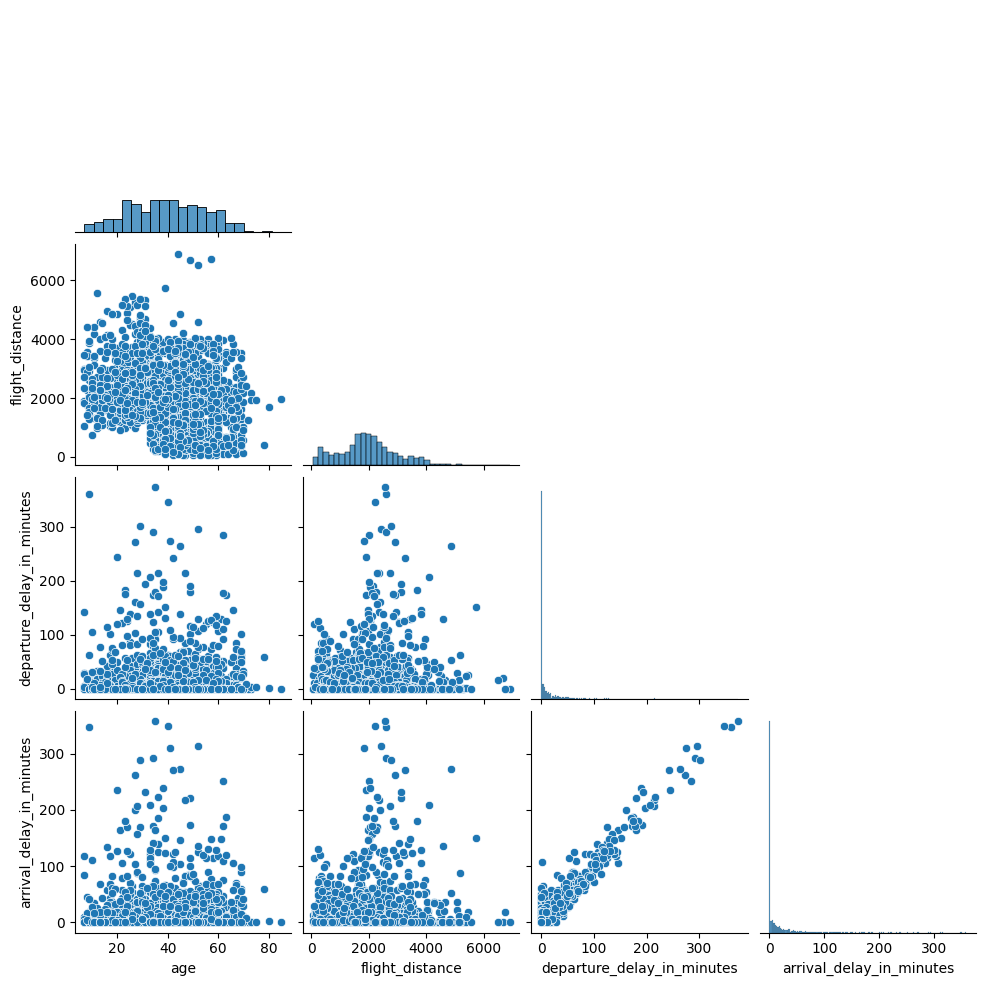

In [16]:
var_num=['age',"flight_distance",'departure_delay_in_minutes','arrival_delay_in_minutes']
#take a sample
sample=df_original.sample(n=2000, replace=False, random_state=RANDOM_STATE)
sns.pairplot(sample[var_num],corner=True)
plt.show()

#=>departure_delay_in_minutes and arrival_delay_in_minutes seems to be correlated

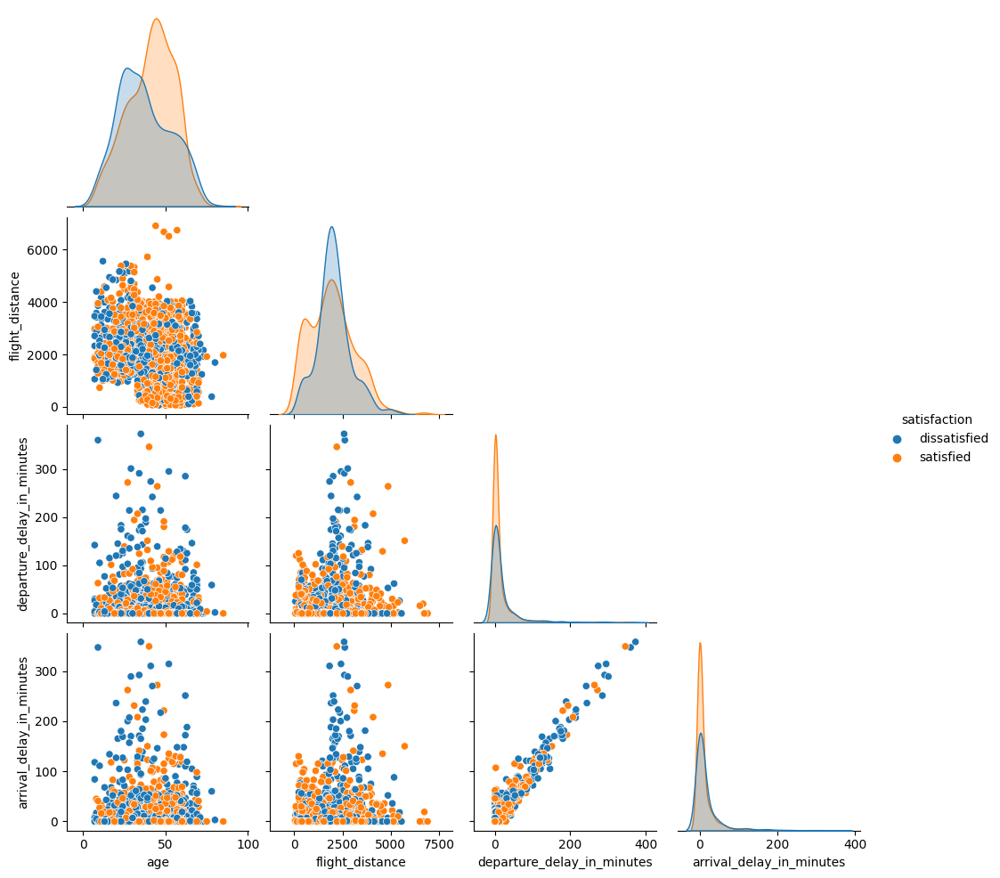

In [17]:
var_num=['satisfaction','age',"flight_distance",'departure_delay_in_minutes','arrival_delay_in_minutes']
sns.pairplot(sample[var_num],corner=True, hue="satisfaction")
plt.show()

In [18]:
var_num=['age',"flight_distance",'departure_delay_in_minutes','arrival_delay_in_minutes']
sample[var_num].corr(method='spearman')

,age,flight_distance,departure_delay_in_minutes,arrival_delay_in_minutes
age,1.000000,-0.226253,0.002618,0.026849
flight_distance,-0.226253,1.000000,0.042124,0.034304
departure_delay_in_minutes,0.002618,0.042124,1.000000,0.741723
arrival_delay_in_minutes,0.026849,0.034304,0.741723,1.000000


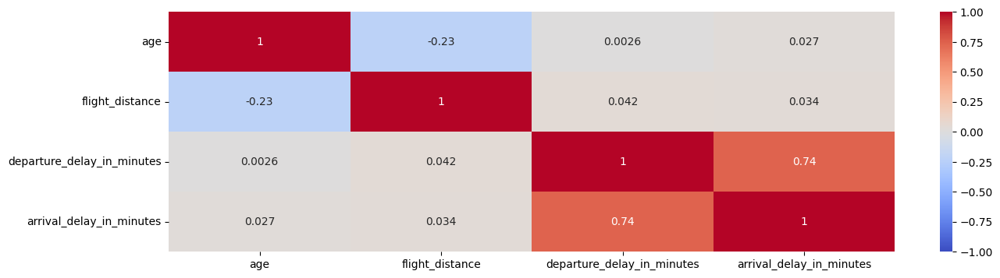

In [19]:
var_num=['age',"flight_distance",'departure_delay_in_minutes','arrival_delay_in_minutes']
sns.heatmap(sample[var_num].corr(method='spearman'), annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.show()
#=>departure_delay_in_minutes and arrival_delay_in_minutes were correlated


In [20]:
col_list=list(df_trans.select_dtypes(exclude=[object,'category']).columns)
col_list.append('satisfaction')
print(col_list)
sample=df_trans[col_list].sample(n=2000, replace=False, random_state=RANDOM_STATE)
sample['satisfaction']=sample['satisfaction'].apply(convert_satisfaction_into_number)
sample.corr(method='spearman')

['age', 'flight_distance', 'seat_comfort', 'departure_arrival_time_convenient', 'food_and_drink', 'gate_location', 'inflight_wifi_service', 'inflight_entertainment', 'online_support', 'ease_of_online_booking', 'on_board_service', 'leg_room_service', 'baggage_handling', 'checkin_service', 'cleanliness', 'online_boarding', 'departure_delay_in_minutes', 'arrival_delay_in_minutes', 'departure_delay_in_hours', 'arrival_delay_in_hours', 'satisfaction']


,age,flight_distance,seat_comfort,departure_arrival_time_convenient,food_and_drink,gate_location,inflight_wifi_service,inflight_entertainment,online_support,ease_of_online_booking,on_board_service,leg_room_service,baggage_handling,checkin_service,cleanliness,online_boarding,departure_delay_in_minutes,arrival_delay_in_minutes,departure_delay_in_hours,arrival_delay_in_hours,satisfaction
age,1.000000,-0.226253,0.023836,0.032196,0.040561,0.021916,0.055831,0.160791,0.140934,0.104091,0.076865,0.105566,0.007776,0.080789,-0.020118,0.064292,0.002618,0.026849,0.021925,0.022012,0.149762
flight_distance,-0.226253,1.000000,-0.058921,0.008961,-0.007126,0.009281,0.008424,-0.028145,0.002436,-0.022333,-0.031431,-0.043540,0.023817,-0.031167,0.033114,0.021553,0.042124,0.034304,0.019523,0.034487,-0.057260
seat_comfort,0.023836,-0.058921,1.000000,0.474925,0.712073,0.414027,0.128585,0.398514,0.119043,0.190326,0.105834,0.140488,0.116765,0.059813,0.092016,0.150059,-0.004393,-0.017077,-0.000663,-0.010255,0.251620
departure_arrival_time_convenient,0.032196,0.008961,0.474925,1.000000,0.546010,0.530105,-0.009176,0.079789,0.001576,-0.019224,0.074308,-0.009920,0.079287,0.103038,0.066590,-0.001240,0.058958,0.033944,0.042496,0.034607,-0.034522
food_and_drink,0.040561,-0.007126,0.712073,0.546010,1.000000,0.495083,0.031589,0.333321,0.038834,0.035307,0.022253,0.049192,0.019886,0.031218,-0.011504,0.048446,0.029046,0.021155,0.024029,0.015436,0.129477
gate_location,0.021916,0.009281,0.414027,0.530105,0.495083,1.000000,0.020085,-0.020250,0.011237,0.021858,-0.039441,-0.023270,-0.045085,-0.016745,-0.060146,0.022152,0.054018,0.039382,0.037941,0.010884,-0.030802
inflight_wifi_service,0.055831,0.008424,0.128585,-0.009176,0.031589,0.020085,1.000000,0.245101,0.529340,0.581769,0.051760,0.010830,0.066786,0.064766,0.071668,0.629674,0.001538,-0.022572,-0.028549,-0.031725,0.211238
inflight_entertainment,0.160791,-0.028145,0.398514,0.079789,0.333321,-0.020250,0.245101,1.000000,0.456644,0.352001,0.222020,0.207046,0.179244,0.255679,0.143488,0.364875,-0.013951,-0.023110,-0.038927,-0.019995,0.575991
online_support,0.140934,0.002436,0.119043,0.001576,0.038834,0.011237,0.529340,0.456644,1.000000,0.591250,0.156191,0.130566,0.139965,0.231227,0.130958,0.649132,0.026456,-0.016221,-0.010939,-0.018879,0.375626
ease_of_online_booking,0.104091,-0.022333,0.190326,-0.019224,0.035307,0.021858,0.581769,0.352001,0.591250,1.000000,0.445977,0.366624,0.442135,0.143885,0.460104,0.651691,-0.041805,-0.050648,-0.052481,-0.051181,0.415625


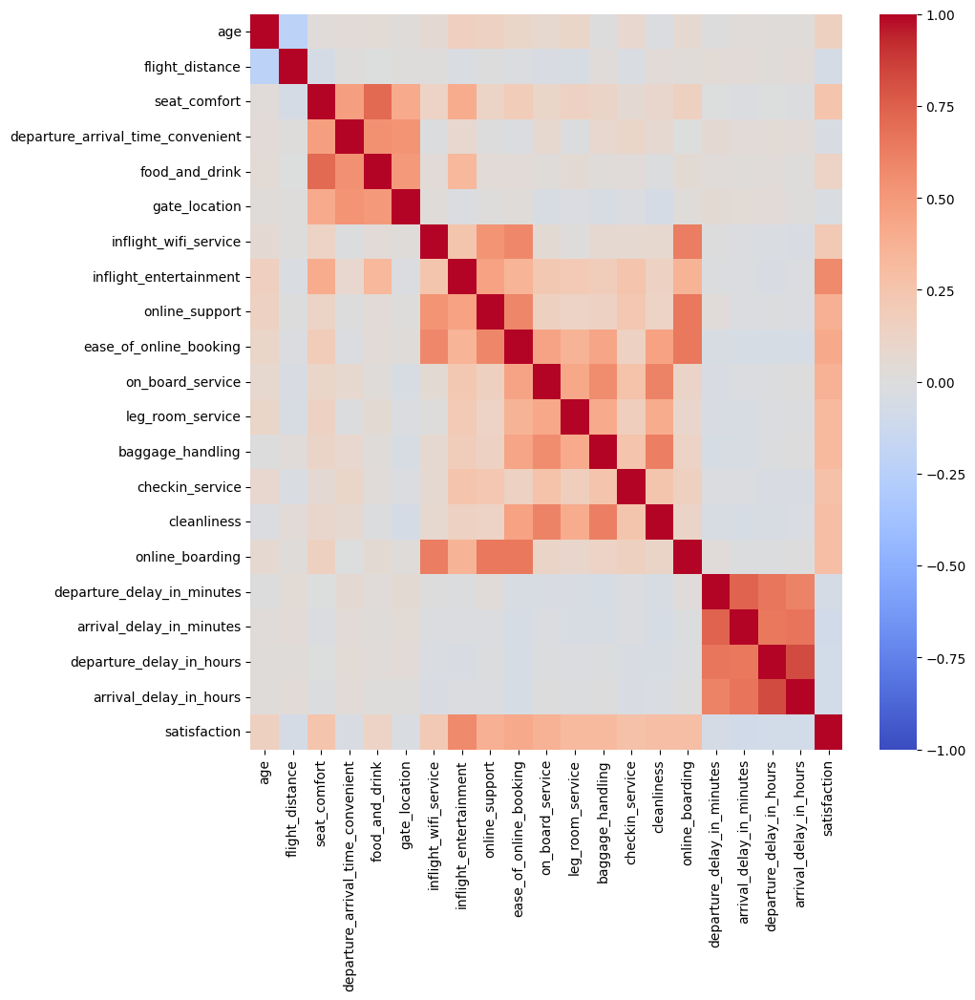

In [21]:
plt.figure(figsize=(10,10))
sns.heatmap(sample.corr(method='spearman'), annot=False, cmap='coolwarm', vmin=-1, vmax=1)
plt.show()

In [22]:
sample.corr(method='kendall')

,age,flight_distance,seat_comfort,departure_arrival_time_convenient,food_and_drink,gate_location,inflight_wifi_service,inflight_entertainment,online_support,ease_of_online_booking,on_board_service,leg_room_service,baggage_handling,checkin_service,cleanliness,online_boarding,departure_delay_in_minutes,arrival_delay_in_minutes,departure_delay_in_hours,arrival_delay_in_hours,satisfaction
age,1.000000,-0.153891,0.017087,0.023942,0.029590,0.015970,0.041038,0.119819,0.104537,0.076516,0.057122,0.078794,0.005785,0.059901,-0.014983,0.047570,0.001941,0.020150,0.017827,0.017932,0.123425
flight_distance,-0.153891,1.000000,-0.043477,0.006345,-0.005322,0.007250,0.006069,-0.021952,0.001056,-0.017162,-0.023129,-0.032039,0.018075,-0.023092,0.025127,0.015487,0.030555,0.024934,0.015531,0.027684,-0.046772
seat_comfort,0.017087,-0.043477,1.000000,0.420078,0.664539,0.362319,0.105266,0.360850,0.098102,0.160259,0.086755,0.115692,0.097590,0.048317,0.076785,0.122670,-0.003347,-0.013591,-0.000454,-0.008795,0.224350
departure_arrival_time_convenient,0.023942,0.006345,0.420078,1.000000,0.496070,0.481761,-0.007302,0.065318,0.001345,-0.015404,0.059707,-0.008024,0.064504,0.082479,0.054490,-0.000936,0.046984,0.027153,0.037186,0.030223,-0.030669
food_and_drink,0.029590,-0.005322,0.664539,0.496070,1.000000,0.442049,0.025022,0.296235,0.031096,0.028508,0.017914,0.039708,0.016194,0.024978,-0.009573,0.038572,0.023042,0.016951,0.021138,0.013614,0.115176
gate_location,0.015970,0.007250,0.362319,0.481761,0.442049,1.000000,0.016087,-0.015971,0.008989,0.017672,-0.031869,-0.019026,-0.036140,-0.013339,-0.049176,0.017674,0.043019,0.031681,0.033458,0.009623,-0.027646
inflight_wifi_service,0.041038,0.006069,0.105266,-0.007302,0.025022,0.016087,1.000000,0.203197,0.470947,0.521872,0.041787,0.008914,0.055086,0.052565,0.058749,0.570839,0.001264,-0.018227,-0.025385,-0.027984,0.189571
inflight_entertainment,0.119819,-0.021952,0.360850,0.065318,0.296235,-0.015971,0.203197,1.000000,0.388672,0.293602,0.179023,0.167588,0.145604,0.208597,0.116130,0.305578,-0.011371,-0.019039,-0.034400,-0.017654,0.517876
online_support,0.104537,0.001056,0.098102,0.001345,0.031096,0.008989,0.470947,0.388672,1.000000,0.531527,0.126113,0.107162,0.115164,0.189510,0.107382,0.583649,0.021389,-0.013150,-0.009833,-0.016784,0.338983
ease_of_online_booking,0.076516,-0.017162,0.160259,-0.015404,0.028508,0.017672,0.521872,0.293602,0.531527,1.000000,0.394314,0.321550,0.393660,0.117272,0.414238,0.590822,-0.033970,-0.041203,-0.046745,-0.045385,0.375280


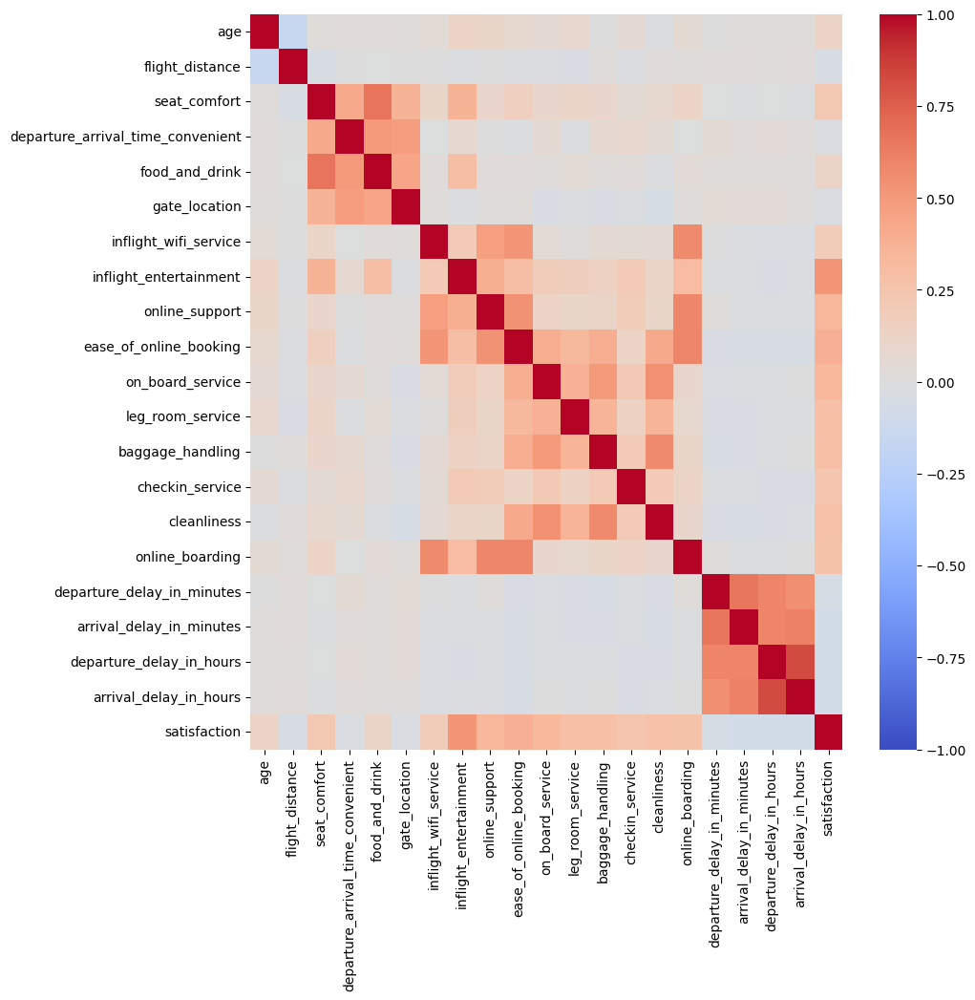

In [23]:
plt.figure(figsize=(10,10))
sns.heatmap(sample.corr(method='kendall'), annot=False, cmap='coolwarm', vmin=-1, vmax=1)
plt.show()

## 1 satisfaction

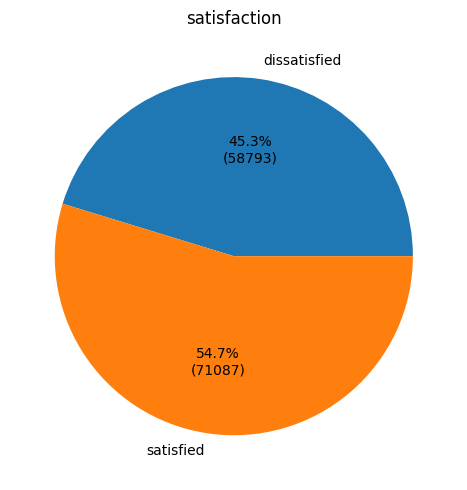

In [24]:
#######################################
#Pie Chart
#######################################
plt.figure(figsize=(6,5))
result=data_cat.groupby(['satisfaction'])[['type_of_travel']].count().reset_index().rename(columns={'type_of_travel':'count'})
plt.pie(result['count'],labels = result["satisfaction"], autopct=autopct_format(result['count']))
plt.title("satisfaction")
plt.tight_layout()
plt.show()

### 1-2 satisfaction vs Customer Type

In [25]:
pd.crosstab(df_original["satisfaction"],df_original["customer_type"],margins=True,normalize="all")

customer_type,Disloyal Customer,Loyal Customer,All
satisfaction,,,
dissatisfied,0.139205,0.313466,0.452672
satisfied,0.043887,0.503442,0.547328
All,0.183092,0.816908,1.000000


customer_type,satisfaction,Disloyal Customer,Loyal Customer
0,dissatisfied,18080,40713
1,satisfied,5700,65387


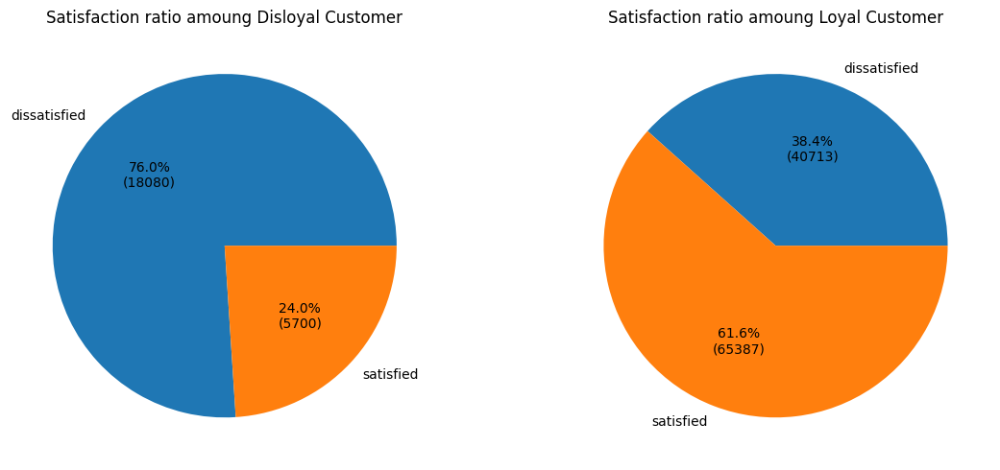

In [26]:
#######################################
#P(satisfaction | Customer Type)
#######################################
result=pd.crosstab(data_cat['satisfaction'],data_cat['customer_type'],margins=False).reset_index()

display(result)
col_nm=customer_type_hue_order

#######################################
#Pie Chart
#######################################
colCnt=2
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(colCnt*6,rowCnt*5))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["satisfaction"], autopct=autopct_format(result[col]))
    ax.set_title(f"Satisfaction ratio amoung {col}")
plt.tight_layout()
plt.show()
#=>among Loyal Customer, satisfied passenger is around 61.6%, which is higher than random probability 50%
#=>among Disloyal Customer, dissatisfied passenger is around 76%, which is higher than random probability 50%
#It seems "Customer Type" could help us predict satisfaction
#however "Customer Type" might be difficult to measure(for unknown/new passenger)

In [27]:
#######################################
#P(Customer Type | satisfaction)
#######################################
pd.crosstab(df_original["satisfaction"],df_original["customer_type"],margins=True,normalize="index")
#=>among satisfied passengers, Loyal Customer is around 92%

customer_type,Disloyal Customer,Loyal Customer
satisfaction,,
dissatisfied,0.307520,0.692480
satisfied,0.080183,0.919817
All,0.183092,0.816908


### 1-3 satisfaction vs Age

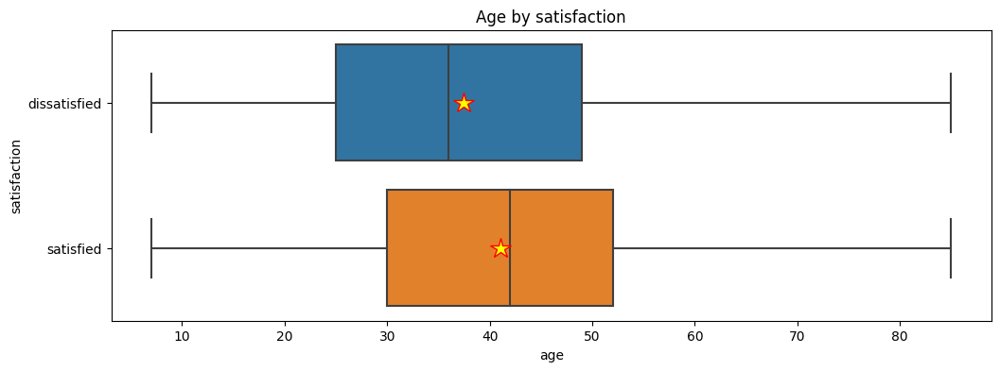

In [28]:
##########################################
#Box plot of Age by satisfaction
##########################################
plt.figure(figsize=(12,4))
sns.boxplot(data=data_cat, y="satisfaction",x="age",
            showmeans=True,
            meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})
plt.title("Age by satisfaction")
plt.show()
#=>mean age and median age of satisfied passsengers seemed to be older than dissatisfied passsengers

$H_{0}$: Average age of satisfied passengers is less or equal to dissatisfied passengers<BR>
$H_{A}$: Average age of satisfied passengers is greater than dissatisfied passengers

set significance level to 0.05

In [29]:
significance_level=0.05
sample=data_cat
sample_satisfied=sample[sample["satisfaction"]=="satisfied"]["age"]
sample_dissatisfied=sample[sample["satisfaction"]=="dissatisfied"]["age"]
#####################################
#The Mann-Whitney U test
#####################################
statistic, pvalue = mannwhitneyu(sample_satisfied,sample_dissatisfied,alternative="greater")
show_test_result(statistic, pvalue,significance_level)

#####################################
#T-test
#####################################
statistic, pvalue=stats.ttest_ind(sample_satisfied,sample_dissatisfied,alternative="greater")
show_test_result(statistic, pvalue,significance_level)

Reject H0 at significance level 0.05 (Pvalue=0.0, Statistic=2405944521.5)
Reject H0 at significance level 0.05 (Pvalue=0.0, Statistic=42.81)


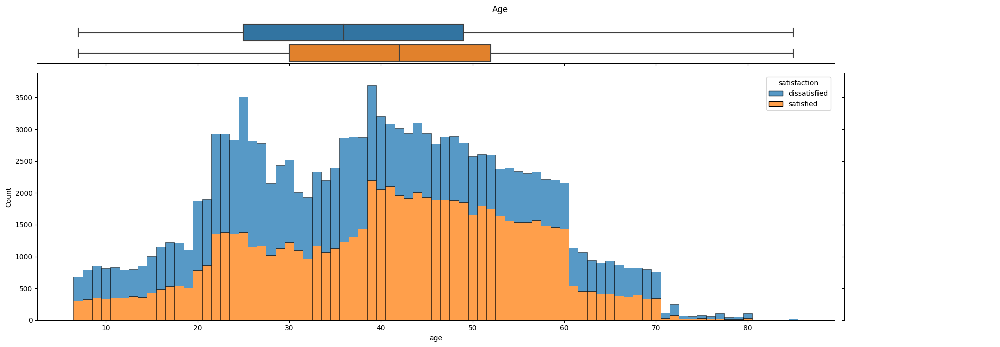

In [30]:
#################################################
#satisfaction by age
#################################################
hue_order=satisfaction_hue_order
g = sns.JointGrid()

sns.histplot(data=data_cat, x="age",hue='satisfaction', discrete=True, ax=g.ax_joint,hue_order=hue_order,palette='tab10',multiple='stack')
sns.boxplot(data=data_cat, x="age",y='satisfaction', ax=g.ax_marg_x)
g.fig.set_size_inches((20, 7))
plt.suptitle("Age")
plt.tight_layout()
plt.show()

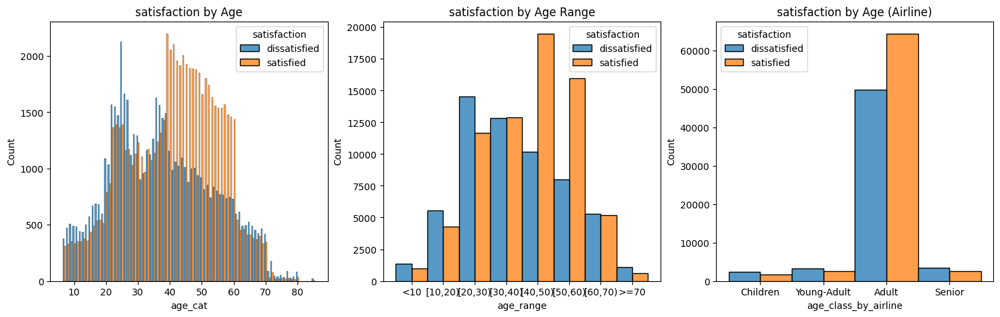

In [31]:
#################################################
#satisfaction count by age
#################################################
fig, axs = plt.subplots(1,3,figsize=(18,5))

hue_order=satisfaction_hue_order
sns.histplot(data=data_cat, x="age_cat",hue='satisfaction',palette='tab10',multiple='dodge',ax=axs[0],hue_order=hue_order)
sns.histplot(data=data_cat, x="age_range",hue='satisfaction',palette='tab10',multiple='dodge',ax=axs[1],hue_order=hue_order)
sns.histplot(data=data_cat, x="age_class_by_airline",hue='satisfaction',palette='tab10',multiple='dodge',ax=axs[2],hue_order=hue_order)

#set title
axs[0].set_title("satisfaction by Age")
axs[1].set_title("satisfaction by Age Range")
axs[2].set_title("satisfaction by Age (Airline)")

plt.show()
#=>Around 39-60, satisfied passenger count became higher than dissatisfied
#=>around 39-60, busniess class greater than Eco
#=>Class might be an important factor to service satisfaction

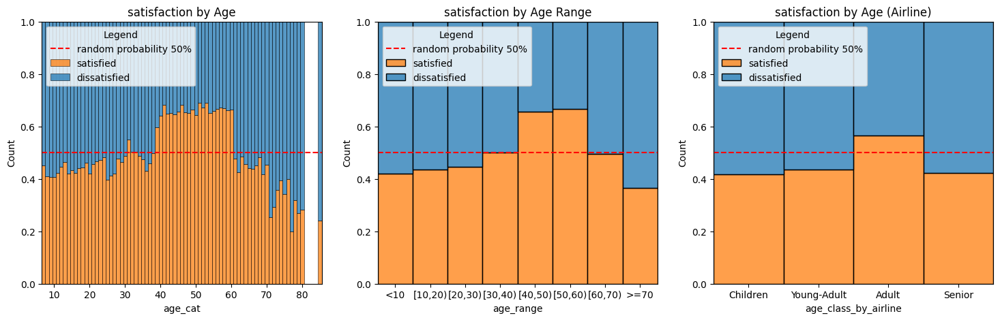

In [32]:
#################################################
#satisfaction ratio by age
#################################################
fig, axs = plt.subplots(1,3,figsize=(18,5))

hue_order=satisfaction_hue_order
sns.histplot(data=data_cat, x="age_cat",hue='satisfaction', multiple="fill",ax=axs[0],hue_order=hue_order)
sns.histplot(data=data_cat, x="age_range",hue='satisfaction', multiple="fill",ax=axs[1],hue_order=hue_order)
sns.histplot(data=data_cat, x="age_class_by_airline",hue='satisfaction', multiple="fill",ax=axs[2],hue_order=hue_order)

#set 50% random probability line
axs[0].axhline(0.5,color="red",linestyle="--",label="random probability 50%")
axs[1].axhline(0.5,color="red",linestyle="--",label="random probability 50%")
axs[2].axhline(0.5,color="red",linestyle="--",label="random probability 50%")

#set title
axs[0].set_title("satisfaction by Age")
axs[1].set_title("satisfaction by Age Range")
axs[2].set_title("satisfaction by Age (Airline)")

#edit legend
handles, labels = axs[0].get_legend_handles_labels()
axs[0].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
handles, labels = axs[1].get_legend_handles_labels()
axs[1].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
handles, labels = axs[2].get_legend_handles_labels()
axs[2].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])

plt.show()

#=>age 40-60 seems to be more satisfied than others
#=>passengers more than 70 looks more dissatisfied

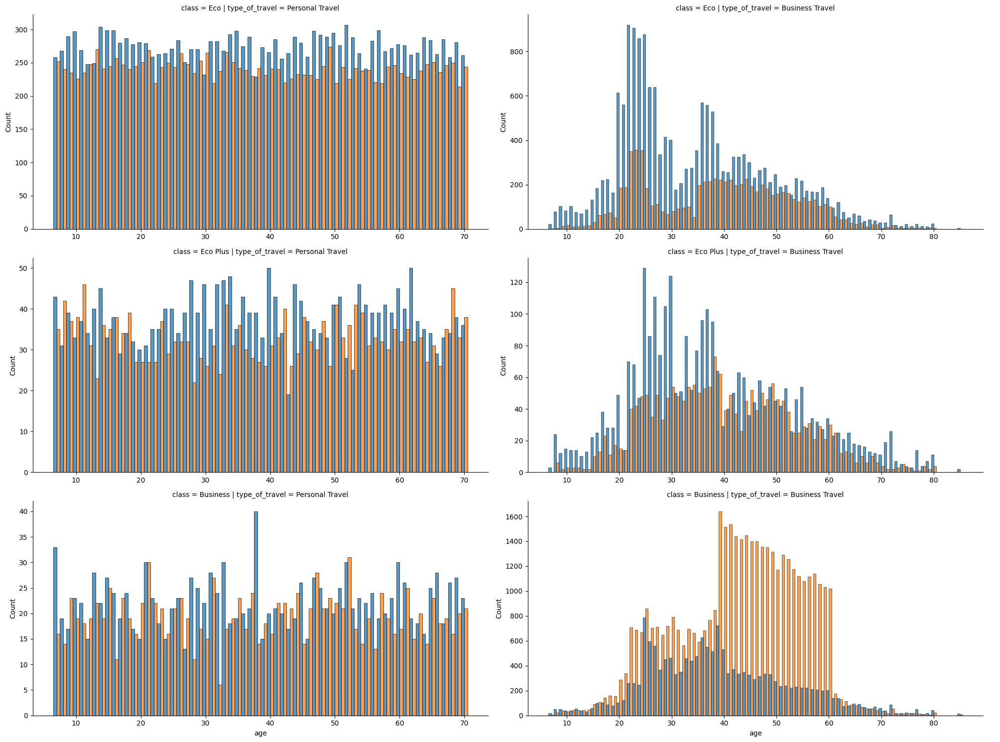

In [33]:
#################################################
#Keep Class and Travel Type constant
#Age count(satisfaction)
#################################################
hue_order=satisfaction_hue_order
g = sns.FacetGrid(data_cat, col="type_of_travel", row="class", height=5, aspect=2,sharey=False,sharex=False,
                  palette='tab10')
g.map_dataframe(sns.histplot, x="age",stat='count', discrete=True,multiple='dodge',
                hue="satisfaction",hue_order=hue_order)
g.add_legend()
plt.show()

#For personal travel, satisfied and dissatisfied count were almost equal(or close)
#For business travel, satisfied and dissatisfied count varied a lot

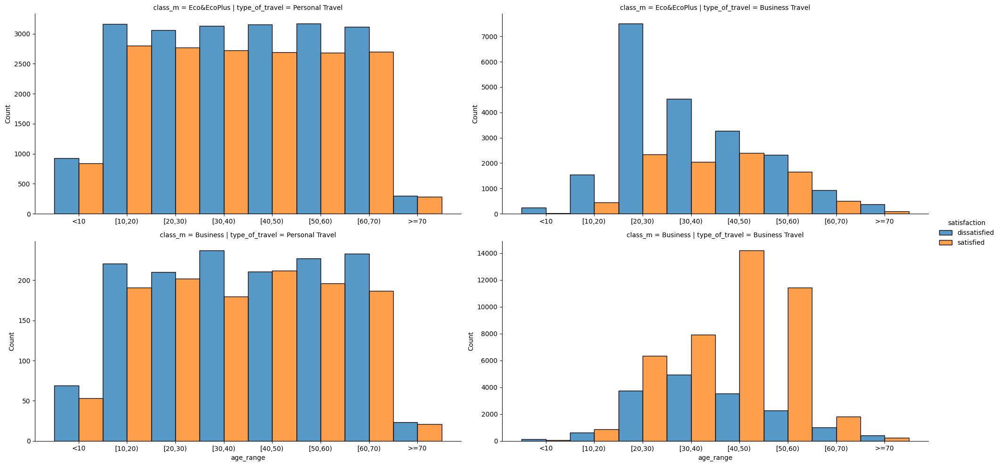

In [34]:
#################################################
#Keep class_m and Travel Type constant
#age range range count(satisfaction)
#################################################
hue_order=satisfaction_hue_order
g = sns.FacetGrid(data_cat, col="type_of_travel", row="class_m", height=5, aspect=2,sharey=False,sharex=False,
                  palette='tab10',
                hue="satisfaction")
g.map_dataframe(sns.histplot, x="age_range",stat='count', discrete=True,multiple='dodge',
                hue="satisfaction",hue_order=hue_order)
g.add_legend()
plt.show()
#For personal travel, satisfied and dissatisfied count had no big difference
#For business travel, satisfied and dissatisfied count had big difference

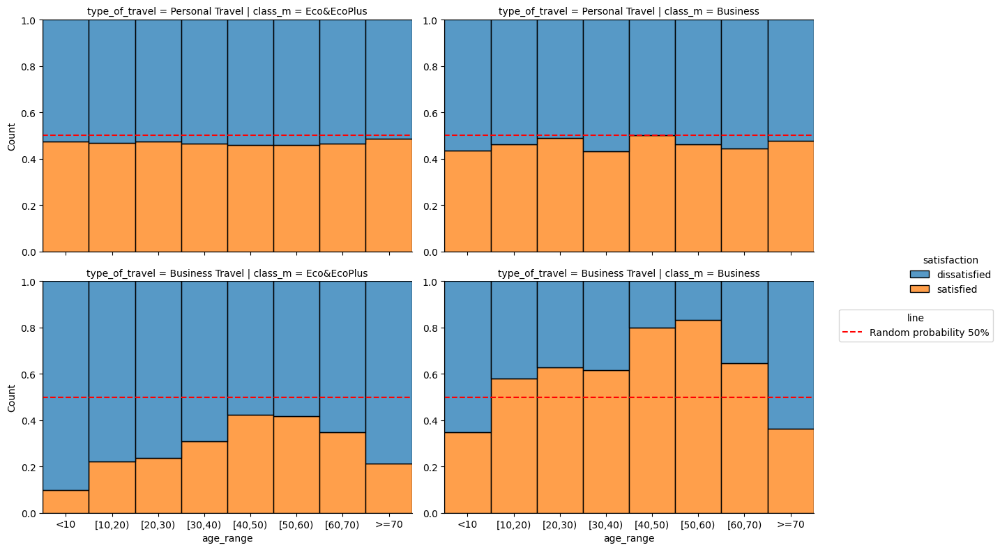

In [35]:
#################################################
#Keep class_m and Travel Type constant
#age range range ratio(satisfaction)
#################################################
hue_order=satisfaction_hue_order
g=sns.displot(
    data=data_cat, x="age_range", hue="satisfaction", 
    hue_order=satisfaction_hue_order,
    row="type_of_travel",col="class_m",
    facet_kws={"sharey": False,"sharex": True},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='fill',stat='count'
)

g.refline(y=0.5,color="red",linestyle="--",label="Random probability 50%")
plt.legend(title='line',loc='upper right', bbox_to_anchor=(1.5, 0.9))
plt.show()
#For personal travel, satisfied ratio had minor change
#For business travel, satisfied ratio changed a lot(a bell curve)

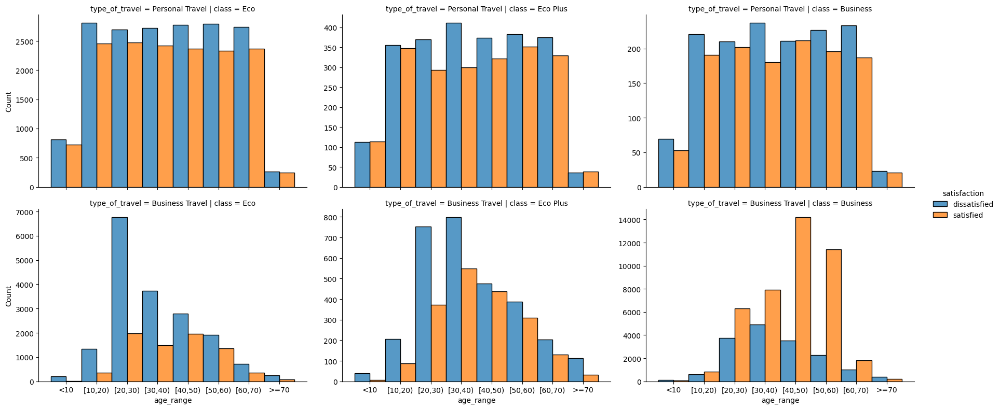

In [36]:
#################################################
#Keep Class and travel type constant
#satisfaction count by age range
#################################################
g=sns.displot(
    data=data_cat, x="age_range", hue="satisfaction", 
    row="type_of_travel",col="class",
    facet_kws={"sharey": False,"sharex": True},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='dodge',stat='count'
)
plt.show()

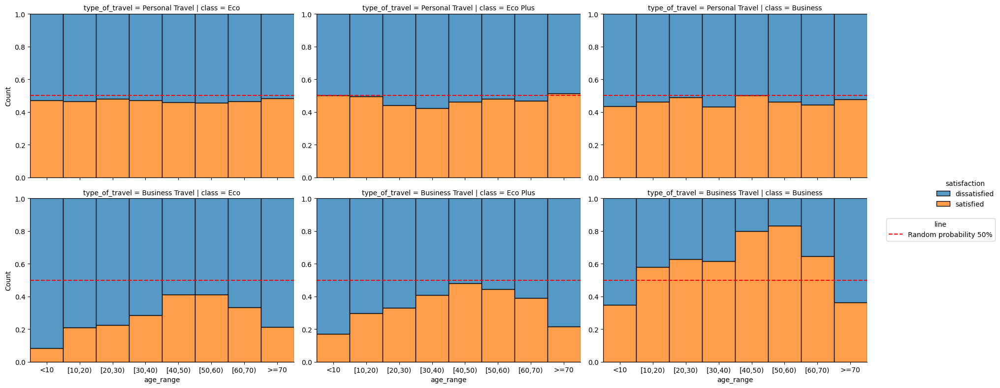

In [37]:
#################################################
#Keep Class and travel type constant
#satisfaction ratio by age range
#################################################
g=sns.displot(
    data=data_cat, x="age_range", hue="satisfaction", 
    row="type_of_travel",col="class",
    facet_kws={"sharey": False,"sharex": True},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='fill',stat='count'
)
g.refline(y=0.5,color="red",linestyle="--",label="Random probability 50%")
plt.legend(title='line',loc='upper right', bbox_to_anchor=(1.5, 0.9))
plt.show()
#For personal travel, satisfied ratio had minor change
#For business travel, satisfied ratio changed a lot(a bell curve)

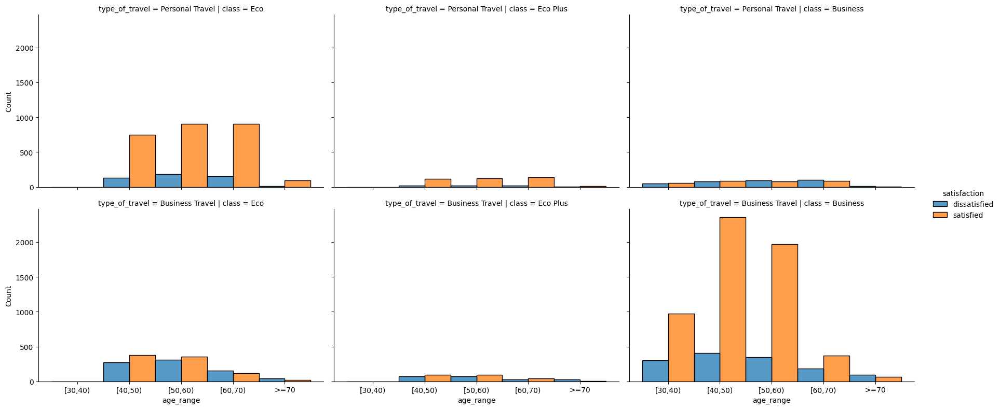

In [38]:
#################################################
#Keep Class ,travel type, trip distance,Departure_Delay constant
#trip distance Short-Haul
#No Delay
#satisfaction count by age range
#################################################
mask=(data_cat['flight_distance_class']=='Short-Haul')&(data_cat['departure_delay_class']=='No Delay')
target_data=data_cat[mask]
g=sns.displot(
    data=target_data, x="age_range", hue="satisfaction", 
    row="type_of_travel",col="class",
    facet_kws={"sharey": True,"sharex": True},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='dodge',stat='count'
)
plt.show()

#For Short-Haul
#Personal travel with Eco, Eco Plus class and Business Travel with business class, satisfied and dissatisfied count were different within each class
#Business Travel with Eco, Eco Plus class and Personal travel with business class, satisfied and dissatisfied count were almost equal(or close) within each class
#Age 30-40 no eco or eco plus data

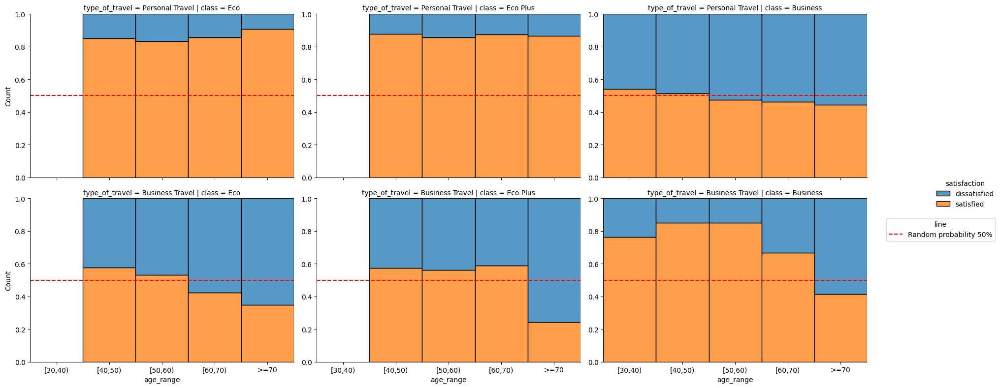

In [39]:
#################################################
#Keep Class ,travel type, trip distance,Departure_Delay constant
#trip distance Short-Haul
#No Delay
#satisfaction ratio by Age
#################################################
mask=(data_cat['flight_distance_class']=='Short-Haul')&(data_cat['departure_delay_class']=='No Delay')
target_data=data_cat[mask]
g=sns.displot(
    data=target_data, x="age_range", hue="satisfaction", 
    row="type_of_travel",col="class",
    facet_kws={"sharey": False,"sharex": True},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='fill',stat='count'
)
g.refline(y=0.5,color="red",linestyle="--",label="Random probability 50%")
plt.legend(title='line',loc='upper right', bbox_to_anchor=(1.5, 0.9))
plt.show()

#For Short-Haul
#=>Personal travel with Eco and Eco Plus class satisfied ratio were high(more than 50%), 
#  Business class were low(as age gets higher satisfied ratio tends to decrease)
#=>Business travel with Business class satisfied ratio were high(more than 50%, curve shape, 40-60 peak), 
#  Eco class as age gets higher satisfied ratio tends to decrease, business travel age>=70 had the lowest satisfied ratio across all class 

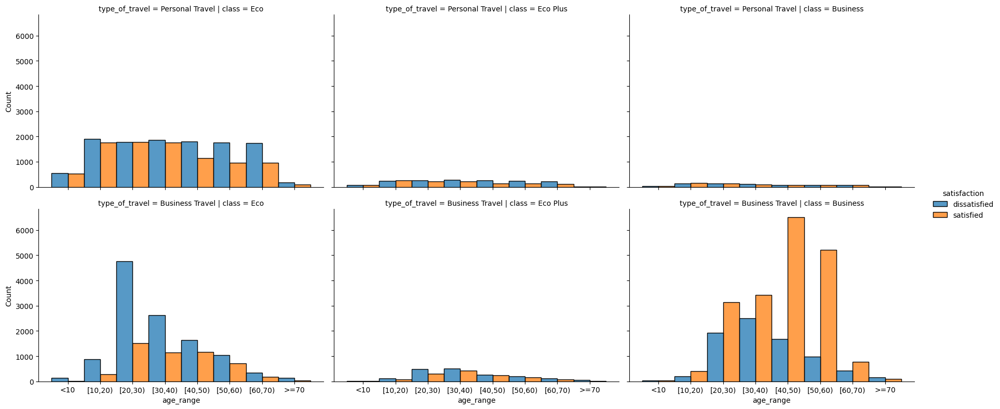

In [40]:
#################################################
#Keep Class ,travel type, trip distance,Departure_Delay constant
#trip distance Medium-Haul
#No Delay
#satisfaction count by age range
#################################################
mask=(data_cat['flight_distance_class']=='Medium-Haul')&(data_cat['departure_delay_class']=='No Delay')
target_data=data_cat[mask]
g=sns.displot(
    data=target_data, x="age_range", hue="satisfaction", 
    row="type_of_travel",col="class",
    facet_kws={"sharey": True,"sharex": True},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='dodge',stat='count'
)
plt.show()

#For Medium-Haul
#Personal travel with Eco, Eco Plus class and business class, satisfied count and dissatisfied count were close(except age>40 in Eco class)
#Business Travel with Eco class dissatisfied count of [20,30) was high, while Buisness class satisfied count of [40,60) were high

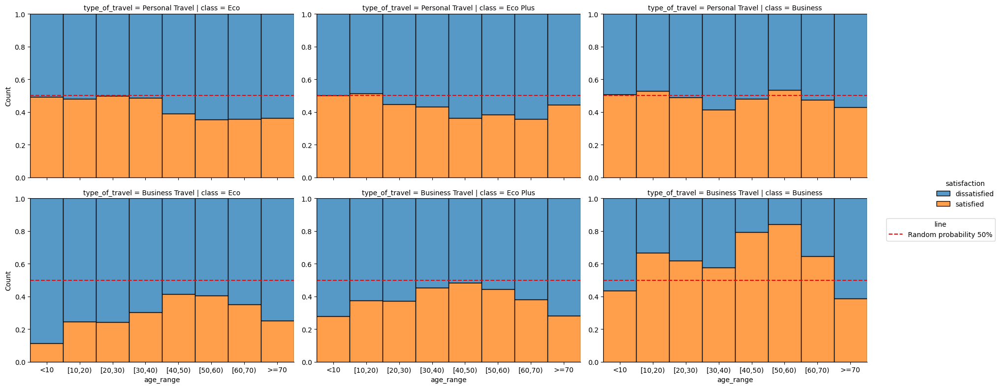

In [41]:
#################################################
#Keep Class ,travel type, trip distance,Departure_Delay constant
#trip distance Medium-Haul
#No Delay
#satisfaction by Age
#################################################
mask=(data_cat['flight_distance_class']=='Medium-Haul')&(data_cat['departure_delay_class']=='No Delay')
target_data=data_cat[mask]
g=sns.displot(
    data=target_data, x="age_range", hue="satisfaction", 
    row="type_of_travel",col="class",
    facet_kws={"sharey": False,"sharex": True},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='fill',stat='count'
)
g.refline(y=0.5,color="red",linestyle="--",label="Random probability 50%")
plt.legend(title='line',loc='upper right', bbox_to_anchor=(1.5, 0.9))
plt.show()

#For Medium-Haul
#=>For personal travel, most age group satisfied ratio were less than 50%, 
#  in Eco class, satisfied ratio dropped from age >=40, it might associated with physical strength, health, comfort
#  in Business class, satisfied ratio had minor change
#=>For business travel, satisfied ratio in Eco and Eco plus were all less than 50%, bell shape
#  in business class, most age group satisfied ratio were greater than 50%, except passengers younger than 10 or older than 70

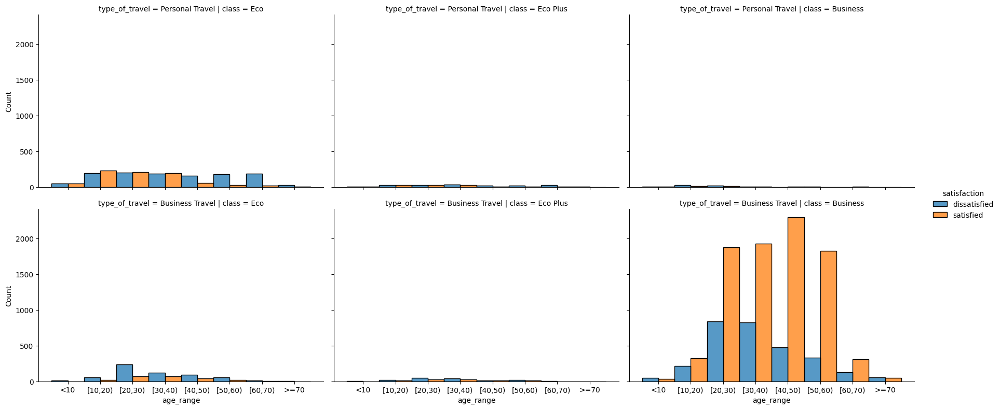

In [42]:
#################################################################
#Keep Class ,travel type, trip distance, Departure_Delay constant
#trip distance Long-Haul
#No Delay
#satisfaction count by age range
#################################################################
mask=(data_cat['flight_distance_class']=='Long-Haul')&(data_cat['departure_delay_class']=='No Delay')
target_data=data_cat[mask]
g=sns.displot(
    data=target_data, x="age_range", hue="satisfaction", 
    row="type_of_travel",col="class",
    facet_kws={"sharey": True,"sharex": True},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='dodge',stat='count'
)
plt.show()

#For Long-Haul
#=>most passengers were business travel business class, next was personal travel eco class 

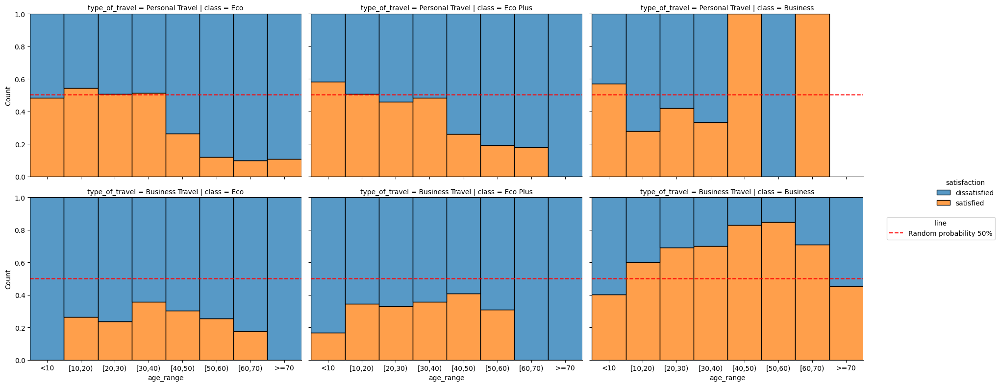

In [43]:
#################################################
#Keep Class ,travel type, trip distance,Departure_Delay constant
#trip distance Long-Haul
#No Delay
#satisfaction ratio by age range
#################################################
mask=(data_cat['flight_distance_class']=='Long-Haul')&(data_cat['departure_delay_class']=='No Delay')
target_data=data_cat[mask]
g=sns.displot(
    data=target_data, x="age_range", hue="satisfaction", 
    row="type_of_travel",col="class",
    facet_kws={"sharey": True,"sharex": True},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='fill',stat='count'
)

g.refline(y=0.5,color="red",linestyle="--",label="Random probability 50%")
plt.legend(title='line',loc='upper right', bbox_to_anchor=(1.5, 0.9))

plt.show()

#For Long-Haul
#=>For personal travel, most age group satisfied ratio were less or equal to 50%, 
#  in Eco class, satisfied ratio dropped from 50% to less than 30% from age >=40, it might associated with physical strength, health, comfort
#=>For business travel, satisfied ratio in Eco and Eco plus were all less than 50%, bell shape
#  in business class, most age group satisfied ratio were greater than 50%, except passengers younger than 10 or older than 70

### 1-4 satisfaction vs Type of Travel

In [44]:
pd.crosstab(df_original["satisfaction"],df_original["type_of_travel"],margins=True,normalize="all")

type_of_travel,Business Travel,Personal Travel,All
satisfaction,,,
dissatisfied,0.287473,0.165199,0.452672
satisfied,0.403111,0.144218,0.547328
All,0.690584,0.309416,1.000000


type_of_travel,satisfaction,Personal Travel,Business Travel
0,dissatisfied,21456,37337
1,satisfied,18731,52356


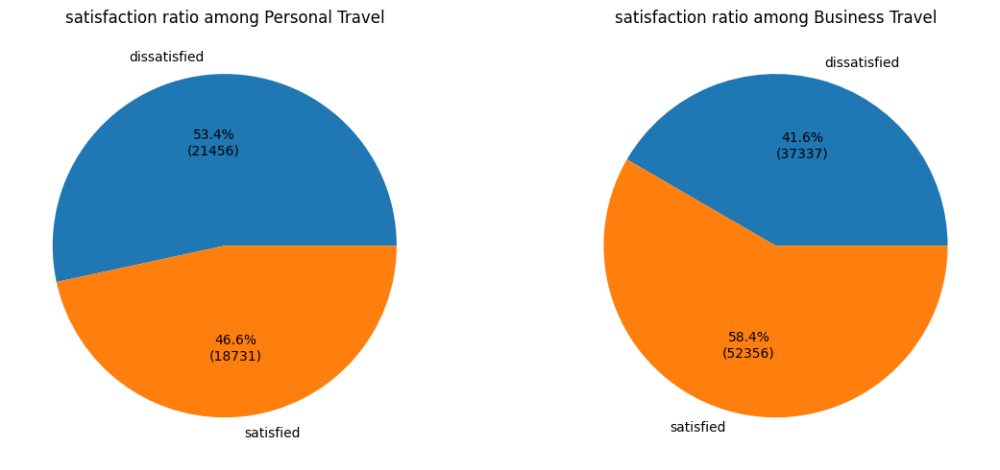

In [45]:
#######################################
#P(satisfaction | type_of_travel)
#######################################
result=pd.crosstab(data_cat['satisfaction'],data_cat['type_of_travel'],margins=False).reset_index()

display(result)
col_nm=travel_type_hue_order

#######################################
#Pie Chart
#######################################
colCnt=2
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(colCnt*6,rowCnt*5))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["satisfaction"], autopct=autopct_format(result[col]))
    ax.set_title(f"satisfaction ratio among {col}")
plt.tight_layout()
plt.show()
#=>among Business Travel, satisfied passenger is around 58.37%, which is a little higher than random probability 50%
#=>among Personal Travel, dissatisfied passenger is around 53%, which is close to random probability 50%

In [46]:
#######################################
#P(Type of Travel | satisfaction)
#######################################
pd.crosstab(df_original["satisfaction"],df_original["type_of_travel"],margins=True,normalize="index")
#=>among satisfied passengers, Business Travel is around 74%

type_of_travel,Business Travel,Personal Travel
satisfaction,,
dissatisfied,0.635059,0.364941
satisfied,0.736506,0.263494
All,0.690584,0.309416


### 1-5 satisfaction vs Class
### 1-5 satisfaction vs class_m

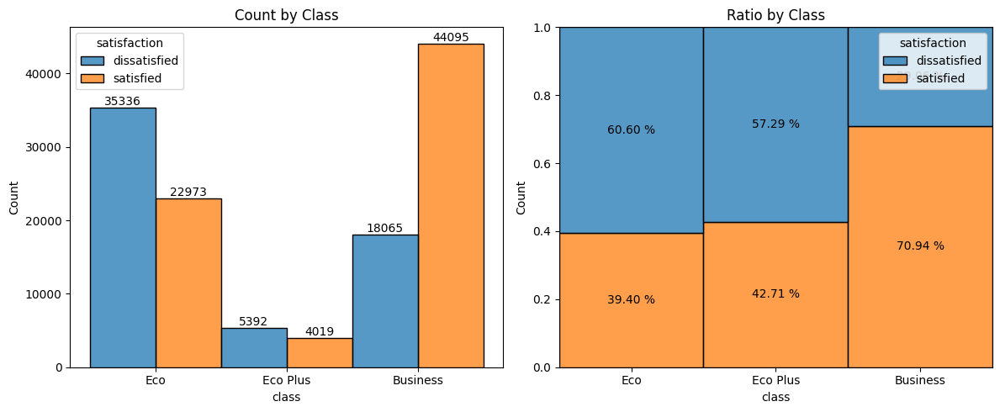

In [47]:
#######################################
#Bar Chart
#######################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
hue_order=satisfaction_hue_order

sns.histplot(data=data_cat, x='class',
                 discrete=True,stat='count',
                 hue='satisfaction',hue_order=hue_order,
                 multiple='dodge',ax=axs[0]
                )
for i in axs[0].containers:
    axs[0].bar_label(i)
    axs[0].set_title(var)
axs[0].set_title('Count by Class')

sns.histplot(data=data_cat, x='class',
                 discrete=True,stat='count',
                 hue='satisfaction',hue_order=hue_order,
                 multiple='fill',ax=axs[1]
                )
#https://stackoverflow.com/questions/67481922/display-percentage-labels-in-seaborn-displot
for p in axs[1].patches:
    h = p.get_height()
    if h > 0: # skip empty bars
        txt = f'{h * 100:.2f} %'
        txt_x = p.get_x() + p.get_width() / 2
        txt_y = p.get_y() + h / 2
        axs[1].text(txt_x, txt_y, txt, ha='center', va='center')
axs[1].set_title('Ratio by Class')

plt.tight_layout()
plt.show()


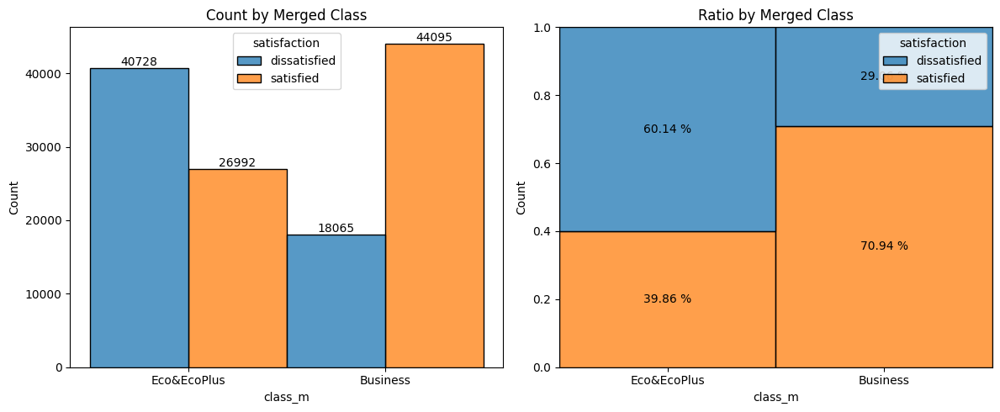

In [48]:
#######################################
#Bar Chart
#######################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
hue_order=satisfaction_hue_order

sns.histplot(data=data_cat, x='class_m',
                 discrete=True,stat='count',
                 hue='satisfaction',hue_order=hue_order,
                 multiple='dodge',ax=axs[0]
                )
for i in axs[0].containers:
    axs[0].bar_label(i)
    axs[0].set_title(var)
axs[0].set_title('Count by Merged Class')

sns.histplot(data=data_cat, x='class_m',
                 discrete=True,stat='count',
                 hue='satisfaction',hue_order=hue_order,
                 multiple='fill',ax=axs[1]
                )

#https://stackoverflow.com/questions/67481922/display-percentage-labels-in-seaborn-displot
for p in axs[1].patches:
    h = p.get_height()
    if h > 0: # skip empty bars
        txt = f'{h * 100:.2f} %'
        txt_x = p.get_x() + p.get_width() / 2
        txt_y = p.get_y() + h / 2
        axs[1].text(txt_x, txt_y, txt, ha='center', va='center')
axs[1].set_title('Ratio by Merged Class')

plt.tight_layout()
plt.show()

In [49]:
pd.crosstab(df_original["satisfaction"],df_original["class"],margins=True,normalize="all")

class,Business,Eco,Eco Plus,All
satisfaction,,,,
dissatisfied,0.139090,0.272067,0.041515,0.452672
satisfied,0.339506,0.176879,0.030944,0.547328
All,0.478596,0.448945,0.072459,1.000000


class,satisfaction,Eco,Eco Plus,Business
0,dissatisfied,35336,5392,18065
1,satisfied,22973,4019,44095


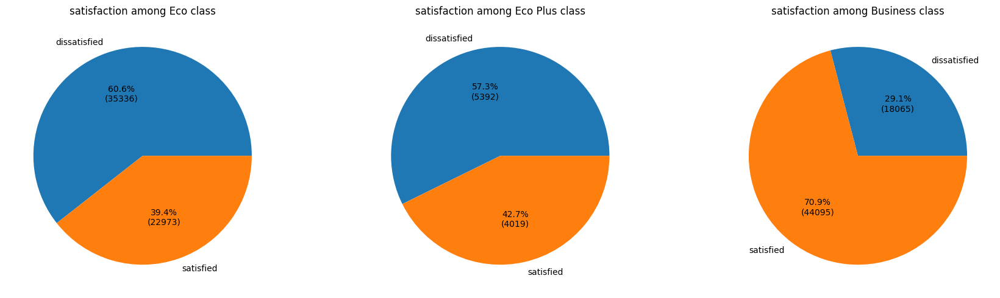

In [50]:
#######################################
#P(satisfaction | Class)
#######################################
result=pd.crosstab(data_cat['satisfaction'],data_cat['class'],margins=False).reset_index()

display(result)
col_nm=class_hue_order

#######################################
#Pie Chart
#######################################
colCnt=3
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(colCnt*6,rowCnt*5))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["satisfaction"], autopct=autopct_format(result[col]))
    ax.set_title(f"satisfaction among {col} class")
plt.tight_layout()
plt.show()
#=>among Business class, satisfied passenger is around 71%, which is higher than random probability 50%
#=>among Eco class, dissatisfied passenger is around 61%, which is higher than random probability 50%
#=>among Eco Plus class, dissatisfied passenger is around 57%, which is a little higher than random probability 50%

class_m,satisfaction,Eco&EcoPlus,Business
0,dissatisfied,40728,18065
1,satisfied,26992,44095


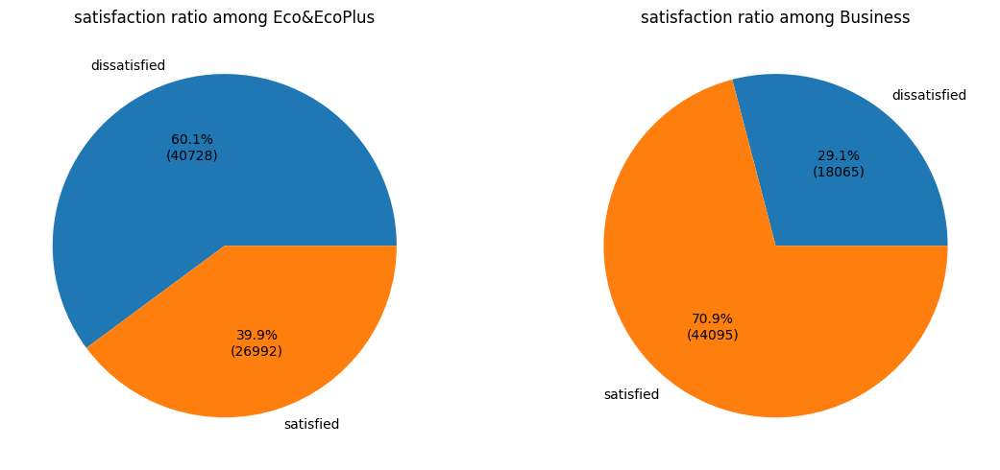

In [51]:
#######################################
#P(satisfaction | class_m)
#######################################
result=pd.crosstab(data_cat['satisfaction'],data_cat['class_m'],margins=False).reset_index()

display(result)
col_nm=class_merge_hue_order

#######################################
#Pie Chart
#######################################
colCnt=2
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(colCnt*6,rowCnt*5))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["satisfaction"], autopct=autopct_format(result[col]))
    ax.set_title(f"satisfaction ratio among {col}")
plt.tight_layout()
plt.show()

### 1-6 satisfaction vs Flight Distance

In [52]:
data_cat.groupby(['satisfaction'])['flight_distance'].describe()

,count,mean,std,min,25%,50%,75%,max
satisfaction,,,,,,,,
dissatisfied,58793.0,2025.709234,888.148947,50.0,1520.0,1955.0,2462.0,6951.0
satisfied,71087.0,1944.770281,1127.893115,50.0,1070.0,1886.0,2627.0,6950.0


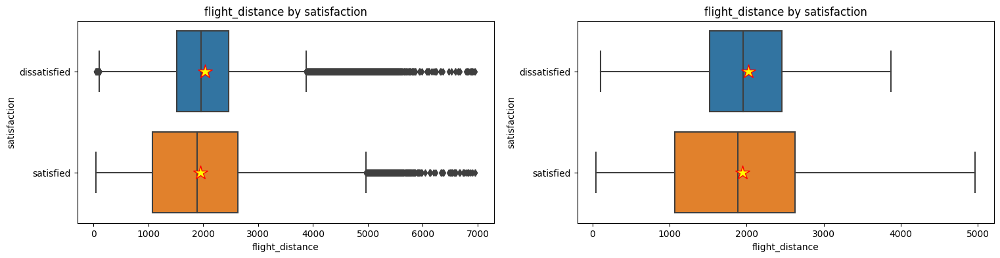

In [53]:
######################################################
#Box plot of flight_distance by satisfaction
######################################################
fig, axs = plt.subplots(1,2,figsize=(18,4))
sns.boxplot(data=data_cat, y="satisfaction",x="flight_distance",ax=axs[0],
            showmeans=True,
            meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})

sns.boxplot(data=data_cat, y="satisfaction",x="flight_distance",ax=axs[1],
            showfliers=False,
            showmeans=True,
            meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})
axs[0].set_title("flight_distance by satisfaction")
axs[1].set_title("flight_distance by satisfaction")

plt.show()

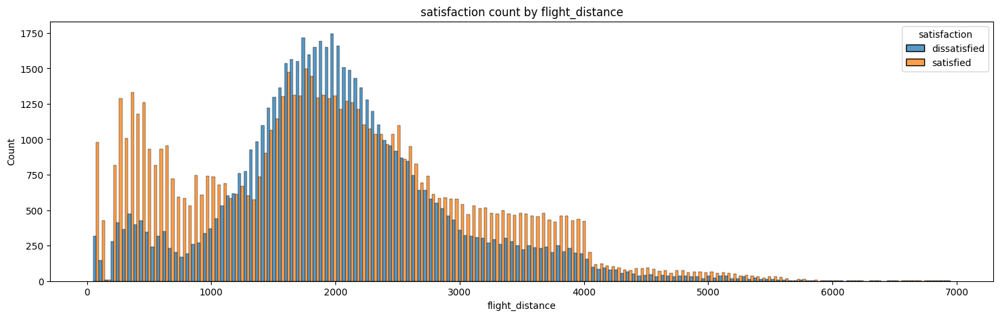

In [54]:
#################################################
#satisfaction count by flight_distance Delay
#################################################
plt.figure(figsize=(18,5))
hue_order=satisfaction_hue_order

sns.histplot(data=data_cat, x="flight_distance",hue='satisfaction'
             , multiple="dodge",hue_order=hue_order)
#set title
plt.title("satisfaction count by flight_distance")

plt.show()

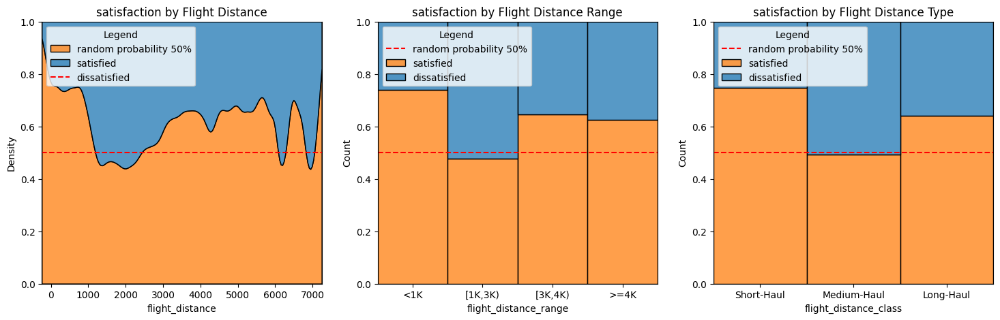

In [55]:
fig, axs = plt.subplots(1,3,figsize=(18,5))
hue_order=satisfaction_hue_order

sns.kdeplot(data=data_cat, x="flight_distance",hue='satisfaction', multiple="fill",ax=axs[0],hue_order=hue_order)
sns.histplot(data=data_cat, x="flight_distance_range",hue='satisfaction', multiple="fill",ax=axs[1],hue_order=hue_order)
sns.histplot(data=data_cat, x="flight_distance_class",hue='satisfaction', multiple="fill",ax=axs[2],hue_order=hue_order)

#set 50% random probability line
axs[0].axhline(0.5,color="red",linestyle="--",label="random probability 50%")
axs[1].axhline(0.5,color="red",linestyle="--",label="random probability 50%")
axs[2].axhline(0.5,color="red",linestyle="--",label="random probability 50%")

#set title
axs[0].set_title("satisfaction by Flight Distance")
axs[1].set_title("satisfaction by Flight Distance Range")
axs[2].set_title("satisfaction by Flight Distance Type")

#edit legend
handles, labels = axs[0].get_legend_handles_labels()
axs[0].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
handles, labels = axs[1].get_legend_handles_labels()
axs[1].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
handles, labels = axs[2].get_legend_handles_labels()
axs[2].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])


plt.show()

#=>distance around 1200-2500 seems less satisfied
#=>short distance(<1K) seems relatively satisfied

### 1-6-(2,5) satisfaction VS flight_distance by Class & type_of_travel

In [56]:
data_cat.groupby(['class','type_of_travel','satisfaction'])['flight_distance'].describe()

count         mean          std  \
class    type_of_travel  satisfaction                                      
Eco      Personal Travel dissatisfied  17610.0  2029.942817   734.139873   
                         satisfied     15395.0  1588.253784   890.622933   
         Business Travel dissatisfied  17726.0  1881.670315   687.634109   
                         satisfied      7578.0  1691.386909   781.912467   
Eco Plus Personal Travel dissatisfied   2415.0  2025.775155   731.168837   
                         satisfied      2094.0  1526.145654   911.268873   
         Business Travel dissatisfied   2977.0  1846.891166   792.776821   
                         satisfied      1925.0  1692.094026   822.212726   
Business Personal Travel dissatisfied   1431.0  1460.488470   964.966869   
                         satisfied      1242.0  1352.922705   883.156900   
         Business Travel dissatisfied  16634.0  2255.340928  1155.651899   
                         satisfied     42853.0  2166.616760  1223.090482   

                                        min      25%     50%      75%     max  
class    type_of_travel  satisfaction                                          
Eco      Personal Travel dissatisfied  50.0  1579.25  1967.0  2394.75  6924.0  
                         satisfied     50.0   862.00  1624.0  2165.00  6792.0  
         Business Travel dissatisfied  50.0  1495.00  1884.0  2273.00  6595.0  
                         satisfied     50.0  1241.25  1737.5  2177.00  6816.0  
Eco Plus Personal Travel dissatisfied  50.0  1576.00  1952.0  2384.00  6889.0  
                         satisfied     50.0   731.25  1536.0  2098.75  6598.0  
         Business Travel dissatisfied  54.0  1421.00  1854.0  2264.00  6324.0  
                         satisfied     52.0  1225.00  1741.0  2180.00  6733.0  
Business Personal Travel dissatisfied  55.0   625.00  1349.0  2114.00  6865.0  
                         satisfied     51.0   586.25  1250.5  1989.50  6591.0  
         Business Travel dissatisfied  51.0  1538.00  2139.0  3012.00  6951.0  
                         satisfied     50.0  1250.00  2131.0  3057.00  6950.0

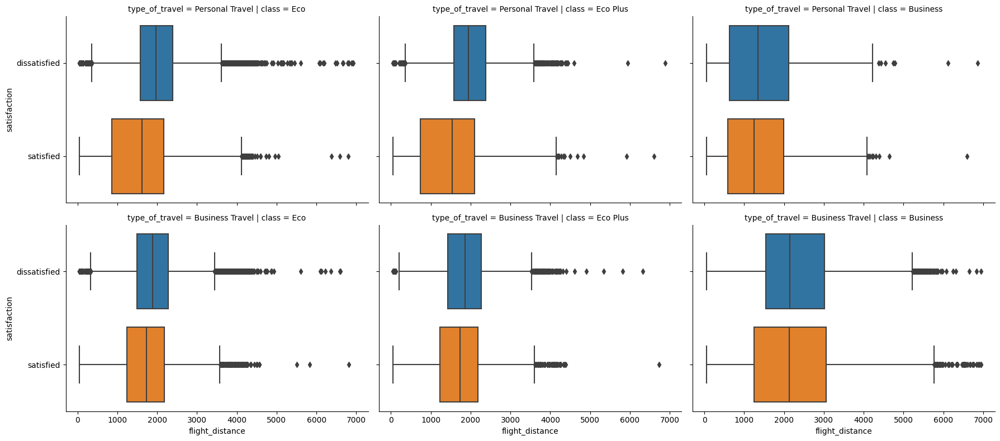

In [57]:
######################################################
#Keep class and type_of_travel constant
#Box plot of flight_distance by satisfaction
######################################################
g = sns.catplot(
    data=data_cat, x="flight_distance", y="satisfaction", col="class",
    row='type_of_travel',kind="box", height=4, aspect=1.5,
)


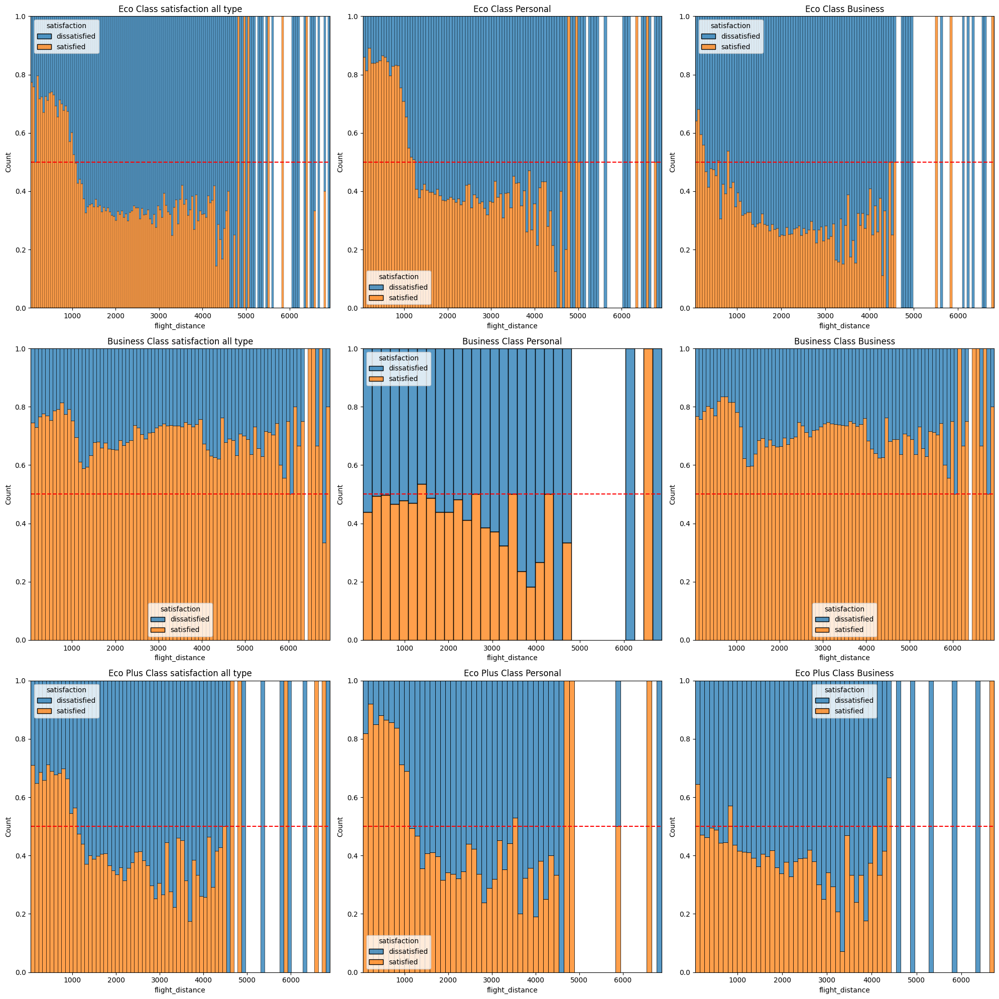

In [58]:
#####################################################################################
#Keep Class and Travel Type constant
#satisdaction ratio by distance
#####################################################################################
fig,axs=plt.subplots(3,3,sharey=False,sharex=False,figsize=(20,20))
class_item=data_cat["class"].unique()
hue_order=satisfaction_hue_order
for i, class_type in zip(range(len(class_item)), class_item):
    mask=data_cat["class"]==class_type
    mask_personal=data_cat[mask]['type_of_travel']=='Personal Travel'
    mask_business=data_cat[mask]['type_of_travel']=='Business Travel'
    target_data=data_cat[mask]
    sns.histplot(data=target_data, x="flight_distance",ax=axs[i][0]
                 ,hue='satisfaction', multiple="fill",hue_order=hue_order)
    sns.histplot(data=target_data[mask_personal], x="flight_distance",ax=axs[i][1]
                 ,hue='satisfaction', multiple="fill",hue_order=hue_order)
    sns.histplot(data=target_data[mask_business], x="flight_distance",ax=axs[i][2]
                 ,hue='satisfaction', multiple="fill",hue_order=hue_order)
    
    axs[i][0].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][1].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][2].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    
    axs[i][0].set_title(f'{class_type} Class satisfaction all type')
    axs[i][1].set_title(f'{class_type} Class Personal')
    axs[i][2].set_title(f'{class_type} Class Business')
plt.tight_layout()
plt.show()
#=>for Personal travel ,when distance increase satisfied ratio tend to decrease(all class)
#=>for Business Travel ,when distance increase satisfied ratio tend to decrease(Eco and Eco Plus)


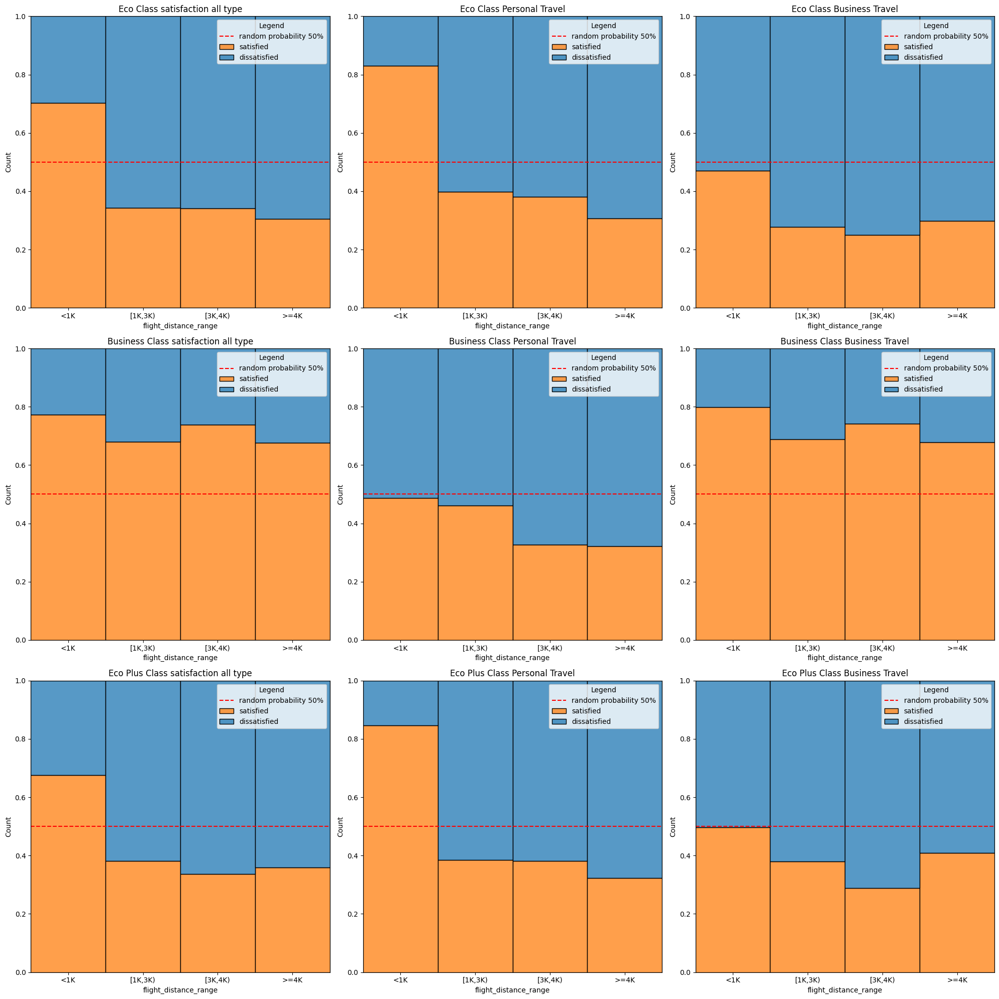

In [59]:
#####################################################################################
#plot of satisfaction of distance range by different Class and travel type
#####################################################################################
fig,axs=plt.subplots(3,3,sharey=False,sharex=False,figsize=(20,20))
class_item=data_cat["class"].unique()
hue_order=satisfaction_hue_order

for i, class_type in zip(range(len(class_item)), class_item):
    mask=data_cat["class"]==class_type
    mask_personal=data_cat[mask]['type_of_travel']=='Personal Travel'
    mask_business=data_cat[mask]['type_of_travel']=='Business Travel'
    target_data=data_cat[mask]
    sns.histplot(data=target_data, x="flight_distance_range",hue='satisfaction'
                 , multiple="fill",ax=axs[i][0],hue_order=hue_order)
    sns.histplot(data=target_data[mask_personal], x="flight_distance_range",hue='satisfaction'
                 , multiple="fill",ax=axs[i][1],hue_order=hue_order)
    sns.histplot(data=target_data[mask_business], x="flight_distance_range",hue='satisfaction'
                 , multiple="fill",ax=axs[i][2],hue_order=hue_order)
    
    #set 50% random probability line
    axs[i][0].axhline(0.5,color="red",linestyle="--",label="random probability 50%")
    axs[i][1].axhline(0.5,color="red",linestyle="--",label="random probability 50%")
    axs[i][2].axhline(0.5,color="red",linestyle="--",label="random probability 50%")

    axs[i][0].set_title(f'{class_type} Class satisfaction all type')
    axs[i][1].set_title(f'{class_type} Class Personal Travel')
    axs[i][2].set_title(f'{class_type} Class Business Travel')
    
    #edit legend
    handles, labels = axs[i][0].get_legend_handles_labels()
    axs[i][0].legend(title='Legend',loc='upper right',labels=labels+hue_order[::-1])
    handles, labels = axs[i][1].get_legend_handles_labels()
    axs[i][1].legend(title='Legend',loc='upper right',labels=labels+hue_order[::-1])
    handles, labels = axs[i][2].get_legend_handles_labels()
    axs[i][2].legend(title='Legend',loc='upper right',labels=labels+hue_order[::-1])

plt.tight_layout()
plt.show()

#=>for business trip, only business class passengers are relatively satisfied(for all distance range)
#Eco class and Eco Plus business trip are relatively dissatisfied(for all distance range, all less than 50%)
#=>no matter what class and trip type, short trip(<1K) are the most satisfied

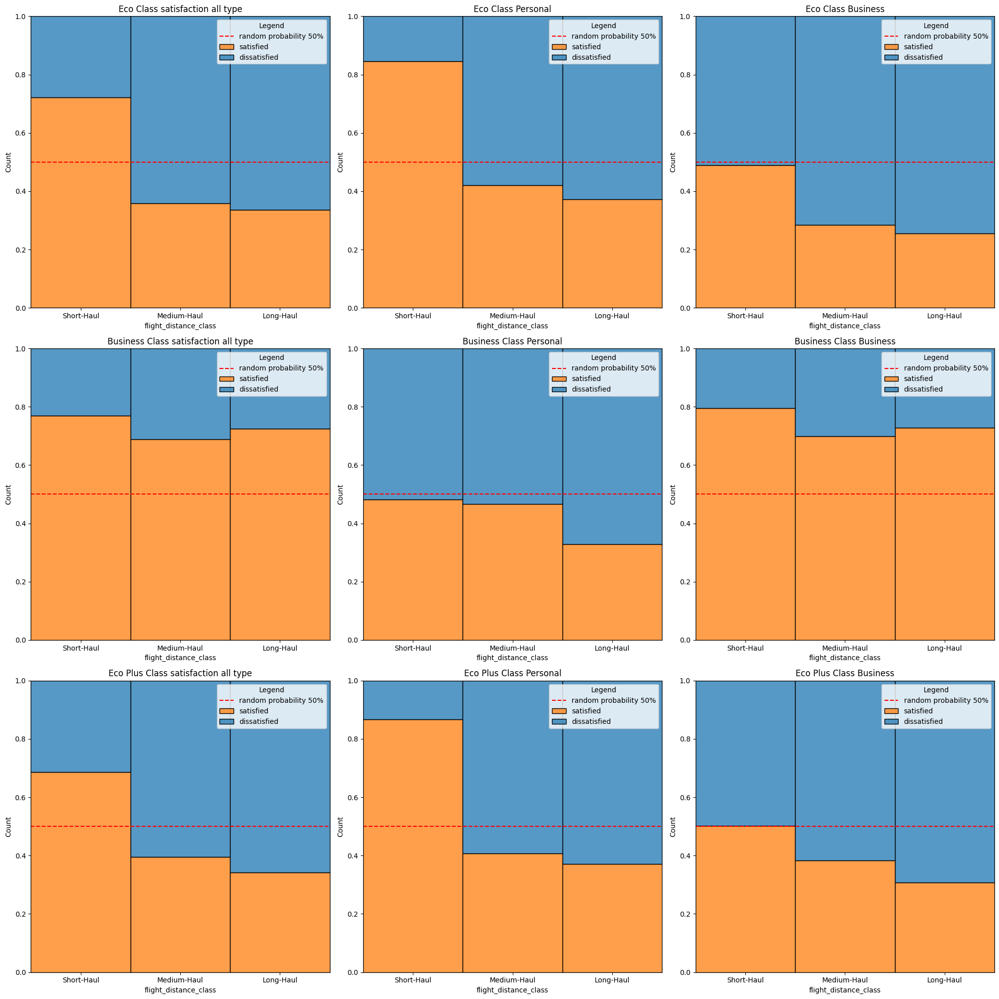

In [60]:
#####################################################################################
#plot of satisfaction of distance range by different Class and travel type
#####################################################################################
fig,axs=plt.subplots(3,3,sharey=False,sharex=False,figsize=(20,20))
class_item=data_cat["class"].unique()
hue_order=satisfaction_hue_order

for i, class_type in zip(range(len(class_item)), class_item):
    mask=data_cat["class"]==class_type
    mask_personal=data_cat[mask]['type_of_travel']=='Personal Travel'
    mask_business=data_cat[mask]['type_of_travel']=='Business Travel'
    target_data=data_cat[mask]
    sns.histplot(data=target_data, x="flight_distance_class",hue='satisfaction'
                 , multiple="fill",ax=axs[i][0],hue_order=hue_order)
    sns.histplot(data=target_data[mask_personal], x="flight_distance_class",hue='satisfaction'
                 , multiple="fill",ax=axs[i][1],hue_order=hue_order)
    sns.histplot(data=target_data[mask_business], x="flight_distance_class",hue='satisfaction'
                 , multiple="fill",ax=axs[i][2],hue_order=hue_order)
    
    #set 50% random probability line
    axs[i][0].axhline(0.5,color="red",linestyle="--",label="random probability 50%")
    axs[i][1].axhline(0.5,color="red",linestyle="--",label="random probability 50%")
    axs[i][2].axhline(0.5,color="red",linestyle="--",label="random probability 50%")

    axs[i][0].set_title(f'{class_type} Class satisfaction all type')
    axs[i][1].set_title(f'{class_type} Class Personal')
    axs[i][2].set_title(f'{class_type} Class Business')
    
    #edit legend
    handles, labels = axs[i][0].get_legend_handles_labels()
    axs[i][0].legend(title='Legend',loc='upper right',labels=labels+hue_order[::-1])
    handles, labels = axs[i][1].get_legend_handles_labels()
    axs[i][1].legend(title='Legend',loc='upper right',labels=labels+hue_order[::-1])
    handles, labels = axs[i][2].get_legend_handles_labels()
    axs[i][2].legend(title='Legend',loc='upper right',labels=labels+hue_order[::-1])

plt.tight_layout()
plt.show()
#=>except business travel business class, as distance increase satisfied ratio tends to decrease

### 1-(7~20)satisfaction VS Rating Items

In [61]:
#rating items
var_num=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
df_original.groupby(["satisfaction"])[var_num].mean()
#=>dissatisfied > satisfied : Departure/Arrival time convenient, Gate location, Baggage handling

,seat_comfort,departure_arrival_time_convenient,food_and_drink,gate_location,inflight_wifi_service,inflight_entertainment,online_support,ease_of_online_booking,on_board_service,leg_room_service,baggage_handling,checkin_service,cleanliness,online_boarding
satisfaction,,,,,,,,,,,,,,
dissatisfied,2.467335,3.016686,2.660419,3.007756,2.919854,2.608644,2.959213,2.852261,2.973126,3.052625,3.364601,2.971850,3.377324,2.869695
satisfied,3.145653,2.969108,3.010438,2.976086,3.521460,4.024308,3.983260,3.984751,3.871946,3.844247,3.969488,3.645955,3.977394,3.751966


In [62]:
#rating items
var_num=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
df_original.groupby(["satisfaction"])[var_num].median()
#=>satisfied passengers, Seat comfort ,Inflight wifi service , Checkin service is higher than total sample median
#=>dissatisfied passengers, Departure/Arrival time convenient, Food and drink, 
###Gate location, Inflight wifi service,Checkin service,Cleanliness  is equal to total sample median, others were lower than total


,seat_comfort,departure_arrival_time_convenient,food_and_drink,gate_location,inflight_wifi_service,inflight_entertainment,online_support,ease_of_online_booking,on_board_service,leg_room_service,baggage_handling,checkin_service,cleanliness,online_boarding
satisfaction,,,,,,,,,,,,,,
dissatisfied,2.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,4.0,3.0
satisfied,4.0,3.0,3.0,3.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0


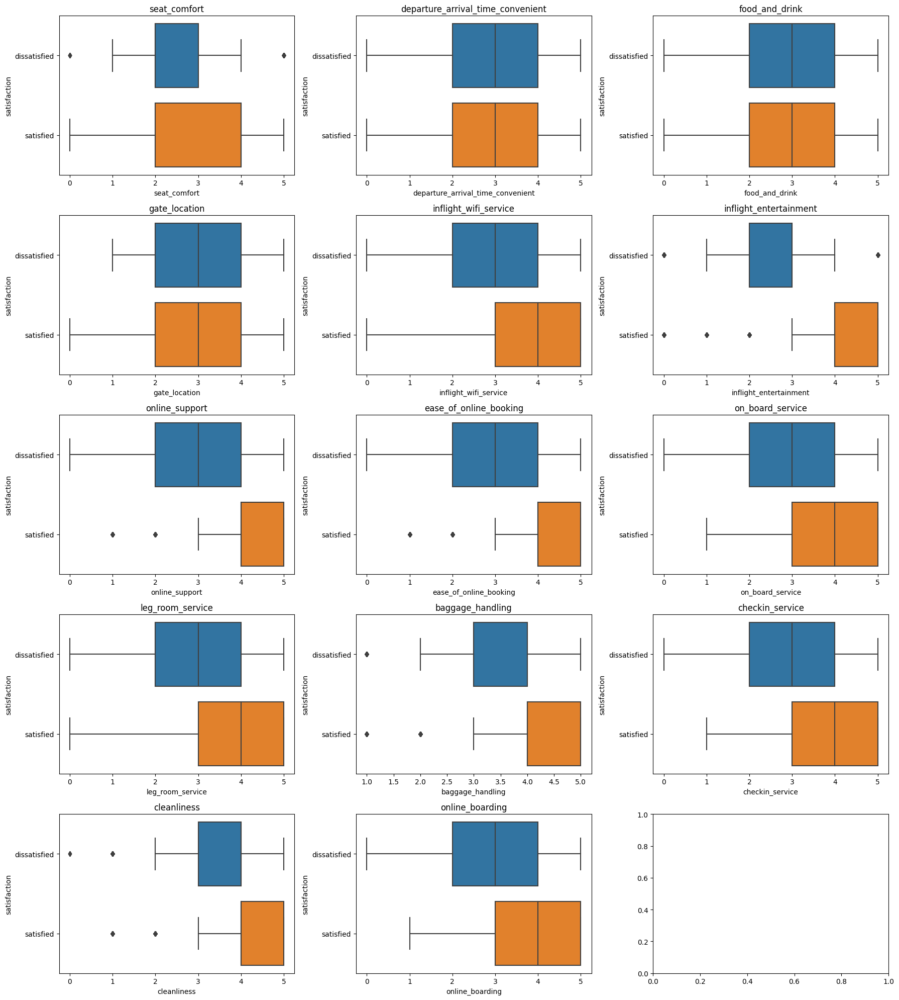

In [63]:
#################################################
#Boxplot
#rating item
#################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,20))
var_num=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
hue_order=satisfaction_hue_order
for var,ax in zip(var_num,axs.ravel()):
    sns.boxplot(data=data_cat, x=data_cat[var].astype(int),ax=ax, 
             hue_order=hue_order, y="satisfaction")
    ax.set_title(var)
plt.tight_layout()
plt.show()

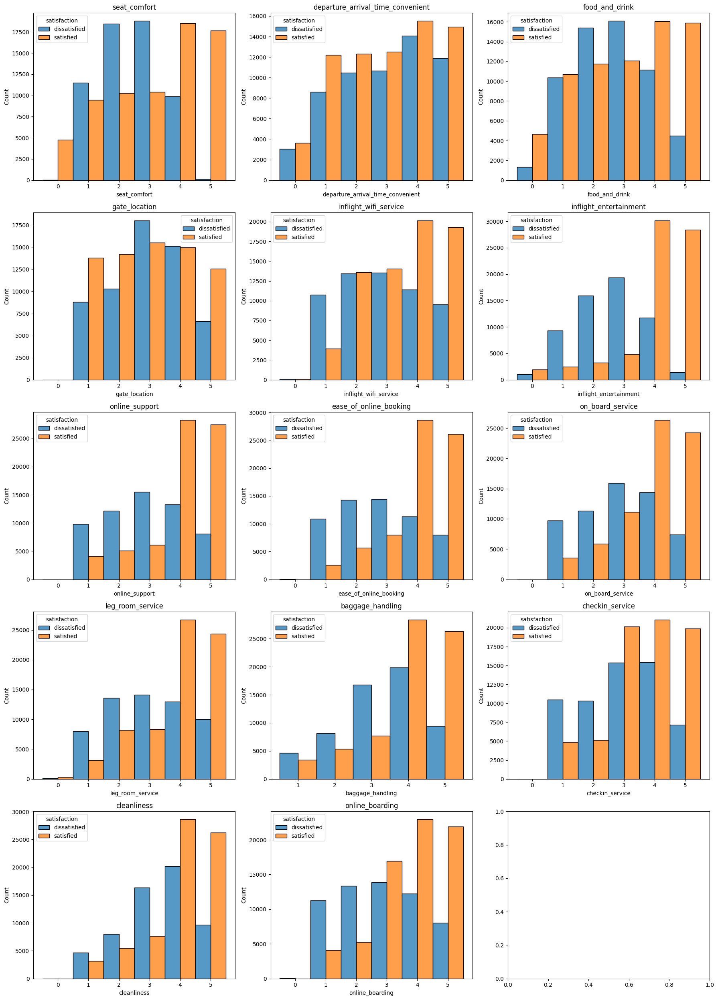

In [64]:
#################################################
#Histgram 
#survey rating items
#by count
#################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
var_num=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
hue_order=satisfaction_hue_order
for var,ax in zip(var_num,axs.ravel()):
    sns.histplot(data=data_cat, x=var,ax=ax, 
             hue="satisfaction",element="bars", legend=True,
             stat="count", multiple="dodge",kde=False,hue_order=hue_order)
    ax.set_title(var)
plt.tight_layout()
plt.show()

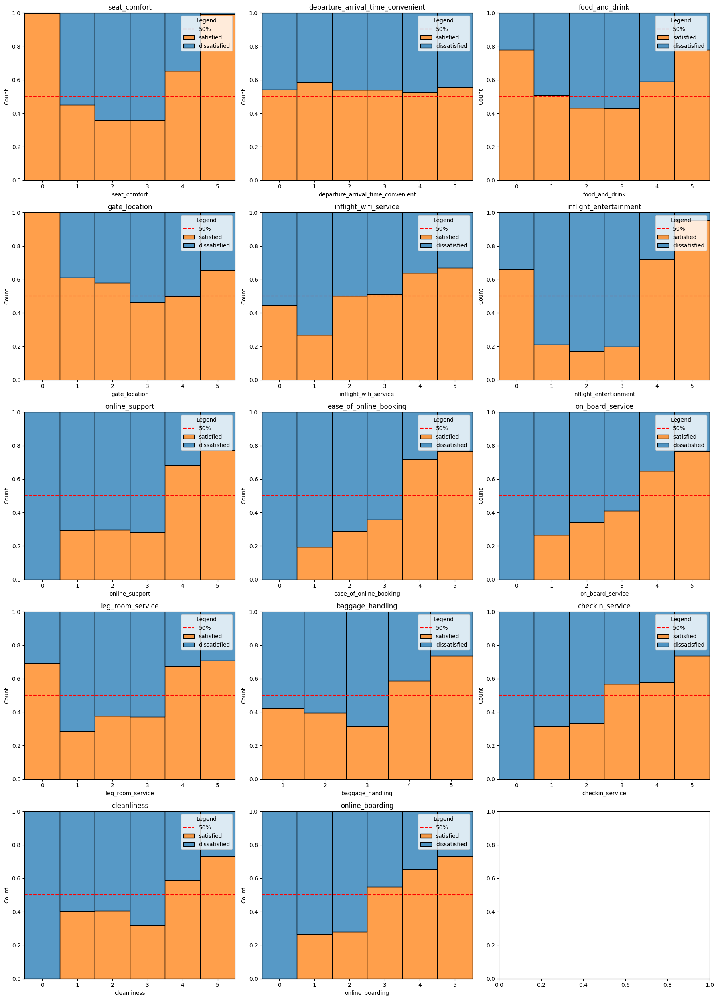

In [65]:
#################################################
#by proportion
#survey rating item
#################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
var_num=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
hue_order=satisfaction_hue_order
for var,ax in zip(var_num,axs.ravel()):
    sns.histplot(data=data_cat, x=var,hue='satisfaction', multiple="fill"
                 ,ax=ax,hue_order=hue_order,legend=True,discrete=True)
    ax.axhline(0.5,color="red",linestyle="--",label="50%")
    ax.set_title(var)
    #edit legend
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(title='Legend',loc='upper right',labels=labels+hue_order[::-1])

plt.tight_layout()
plt.show()
#if proportion of satisfied increase when rating increase/decrease, it would indecate that rating item might associated with satisfaction
#about 'Inflight entertainment'
#=>almost no change rating 1->3
#=>increase rating 4->5
#=>around 70% gave 0 point but they are satisfied passenger
###It might because
####=>'Inflight entertainment' is not an important factor to their flight(e.g very short trip)
####=>'Inflight entertainment' is not an important factor to those passengers

##The bellow items have similar trend(give 0 point but most of them are satisfied)
#==>'Seat comfort', 'Food and drink', 'Gate location', ('Inflight wifi service'),'Inflight entertainment', 'Leg room service'

##Except 'Departure/Arrival time convenient', all items show increase trend after a certain point

### 1-(7~20)satisfaction VS Rating Items class

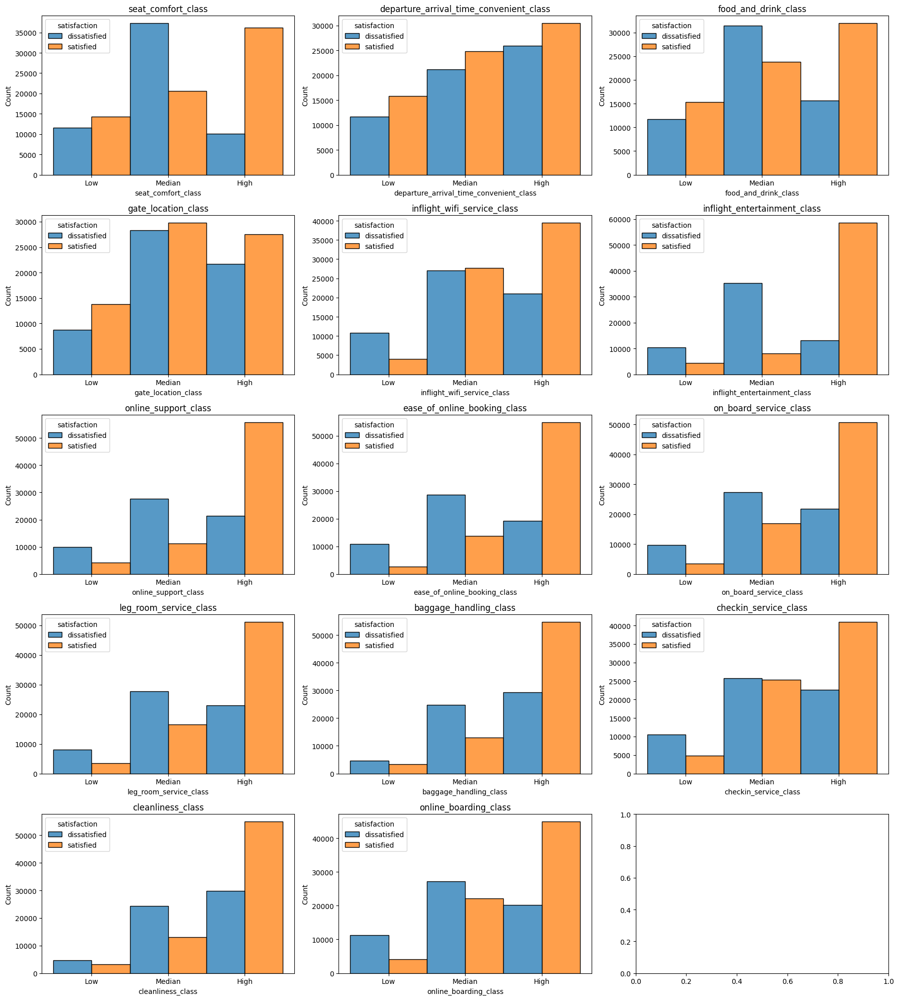

In [66]:
###############################################
#histplot
#Check survey rating
#By satisfaction
###############################################
hue_order=satisfaction_hue_order
chk_columns_list=['seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']

fig, axs = plt.subplots(5,3,figsize=(18,20))
for col, ax in zip(chk_columns_list, axs.ravel()):
    sns.histplot(data=data_cat, x=col,
                 discrete=True,stat='count',
                 hue='satisfaction',hue_order=hue_order,
                 multiple='dodge',ax=ax
                )
    ax.set_title(col)
plt.tight_layout()
plt.show()

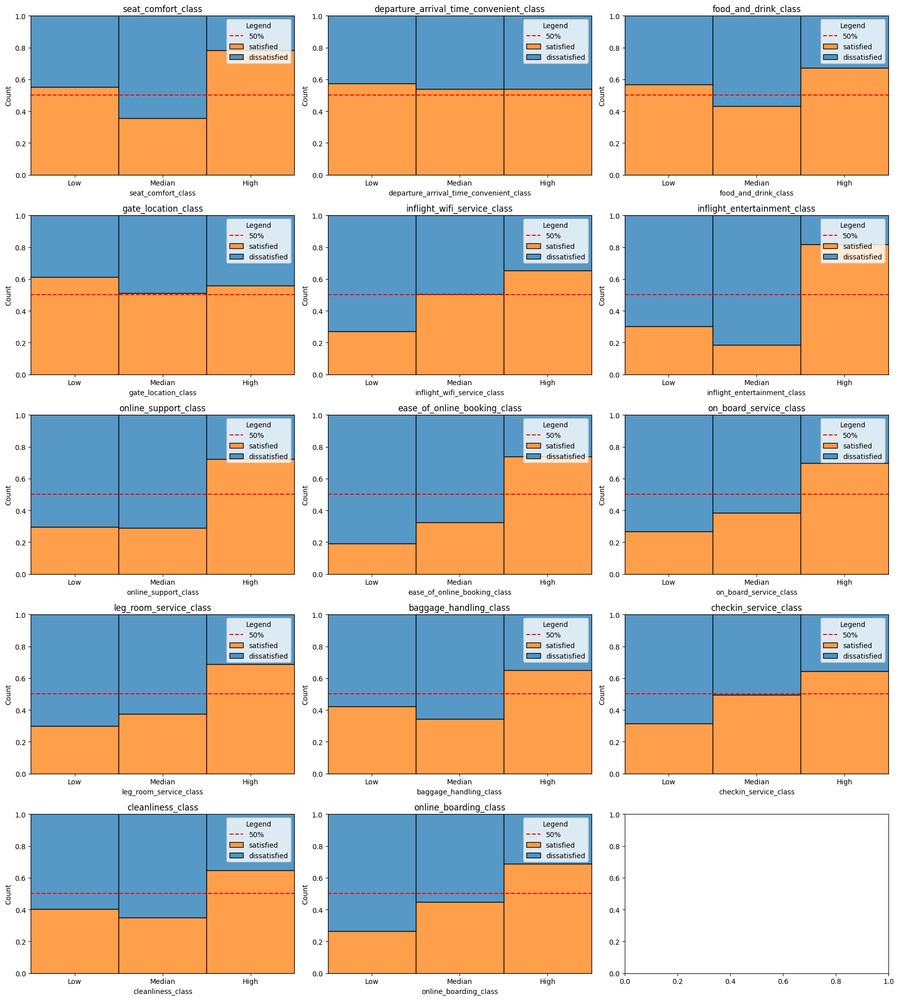

In [67]:
#################################################
#Check survey rating
#By satisfaction
#proportion
#rating item class
#################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,20))
var_num=['seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']
hue_order=satisfaction_hue_order
for var,ax in zip(var_num,axs.ravel()):
    sns.histplot(data=data_cat, x=var,hue='satisfaction', multiple="fill"
                 ,ax=ax,hue_order=hue_order,legend=True,discrete=True)
    ax.axhline(0.5,color="red",linestyle="--",label="50%")
    ax.set_title(var)
    #edit legend
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(title='Legend',loc='upper right',labels=labels+hue_order[::-1])

plt.tight_layout()
plt.show()

### 1-21 satisfaction vs Departure Delay in Minutes

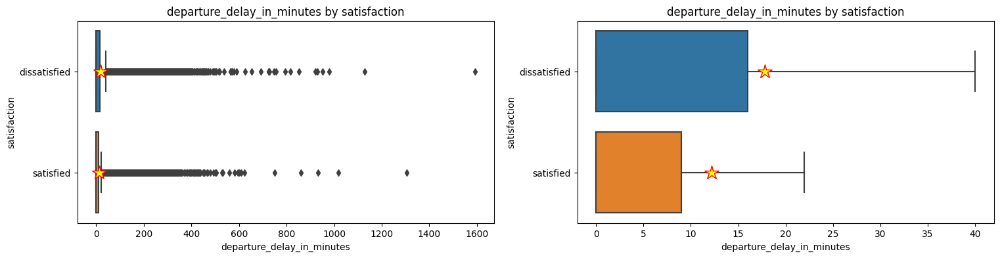

In [68]:
######################################################
#Box plot of departure_delay_in_minutes by satisfaction
######################################################
fig, axs = plt.subplots(1,2,figsize=(18,4))
sns.boxplot(data=data_cat, y="satisfaction",x="departure_delay_in_minutes",ax=axs[0],
            showmeans=True,
            meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})
sns.boxplot(data=data_cat, y="satisfaction",x="departure_delay_in_minutes",ax=axs[1],
            showfliers=False,
            showmeans=True,
            meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})
axs[0].set_title("departure_delay_in_minutes by satisfaction")
axs[1].set_title("departure_delay_in_minutes by satisfaction")

plt.show()
#=>mean departure_delay_in_minutes of satisfied passengers seems to be shorter than dissatisfied passengers

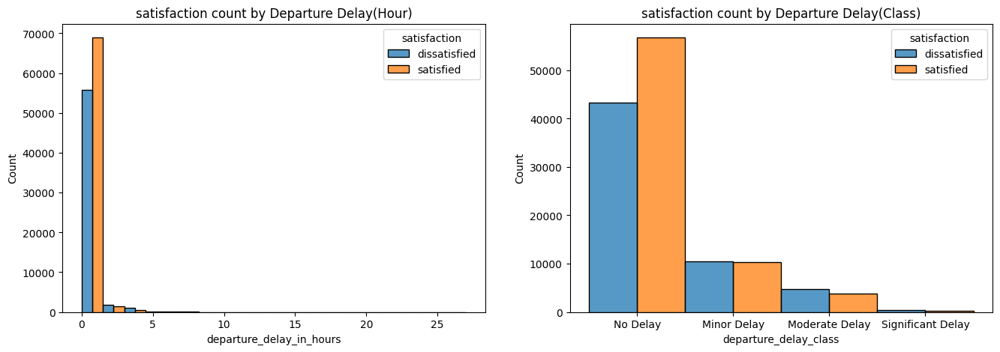

In [69]:
#################################################
#satisfaction count by Departure Delay
#################################################
fig, axs = plt.subplots(1,2,figsize=(16,5))
hue_order=satisfaction_hue_order
sns.histplot(data=data_cat, x="departure_delay_in_hours",hue='satisfaction'
             , multiple="dodge",ax=axs[0],hue_order=hue_order)
sns.histplot(data=data_cat, x="departure_delay_class",hue='satisfaction'
             , multiple="dodge",ax=axs[1],hue_order=hue_order)

#set title
axs[0].set_title("satisfaction count by Departure Delay(Hour)")
axs[1].set_title("satisfaction count by Departure Delay(Class)")

plt.show()

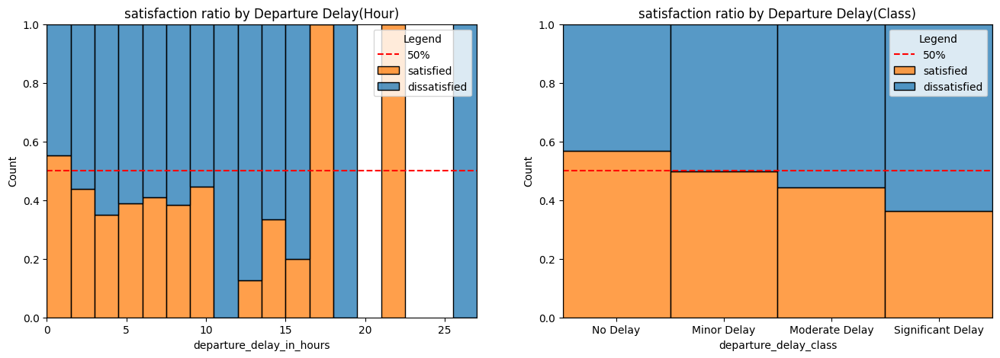

In [70]:
#################################################
#satisfaction ratio by Departure Delay
#################################################
fig, axs = plt.subplots(1,2,figsize=(16,5))
hue_order=satisfaction_hue_order
sns.histplot(data=data_cat, x="departure_delay_in_hours",hue='satisfaction'
             , multiple="fill",ax=axs[0],hue_order=hue_order)
sns.histplot(data=data_cat, x="departure_delay_class",hue='satisfaction'
             , multiple="fill",ax=axs[1],hue_order=hue_order)

#set 50% random probability line
axs[0].axhline(0.5,color="red",linestyle="--",label="50%")
axs[1].axhline(0.5,color="red",linestyle="--",label="50%")

#set title
axs[0].set_title("satisfaction ratio by Departure Delay(Hour)")
axs[1].set_title("satisfaction ratio by Departure Delay(Class)")

#edit legend
handles, labels = axs[0].get_legend_handles_labels()
axs[0].legend(title='Legend',loc='upper right',labels=labels+hue_order[::-1])
handles, labels = axs[1].get_legend_handles_labels()
axs[1].legend(title='Legend',loc='upper right',labels=labels+hue_order[::-1])

plt.show()
#=>when the delay time gets longer, passengers tends to be less satisfied

### 1-22 satisfaction vs Arrival Delay in Minutes

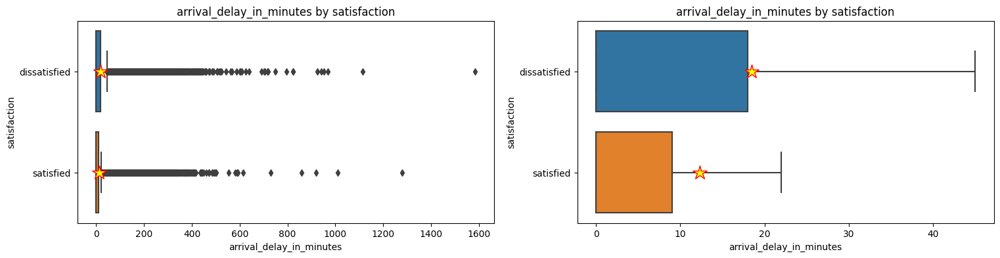

In [71]:
##########################################
#Box plot of arrival_delay_in_minutes by satisfaction
##########################################

fig, axs = plt.subplots(1,2,figsize=(18,4))
sns.boxplot(data=data_cat, y="satisfaction",x="arrival_delay_in_minutes",ax=axs[0],
            showmeans=True,
            meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})
sns.boxplot(data=data_cat, y="satisfaction",x="arrival_delay_in_minutes",ax=axs[1],
            showfliers=False,
            showmeans=True,
            meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})
axs[0].set_title("arrival_delay_in_minutes by satisfaction")
axs[1].set_title("arrival_delay_in_minutes by satisfaction")

plt.show()

#=>mean arrival_delay_in_minutes of satisfied passengers seems to be shorter than dissatisfied passengers

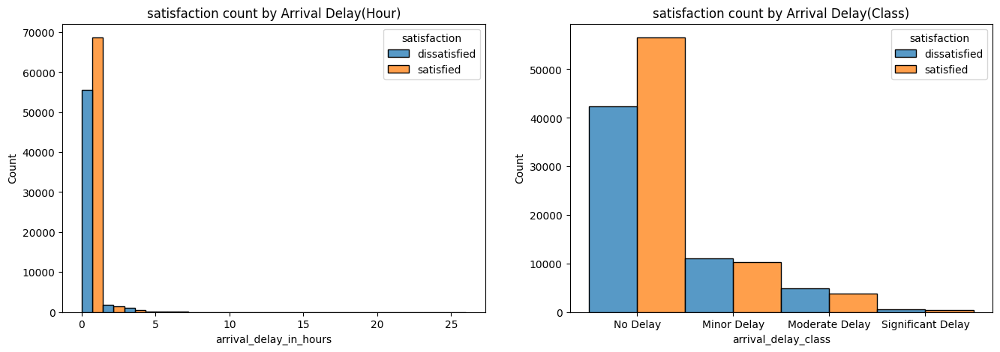

In [72]:
#################################################
#satisfaction count by Arrival Delay
#################################################
fig, axs = plt.subplots(1,2,figsize=(16,5))
hue_order=satisfaction_hue_order

sns.histplot(data=data_cat, x="arrival_delay_in_hours",hue='satisfaction'
             , multiple="dodge",ax=axs[0],hue_order=hue_order)
sns.histplot(data=data_cat, x="arrival_delay_class",hue='satisfaction'
             , multiple="dodge",ax=axs[1],hue_order=hue_order)


#set title
axs[0].set_title("satisfaction count by Arrival Delay(Hour)")
axs[1].set_title("satisfaction count by Arrival Delay(Class)")

plt.show()

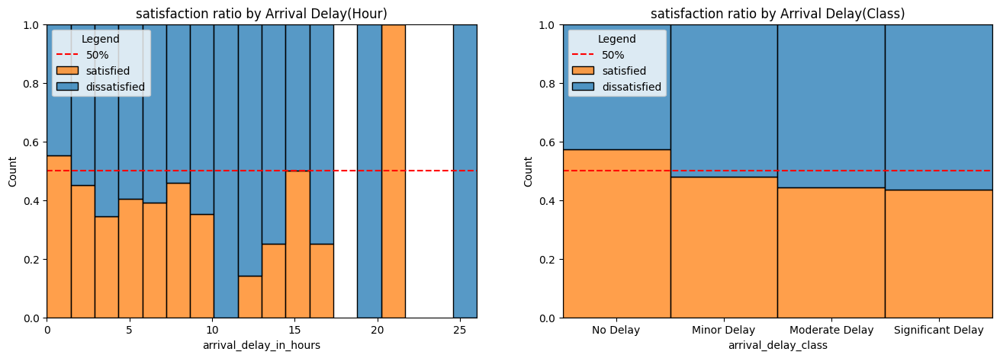

In [73]:
#################################################
#satisfaction ratio by Arrival Delay
#################################################
fig, axs = plt.subplots(1,2,figsize=(16,5))
hue_order=satisfaction_hue_order

sns.histplot(data=data_cat, x="arrival_delay_in_hours",hue='satisfaction'
             , multiple="fill",ax=axs[0],hue_order=hue_order)
sns.histplot(data=data_cat, x="arrival_delay_class",hue='satisfaction'
             , multiple="fill",ax=axs[1],hue_order=hue_order)

#set 50% random probability line
axs[0].axhline(0.5,color="red",linestyle="--",label="50%")
axs[1].axhline(0.5,color="red",linestyle="--",label="50%")

#set title
axs[0].set_title("satisfaction ratio by Arrival Delay(Hour)")
axs[1].set_title("satisfaction ratio by Arrival Delay(Class)")

#edit legend
handles, labels = axs[0].get_legend_handles_labels()
axs[0].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
handles, labels = axs[1].get_legend_handles_labels()
axs[1].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])

plt.show()
#=>when the delay time gets longer, passengers tends to be less satisfied

## 2 Customer Type

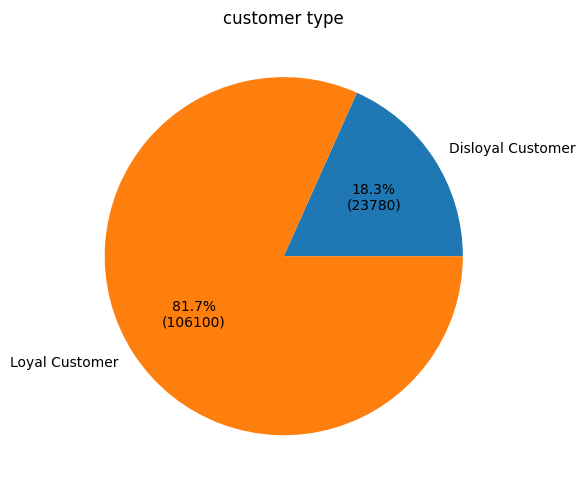

In [74]:
#######################################
#Pie Chart
#######################################
plt.figure(figsize=(6,5))
result=data_cat.groupby(['customer_type'])[['satisfaction']].count().reset_index().rename(columns={'satisfaction':'count'})
plt.pie(result['count'],labels = result["customer_type"], autopct=autopct_format(result['count']))
plt.title("customer type")
plt.tight_layout()
plt.show()

### 2-3 Customer Type VS Age

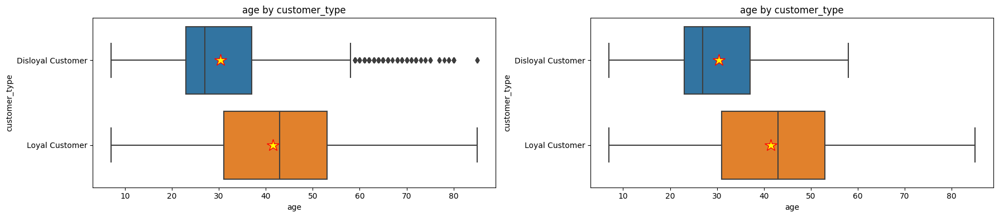

In [75]:
######################################################
#Box plot of age by customer_type
######################################################
fig, axs = plt.subplots(1,2,figsize=(18,4))
sns.boxplot(data=data_cat, y="customer_type",x="age",ax=axs[0],
            showmeans=True,
            meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})

sns.boxplot(data=data_cat, y="customer_type",x="age",ax=axs[1],
            showfliers=False,
            showmeans=True,
            meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})
axs[0].set_title("age by customer_type")
axs[1].set_title("age by customer_type")

plt.tight_layout()
plt.show()

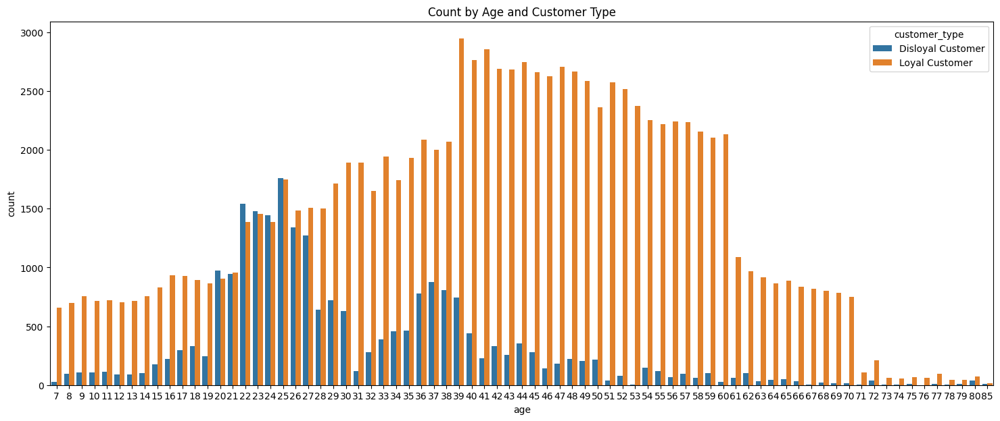

In [76]:
#######################################
#Age count(customer_type)
#######################################
plt.figure(figsize=(18,7))
hue_order=customer_type_hue_order
sns.countplot(data=data_cat, x='age',hue="customer_type",hue_order=hue_order)
plt.title("Count by Age and Customer Type")
plt.show()
#=>Around 28, loyal passenger count began higher than disloyal passenger count

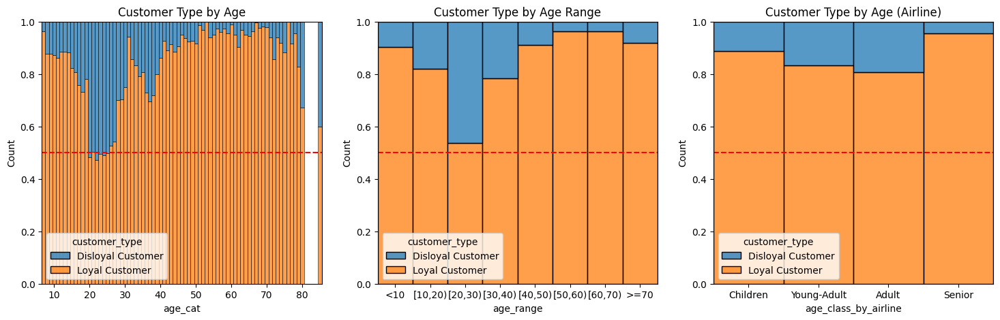

In [77]:
fig, axs = plt.subplots(1,3,figsize=(18,5))

hue_order=customer_type_hue_order
sns.histplot(data=data_cat, x="age_cat",hue='customer_type', multiple="fill",ax=axs[0],hue_order=hue_order)
sns.histplot(data=data_cat, x="age_range",hue='customer_type', multiple="fill",ax=axs[1],hue_order=hue_order)
sns.histplot(data=data_cat, x="age_class_by_airline",hue='customer_type', multiple="fill",ax=axs[2],hue_order=hue_order)

#set 50% random probability line
axs[0].axhline(0.5,color="red",linestyle="--",label="50%")
axs[1].axhline(0.5,color="red",linestyle="--",label="50%")
axs[2].axhline(0.5,color="red",linestyle="--",label="50%")

#set title
axs[0].set_title("Customer Type by Age")
axs[1].set_title("Customer Type by Age Range")
axs[2].set_title("Customer Type by Age (Airline)")
plt.show()

#=>young people(20-30) seemed to be less loyal

### 2-5 Customer Type VS Class

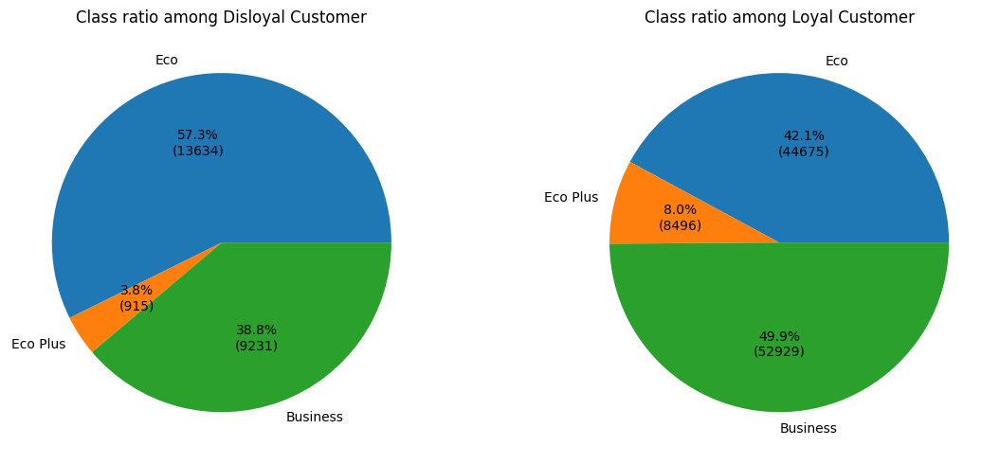

In [78]:
#######################################
#P(class | customer_type)
#######################################
result=pd.crosstab(data_cat['class'],data_cat['customer_type'],margins=False).reset_index()

#display(result)
col_nm=customer_type_hue_order

#######################################
#Pie Chart
#######################################
colCnt=2
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(colCnt*6,rowCnt*5))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["class"], autopct=autopct_format(result[col]))
    ax.set_title(f"Class ratio among {col}")
plt.tight_layout()
plt.show()

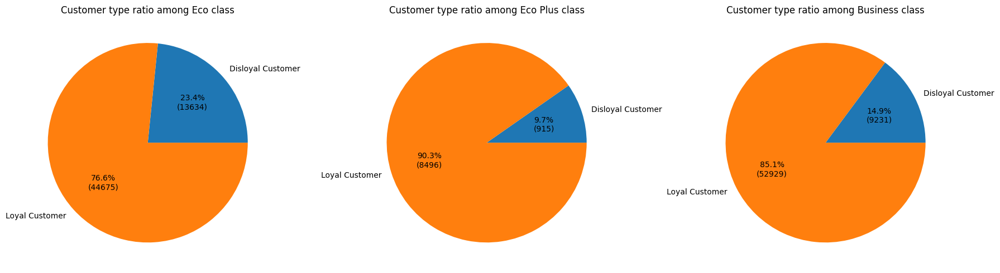

In [79]:
#######################################
#P(customer_type | class)
#######################################
result=pd.crosstab(data_cat['customer_type'],data_cat['class'],margins=False).reset_index()

#display(result)
col_nm=class_hue_order

#######################################
#Pie Chart
#######################################
colCnt=3
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(colCnt*6,rowCnt*5))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["customer_type"], autopct=autopct_format(result[col]))
    ax.set_title(f"Customer type ratio among {col} class")
plt.tight_layout()
plt.show()

### 2-6 Customer Type VS Flight Distance

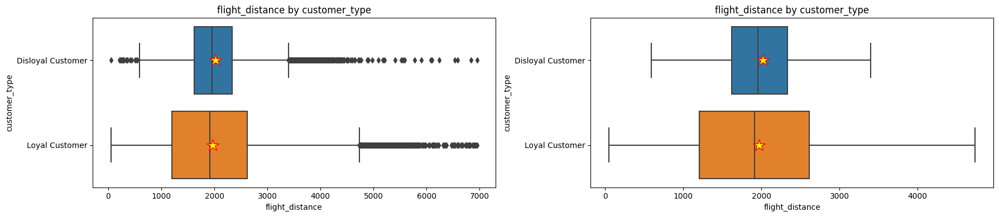

In [80]:
######################################################
#Box plot of flight_distance by customer_type
######################################################
fig, axs = plt.subplots(1,2,figsize=(18,4))
sns.boxplot(data=data_cat, y="customer_type",x="flight_distance",ax=axs[0],
            showmeans=True,
            meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})

sns.boxplot(data=data_cat, y="customer_type",x="flight_distance",ax=axs[1],
            showfliers=False,
            showmeans=True,
            meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})
axs[0].set_title("flight_distance by customer_type")
axs[1].set_title("flight_distance by customer_type")

plt.tight_layout()
plt.show()

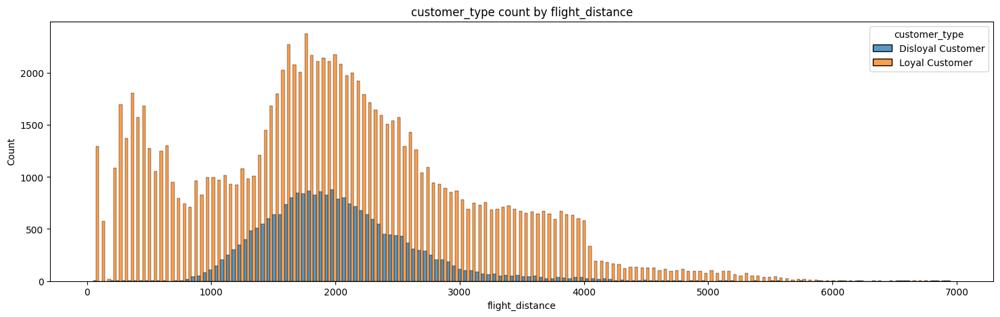

In [81]:
#################################################
#satisfaction count by flight_distance Delay
#################################################
plt.figure(figsize=(18,5))
hue_order=customer_type_hue_order

sns.histplot(data=data_cat, x="flight_distance",hue='customer_type'
             , multiple="dodge",hue_order=hue_order)
#set title
plt.title("customer_type count by flight_distance")

plt.show()

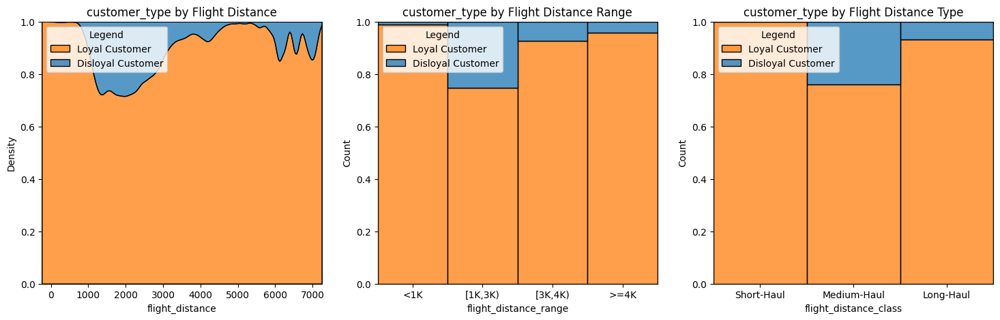

In [82]:
fig, axs = plt.subplots(1,3,figsize=(18,5))
hue_order=customer_type_hue_order

sns.kdeplot(data=data_cat, x="flight_distance",hue='customer_type', multiple="fill",ax=axs[0],hue_order=hue_order)
sns.histplot(data=data_cat, x="flight_distance_range",hue='customer_type', multiple="fill",ax=axs[1],hue_order=hue_order)
sns.histplot(data=data_cat, x="flight_distance_class",hue='customer_type', multiple="fill",ax=axs[2],hue_order=hue_order)

#set 50% random probability line
#axs[0].axhline(0.5,color="red",linestyle="--",label="random probability 50%")
#axs[1].axhline(0.5,color="red",linestyle="--",label="random probability 50%")
#axs[2].axhline(0.5,color="red",linestyle="--",label="random probability 50%")

#set title
axs[0].set_title("customer_type by Flight Distance")
axs[1].set_title("customer_type by Flight Distance Range")
axs[2].set_title("customer_type by Flight Distance Type")

#edit legend
handles, labels = axs[0].get_legend_handles_labels()
axs[0].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
handles, labels = axs[1].get_legend_handles_labels()
axs[1].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
handles, labels = axs[2].get_legend_handles_labels()
axs[2].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])


plt.show()

### 2-(7~20) Customer Type VS Rating

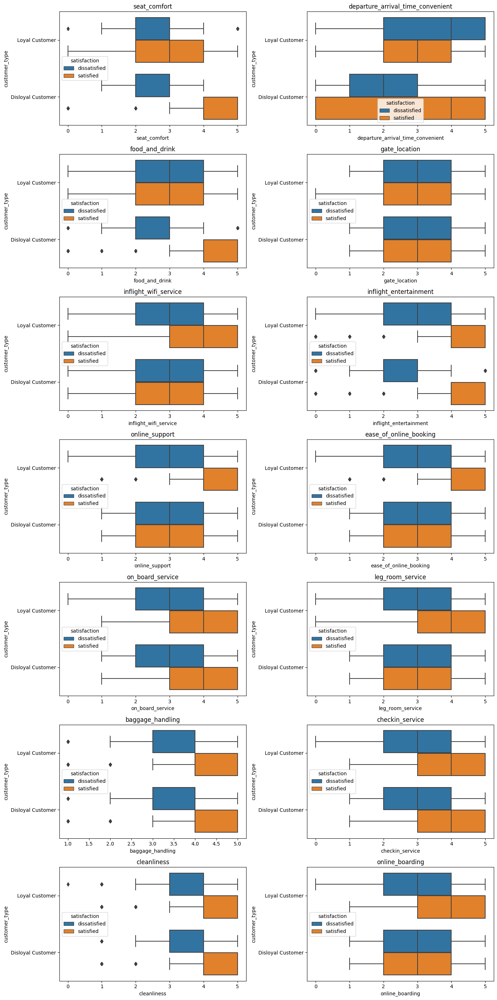

In [83]:
#################################################
#Boxplot
#rating item
#################################################
fig,axs=plt.subplots(7,2,sharey=False,figsize=(14,28))
var_num=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
hue_order=satisfaction_hue_order
for var,ax in zip(var_num,axs.ravel()):
    sns.boxplot(data=df_original, x=var,ax=ax, 
             y="customer_type",hue='satisfaction',hue_order=hue_order)
    ax.set_title(var)
plt.tight_layout()
plt.show()

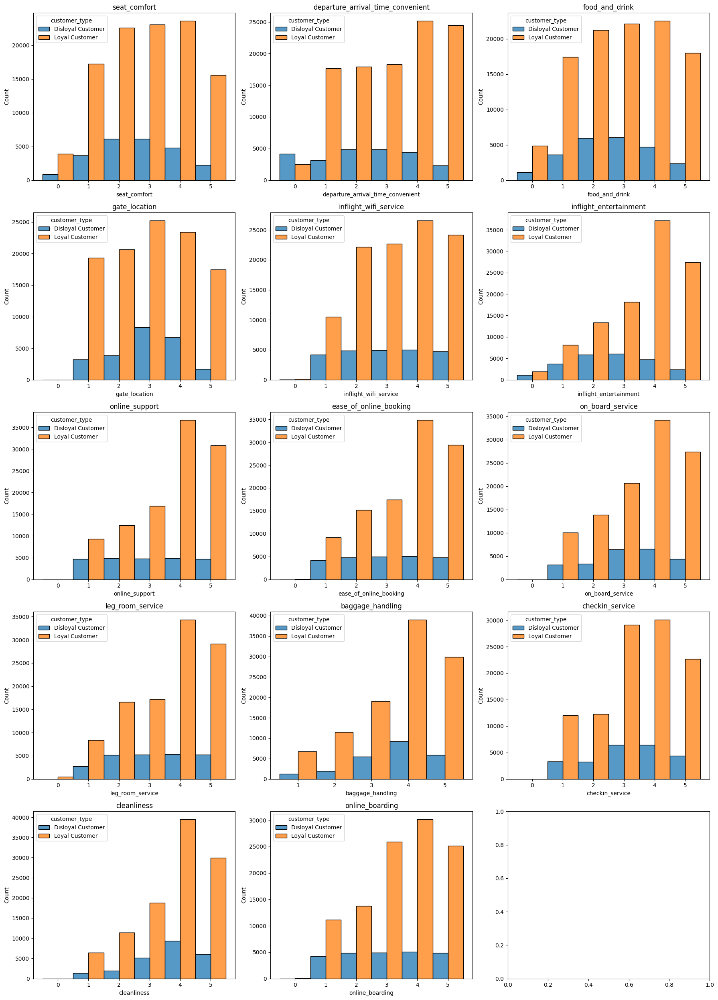

In [84]:
#################################################
#Histgram 
#rating item
#################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
var_num=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
hue_order=customer_type_hue_order
for var,ax in zip(var_num,axs.ravel()):
    sns.histplot(data=data_cat, x=var,ax=ax, 
             hue="customer_type",element="bars", legend=True,
             stat="count", multiple="dodge",kde=False,hue_order=hue_order)
    ax.set_title(var)
plt.tight_layout()
plt.show()

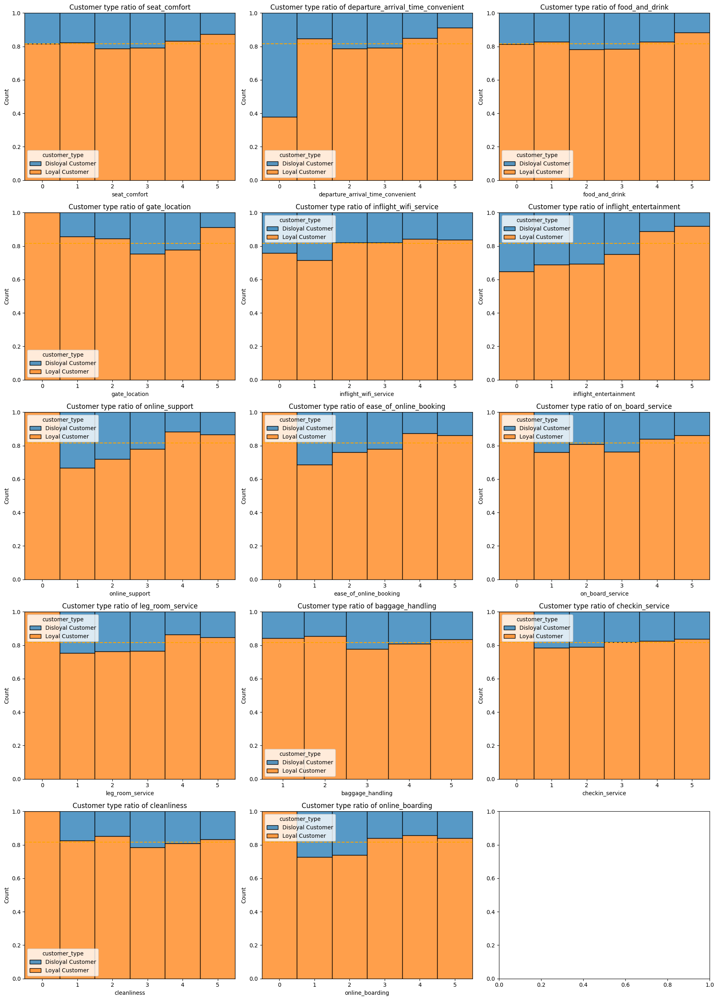

In [85]:
#################################################
#KDE
#rating item
#################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
var_num=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
hue_order=customer_type_hue_order
total_loyal_ratio=round(df_original[df_original["customer_type"]=='Loyal Customer']['satisfaction'].count()/df_original.shape[0],3)
for var,ax in zip(var_num,axs.ravel()):
    sns.histplot(data=data_cat, x=var,ax=ax, 
             hue="customer_type",
             multiple="fill",discrete=True,hue_order=hue_order)
    ax.axhline(total_loyal_ratio,color="orange",linestyle="--",label="Loyal Customer Ratio")
    ax.set_title(f'Customer type ratio of {var}')
plt.tight_layout()
plt.show()

## 3-Age

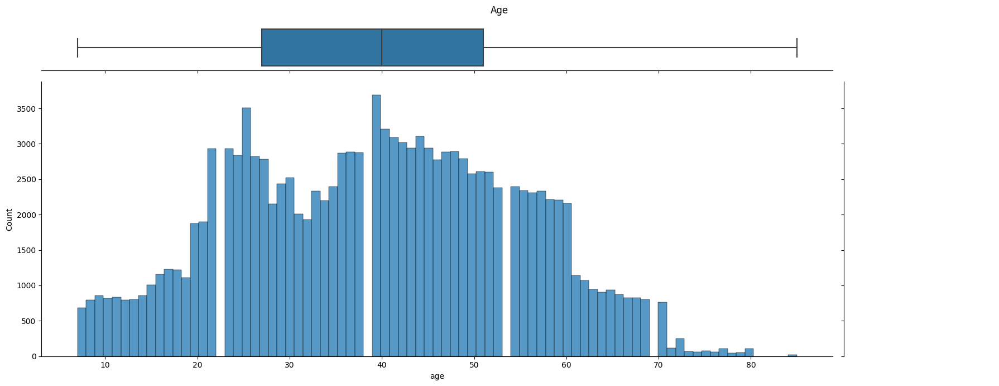

In [86]:
#################################################
#distribution and boxplot of age
#################################################
g = sns.JointGrid(data=data_cat, x="age")
g.plot(sns.histplot, sns.boxplot)
g.fig.set_size_inches((18, 7))
plt.suptitle("Age")
plt.tight_layout()
plt.show()

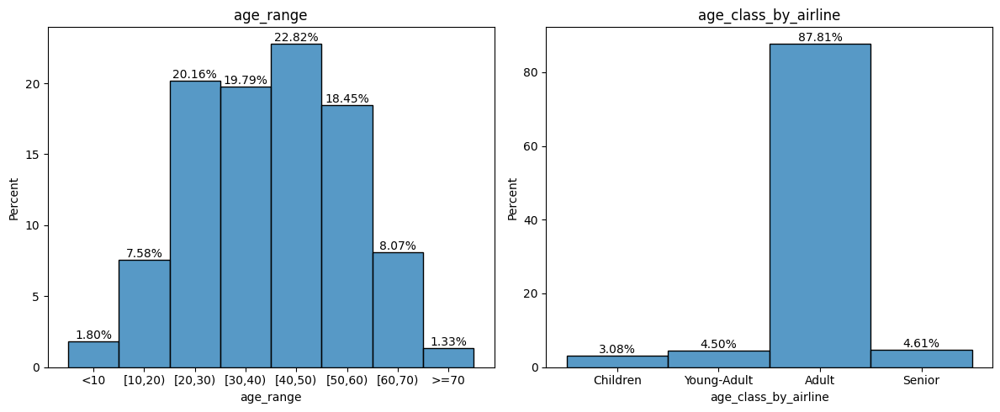

In [87]:
###############################################################
#hist plot of rating items
###############################################################
fig,axs=plt.subplots(1,2,sharey=False,figsize=(12,5))
rating_list=['age_range', 'age_class_by_airline']
for var,ax in zip(rating_list,axs.ravel()):
    target_data=data_cat
    sns.histplot(data=target_data, x=var, multiple="stack",ax=ax,discrete=True,stat='percent')
    for i in ax.containers:
        ax.bar_label(i,fmt='%.2f%%')
    ax.set_title(var)
plt.tight_layout()
plt.show()
#=>20-60 is around 80%, above 60 and under 20 is around 20%

### 3-4 Age VS type_of_travel

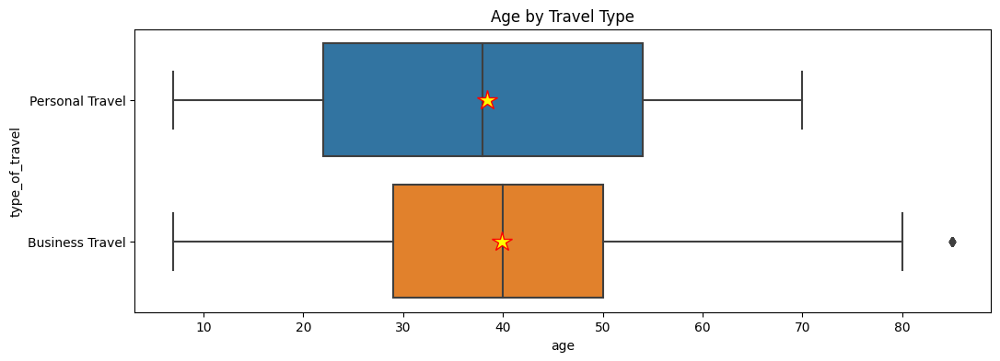

In [88]:
##########################################
#Box plot of Age
##########################################
plt.figure(figsize=(12,4))
sns.boxplot(data=data_cat, y="type_of_travel",x="age",
            showmeans=True,
            meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})
plt.title("Age by Travel Type")
plt.show()
#Median age of business travel is greater than median age of personal travel

$H_{0}$: Average Age in Personal travel is equal or bigger than Business Travel<BR>
$H_{A}$: Average Age in Personal travel is smaller than Business Travel

set significance level to 0.05

In [89]:
significance_level=0.05
sample=data_cat

sample_business=sample[sample["type_of_travel"]=="Business Travel"]["age"]
sample_personal=sample[sample["type_of_travel"]=="Personal Travel"]["age"]
#####################################
#The Mann-Whitney U test
#####################################
statistic, pvalue = mannwhitneyu(sample_personal,sample_business,alternative="less")
show_test_result(statistic, pvalue,significance_level)

#####################################
#T-test
#####################################
statistic, pvalue=stats.ttest_ind(sample_personal,sample_business, equal_var=False, alternative="less")
show_test_result(statistic, pvalue,significance_level)

Reject H0 at significance level 0.05 (Pvalue=0.0, Statistic=1721649624.0)
Reject H0 at significance level 0.05 (Pvalue=0.0, Statistic=-14.32)


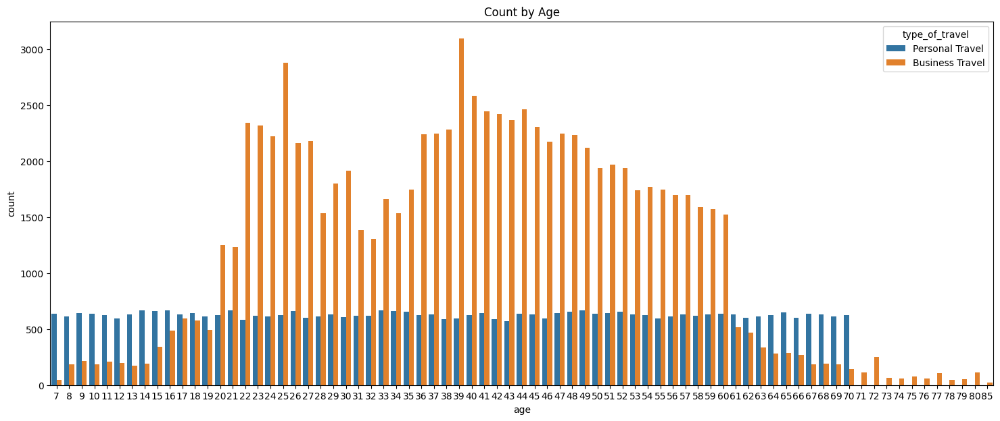

In [90]:
##########################################
#Age count(Travel Type)
##########################################
plt.figure(figsize=(18,7))
hue_order=travel_type_hue_order
sns.countplot(data=data_cat, x='age',hue="type_of_travel",hue_order=hue_order)
plt.title("Count by Age")
plt.show()
#=>20-60 business travel passenger count were far more than personal passenger count(may be related to working age)
#=>Some countries/regions retire at around 60
#=>Some countries/regions require children to finish junior high school study(which around 15)
#=>college students graduate at around 22
#=>no big change in satisfaction(Age:20-38)

#https://www.united.com/en/us/fly/travel/accessibility-and-assistance/unaccompanied-minors.html
#'Our unaccompanied minor service is required for kids 5-14, and optional for those 15-17, who are traveling alone.'
#=>from 15 children are possible to travel alnoe without unaccompanied minor service

#https://www.dol.gov/general/topic/youthlabor/agerequirements
#'As a general rule, the FLSA sets 14 years old as the minimum age for employment, and limits the number of hours worked by minors under the age of 16.'
#=>from 14 children can work in limited types of non-hazardous jobs

#https://www.dol.gov/agencies/whd/youthrules/young-workers/non-ag-under-14
#If you are under the age of 14, you are only allowed to do the following jobs: 
#Deliver newspapers to customers
#Babysit on a casual basis
#Work as an actor or performer in movies, TV, radio, or theater
#Work as a homeworker gathering evergreens and making evergreen wreaths; and
#Work for a business owned entirely by your parents as long as you are not employed in mining, manufacturing, or any of the 17 hazardous occupations.

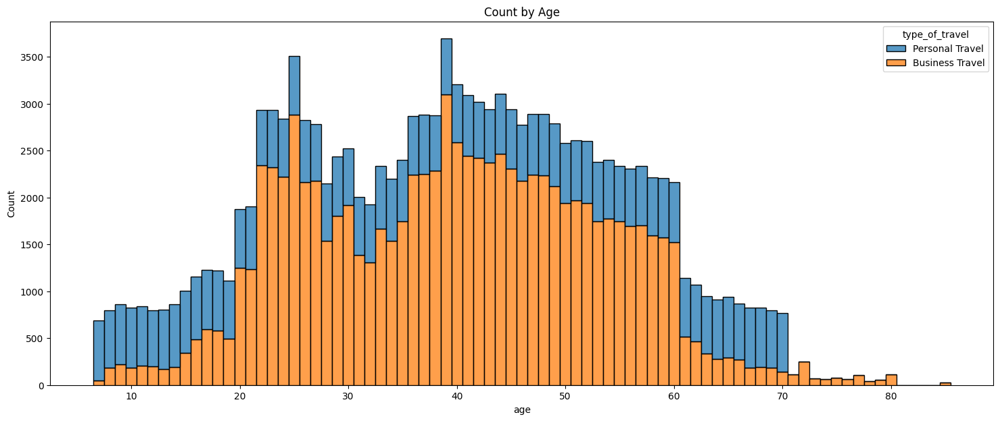

In [91]:
##########################################
#Age count(Travel Type)
##########################################
plt.figure(figsize=(18,7))
hue_order=travel_type_hue_order
sns.histplot(data=data_cat, x='age',hue="type_of_travel",discrete=True, multiple="stack",hue_order=hue_order)
plt.title("Count by Age")
plt.show()

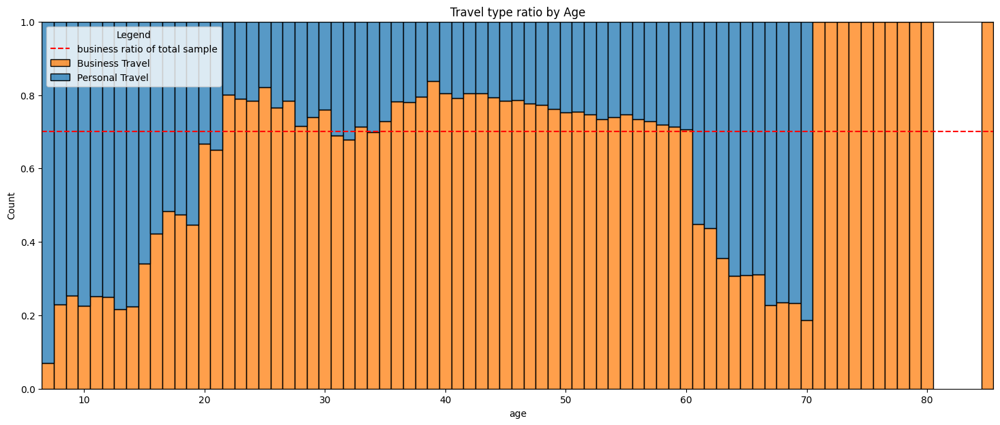

In [92]:
##########################################
#Age ratio(Travel Type)
##########################################
plt.figure(figsize=(18,7))
hue_order=travel_type_hue_order
business_per=round(df_original[df_original['type_of_travel']=='Business Travel']['type_of_travel'].count()/df_original.shape[0],1)
ax=sns.histplot(data=data_cat, x='age',hue='type_of_travel', multiple="fill"
             ,hue_order=hue_order,legend=True,discrete=True)
ax.axhline(business_per,color="red",linestyle="--",label="business ratio of total sample")

plt.title("Travel type ratio by Age")
#edit legend
handles, labels = ax.get_legend_handles_labels()
plt.legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
plt.show()


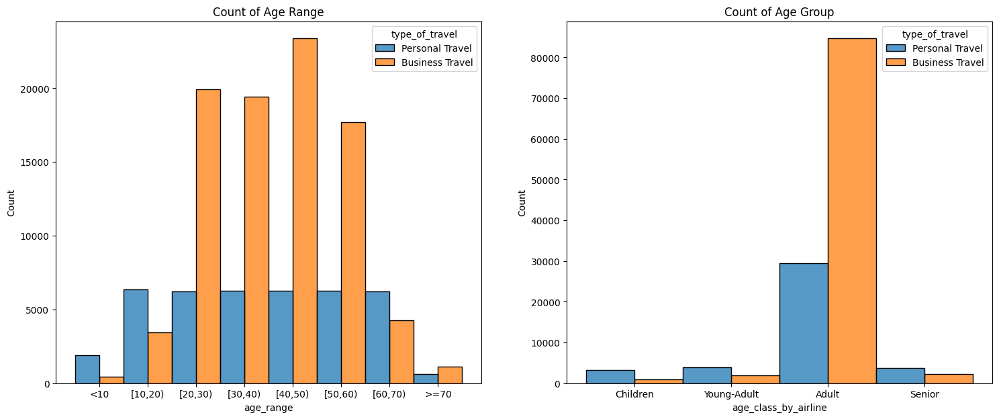

In [93]:
##########################################
#Age Group count(Travel Type)
##########################################
fig, axs=plt.subplots(1,2,figsize=(18,7))
hue_order=travel_type_hue_order
sns.histplot(data=data_cat, x='age_range',hue="type_of_travel"
              ,multiple="dodge",discrete=True,ax=axs[0],hue_order=hue_order)
axs[0].set_title("Count of Age Range")
sns.histplot(data=data_cat, x='age_class_by_airline',hue="type_of_travel"
              ,multiple="dodge",discrete=True,ax=axs[1],hue_order=hue_order)
axs[1].set_title("Count of Age Group")
plt.show()
#Most of trips came form passengers 20-60 or adult

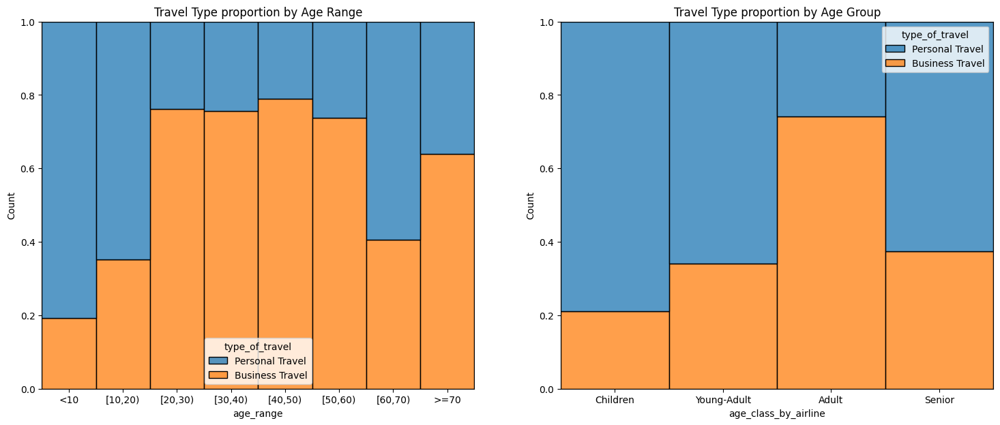

In [94]:
##########################################
#Travel Type proportion by Age group
##########################################
fig, axs=plt.subplots(1,2,figsize=(18,7))
hue_order=travel_type_hue_order
sns.histplot(data=data_cat, x='age_range',hue="type_of_travel"
              ,multiple="fill",discrete=True,ax=axs[0],hue_order=hue_order)
axs[0].set_title("Travel Type proportion by Age Range")
sns.histplot(data=data_cat, x='age_class_by_airline',hue="type_of_travel"
              ,multiple="fill",discrete=True,ax=axs[1],hue_order=hue_order)
axs[1].set_title("Travel Type proportion by Age Group")
plt.show()
#Passengers 20-60 or adult seemed to have higher business travel ratio

### 3-5 Age VS Class

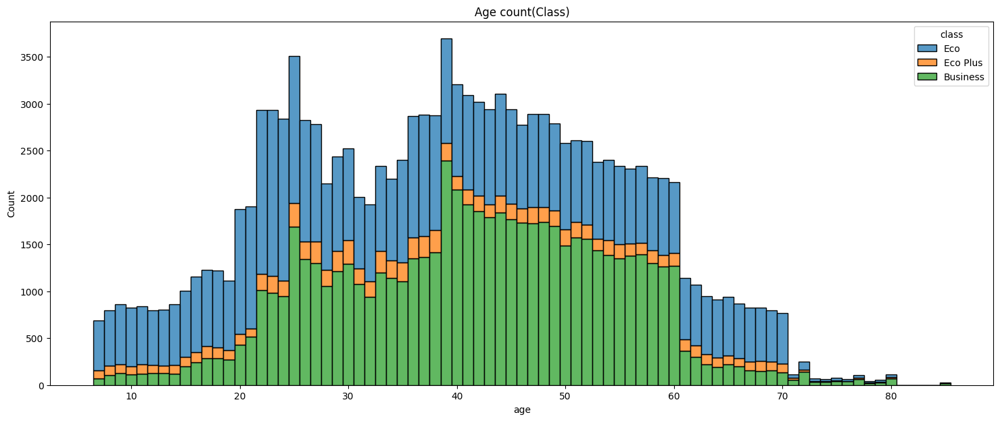

In [95]:
##########################################
#Age count(Class)
##########################################
plt.figure(figsize=(18,7))
hue_order=class_hue_order
sns.histplot(data=data_cat, x='age',hue="class",discrete=True, multiple="stack",hue_order=hue_order)
plt.title("Age count(Class)")
plt.show()

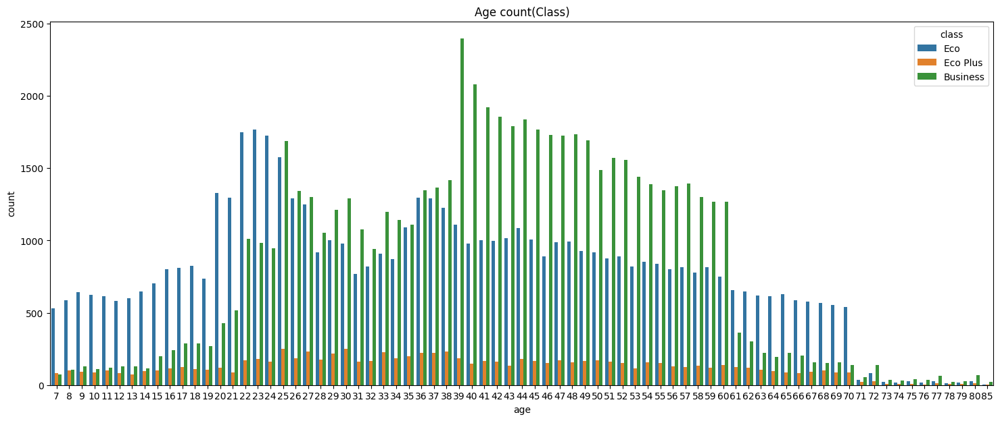

In [96]:
##########################################
#Age count(Class)
##########################################
plt.figure(figsize=(18,7))
hue_order=class_hue_order
sns.countplot(data=data_cat, x='age',hue="class",hue_order=hue_order)
plt.title("Age count(Class)")
plt.show()
#=>39-60, business class count is far more than Eco

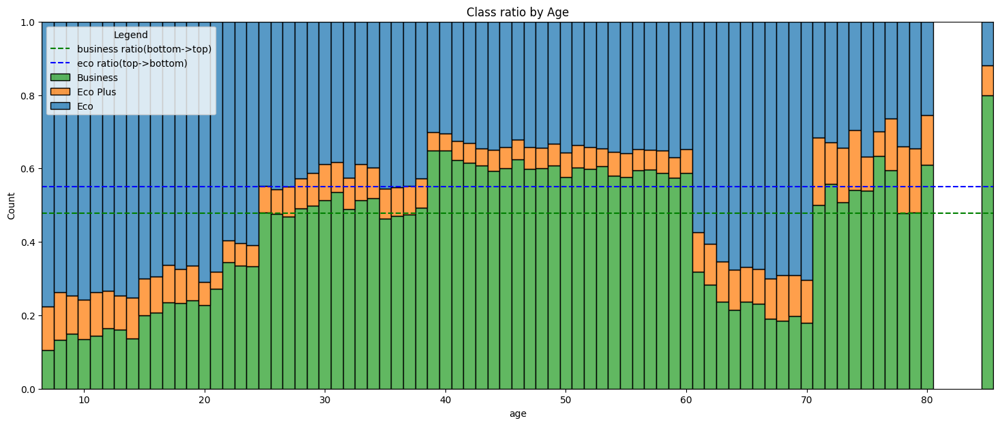

In [97]:
##########################################
#Class proportion by Age
##########################################
plt.figure(figsize=(18,7))
hue_order=class_hue_order
business_per=round(df_original[df_original['class']=='Business']['class'].count()/df_original.shape[0],3)
eco_per=round(df_original[df_original['class']=='Eco']['class'].count()/df_original.shape[0],3)
ax=sns.histplot(data=data_cat, x='age',hue='class', 
             multiple="fill",legend=True,hue_order=hue_order
            ,discrete=True)
ax.axhline(business_per,color="green",linestyle="--",label="business ratio(bottom->top)")
ax.axhline(1-eco_per,color="blue",linestyle="--",label="eco ratio(top->bottom)")
plt.title("Class ratio by Age")

handles, labels = ax.get_legend_handles_labels()
plt.legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])

plt.show()
#=>around 25-60, business class ratio higher(or equal to) than total sample

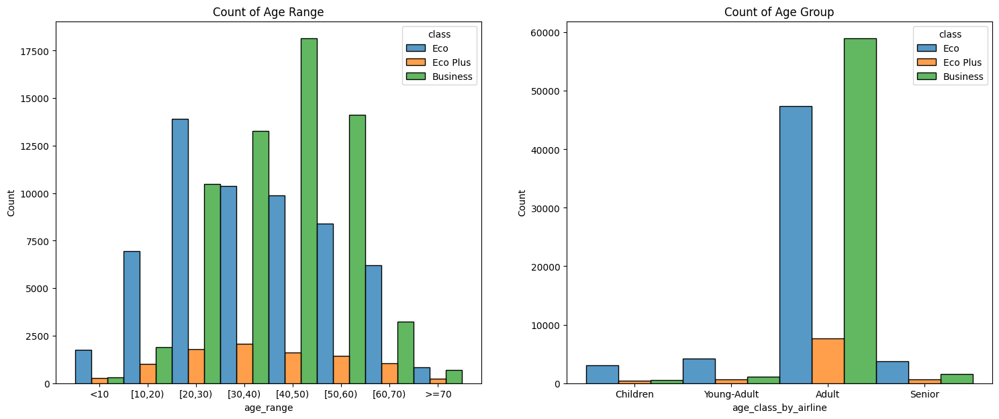

In [98]:
##########################################
#Age Group count(Class)
##########################################
fig, axs=plt.subplots(1,2,figsize=(18,7))
hue_order=class_hue_order
sns.histplot(data=data_cat, x='age_range',hue="class"
              ,multiple="dodge",discrete=True,ax=axs[0],hue_order=hue_order)
axs[0].set_title("Count of Age Range")
sns.histplot(data=data_cat, x='age_class_by_airline',hue="class"
              ,multiple="dodge",discrete=True,ax=axs[1],hue_order=hue_order)
axs[1].set_title("Count of Age Group")
plt.show()
#=>in this dataset, 20-40 and 40-60 have similar count

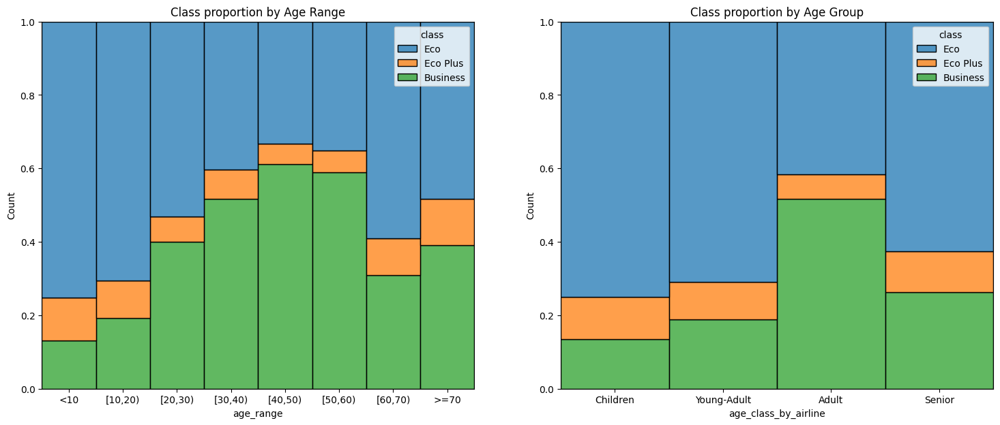

In [99]:
##########################################
#Class proportion by Age Group
##########################################
fig, axs=plt.subplots(1,2,figsize=(18,7))
hue_order=class_hue_order
sns.histplot(data=data_cat, x='age_range',hue="class"
              ,multiple="fill",discrete=True,ax=axs[0],hue_order=hue_order)
axs[0].set_title("Class proportion by Age Range")

sns.histplot(data=data_cat, x='age_class_by_airline',hue="class"
              ,multiple="fill",discrete=True,ax=axs[1],hue_order=hue_order)
axs[1].set_title("Class proportion by Age Group")

plt.show()
#=>Among young passengers(<30), Eco class had higher proportion than other class

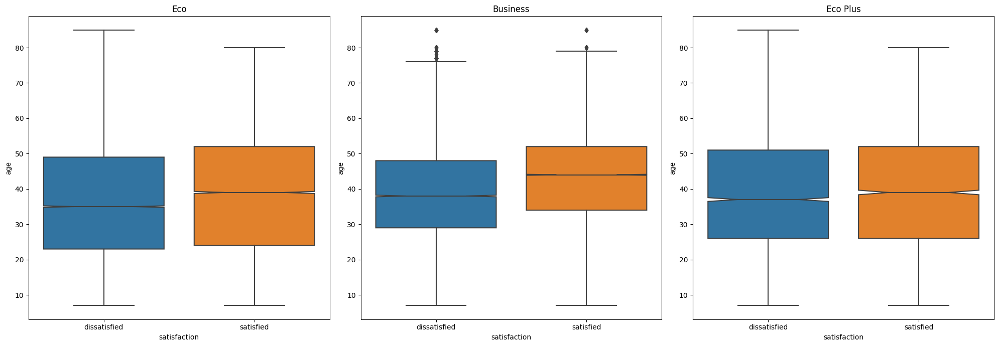

In [100]:
########################################
#Box plot of Age by satisfaction and class
########################################
fig,axs=plt.subplots(1,3,sharey=False,figsize=(20,7))
class_item=df_original["class"].unique()
for var,ax in zip(class_item,axs.ravel()):
    mask=data_cat["class"]==var
    target_data=data_cat[mask]
    sns.boxplot(data=target_data, y="age",notch=True,ax=ax,x="satisfaction")
    ax.set_title(var)
plt.tight_layout()
plt.show()
#=>Within the same class, median age of satisfied passenger was older than that of dissatisfied passengers

### 3-6 Age VS  Flight Distance

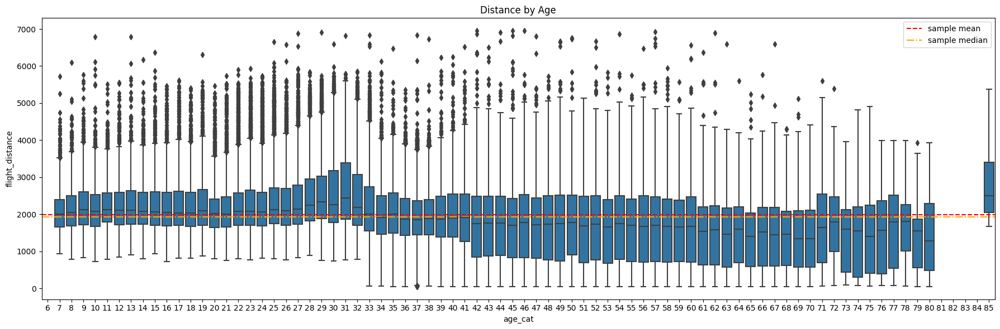

In [101]:
#############################################
#Box plot of distance by Age
#############################################
plt.figure(figsize=(18,6))
target_data=data_cat
mean_distance=target_data["flight_distance"].mean()
median_distance=target_data["flight_distance"].median()
sns.boxplot(data=target_data, x="age_cat",y="flight_distance",color='tab:blue')
plt.axhline(mean_distance,color="red",linestyle="--",label="sample mean")
plt.axhline(median_distance,color="orange",linestyle="-.",label="sample median")
plt.title("Distance by Age")
plt.tight_layout()
plt.legend()
plt.show()

#=>Younger passengers appeared to have higher minimum and median flight distance than other ages
#=>Minimum flight distance of 7-32 years old passengers were close, more than 700
#=>From 33 years old minimum flight distance starts from 50(except 85)
#=>Median distance of 7-33 are longer than total mean/median distance
#=>Median distance of 34-80 are shorter than total mean/median distance
#=>Median distance of 85 are longer than total mean/median distance

In [102]:
data_cat.groupby(['age_range'])['flight_distance'].agg(["min","max","std","mean","median"])

,min,max,std,mean,median
age_range,,,,,
<10,777,6099,735.543084,2193.433575,2056.0
"[10,20)",720,6792,818.660954,2260.561744,2074.0
"[20,30)",751,6907,887.987844,2329.945491,2117.0
"[30,40)",50,6837,992.290072,2139.423708,1994.0
"[40,50)",50,6951,1059.697155,1805.744230,1783.0
"[50,60)",50,6924,1078.272536,1728.430401,1702.0
"[60,70)",50,6889,1014.375719,1555.831378,1538.0
>=70,51,5602,1063.572451,1578.053179,1580.0


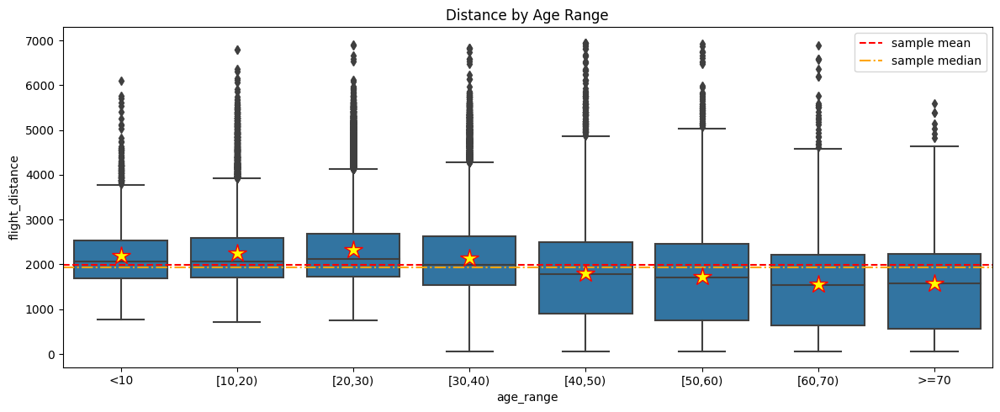

In [103]:
#############################################
#Box plot of distance by age range
#############################################
plt.figure(figsize=(12,5))
target_data=data_cat
mean_distance=target_data["flight_distance"].mean()
median_distance=target_data["flight_distance"].median()
sns.boxplot(data=target_data, x="age_range",y="flight_distance",color='tab:blue',
            showmeans=True,
            meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})
plt.axhline(mean_distance,color="red",linestyle="--",label="sample mean")
plt.axhline(median_distance,color="orange",linestyle="-.",label="sample median")
plt.title("Distance by Age Range")
plt.tight_layout()
plt.legend()
plt.show()

#=>Younger passengers appeared to have higher minimum and median flight distance than other ages
#=>average flight distance tend to decrease as age_range gets higher

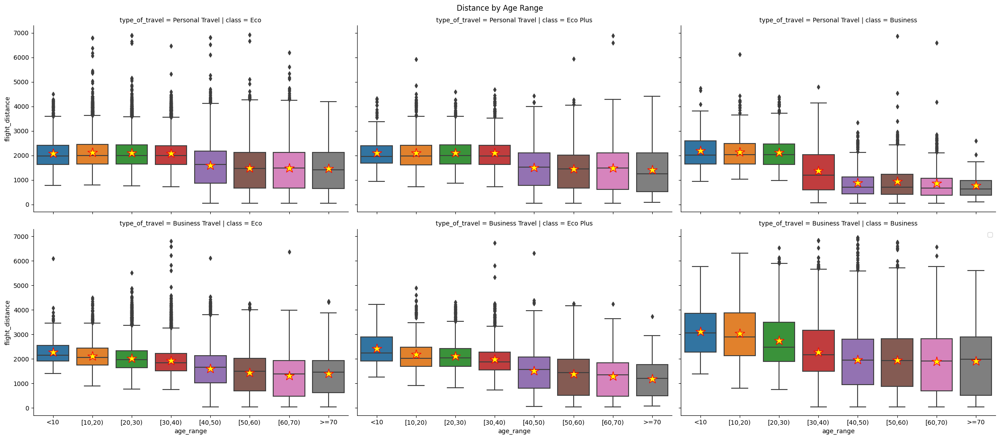

In [104]:
#############################################
#Box plot of distance by age range
#keep travel type and class constant
#############################################
target_data=data_cat
sns.catplot(data=target_data, col='class',row='type_of_travel',
            height=5,aspect=1.5,
             x="age_range",y="flight_distance",kind='box',
             showmeans=True,
             meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})

plt.suptitle("Distance by Age Range")
plt.tight_layout()
plt.legend()
plt.show()

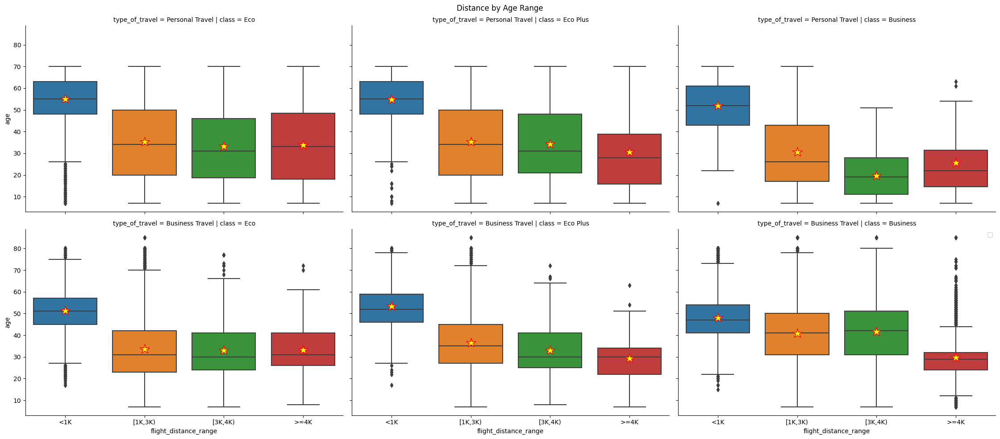

In [105]:
#############################################
#Box plot of age by distance range
#keep travel type and class constant
#############################################
target_data=data_cat
sns.catplot(data=target_data, col='class',row='type_of_travel',
            height=5,aspect=1.5,
             x="flight_distance_range",y="age",kind='box',
            showmeans=True,
            meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})

plt.suptitle("Distance by Age Range")
plt.tight_layout()
plt.legend()
plt.show()

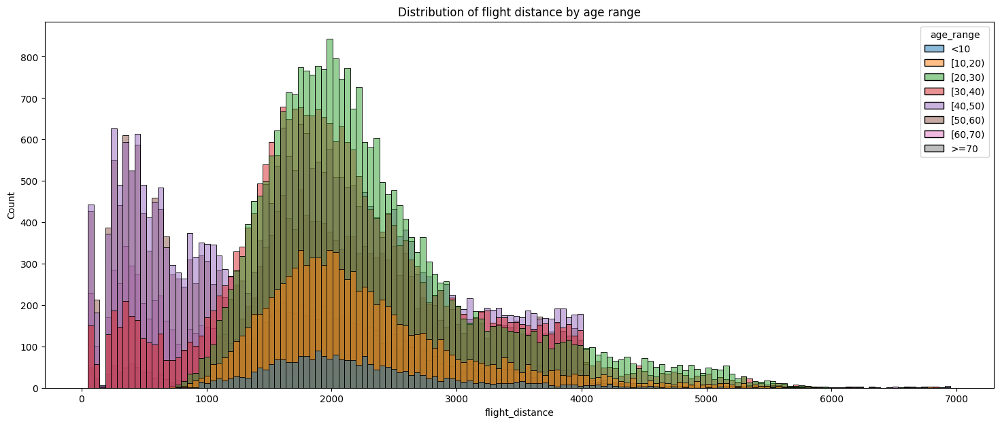

In [106]:
#############################################
#Hist Plot of flight distance by age range
#############################################
plt.figure(figsize=(18,7))
target_data=data_cat
sns.histplot(data=target_data, x='flight_distance',hue='age_range')
plt.title('Distribution of flight distance by age range')
plt.show()

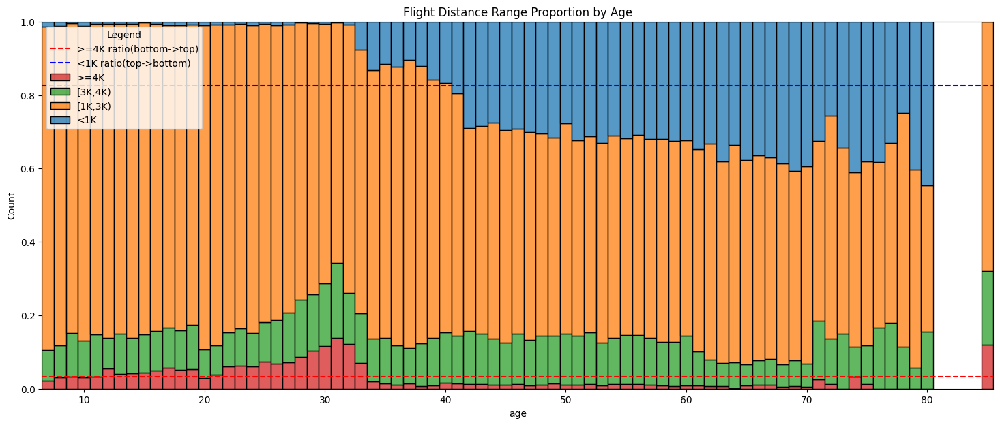

In [107]:
#############################################
#Flight Distance Range Proportion by Age
#############################################
plt.figure(figsize=(18,7))
hue_order=distance_range_hue_order
target_data=data_cat
short_per=round(target_data[target_data['flight_distance_range']=='<1K']['satisfaction'].count()/target_data.shape[0],3)
long_per=round(target_data[target_data['flight_distance_range']=='>=4K']['satisfaction'].count()/target_data.shape[0],3)
ax=sns.histplot(data=target_data, x='age',hue='flight_distance_range', multiple="fill",legend=True,discrete=True,hue_order=hue_order)
ax.axhline(long_per,color="red",linestyle="--",label=">=4K ratio(bottom->top)")
ax.axhline(1-short_per,color="blue",linestyle="--",label="<1K ratio(top->bottom)")
plt.title("Flight Distance Range Proportion by Age")

#edit legend
handles, labels = ax.get_legend_handles_labels()
plt.legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])

plt.show()

#=>From age 33 proportion of flight distance <1K appeared to increase

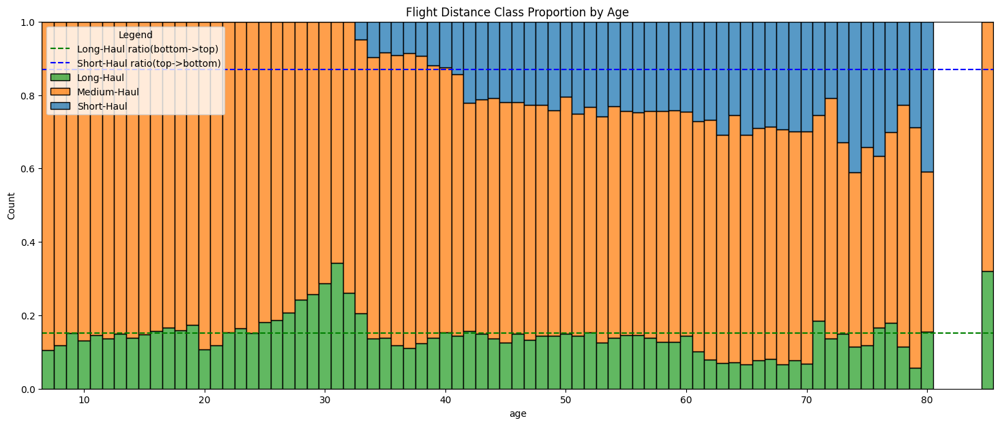

In [108]:
#############################################
#Flight Distance Class Proportion by Age
#############################################
plt.figure(figsize=(18,7))
hue_order=distance_type_hue_order
target_data=data_cat
short_per=round(target_data[target_data['flight_distance_class']=='Short-Haul']['satisfaction'].count()/target_data.shape[0],3)
long_per=round(target_data[target_data['flight_distance_class']=='Long-Haul']['satisfaction'].count()/target_data.shape[0],3)
ax=sns.histplot(data=target_data, x='age',hue='flight_distance_class', multiple="fill",legend=True,hue_order=hue_order,discrete=True)
ax.axhline(long_per,color="green",linestyle="--",label="Long-Haul ratio(bottom->top)")
ax.axhline(1-short_per,color="blue",linestyle="--",label="Short-Haul ratio(top->bottom)")
plt.title("Flight Distance Class Proportion by Age")

#edit legend
handles, labels = ax.get_legend_handles_labels()
plt.legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])

plt.show()
#=>From age 33 proportion of short-Haul flight appeared to increase

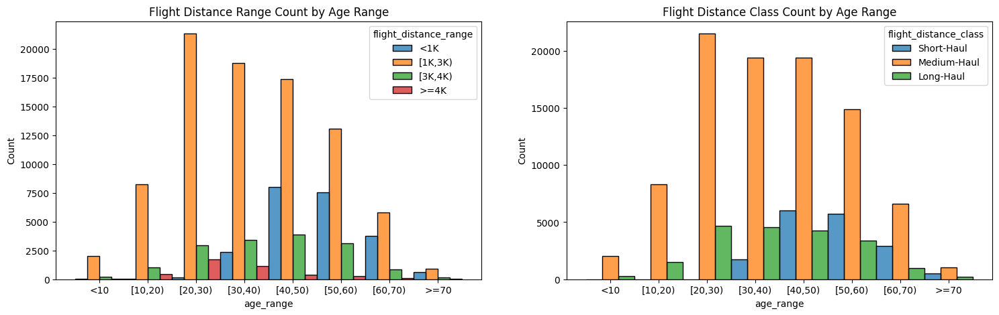

In [109]:
fig,axs=plt.subplots(1,2,figsize=(18,5))

target_data=data_cat
#************************#
#by flight_distance_range
#************************#
hue_order=distance_range_hue_order

sns.histplot(data=target_data, x='age_range',hue='flight_distance_range'
             , multiple="dodge",legend=True,ax=axs[0],hue_order=hue_order)
axs[0].set_title("Flight Distance Range Count by Age Range")

#************************#
#by flight_distance_class
#************************#
hue_order=distance_type_hue_order

sns.histplot(data=target_data, x='age_range',hue='flight_distance_class'
             , multiple="dodge",legend=True,ax=axs[1],hue_order=hue_order)
axs[1].set_title("Flight Distance Class Count by Age Range")
plt.show()

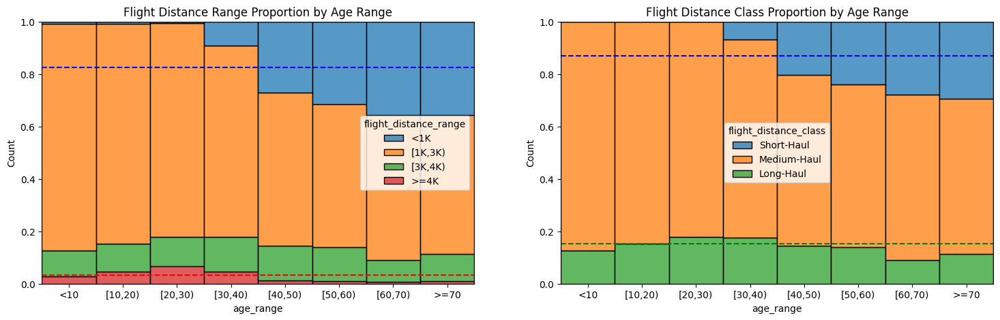

In [110]:
fig,axs=plt.subplots(1,2,figsize=(18,5))

target_data=data_cat
#************************#
#by flight_distance_range
#************************#
hue_order=distance_range_hue_order
short_per=round(target_data[target_data['flight_distance_range']=='<1K']['satisfaction'].count()/target_data.shape[0],3)
long_per=round(target_data[target_data['flight_distance_range']=='>=4K']['satisfaction'].count()/target_data.shape[0],3)

sns.histplot(data=target_data, x='age_range',hue='flight_distance_range'
             , multiple="fill",legend=True,ax=axs[0],hue_order=hue_order)
axs[0].axhline(long_per,color="red",linestyle="--",label=">=4K ratio")
axs[0].axhline(1-short_per,color="blue",linestyle="--",label="<1K ratio")
axs[0].set_title("Flight Distance Range Proportion by Age Range")

#************************#
#by flight_distance_class
#************************#
hue_order=distance_type_hue_order
short_per=round(target_data[target_data['flight_distance_class']=='Short-Haul']['satisfaction'].count()/target_data.shape[0],3)
long_per=round(target_data[target_data['flight_distance_class']=='Long-Haul']['satisfaction'].count()/target_data.shape[0],3)

sns.histplot(data=target_data, x='age_range',hue='flight_distance_class'
             , multiple="fill",legend=True,ax=axs[1],hue_order=hue_order)
axs[1].axhline(long_per,color="green",linestyle="--",label="Long-Haul ratio")
axs[1].axhline(1-short_per,color="blue",linestyle="--",label="Short-Haul ratio")
axs[1].set_title("Flight Distance Class Proportion by Age Range")
plt.show()

#=>As age went higher the ratio of short-Haul tend to increase

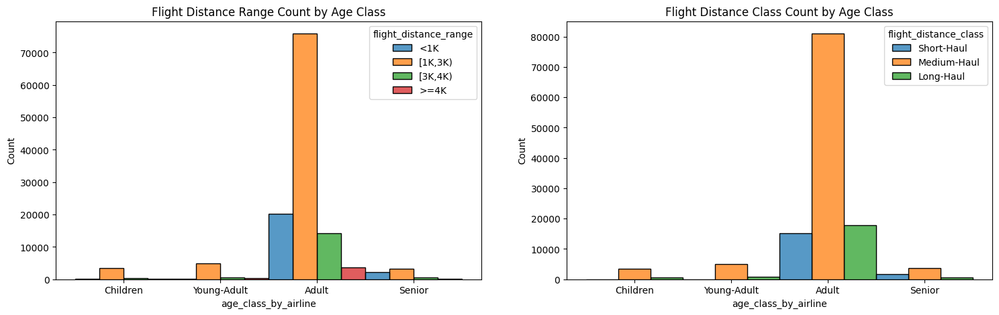

In [111]:
fig,axs=plt.subplots(1,2,figsize=(18,5))

target_data=data_cat
#************************#
#by flight_distance_range
#************************#
hue_order=distance_range_hue_order

sns.histplot(data=target_data, x='age_class_by_airline',hue='flight_distance_range'
             , multiple="dodge",legend=True,ax=axs[0],hue_order=hue_order)
axs[0].set_title("Flight Distance Range Count by Age Class")

#************************#
#by flight_distance_class
#************************#
hue_order=distance_type_hue_order

sns.histplot(data=target_data, x='age_class_by_airline',hue='flight_distance_class'
             , multiple="dodge",legend=True,ax=axs[1],hue_order=hue_order)
axs[1].set_title("Flight Distance Class Count by Age Class")
plt.show()

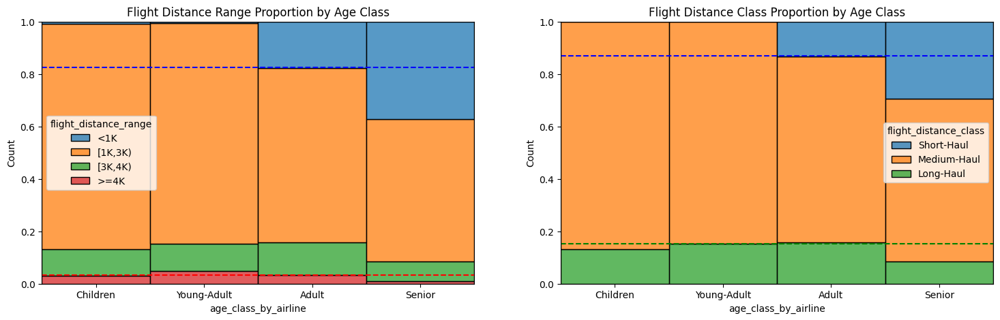

In [112]:
fig,axs=plt.subplots(1,2,figsize=(18,5))

target_data=data_cat
#************************#
#by flight_distance_range
#************************#
hue_order=distance_range_hue_order
short_per=round(target_data[target_data['flight_distance_range']=='<1K']['satisfaction'].count()/target_data.shape[0],3)
long_per=round(target_data[target_data['flight_distance_range']=='>=4K']['satisfaction'].count()/target_data.shape[0],3)

sns.histplot(data=target_data, x='age_class_by_airline',hue='flight_distance_range'
             , multiple="fill",legend=True,ax=axs[0],hue_order=hue_order)
axs[0].axhline(long_per,color="red",linestyle="--",label=">=4K ratio")
axs[0].axhline(1-short_per,color="blue",linestyle="--",label="<1K ratio")
axs[0].set_title("Flight Distance Range Proportion by Age Class")

#************************#
#by flight_distance_class
#************************#
hue_order=distance_type_hue_order
short_per=round(target_data[target_data['flight_distance_class']=='Short-Haul']['satisfaction'].count()/target_data.shape[0],3)
long_per=round(target_data[target_data['flight_distance_class']=='Long-Haul']['satisfaction'].count()/target_data.shape[0],3)

sns.histplot(data=target_data, x='age_class_by_airline',hue='flight_distance_class'
             , multiple="fill",legend=True,ax=axs[1],hue_order=hue_order)
axs[1].axhline(long_per,color="green",linestyle="--",label="Long-Haul ratio")
axs[1].axhline(1-short_per,color="blue",linestyle="--",label="Short-Haul ratio")
axs[1].set_title("Flight Distance Class Proportion by Age Class")

plt.show()
#=>As age gets higher the ratio of short-Haul tends to increase

### 3-(7~20) Age VS  Rating

In [113]:
var_num=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
for var in var_num:
    display(data_cat.groupby([var])['age'].agg(['mean','median']).reset_index())

,seat_comfort,mean,median
0,0,37.930582,38.0
1,1,39.874171,40.0
2,2,39.289668,39.0
3,3,39.209677,39.0
4,4,39.398127,40.0
5,5,39.934201,41.0


,departure_arrival_time_convenient,mean,median
0,0,32.674820,26.0
1,1,40.383570,41.0
2,2,39.707335,40.0
3,3,39.601751,40.0
4,4,39.465482,40.0
5,5,39.934780,41.0


,food_and_drink,mean,median
0,0,37.791926,37.0
1,1,39.914215,40.0
2,2,39.179953,39.0
3,3,39.129485,39.0
4,4,39.427616,40.0
5,5,40.146557,41.0


,gate_location,mean,median
0,0,47.500000,47.5
1,1,40.080301,41.0
2,2,39.912269,40.0
3,3,38.327103,38.0
4,4,38.785762,39.0
5,5,40.974897,42.0


,inflight_wifi_service,mean,median
0,0,31.901515,28.0
1,1,37.857658,37.0
2,2,40.016824,41.0
3,3,39.849141,41.0
4,4,39.116698,39.0
5,5,39.648769,40.0


,inflight_entertainment,mean,median
0,0,30.559100,26.0
1,1,37.126598,36.0
2,2,37.083199,36.0
3,3,39.022355,39.0
4,4,40.630531,42.0
5,5,41.372934,43.0


,online_support,mean,median
0,0,44.000000,44.0
1,1,35.801464,34.0
2,2,36.566570,35.0
3,3,38.747698,38.0
4,4,41.084389,42.0
5,5,40.717684,42.0


,ease_of_online_booking,mean,median
0,0,30.055556,23.5
1,1,37.133150,36.0
2,2,38.328655,38.0
3,3,38.683692,38.0
4,4,40.424850,41.0
5,5,40.301579,41.0


,on_board_service,mean,median
0,0,52.200000,50.0
1,1,37.464154,36.0
2,2,39.511238,39.0
3,3,37.599845,37.0
4,4,40.214235,41.0
5,5,40.751891,42.0


,leg_room_service,mean,median
0,0,50.006757,51.0
1,1,36.866080,36.0
2,2,37.594436,37.0
3,3,37.768505,37.0
4,4,41.249433,42.0
5,5,40.262295,41.0


,baggage_handling,mean,median
0,1,40.874859,41.0
1,2,41.255881,42.0
2,3,38.128773,38.0
3,4,38.990527,39.0
4,5,39.898484,41.0


,checkin_service,mean,median
0,0,44.000000,44.0
1,1,38.420522,38.0
2,2,38.498386,38.0
3,3,39.720609,40.0
4,4,39.577808,40.0
5,5,39.946640,41.0


,cleanliness,mean,median
0,0,52.200000,50.0
1,1,40.324150,40.0
2,2,41.376081,42.0
3,3,38.486283,38.0
4,4,39.016928,39.0
5,5,39.692115,41.0


,online_boarding,mean,median
0,0,23.142857,22.5
1,1,38.237385,37.0
2,2,37.353955,37.0
3,3,40.640578,42.0
4,4,39.949689,41.0
5,5,39.473159,40.0


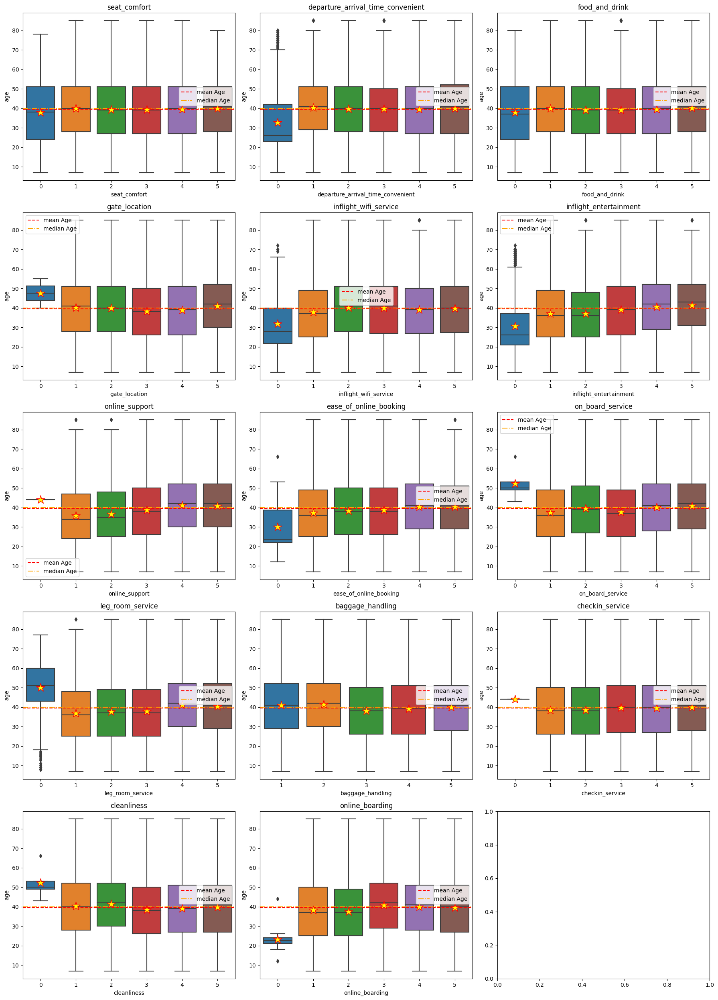

In [114]:
#################################################
#box plot of age
#rating item
#################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
var_num=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
mean_age=df_original["age"].mean()
median_age=df_original["age"].median()
for var,ax in zip(var_num,axs.ravel()):
    sns.boxplot(data=data_cat, x=var,ax=ax,y='age',
               showmeans=True,
               meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})
    ax.axhline(mean_age, color='red',linestyle='--',label="mean Age")
    ax.axhline(median_age, color='orange',linestyle='-.',label="median Age")
    ax.legend()
    ax.set_title(var)
plt.tight_layout()
plt.show()
#The bellow item younger passengers tend to give 0 point(very low score)
#=>'departure_arrival_time_convenient', 'inflight_wifi_service', 'inflight_entertainment', 'ease_of_online_booking', 'online_boarding'
#The bellow item elder passengers tend to give 0 point(very low score)
#=>'gate_location', 'on_board_service', 'leg_room_service','cleanliness'

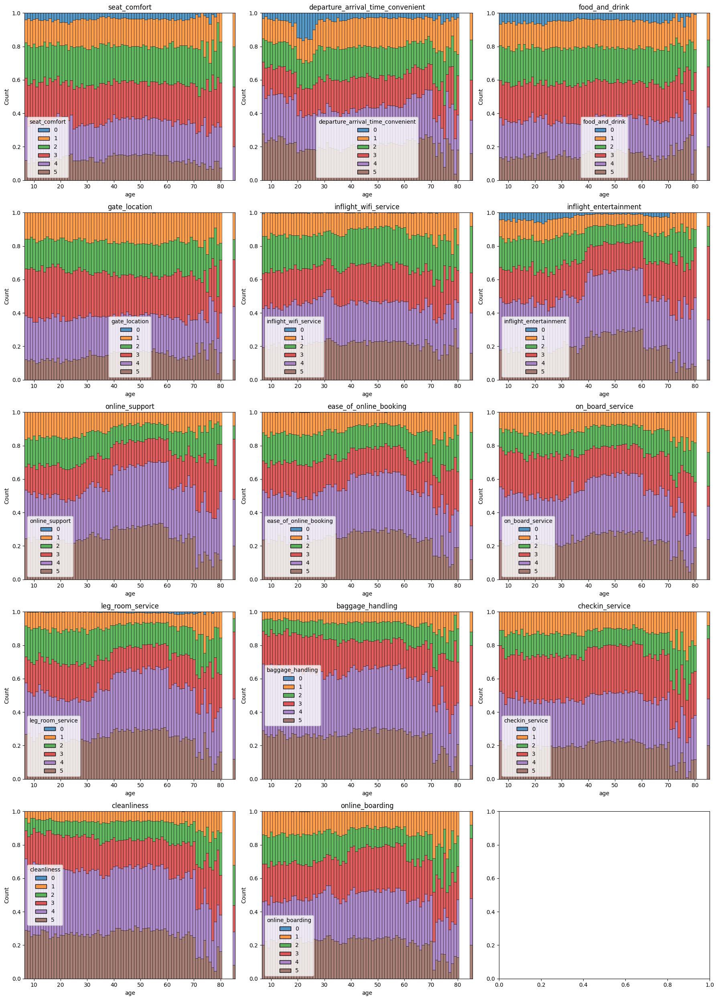

In [115]:
#############################################
#Score proportion of rating items by Age
#############################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
hue_order=rating_hue_order
for var,ax in zip(rating_list,axs.ravel()):
    target_data=data_cat
    #sns.kdeplot(data=target_data, x="age",ax=ax,hue=var, multiple="fill")
    sns.histplot(data=target_data, x="age",ax=ax,hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order,palette='tab10')
    ax.set_title(var)
plt.tight_layout()
plt.show()
#20-60: business trip greater than personal
#60-70: personal trip greater than business
#above 70: almost no personal trip

##Inflight entertainment
#=>trend of rating4,5 at age of 40-60 are smilar to satisfaction ratio by Class
#=>at age of 40-60 business class far more than eco(differs from the total sample)


#=>At the age of 24-26, dissatisfied is greater than satisfied (differs from the total sample)
#=>departure_arrival_time_convenient has a decrease at the same age range
#=>Other rating items amost have no change at around 24-26

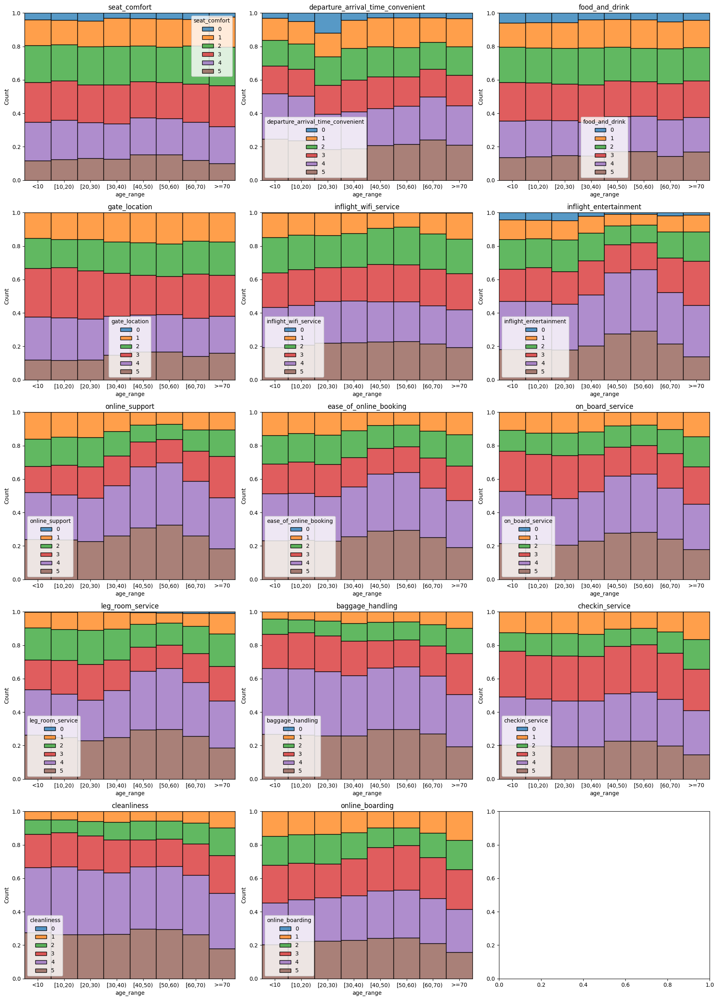

In [116]:
##################################################
#Score proportion of rating items by Age Range 
##################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
hue_order=rating_hue_order
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
for var,ax in zip(rating_list,axs.ravel()):
    target_data=data_cat
    #sns.kdeplot(data=target_data, x="age",ax=ax,hue=var, multiple="fill")
    sns.histplot(data=target_data, x="age_range",ax=ax
                 ,hue=var, multiple="fill",discrete=True,hue_order=hue_order)
    ax.set_title(var)
plt.tight_layout()
plt.show()

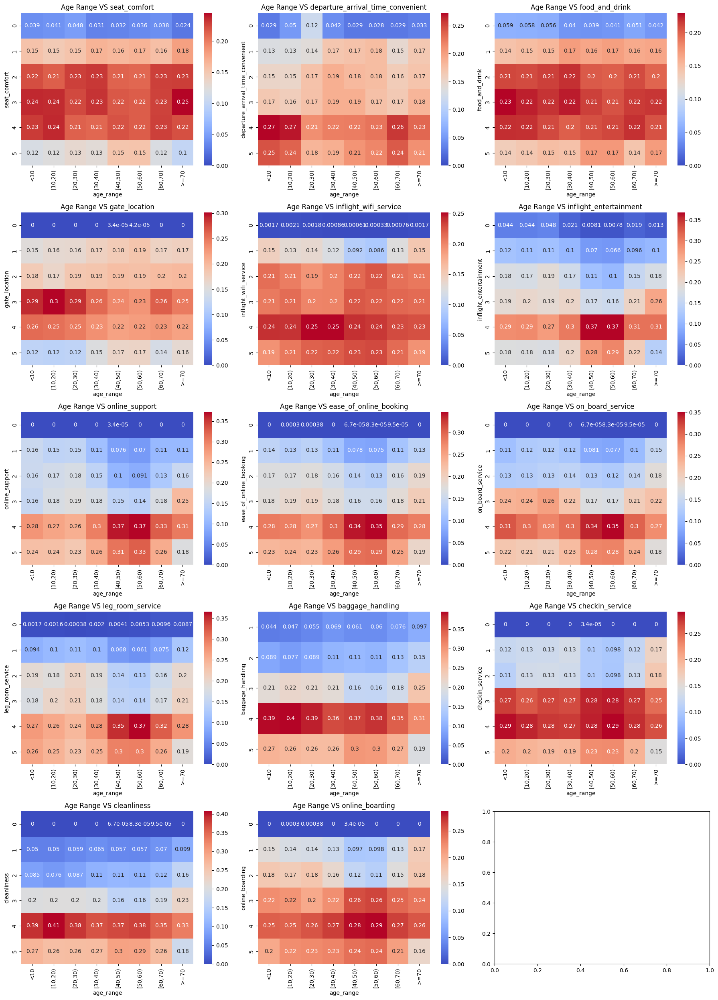

In [117]:
###########################################################
#Heatmap
###########################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
hue_order=rating_hue_order
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
for var,ax in zip(rating_list,axs.ravel()):
    target_data=data_cat
    result=pd.crosstab(target_data[var],target_data["age_range"],normalize='columns')
    sns.heatmap(result, cmap="coolwarm",annot=True,vmin=0,ax=ax)
    ax.set_title(f'Age Range VS {var}')
plt.tight_layout()
plt.show()

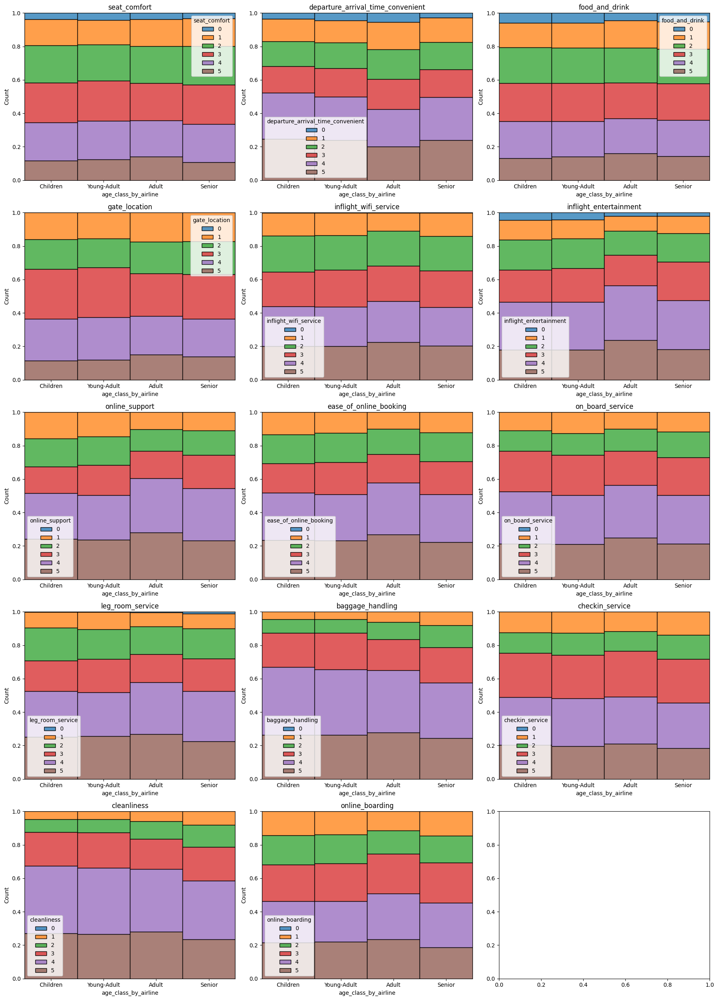

In [118]:
#############################################
#Score proportion of Age Group by different rating items
#############################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
hue_order=rating_hue_order
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
for var,ax in zip(rating_list,axs.ravel()):
    target_data=data_cat
    #sns.kdeplot(data=target_data, x="age",ax=ax,hue=var, multiple="fill")
    sns.histplot(data=target_data, x="age_class_by_airline",ax=ax
                 ,hue=var, multiple="fill",discrete=True,hue_order=hue_order)
    ax.set_title(var)
plt.tight_layout()
plt.show()
#=>all rating item(except departure arrival time convenient),  adults seems have higher high score(>=4) proportion

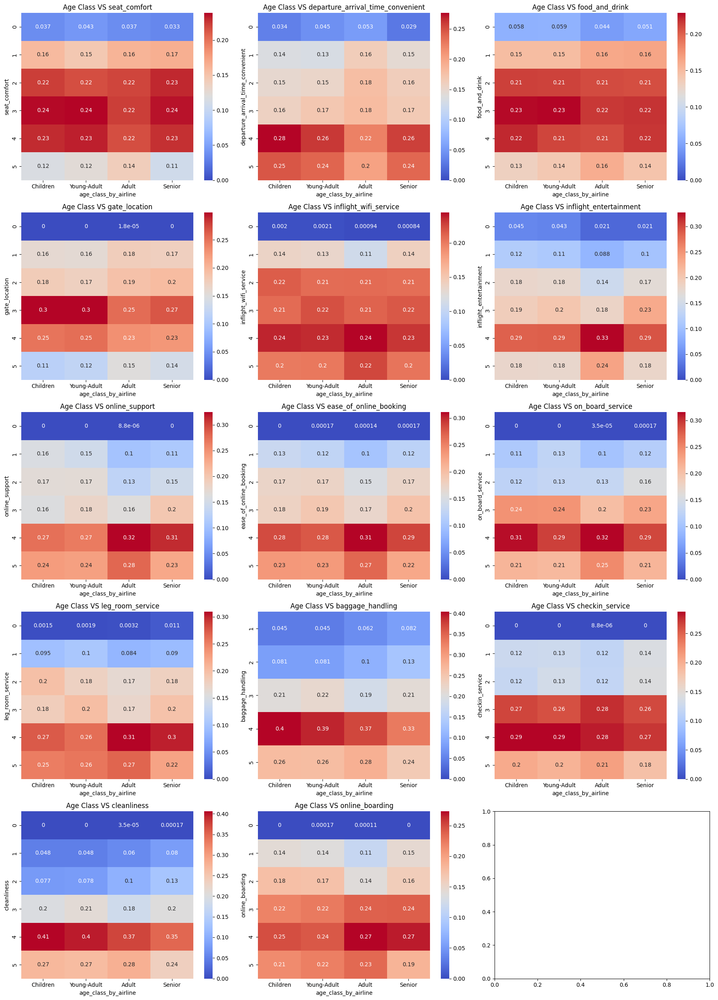

In [119]:
###########################################################
#Heatmap
###########################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
hue_order=rating_hue_order
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
for var,ax in zip(rating_list,axs.ravel()):
    target_data=data_cat
    result=pd.crosstab(target_data[var],target_data["age_class_by_airline"],normalize='columns')
    sns.heatmap(result, cmap="coolwarm",annot=True,vmin=0,ax=ax)
    ax.set_title(f'Age Class VS {var}')
plt.tight_layout()
plt.show()

### 3-(7~20) Age VS  Rating item class

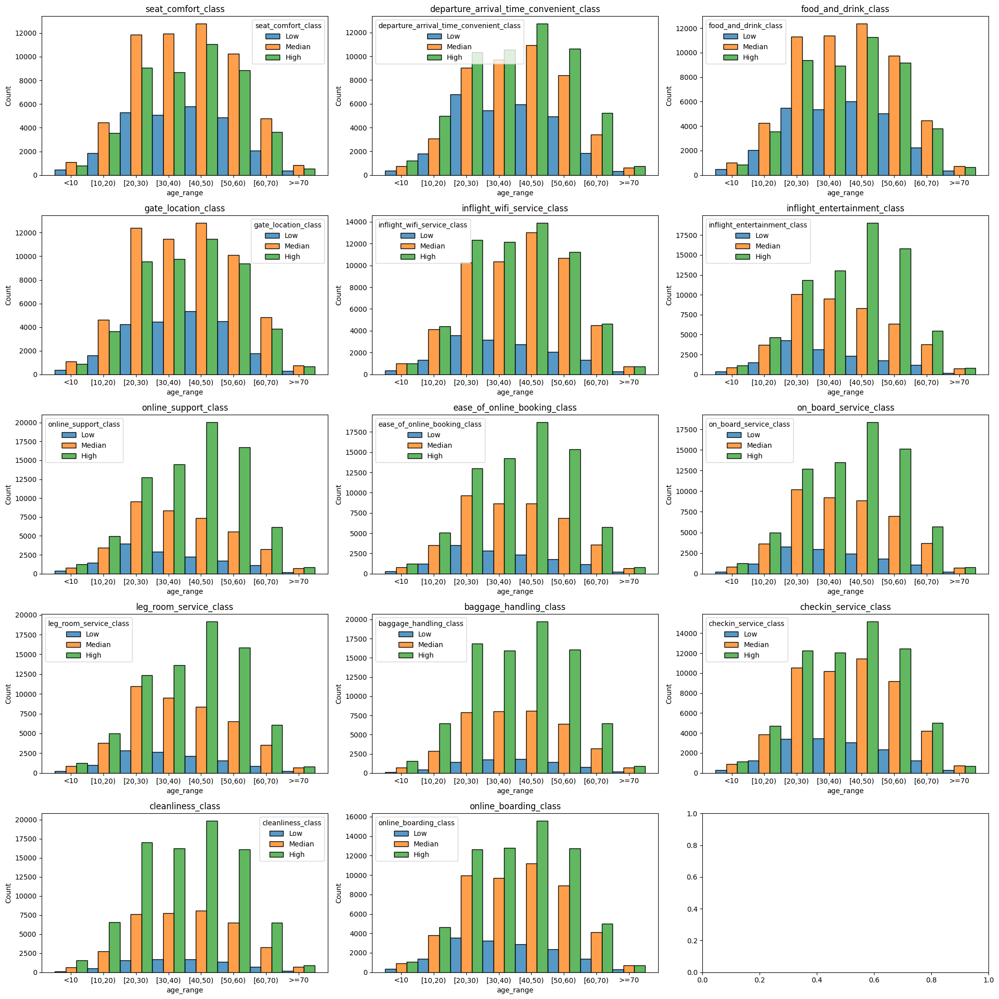

In [120]:
###############################################
#histplot
#Check survey variable
#By age range
###############################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(20,20))
hue_order=rating_class_hue_order

rating_list=['seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']
for var,ax in zip(rating_list,axs.ravel()):
    #sns.set_palette("tab10")
    sns.histplot(data=data_cat, x="age_range",ax=ax,stat='count',
                 hue=var, multiple="dodge",discrete=True,
                 hue_order=hue_order, palette="tab10")
    ax.set_title(var)
plt.tight_layout()
plt.show()

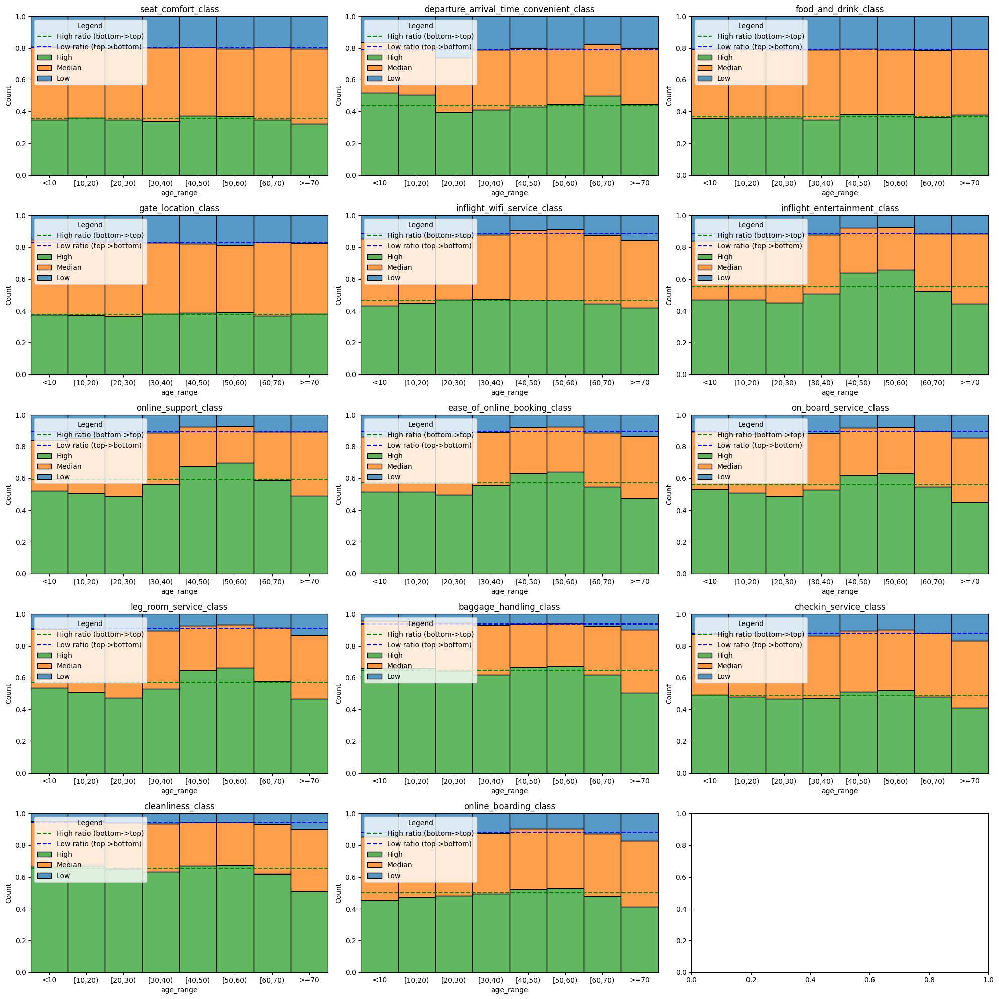

In [121]:
#############################################################
#Check survey variable
#By age range
#Score proportion of Age Range by different rating items
#############################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(20,20))
hue_order=rating_class_hue_order


rating_list=['seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']
for var,ax in zip(rating_list,axs.ravel()):
    low_ratio,high_ratio=cal_rating_class_ratio(var,data_cat)
    sns.histplot(data=data_cat, x="age_range",ax=ax
                 ,hue=var, multiple="fill",discrete=True,hue_order=hue_order, palette="tab10")
    #draw line
    ax.axhline(high_ratio,color="green",linestyle="--",label="High ratio (bottom->top)")
    ax.axhline(1-low_ratio,color="blue",linestyle="--",label="Low ratio (top->bottom)")
    #edit legend
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])

    ax.set_title(var)
plt.tight_layout()

plt.show()

#=>About Inflight_entertainment, among 40-60 there were higher ratio of High rating score
#among <=30 there were higher ratio of Low rating score

#=>About seat_comfort, no big change through different age range

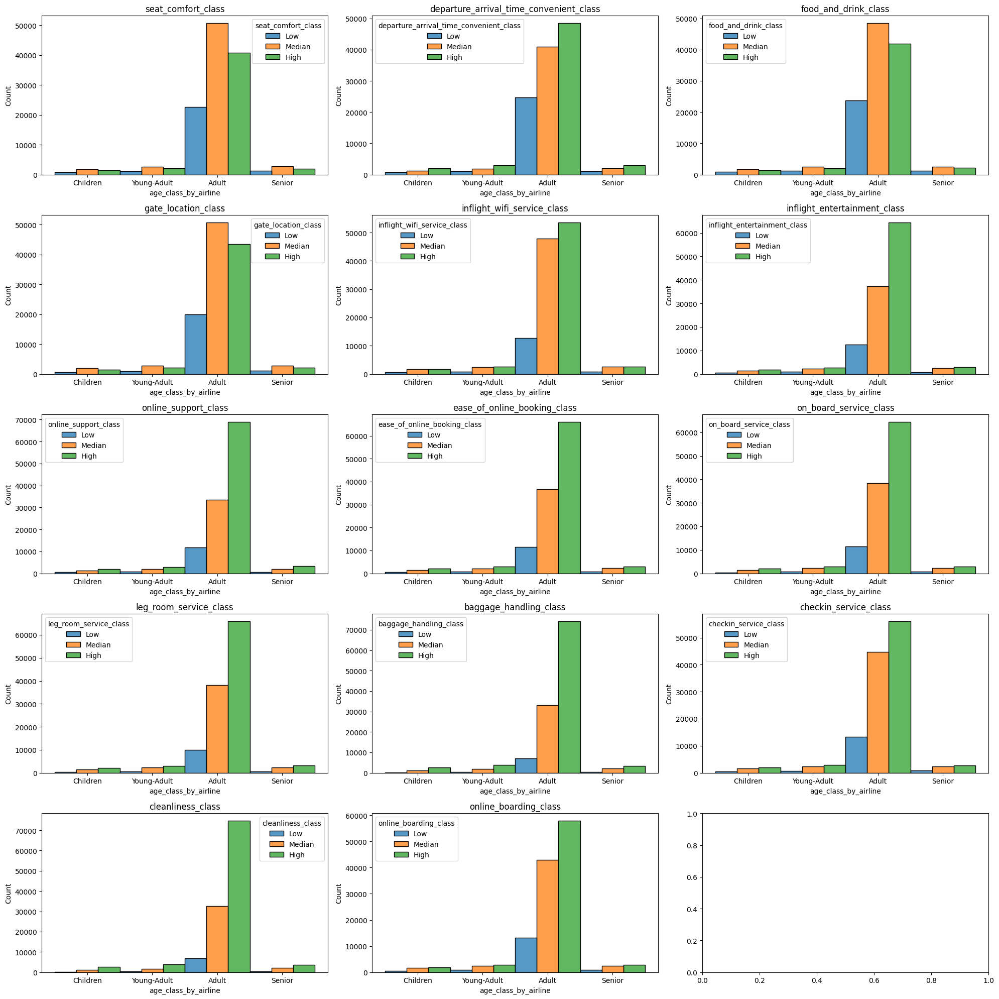

In [122]:
###############################################
#histplot
#Check survey variable
#By Age class
###############################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(20,20))
hue_order=rating_class_hue_order

rating_list=['seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']
for var,ax in zip(rating_list,axs.ravel()):
    sns.histplot(data=data_cat, x="age_class_by_airline",ax=ax,stat='count',
                 hue=var, multiple="dodge",discrete=True,
                 hue_order=hue_order, palette="tab10")
    ax.set_title(var)
plt.tight_layout()
plt.show()

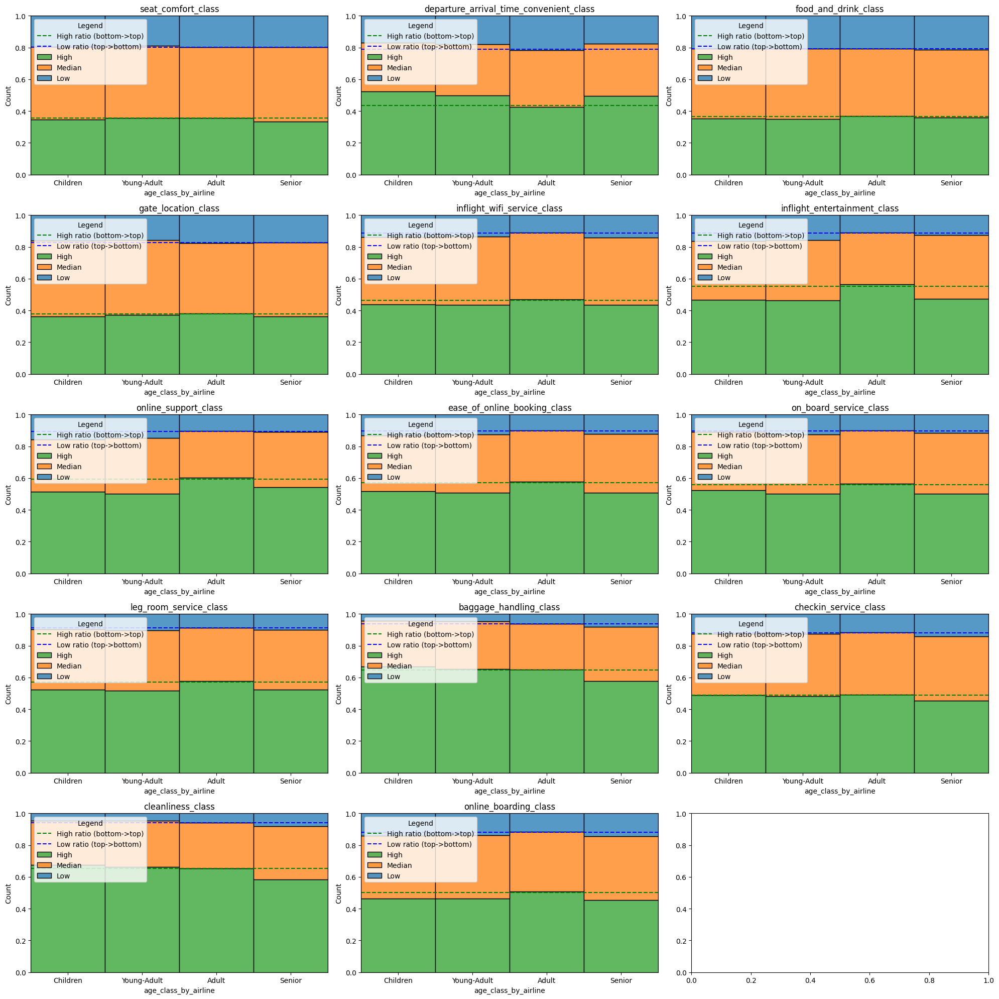

In [123]:
#############################################################
#Check survey variable
#By Age class
#Score proportion of Age class by different rating items
#############################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(20,20))
hue_order=rating_class_hue_order

rating_list=['seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']
for var,ax in zip(rating_list,axs.ravel()):
    low_ratio,high_ratio=cal_rating_class_ratio(var,data_cat)
    sns.histplot(data=data_cat, x="age_class_by_airline",ax=ax
                 ,hue=var, multiple="fill",discrete=True,hue_order=hue_order, palette="tab10")
    
    #draw line
    ax.axhline(high_ratio,color="green",linestyle="--",label="High ratio (bottom->top)")
    ax.axhline(1-low_ratio,color="blue",linestyle="--",label="Low ratio (top->bottom)")
    #edit legend
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    
    ax.set_title(var)
plt.tight_layout()
plt.show()

#=>About Inflight_entertainment, Children, Young-Adult and Senior had higher lower score ratio than Adult

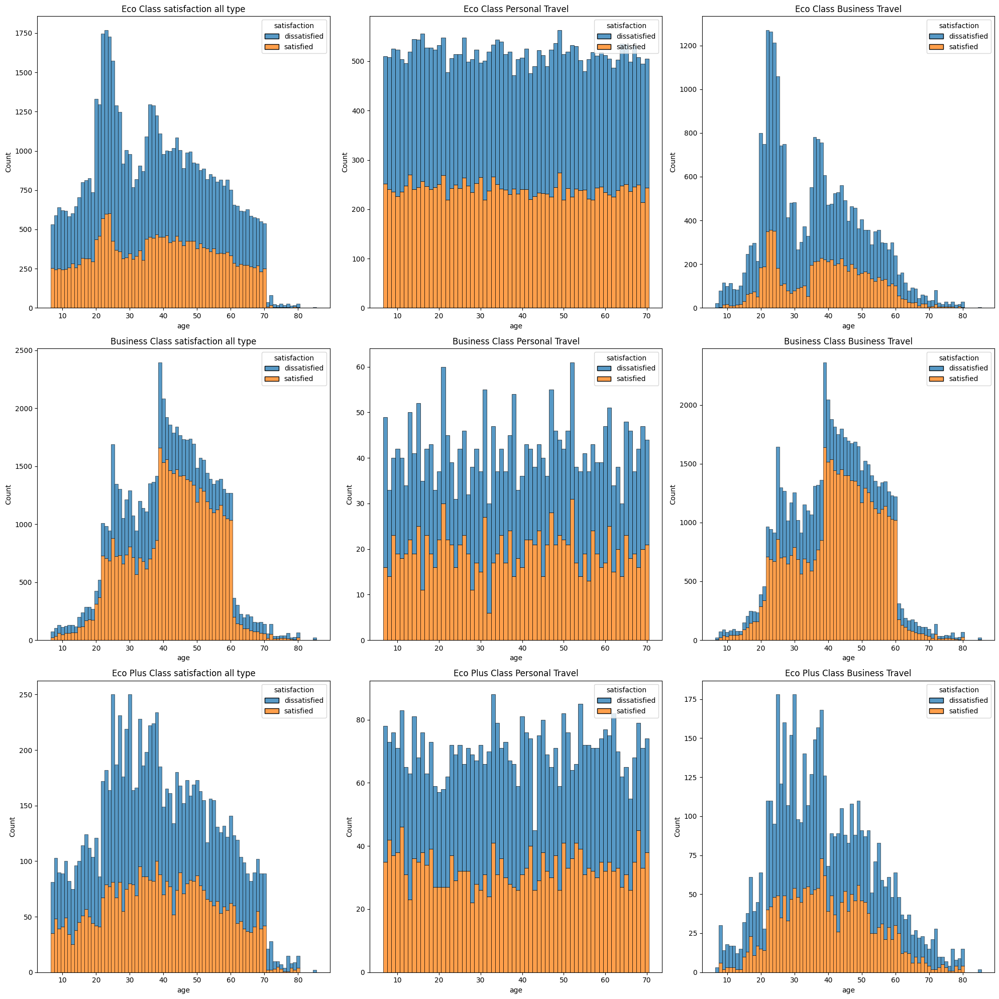

In [124]:
#####################################################################################
#Keep Class and Travel Type constant, satisfaction count by age
#####################################################################################
fig,axs=plt.subplots(3,3,sharey=False,sharex=False,figsize=(20,20))
class_item=data_cat["class"].unique()
hue_order=satisfaction_hue_order
for i, class_type in zip(range(len(class_item)), class_item):
    mask=data_cat["class"]==class_type
    mask_personal=data_cat[mask]['type_of_travel']=='Personal Travel'
    mask_business=data_cat[mask]['type_of_travel']=='Business Travel'
    target_data=data_cat[mask]
    sns.histplot(data=target_data, x="age",ax=axs[i][0],hue='satisfaction'
                , multiple="stack",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_personal], x="age",ax=axs[i][1],hue='satisfaction'
                , multiple="stack",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_business], x="age",ax=axs[i][2],hue='satisfaction'
                , multiple="stack",discrete=True,hue_order=hue_order)
    axs[i][0].set_title(f'{class_type} Class satisfaction all type')
    axs[i][1].set_title(f'{class_type} Class Personal Travel')
    axs[i][2].set_title(f'{class_type} Class Business Travel')
plt.tight_layout()
plt.show()

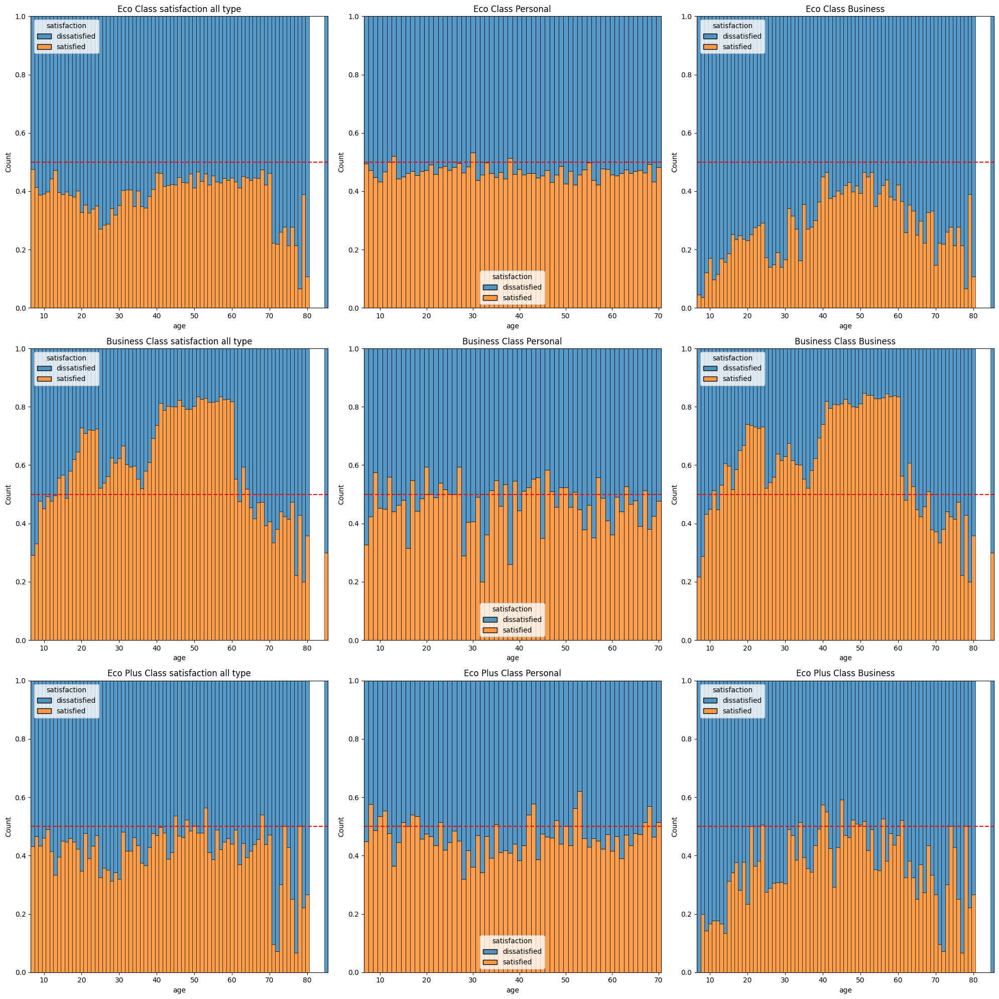

In [125]:
#####################################################################################
#Keep Class and Travel Type constant, satisfaction ratio by age
#####################################################################################
fig,axs=plt.subplots(3,3,sharey=False,sharex=False,figsize=(20,20))
class_item=data_cat["class"].unique()
hue_order=satisfaction_hue_order
for i, class_type in zip(range(len(class_item)), class_item):
    mask=data_cat["class"]==class_type
    mask_personal=data_cat[mask]['type_of_travel']=='Personal Travel'
    mask_business=data_cat[mask]['type_of_travel']=='Business Travel'
    target_data=data_cat[mask]
    sns.histplot(data=target_data, x="age",ax=axs[i][0]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_personal], x="age",ax=axs[i][1]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_business], x="age",ax=axs[i][2]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    
    axs[i][0].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][1].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][2].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    
    axs[i][0].set_title(f'{class_type} Class satisfaction all type')
    axs[i][1].set_title(f'{class_type} Class Personal')
    axs[i][2].set_title(f'{class_type} Class Business')
plt.tight_layout()
plt.show()
#=>satisfaction of Personal trip through different age seems relatively stable
#==>satisfied passengers of Eco class Personal trip is close to 50%, almost no change through different age
#==>satisfied passengers of Eco class Business trip is less than 40%, change through age
#==>satisfied passengers of Business class Personal trip is between 40%-50%, minor change through different age
#==>satisfied passengers of Business class Business trip is more than 50% at 15-65, change a lot through different age
#==>satisfied passengers of Eco Plus class Personal trip is between 40%-60%, minor change through different age
#==>satisfied passengers of Eco Plus class Business trip is less than 50% , change a lot through different age


#==>About business trip, differences between different class might because class is associated with success of their work, title and so on(some of them may not need to pay for the tickets).
#==>About personal trip, differences between different class might because balance between price and service quality and so on

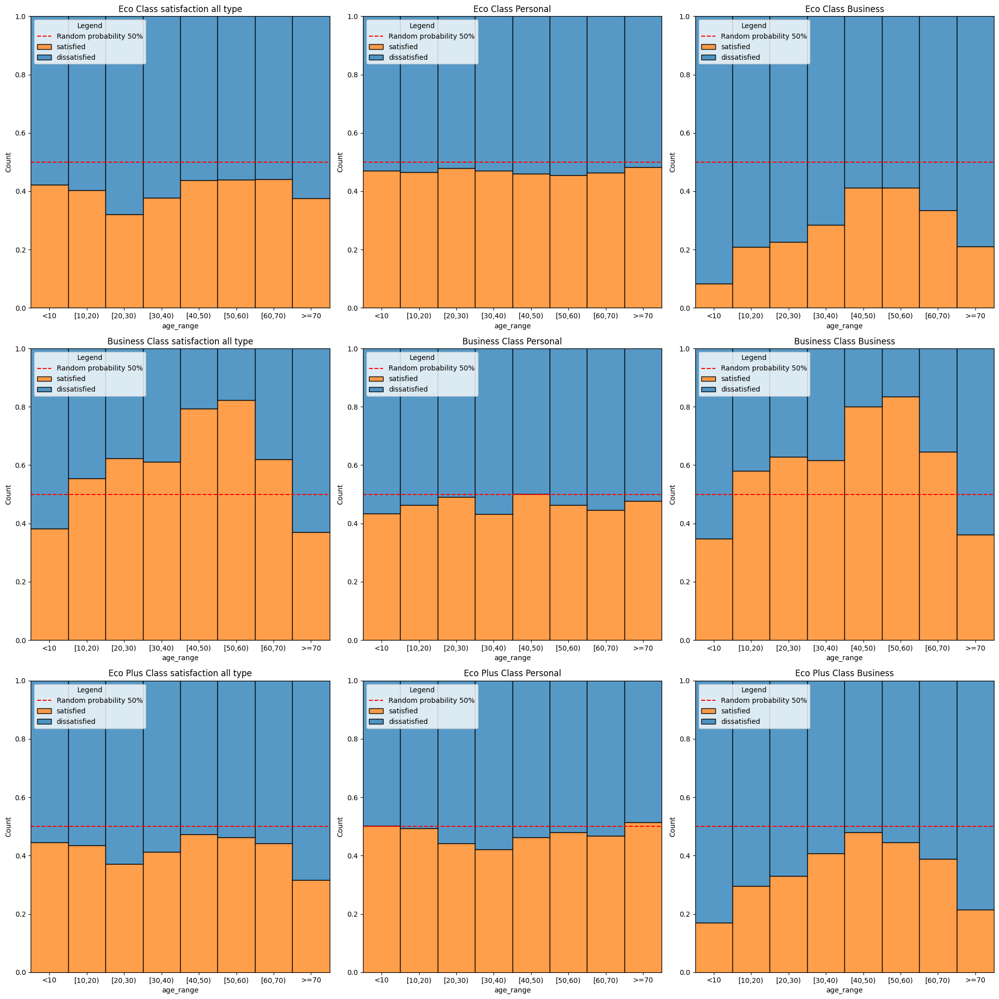

In [126]:
#####################################################################################
#Keep Class and Travel Type constant, satisfaction ratio by age range
#####################################################################################
fig,axs=plt.subplots(3,3,sharey=False,sharex=False,figsize=(20,20))
class_item=data_cat["class"].unique()
hue_order=satisfaction_hue_order
for i, class_type in zip(range(len(class_item)), class_item):
    mask=data_cat["class"]==class_type
    mask_personal=data_cat[mask]['type_of_travel']=='Personal Travel'
    mask_business=data_cat[mask]['type_of_travel']=='Business Travel'
    target_data=data_cat[mask]
    sns.histplot(data=target_data, x="age_range",ax=axs[i][0]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_personal], x="age_range",ax=axs[i][1]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_business], x="age_range",ax=axs[i][2]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    
    axs[i][0].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][1].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][2].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    
    axs[i][0].set_title(f'{class_type} Class satisfaction all type')
    axs[i][1].set_title(f'{class_type} Class Personal')
    axs[i][2].set_title(f'{class_type} Class Business')
    
    #edit legend
    handles, labels = axs[i][0].get_legend_handles_labels()
    axs[i][0].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    handles, labels = axs[i][1].get_legend_handles_labels()
    axs[i][1].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    handles, labels = axs[i][2].get_legend_handles_labels()
    axs[i][2].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    
plt.tight_layout()
plt.show()

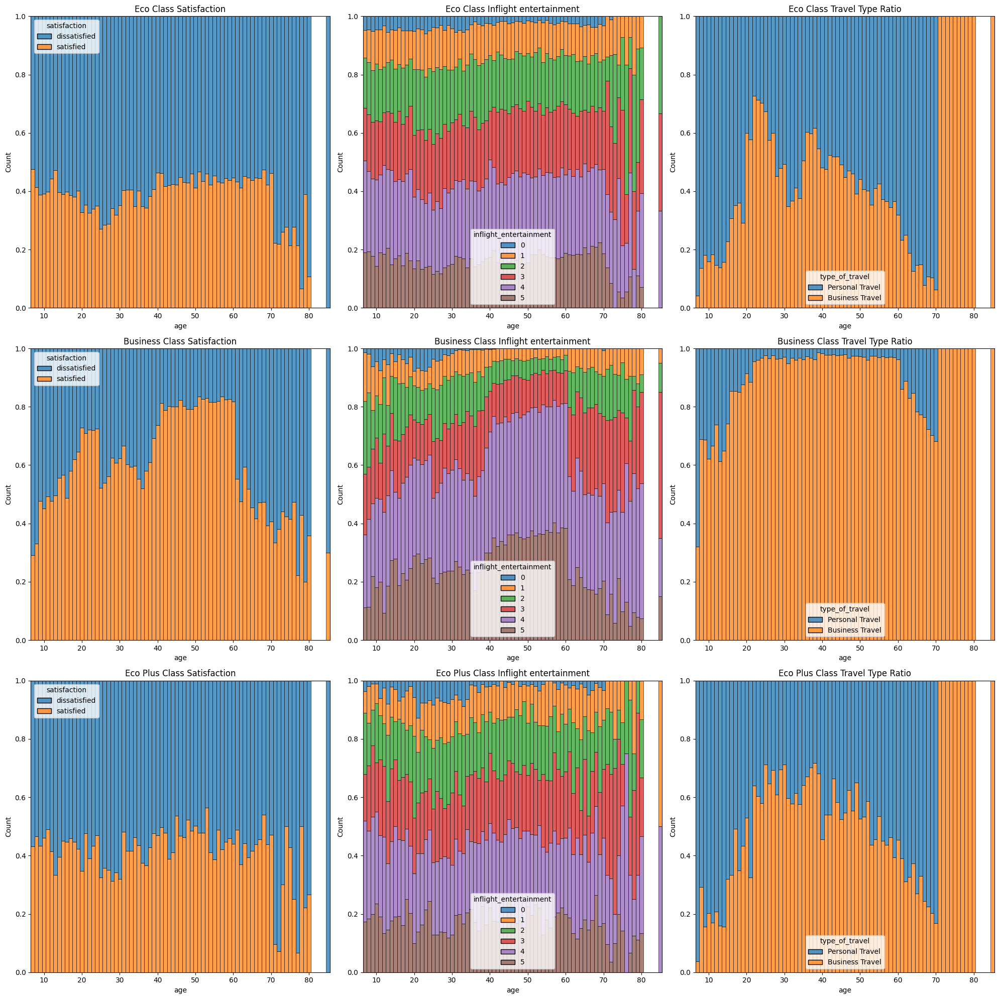

In [127]:
#####################################################################################
#hist plot of Age by Inflight_entertainment with different Class
#####################################################################################
fig,axs=plt.subplots(3,3,sharey=False,figsize=(20,20))
class_item=data_cat["class"].unique()
for i, class_type in zip(range(len(class_item)), class_item):
    mask=data_cat["class"]==class_type
    target_data=data_cat[mask]
    #sns.kdeplot(data=target_data, x="age",ax=axs[i][0],hue='satisfaction', multiple="fill")
    #sns.kdeplot(data=target_data, x="age",ax=axs[i][1],hue='inflight_entertainment', multiple="fill")
    #sns.kdeplot(data=target_data, x="age",ax=axs[i][2],hue='type_of_travel', multiple="fill")
    sns.histplot(data=target_data, x="age",ax=axs[i][0],hue='satisfaction'
                 , multiple="fill",discrete=True,hue_order=satisfaction_hue_order)
    sns.histplot(data=target_data, x="age",ax=axs[i][1],hue='inflight_entertainment'
                 , multiple="fill",discrete=True,hue_order=rating_hue_order)
    sns.histplot(data=target_data, x="age",ax=axs[i][2],hue='type_of_travel'
                 , multiple="fill",discrete=True,hue_order=travel_type_hue_order)
    axs[i][0].set_title(f'{class_type} Class Satisfaction')
    axs[i][1].set_title(f'{class_type} Class Inflight entertainment')
    axs[i][2].set_title(f'{class_type} Class Travel Type Ratio')
plt.tight_layout()
plt.show()

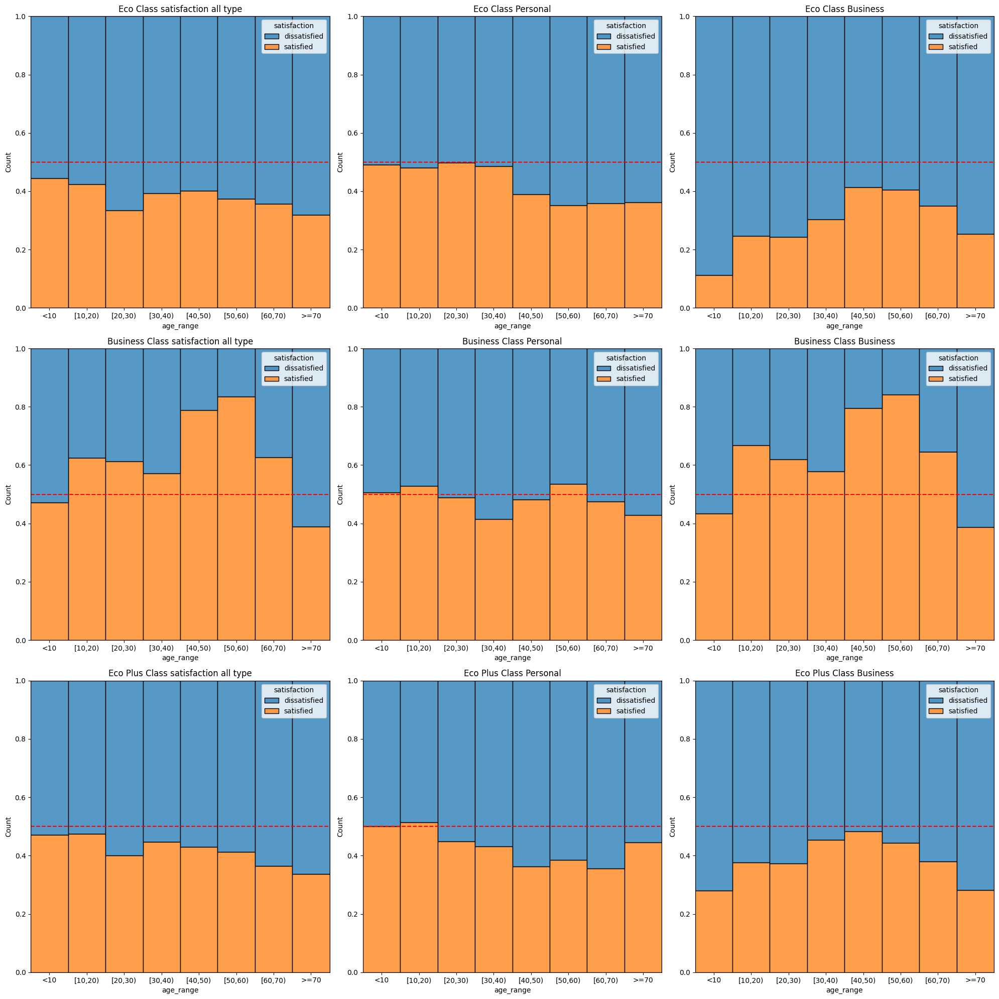

In [128]:
#####################################################################################
#Keep Class , Travel Type , Distance, Delay constant, satisfaction ratio by age
#Distance:Medium-Haul
#Delay: No Delay
#####################################################################################
fig,axs=plt.subplots(3,3,sharey=False,sharex=False,figsize=(20,20))
class_item=data_cat["class"].unique()
hue_order=satisfaction_hue_order
for i, class_type in zip(range(len(class_item)), class_item):
    mask=(data_cat["class"]==class_type)&(data_cat["flight_distance_class"]=='Medium-Haul')&(data_cat["departure_delay_class"]=='No Delay')
    mask_personal=data_cat[mask]['type_of_travel']=='Personal Travel'
    mask_business=data_cat[mask]['type_of_travel']=='Business Travel'
    target_data=data_cat[mask]
    sns.histplot(data=target_data, x="age_range",ax=axs[i][0]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_personal], x="age_range",ax=axs[i][1]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_business], x="age_range",ax=axs[i][2]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    
    axs[i][0].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][1].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][2].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    
    axs[i][0].set_title(f'{class_type} Class satisfaction all type')
    axs[i][1].set_title(f'{class_type} Class Personal')
    axs[i][2].set_title(f'{class_type} Class Business')
plt.tight_layout()
plt.show()
#=>About Medium-Haul travel, for personal travel, when age grows the satisfied tend to decrease
#=>for business travel, almost have a bell shape(40-60 seems like most satisfied)

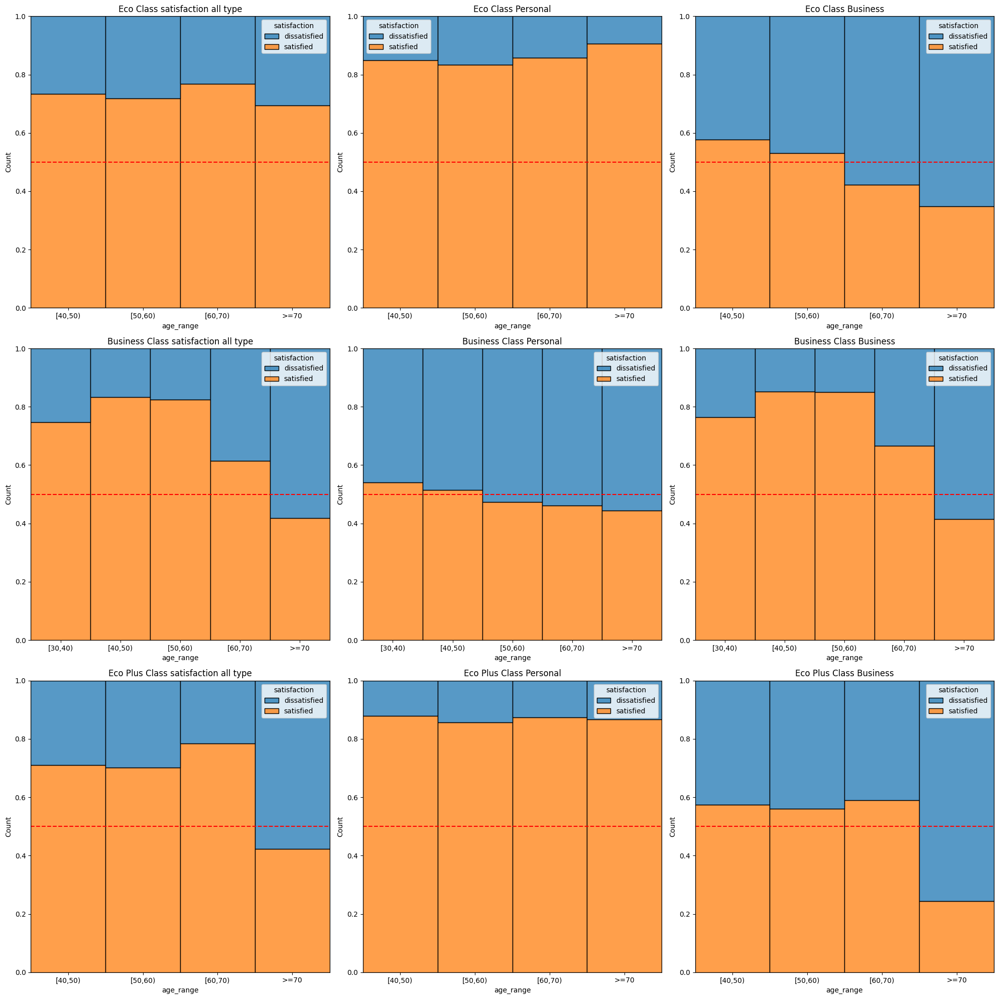

In [129]:
#####################################################################################
#Keep Class , Travel Type , Distance, Delay constant, satisfaction ratio by age
#Distance:Short-Haul
#Delay: No Delay
#####################################################################################
fig,axs=plt.subplots(3,3,sharey=False,sharex=False,figsize=(20,20))
class_item=data_cat["class"].unique()
hue_order=satisfaction_hue_order
for i, class_type in zip(range(len(class_item)), class_item):
    mask=(data_cat["class"]==class_type)&(data_cat["flight_distance_class"]=='Short-Haul')&(data_cat["departure_delay_class"]=='No Delay')
    mask_personal=data_cat[mask]['type_of_travel']=='Personal Travel'
    mask_business=data_cat[mask]['type_of_travel']=='Business Travel'
    target_data=data_cat[mask]
    sns.histplot(data=target_data, x="age_range",ax=axs[i][0]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_personal], x="age_range",ax=axs[i][1]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_business], x="age_range",ax=axs[i][2]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    
    axs[i][0].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][1].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][2].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    
    axs[i][0].set_title(f'{class_type} Class satisfaction all type')
    axs[i][1].set_title(f'{class_type} Class Personal')
    axs[i][2].set_title(f'{class_type} Class Business')
plt.tight_layout()
plt.show()
#=>no young age group in personal trip

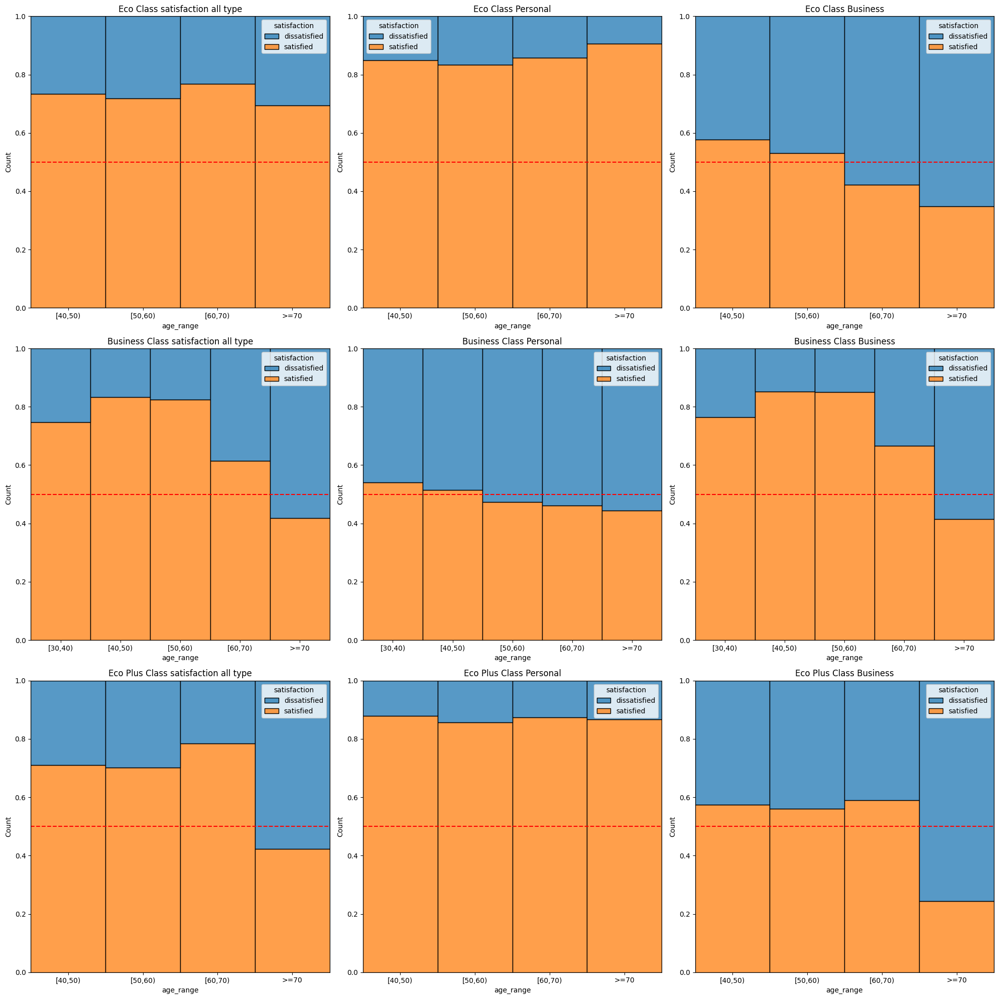

In [130]:
#####################################################################################
#Keep Class , Travel Type , Distance, Delay constant, satisfaction ratio by age
#Distance:Long-Haul
#Delay: No Delay
#####################################################################################
fig,axs=plt.subplots(3,3,sharey=False,sharex=False,figsize=(20,20))
class_item=data_cat["class"].unique()
hue_order=satisfaction_hue_order
for i, class_type in zip(range(len(class_item)), class_item):
    mask=(data_cat["class"]==class_type)&(data_cat["flight_distance_class"]=='Short-Haul')&(data_cat["departure_delay_class"]=='No Delay')
    mask_personal=data_cat[mask]['type_of_travel']=='Personal Travel'
    mask_business=data_cat[mask]['type_of_travel']=='Business Travel'
    target_data=data_cat[mask]
    sns.histplot(data=target_data, x="age_range",ax=axs[i][0]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_personal], x="age_range",ax=axs[i][1]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_business], x="age_range",ax=axs[i][2]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    
    axs[i][0].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][1].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][2].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    
    axs[i][0].set_title(f'{class_type} Class satisfaction all type')
    axs[i][1].set_title(f'{class_type} Class Personal')
    axs[i][2].set_title(f'{class_type} Class Business')
plt.tight_layout()
plt.show()
#=>no young age group in personal trip

### 3-(7~20) Age VS  departure_delay_in_minutes

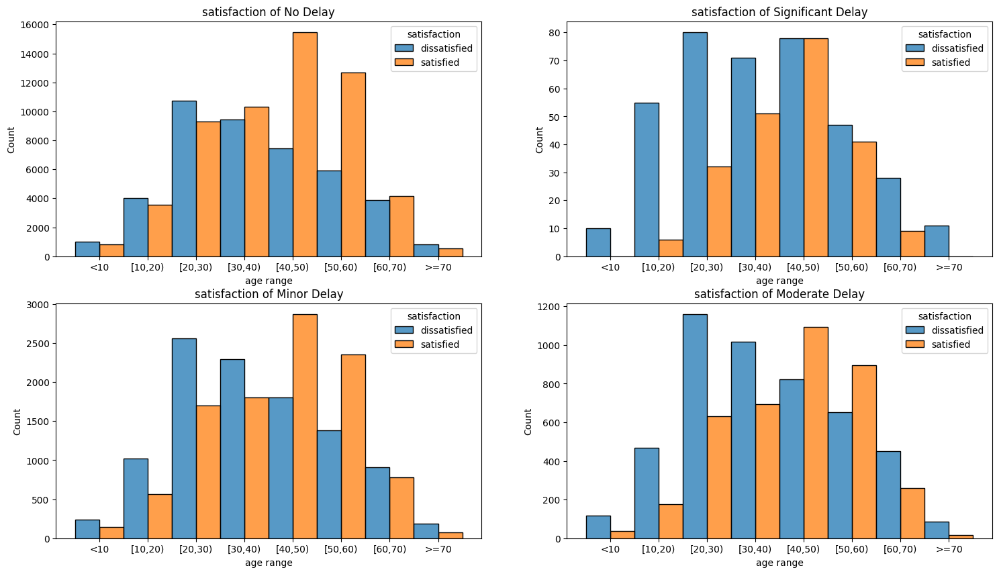

In [131]:
################################################
#Keep Flight Departure Delay Group Constant
#Count by Age Range
################################################
fig,axs=plt.subplots(2,2,figsize=(18,10))
hue_order=satisfaction_hue_order
target_data=data_cat
delay_class=target_data["departure_delay_class"].unique().to_list()
for delaytype, ax in zip(delay_class,axs.ravel()):
    data=target_data[target_data["departure_delay_class"]==delaytype]
    sns.histplot(data=data, x="age_range", hue="satisfaction",ax=ax,
                 multiple="dodge",hue_order=hue_order,discrete=True)
    ax.set_title(f"satisfaction of {delaytype}")
    ax.set_xlabel("Count")
    ax.set_xlabel("age range")
plt.show()

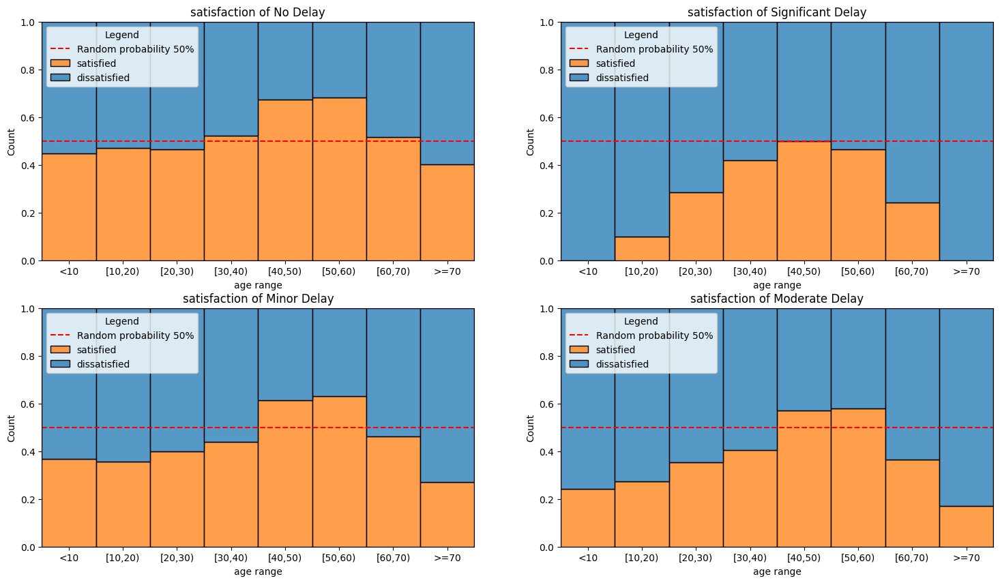

In [132]:
################################################
#Keep Flight Departure Delay Group Constant
#Satisfaction Proportion by Age Range
################################################
fig,axs=plt.subplots(2,2,figsize=(18,10))
hue_order=satisfaction_hue_order
target_data=data_cat
delay_class=target_data["departure_delay_class"].unique().to_list()
for delaytype, ax in zip(delay_class,axs.ravel()):
    data=target_data[target_data["departure_delay_class"]==delaytype]
    sns.histplot(data=data, x="age_range", hue="satisfaction",ax=ax,
                 multiple="fill",hue_order=hue_order,discrete=True)
    ax.set_title(f"satisfaction of {delaytype}")
    ax.axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    #edit legend
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    ax.set_xlabel("Proportion")
    ax.set_xlabel("age range")
plt.show()

#=>Children and senior seems very dissatisfied when face delay more than 1 hour
##=>for some passengers, they might need more/extra support(have special needs, e.g food) when encounter long time delay
##=>for group passengers, when need to change airplane, if some members are not able to go alone, it would be difficult for them to take an alternative plane(need wait for enough seats)

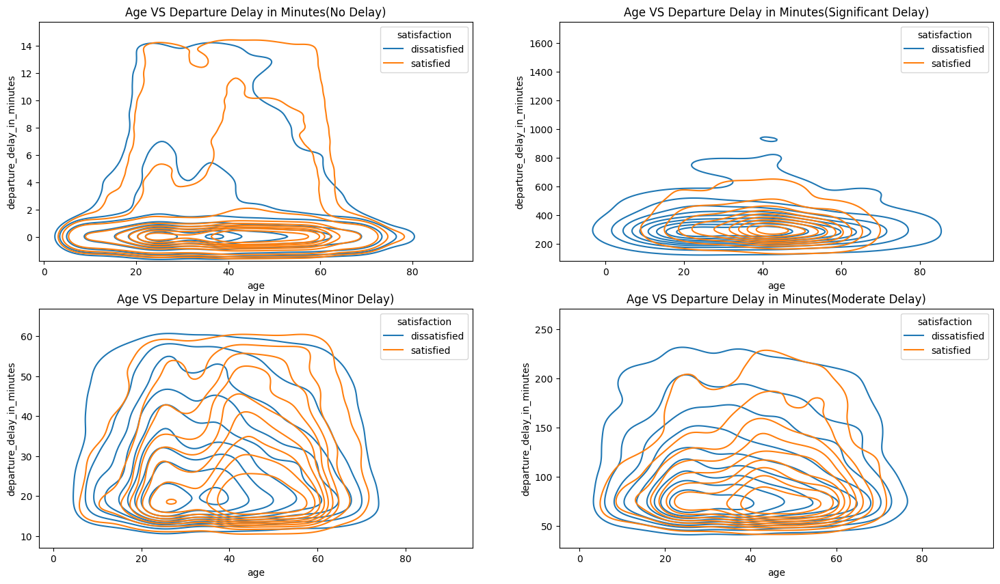

In [133]:
################################################
#Keep Flight Departure Delay Group Constant
#kde plot of Age and departure_delay_in_minutes
################################################
fig,axs=plt.subplots(2,2,figsize=(18,10))
hue_order=satisfaction_hue_order
target_data=data_cat
delay_class=target_data["departure_delay_class"].unique().to_list()
for delaytype, ax in zip(delay_class,axs.ravel()):
    data=target_data[target_data["departure_delay_class"]==delaytype]
    sns.kdeplot(data=data, x="age", y="departure_delay_in_minutes", 
                  hue="satisfaction", ax=ax,hue_order=hue_order)
    ax.set_title(f"Age VS Departure Delay in Minutes({delaytype})")
plt.show()

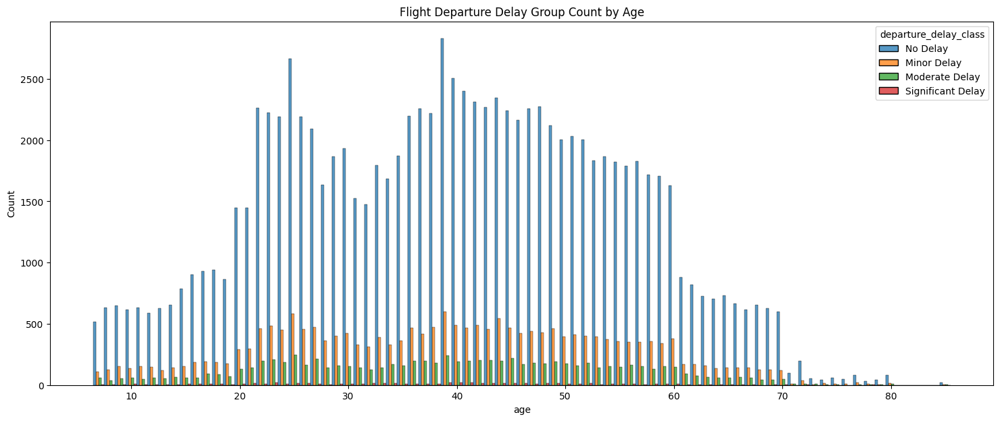

In [134]:
################################################
#Flight Departure Delay Group Count by Age
################################################
plt.figure(figsize=(18,7))
hue_order=delay_class_hue_order
target_data=data_cat
ax=sns.histplot(data=target_data, x='age',hue='departure_delay_class', multiple="dodge",legend=True,discrete=True,hue_order=hue_order)
plt.title("Flight Departure Delay Group Count by Age")

plt.show()

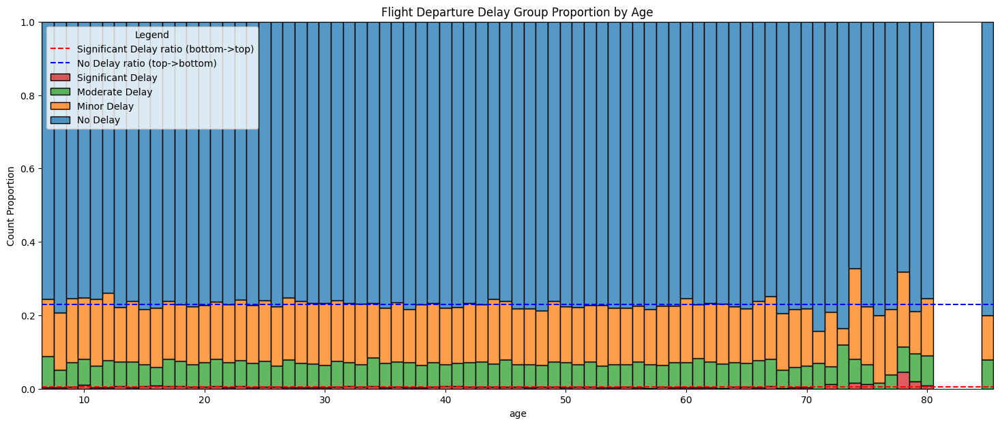

In [135]:
################################################
#Flight Departure Delay Group Proportion by Age
################################################
plt.figure(figsize=(18,7))
hue_order=delay_class_hue_order
target_data=data_cat
No_delay_per=round(target_data[target_data['departure_delay_class']=='No Delay']['satisfaction'].count()/target_data.shape[0],3)
Significant_delay_per=round(target_data[target_data['departure_delay_class']=='Significant Delay']['satisfaction'].count()/target_data.shape[0],3)
ax=sns.histplot(data=target_data, x='age',hue='departure_delay_class', multiple="fill",legend=True,discrete=True,hue_order=hue_order)
ax.axhline(Significant_delay_per,color="red",linestyle="--",label="Significant Delay ratio (bottom->top)")
ax.axhline(1-No_delay_per,color="blue",linestyle="--",label="No Delay ratio (top->bottom)")

plt.ylabel("Count Proportion")
plt.title("Flight Departure Delay Group Proportion by Age")

#edit legend
handles, labels = ax.get_legend_handles_labels()
plt.legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])

plt.show()

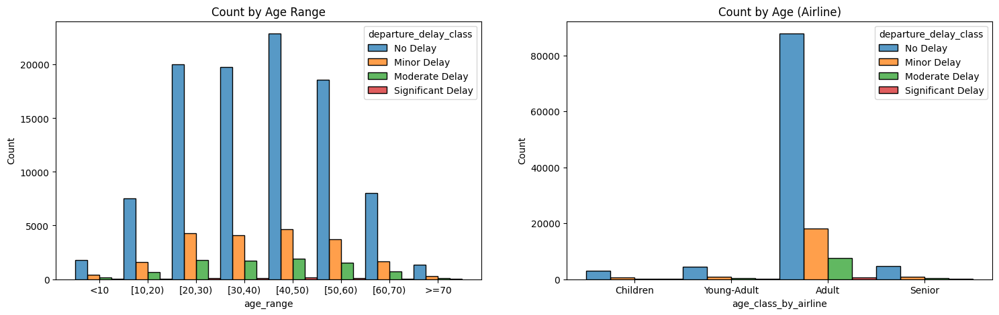

In [136]:
##########################################################
#Count by Age Group and Flight Departure Delay Group
##########################################################
fig, axs = plt.subplots(1,2,figsize=(18,5))

hue_order=delay_class_hue_order
sns.histplot(data=data_cat, x="age_range",hue='departure_delay_class', multiple="dodge",ax=axs[0],hue_order=hue_order)
sns.histplot(data=data_cat, x="age_class_by_airline",hue='departure_delay_class', multiple="dodge",ax=axs[1],hue_order=hue_order)

#set title
axs[0].set_title("Count by Age Range")
axs[1].set_title("Count by Age (Airline)")

plt.show()

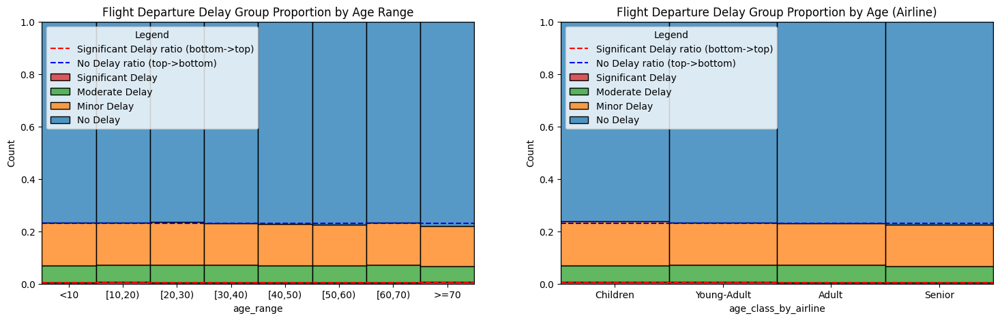

In [137]:
##########################################################
#Flight Departure Delay Group Proportion by Age Group
##########################################################
fig, axs = plt.subplots(1,2,figsize=(18,5))

hue_order=delay_class_hue_order
sns.histplot(data=data_cat, x="age_range",hue='departure_delay_class', multiple="fill",ax=axs[0],hue_order=hue_order)
sns.histplot(data=data_cat, x="age_class_by_airline",hue='departure_delay_class', multiple="fill",ax=axs[1],hue_order=hue_order)

#set probability line
No_delay_per=round(target_data[target_data['departure_delay_class']=='No Delay']['satisfaction'].count()/target_data.shape[0],3)
Significant_delay_per=round(target_data[target_data['departure_delay_class']=='Significant Delay']['satisfaction'].count()/target_data.shape[0],3)

axs[0].axhline(Significant_delay_per,color="red",linestyle="--",label="Significant Delay ratio (bottom->top)")
axs[0].axhline(1-No_delay_per,color="blue",linestyle="--",label="No Delay ratio (top->bottom)")
axs[1].axhline(Significant_delay_per,color="red",linestyle="--",label="Significant Delay ratio (bottom->top)")
axs[1].axhline(1-No_delay_per,color="blue",linestyle="--",label="No Delay ratio (top->bottom)")

#set title
axs[0].set_title("Flight Departure Delay Group Proportion by Age Range")
axs[1].set_title("Flight Departure Delay Group Proportion by Age (Airline)")

#edit legend
handles, labels = axs[0].get_legend_handles_labels()
axs[0].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
handles, labels = axs[1].get_legend_handles_labels()
axs[1].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])


plt.show()
#=>‘No Delay’ ratio almost no change(minor change) across different age group
#some age group are not satisfied, it may indicate flight departure delay was not the main cause

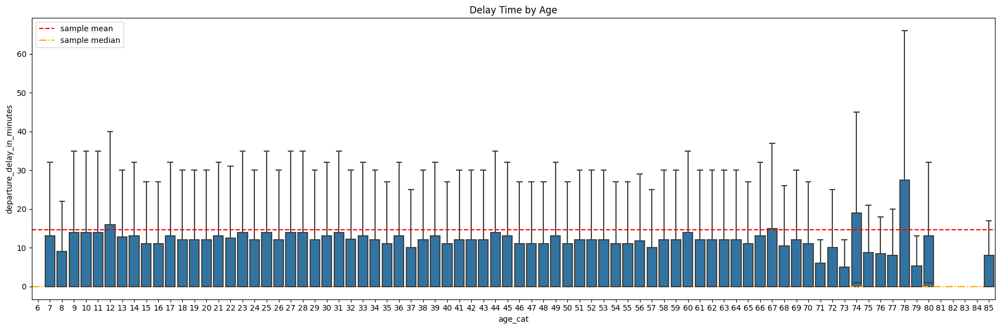

In [138]:
#######################################################
#Box plot of Departure Delay in Minutes by Age
#######################################################
plt.figure(figsize=(18,6))
target_data=data_cat
mean_delay=target_data["departure_delay_in_minutes"].mean()
median_delay=target_data["departure_delay_in_minutes"].median()
sns.boxplot(data=target_data, x="age_cat",y="departure_delay_in_minutes",showfliers=False,color='tab:blue')
plt.axhline(mean_delay,color="red",linestyle="--",label="sample mean")
plt.axhline(median_delay,color="orange",linestyle="-.",label="sample median")
plt.title("Delay Time by Age")
plt.tight_layout()
plt.legend()
plt.show()

In [139]:
data_cat.groupby(['age_range'])['departure_delay_in_minutes'].agg(["min","max","std","mean","median"])

,min,max,std,mean,median
age_range,,,,,
<10,0,1128,44.249421,15.015805,0.0
"[10,20)",0,853,39.301233,15.324830,0.0
"[20,30)",0,859,37.608097,14.981168,0.0
"[30,40)",0,1305,39.189721,14.861850,0.0
"[40,50)",0,1592,40.037775,14.861823,0.0
"[50,60)",0,930,34.835560,13.963991,0.0
"[60,70)",0,570,35.278025,14.480591,0.0
>=70,0,368,36.568603,13.842775,0.0


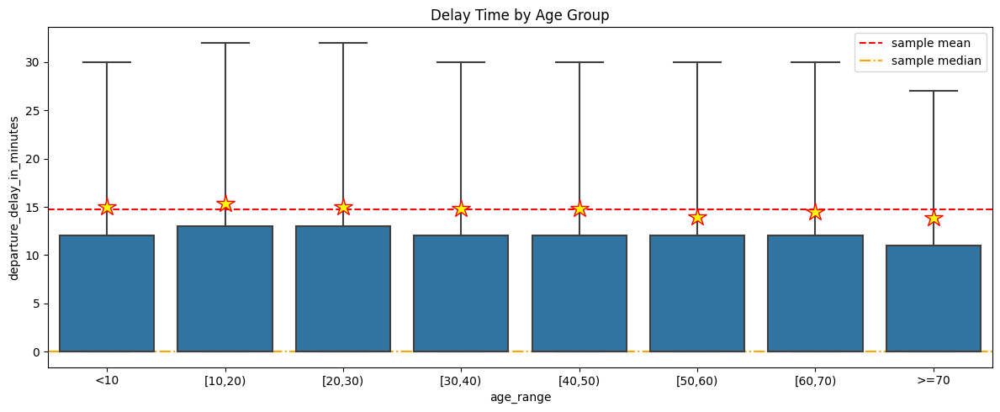

In [140]:
#########################################################
#Box plot of Departure Delay in Minutes by Age Range
#########################################################
plt.figure(figsize=(12,5))
target_data=data_cat
mean_delay=target_data["departure_delay_in_minutes"].mean()
median_delay=target_data["departure_delay_in_minutes"].median()
sns.boxplot(data=target_data, x="age_range",y="departure_delay_in_minutes",
            showfliers=False,color='tab:blue',
            showmeans=True,
            meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})
plt.axhline(mean_delay,color="red",linestyle="--",label="sample mean")
plt.axhline(median_delay,color="orange",linestyle="-.",label="sample median")
plt.title("Delay Time by Age Group")
plt.tight_layout()
plt.legend()
plt.show()

## 4 Type of Travel

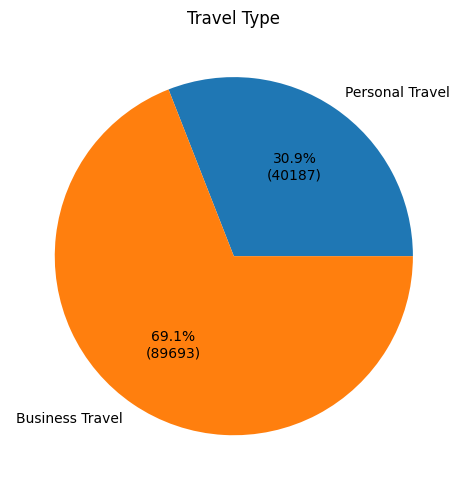

In [141]:
#######################################
#Pie Chart
#######################################
plt.figure(figsize=(6,5))
result=data_cat.groupby(['type_of_travel'])[['satisfaction']].count().reset_index().rename(columns={'satisfaction':'count'})
plt.pie(result['count'],labels = result["type_of_travel"], autopct=autopct_format(result['count']))
plt.title("Travel Type")
plt.tight_layout()
plt.show()
#=>around 70% of travels in this dataset were business travel

### 4-5 Type of Travel VS Class
### 4-5 Type of Travel VS class_m

class,type_of_travel,Eco,Eco Plus,Business
0,Personal Travel,33005,4509,2673
1,Business Travel,25304,4902,59487


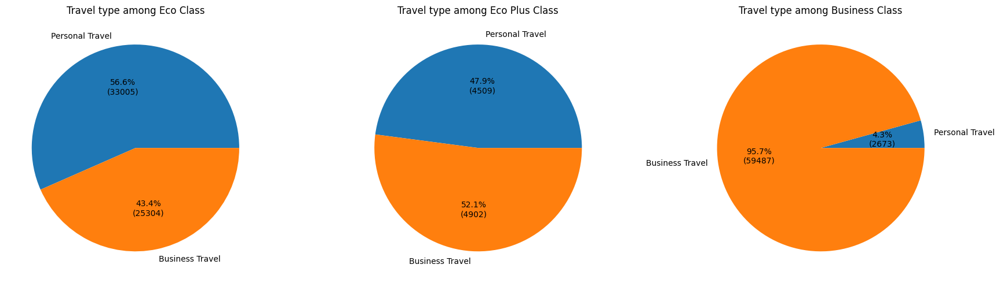

In [142]:
#######################################
#P(Type of Travel | Class)
#######################################
result=pd.crosstab(data_cat['type_of_travel'],data_cat['class'],margins=False).reset_index()

display(result)
col_nm=class_hue_order
#col_nm.sort()

#######################################
#Pie Chart
#######################################
colCnt=3
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(colCnt*6,rowCnt*5))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["type_of_travel"], autopct=autopct_format(result[col]))
    ax.set_title(f"Travel type among {col} Class")
plt.tight_layout()
plt.show()

type_of_travel,class,Personal Travel,Business Travel
0,Eco,33005,25304
1,Eco Plus,4509,4902
2,Business,2673,59487


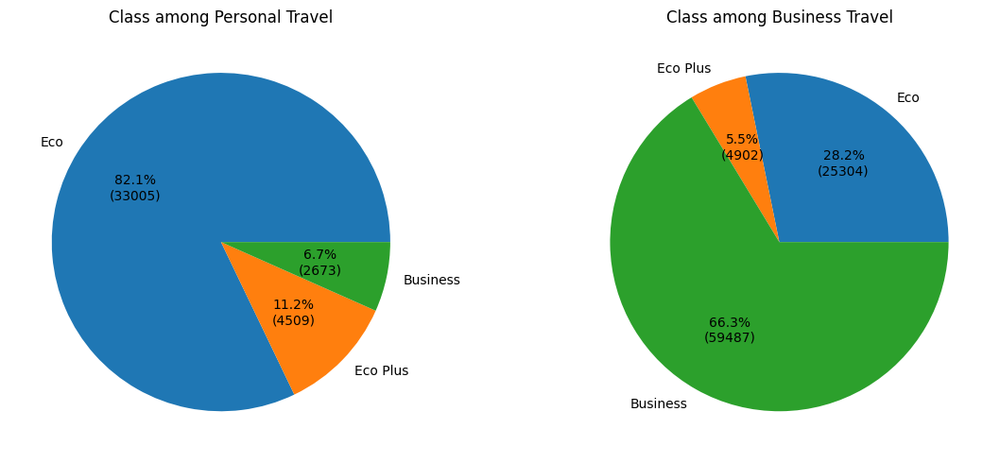

In [143]:
#######################################
#P(Class | Type of Travel)
#######################################
result=pd.crosstab(data_cat['class'],data_cat['type_of_travel'],margins=False).reset_index()

display(result)
col_nm=travel_type_hue_order

#######################################
#Pie Chart
#######################################
colCnt=2
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(colCnt*6,rowCnt*5))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["class"], autopct=autopct_format(result[col]))
    ax.set_title(f"Class among {col}")
plt.tight_layout()
plt.show()

#=>Among personal travel, 82.1% of passengers were Eco class, higher than total sample ratio
#=>Among business travel, 66.3% of passengers were Business class, higher than total sample ratio

class_m,type_of_travel,Eco&EcoPlus,Business
0,Personal Travel,37514,2673
1,Business Travel,30206,59487


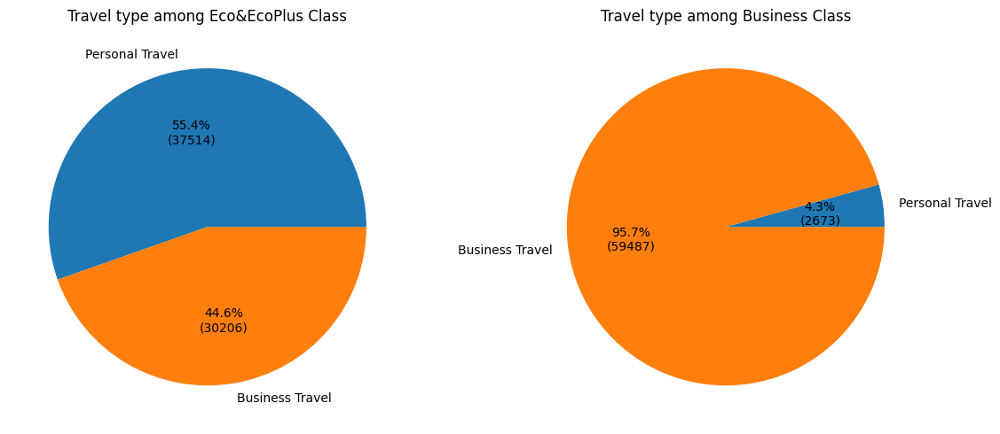

In [144]:
#######################################
#P(Type of Travel | class_m)
#######################################
result=pd.crosstab(data_cat['type_of_travel'],data_cat['class_m'],margins=False).reset_index()

display(result)
col_nm=class_merge_hue_order


#######################################
#Pie Chart
#######################################
colCnt=2
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(colCnt*6,rowCnt*5))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["type_of_travel"], autopct=autopct_format(result[col]))
    ax.set_title(f"Travel type among {col} Class")
plt.tight_layout()
plt.show()
#among business class, 95.7% of passengers were business purpose
#among Eco&EcoPlus class, 44.6% of passengers were business purpose

### 4-6 Type of Travel VS Flight Distance

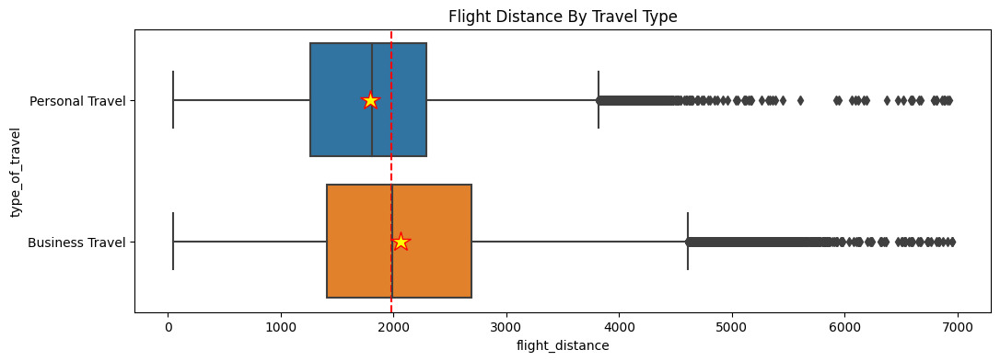

In [145]:
#############################################
#Box plot of distance by travel type
#############################################
plt.figure(figsize=(12,4))
target_data=data_cat
mean_distance=target_data["flight_distance"].mean()
sns.boxplot(data=target_data, x="flight_distance",y='type_of_travel',
            showmeans=True,
            meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})

#add a line of average distance
plt.axvline(mean_distance,color="red",linestyle="--")
plt.title("Flight Distance By Travel Type")
plt.show()
#=>median distance of business is longer than personal

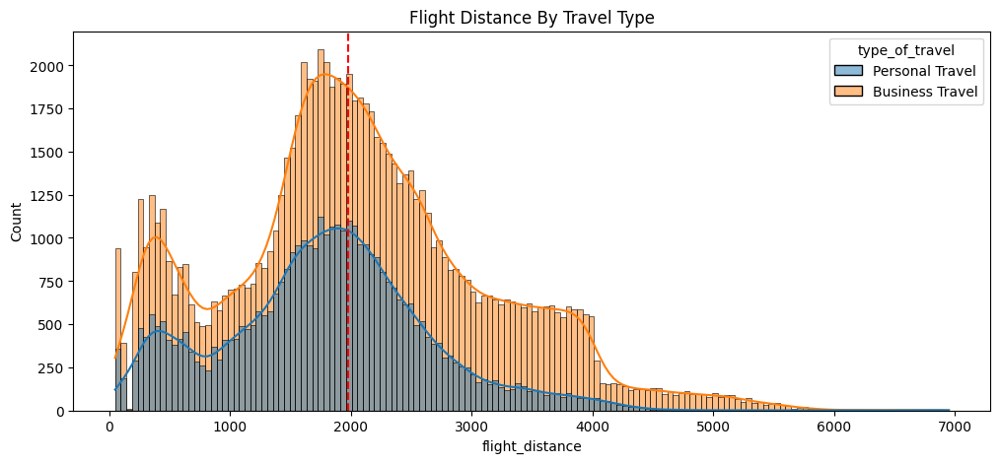

In [146]:
#############################################
#Hist plot of distance by travel type
#############################################
plt.figure(figsize=(12,5))
target_data=data_cat
hue_order=travel_type_hue_order
mean_distance=target_data["flight_distance"].mean()
sns.histplot(data=target_data, x="flight_distance",hue='type_of_travel',hue_order=hue_order,palette='tab10',kde=True)

#add a line of average distance
plt.axvline(mean_distance,color="red",linestyle="--")
plt.title("Flight Distance By Travel Type")
plt.show()


$H_{0}$: Average flight distance of personal travel is greater than or equal to business travel<BR>
$H_{A}$: Average flight distance of personal travel is less than business travel

set significance level to 0.05

In [147]:
significance_level=0.05

sample=data_cat

sample_business=sample[sample["type_of_travel"]=="Business Travel"]["flight_distance"]
sample_personal=sample[sample["type_of_travel"]=="Personal Travel"]["flight_distance"]

#####################################
#The Mann-Whitney U test
#####################################
from scipy.stats import mannwhitneyu

statistic, pvalue = mannwhitneyu(sample_personal,sample_business, alternative="less")
show_test_result(statistic, pvalue,significance_level)

#####################################
#T-test
#####################################
statistic, pvalue=stats.ttest_ind(sample_personal,sample_business, equal_var=False, alternative="less")
show_test_result(statistic, pvalue,significance_level)

Reject H0 at significance level 0.05 (Pvalue=0.0, Statistic=1550341725.5)
Reject H0 at significance level 0.05 (Pvalue=0.0, Statistic=-48.76)


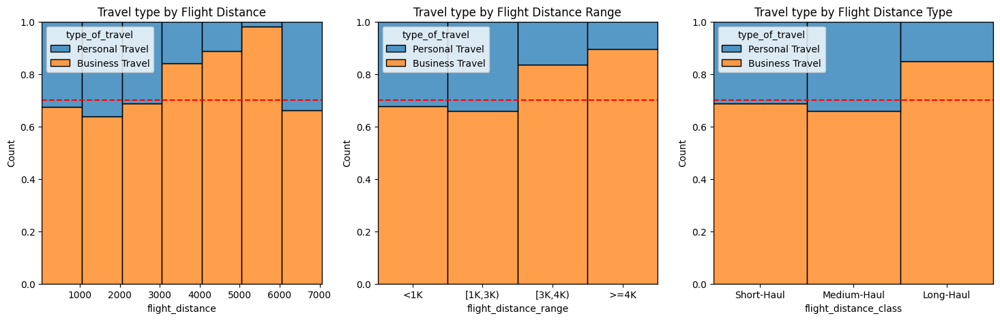

In [148]:
fig, axs = plt.subplots(1,3,figsize=(18,5))

hue_order=travel_type_hue_order
sns.histplot(data=data_cat, x="flight_distance",hue='type_of_travel'
             , multiple="fill",ax=axs[0],hue_order=hue_order,binwidth=1000)
sns.histplot(data=data_cat, x="flight_distance_range",hue='type_of_travel'
             , multiple="fill",ax=axs[1],hue_order=hue_order)
sns.histplot(data=data_cat, x="flight_distance_class",hue='type_of_travel'
             , multiple="fill",ax=axs[2],hue_order=hue_order)

#set business trip ratio line(total sample)
business_per=round(df_original[df_original['type_of_travel']=='Business Travel']['type_of_travel'].count()/df_original.shape[0],1)
axs[0].axhline(business_per,color="red",linestyle="--",label="business trip ratio")
axs[1].axhline(business_per,color="red",linestyle="--",label="business trip ratio")
axs[2].axhline(business_per,color="red",linestyle="--",label="business trip ratio")

#set title
axs[0].set_title("Travel type by Flight Distance")
axs[1].set_title("Travel type by Flight Distance Range")
axs[2].set_title("Travel type by Flight Distance Type")
plt.show()
#=>As distance gets longer, business trip proportion gets higher

### 4-(7~20) Type of Travel VS Rating

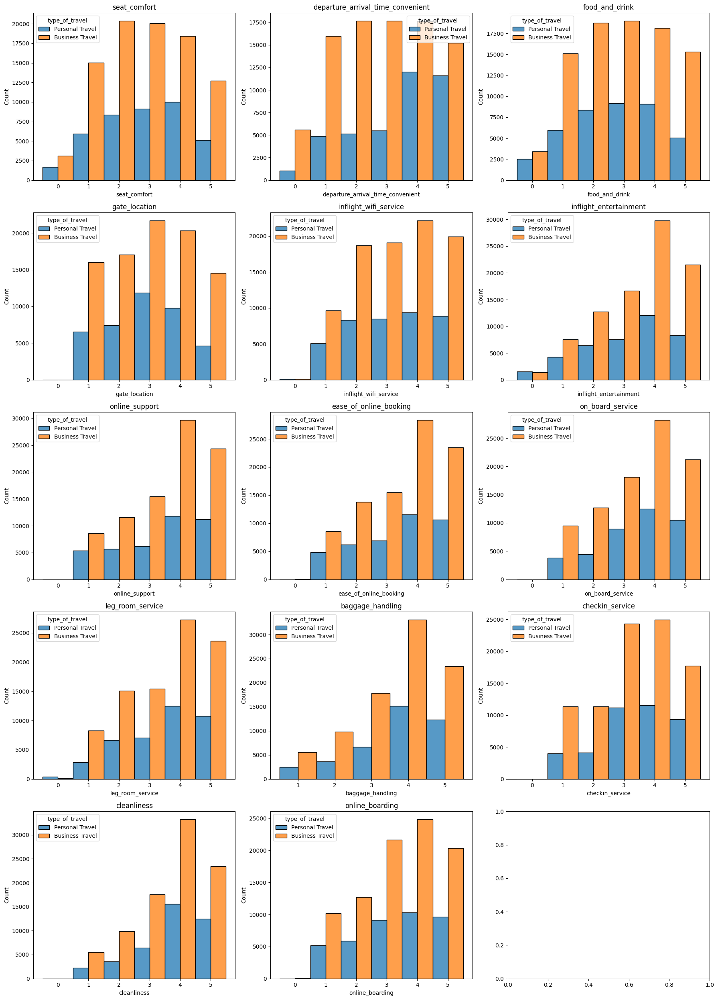

In [149]:
#################################################
#Histgram 
#rating item
#################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
var_num=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
hue_order=travel_type_hue_order
for var,ax in zip(var_num,axs.ravel()):
    sns.histplot(data=data_cat, x=var,ax=ax, 
             hue="type_of_travel",element="bars", legend=True,
             stat="count", multiple="dodge",kde=False,hue_order=hue_order)
    ax.set_title(var)
plt.tight_layout()
plt.show()

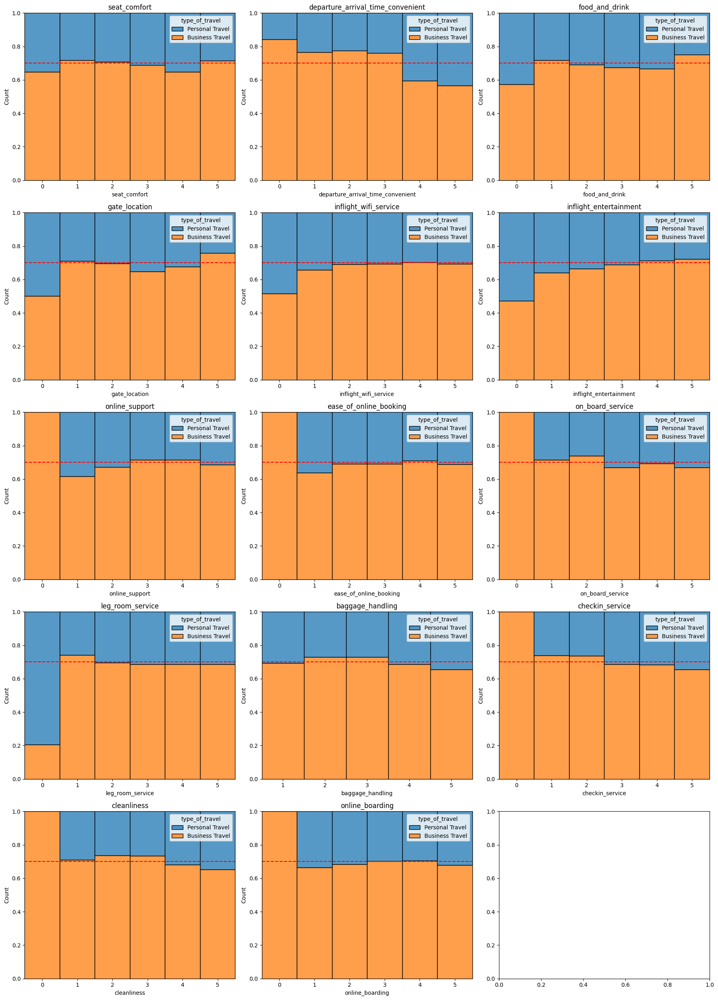

In [150]:
#################################################
#proportion
#rating item
#################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
var_num=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
hue_order=travel_type_hue_order
business_per=round(df_original[df_original['type_of_travel']=='Business Travel']['type_of_travel'].count()/df_original.shape[0],1)
for var,ax in zip(var_num,axs.ravel()):
    sns.histplot(data=data_cat, x=var,hue='type_of_travel', multiple="fill"
                 ,ax=ax,hue_order=hue_order,legend=True,binwidth=1)
    ax.axhline(business_per,color="red",linestyle="--",label="business ratio")
    ax.set_title(var)
plt.tight_layout()
plt.show()

#=>For inflight entertainment, amount low scores(<4) personal travel passengers tend to be more dissatisfied

### 4-21 Type of Travel VS Departure Delay in Minutes

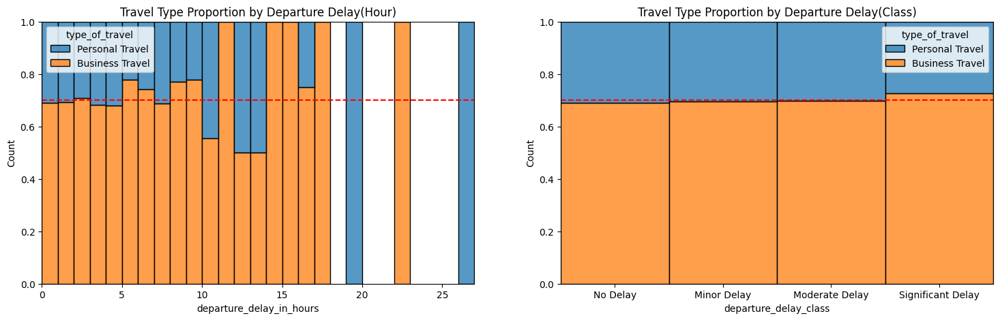

In [151]:
#################################################
#Travel Type proportion by departure delay
#rating item
#################################################
fig, axs = plt.subplots(1,2,figsize=(18,5))
hue_order=travel_type_hue_order
sns.histplot(data=data_cat, x="departure_delay_in_hours",hue='type_of_travel', hue_order=hue_order, multiple="fill",ax=axs[0],binwidth=1)
sns.histplot(data=data_cat, x="departure_delay_class",hue='type_of_travel', hue_order=hue_order, multiple="fill",ax=axs[1])

#set business trip ratio(total sample) line
business_per=round(df_original[df_original['type_of_travel']=='Business Travel']['type_of_travel'].count()/df_original.shape[0],1)
axs[0].axhline(business_per,color="red",linestyle="--",label="50%")
axs[1].axhline(business_per,color="red",linestyle="--",label="50%")

#set title
axs[0].set_title("Travel Type Proportion by Departure Delay(Hour)")
axs[1].set_title("Travel Type Proportion by Departure Delay(Class)")
plt.show()
#=>As departure delay gets longer, business trip proportion gets higher

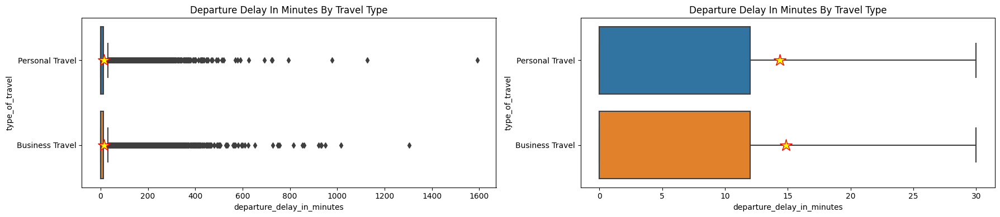

In [152]:
#############################################################
#Box plot of departure_delay_in_minutes by travel type
#############################################################


fig, axs = plt.subplots(1,2,figsize=(18,4))
sns.boxplot(data=data_cat, y="type_of_travel",x="departure_delay_in_minutes",ax=axs[0],
            showmeans=True,
            meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})
axs[0].set_title("Departure Delay In Minutes By Travel Type")

sns.boxplot(data=data_cat, y="type_of_travel",x="departure_delay_in_minutes",ax=axs[1],
            showfliers=False,
            showmeans=True,
            meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})
mean_departure_delay=data_cat["departure_delay_in_minutes"].mean()
#axs[1].axvline(mean_departure_delay,color="red",linestyle="--",label="sample mean")

axs[1].set_title("Departure Delay In Minutes By Travel Type")

plt.tight_layout()
plt.show()

In [153]:
data_cat.groupby(['type_of_travel'])['departure_delay_in_minutes'].describe()

,count,mean,std,min,25%,50%,75%,max
type_of_travel,,,,,,,,
Personal Travel,40187.0,14.377386,37.761743,0.0,0.0,0.0,12.0,1592.0
Business Travel,89693.0,14.864404,38.208182,0.0,0.0,0.0,12.0,1305.0


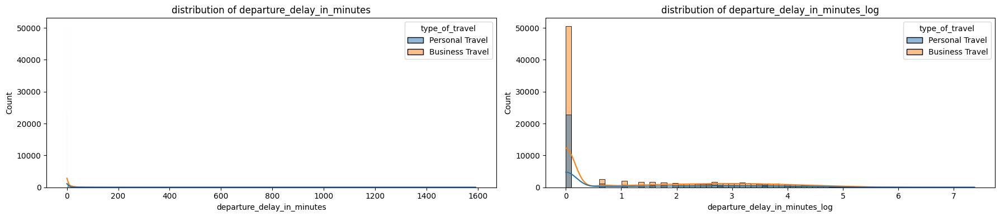

In [154]:
#####################################################################################
#hist plot of departure_delay_in_minutes by travel type
#####################################################################################
fig,axs=plt.subplots(1,2,sharey=False,sharex=False,figsize=(18,4))
hue_order=travel_type_hue_order
sns.histplot(data=data_cat, x='departure_delay_in_minutes',hue='type_of_travel',
             hue_order=hue_order,palette='tab10',ax=axs[0],kde=True)
axs[0].set_title("distribution of departure_delay_in_minutes")

sns.histplot(data=data_cat, x='departure_delay_in_minutes_log',hue='type_of_travel',
             hue_order=hue_order,palette='tab10',ax=axs[1],kde=True)
axs[1].set_title("distribution of departure_delay_in_minutes_log")

plt.tight_layout()
plt.show()

#=>They were not normal distribution

$H_{0}$: Average departure delay in minutes of personal travel is equal to business travel<BR>
$H_{A}$: Average departure delay in minutes of personal travel is not equal to business travel

set significance level to 0.05

In [155]:
significance_level=0.05
sample=data_cat
sample_business=sample[sample["type_of_travel"]=="Business Travel"]["departure_delay_in_minutes"]
sample_personal=sample[sample["type_of_travel"]=="Personal Travel"]["departure_delay_in_minutes"]
#####################################
#The Mann-Whitney U test
#####################################
statistic, pvalue = mannwhitneyu(sample_business, sample_personal,alternative="two-sided")
show_test_result(statistic, pvalue,significance_level)

#####################################
#T-test
#####################################

def bootstrap_sample(data, resample_count=10000, sample_size=100):
    new_sample=[]
    for i in range(resample_count):
        sample=data.sample(n=sample_size, replace=True)
        sample_mean=np.mean(sample)
        new_sample.append(sample_mean)
    return new_sample
statistic, pvalue=stats.ttest_ind(sample_business, sample_personal, equal_var=False, alternative="two-sided")
show_test_result(statistic, pvalue,significance_level)

#=>two sample data didn't follow normal distribution, didn't meet two sample t test assumptions
#=> prioritize the results of non-parametric tests(Mann-Whitney U test) over the t-test, in this case fail to reject H0

Fail to reject H0 at significance level 0.05 (Pvalue=0.091, Statistic=1811798224.0)
Reject H0 at significance level 0.05 (Pvalue=0.032, Statistic=2.14)


* $H_{0}$: travel type and departure_delay_class are independent
* $H_{A}$: travel type and departure_delay_class are not independent

* set significance level to 0.05

In [156]:
significance_level=0.05
#####################################
#Chi-squre test
#####################################
obs_tb=pd.crosstab(data_cat['type_of_travel'], data_cat["departure_delay_class"])
#obs_tb=pd.crosstab(data_cat['type_of_travel'], data_cat["departure_delay_in_hours"])
statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(obs_tb, correction=False)
show_test_result(statistic, pvalue,significance_level)

Reject H0 at significance level 0.05 (Pvalue=0.044, Statistic=8.09)


### 4-22 Type of Travel VS Arrival Delay in Minutes

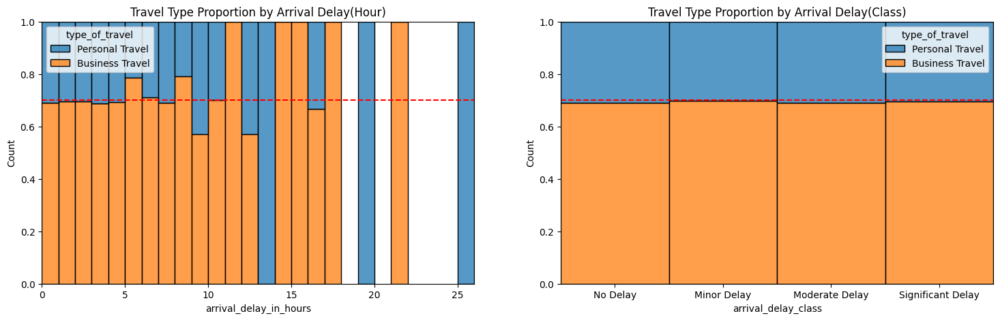

In [157]:
#################################################
#Travel Type proportion by arrival delay
#rating item
#################################################
fig, axs = plt.subplots(1,2,figsize=(18,5))
hue_order=travel_type_hue_order
sns.histplot(data=data_cat, x="arrival_delay_in_hours",hue='type_of_travel', hue_order=hue_order, multiple="fill",ax=axs[0],binwidth=1)
sns.histplot(data=data_cat, x="arrival_delay_class",hue='type_of_travel', hue_order=hue_order, multiple="fill",ax=axs[1])

#set business trip ratio(total sample) line
business_per=round(df_original[df_original['type_of_travel']=='Business Travel']['type_of_travel'].count()/df_original.shape[0],1)
axs[0].axhline(business_per,color="red",linestyle="--",label="50%")
axs[1].axhline(business_per,color="red",linestyle="--",label="50%")

#set title
axs[0].set_title("Travel Type Proportion by Arrival Delay(Hour)")
axs[1].set_title("Travel Type Proportion by Arrival Delay(Class)")
plt.show()

## 5 Class and class_m

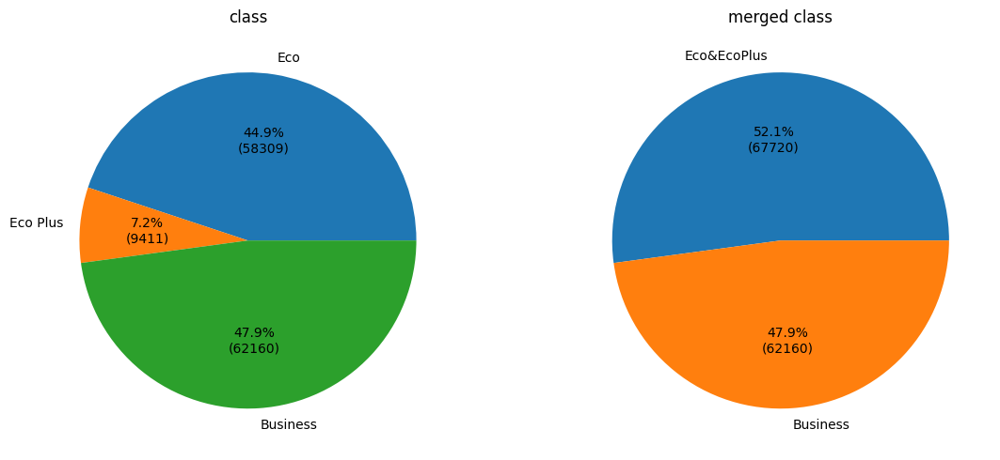

In [158]:
#######################################
#Pie Chart
#######################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
result=data_cat.groupby(['class'])[['satisfaction']].count().reset_index().rename(columns={'satisfaction':'count'})
axs[0].pie(result['count'],labels = result["class"], autopct=autopct_format(result['count']))
axs[0].set_title("class")

result=data_cat.groupby(['class_m'])[['satisfaction']].count().reset_index().rename(columns={'satisfaction':'count'})
axs[1].pie(result['count'],labels = result["class_m"], autopct=autopct_format(result['count']))
axs[1].set_title("merged class")
plt.tight_layout()
plt.show()
#=>in general, business class seats are less than eco class seats
#in this dataset, these two class have similar proportion
#the sample proportion is different from seat proportion

#https://www.routesonline.com/suppliers/10554/capa-centre-for-aviation/news/299661788/flying-with-frills-global-airlines-ranked-by-first-class-and-premium-seat-numbers/#:~:text=First%20class%20accounts%20for%20just,class%20for%2012.2%25%20of%20seats.


### 5-6 Class VS Flight Distance

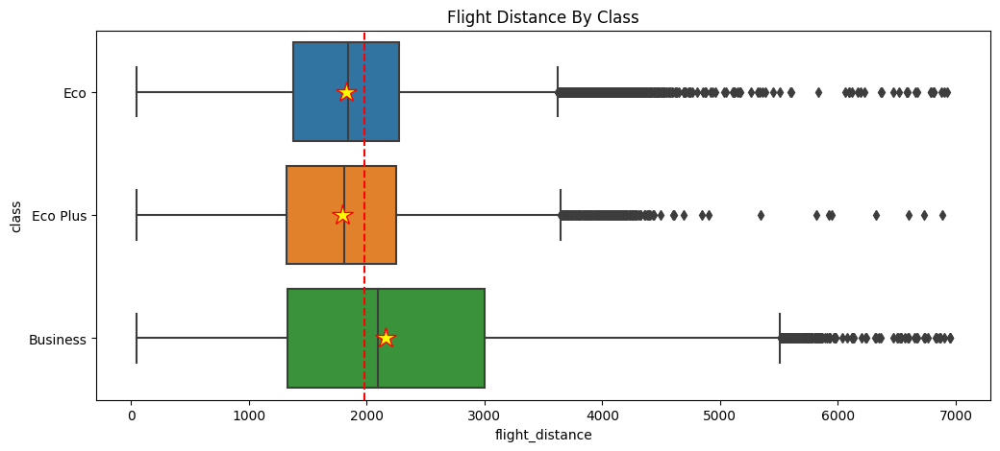

In [159]:
plt.figure(figsize=(12,5))
target_data=data_cat
mean_distance=target_data["flight_distance"].mean()
sns.boxplot(data=target_data, x="flight_distance",y='class',
            showmeans=True,
            meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})

#add a line of average distance
plt.axvline(mean_distance,color="red",linestyle="--",label='sample mean')
plt.title("Flight Distance By Class")
plt.show()
#=>median distance of business class is longer than other class

In [160]:
pd.crosstab(data_cat['class'], data_cat["flight_distance_class"],margins=True,normalize='columns')

flight_distance_class,Short-Haul,Medium-Haul,Long-Haul,All
class,,,,
Eco,0.354350,0.522443,0.183943,0.448945
Eco Plus,0.068315,0.081831,0.031911,0.072459
Business,0.577335,0.395726,0.784145,0.478596


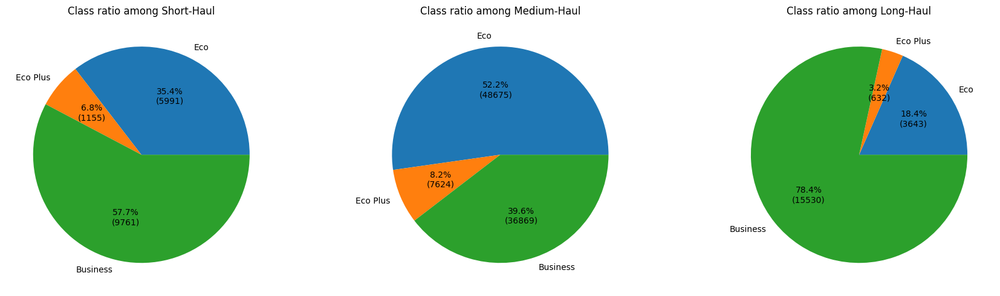

In [161]:
#######################################
#P(class | flight_distance_class)
#######################################
result=pd.crosstab(data_cat['class'],data_cat['flight_distance_class'],margins=False).reset_index()

#display(result)
col_nm=distance_type_hue_order

#######################################
#Pie Chart
#######################################
colCnt=3
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(colCnt*6,rowCnt*5))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["class"], autopct=autopct_format(result[col]))
    ax.set_title(f"Class ratio among {col}")
plt.tight_layout()
plt.show()

#=>Eco class ratio in total sample is 44.89%, in Short-Haul and Long-Haul, eco class ratio is 35.44% and 18.39%, which are less than 44.89%
#in Medium-Haul , eco class ratio is 52.24%, which is greater than 44.89%

#=>Business class ratio in total sample is 47.86%, in Short-Haul and Long-Haul, eco class ratio is 57.73% and 78.41%, which are greater than 47.86%
#in Medium-Haul , business class ratio is 39.57%, which is less than 47.86%

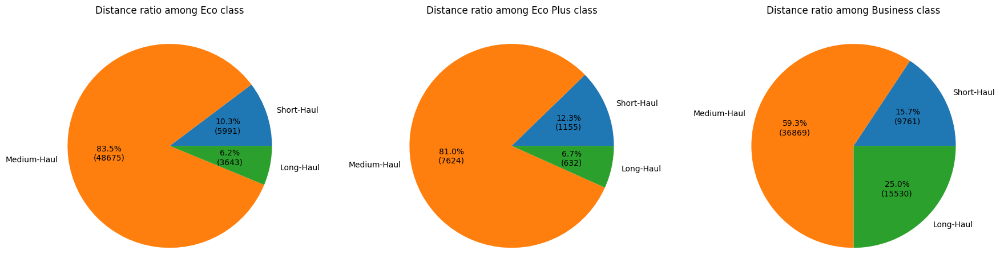

In [162]:
#######################################
#P(flight_distance_class | class)
#######################################
result=pd.crosstab(data_cat['flight_distance_class'],data_cat['class'],margins=False).reset_index()

#display(result)
col_nm=class_hue_order

#######################################
#Pie Chart
#######################################
colCnt=3
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(colCnt*6,rowCnt*5))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["flight_distance_class"], autopct=autopct_format(result[col]))
    ax.set_title(f"Distance ratio among {col} class")
plt.tight_layout()
plt.show()

#=>Short-Haul ratio of Eco and Eco Plus were 10.3% and 12.3%, which are less than total sample ratio 13%
#=>Medium-Haul ratio of Eco and Eco Plus were 83.5% and 81%, which are greater than total sample ratio 71.7%
#=>Long-Haul ratio of Eco and Eco Plus were 6.2% and 6.7%, which are less than total sample ratio 15.2%

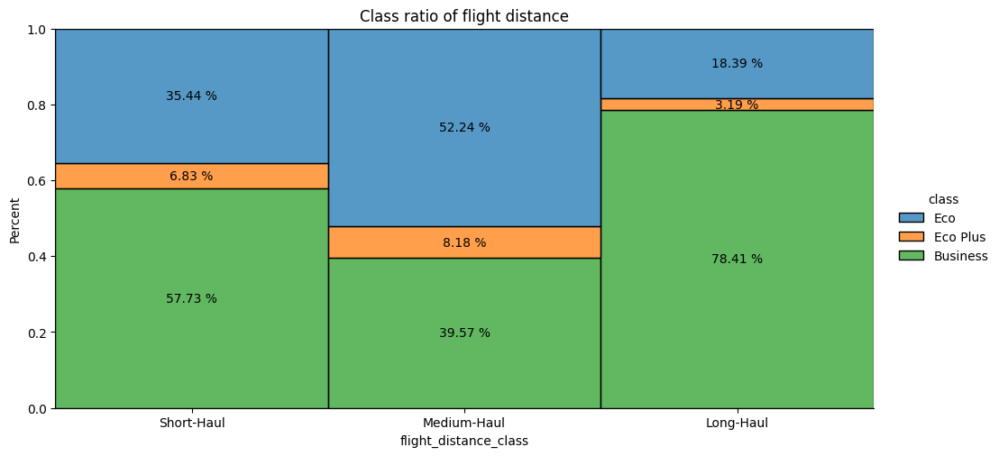

In [163]:
#################################################
#Keep flight_distance constant
#class ratio
#################################################
g=sns.displot(
    data=data_cat, hue="class", 
    x="flight_distance_class",
    facet_kws={"sharey": True,"sharex": True},
    kind="hist", height=5, aspect=2,palette='tab10',
    discrete=True,multiple='fill',stat='percent'
)

#eco_class_ratio=data_cat['class'].value_counts(normalize=True)['Eco']
#business_class_ratio=data_cat['class'].value_counts(normalize=True)['Business']
#g.refline(y=1-eco_class_ratio,color="blue",linestyle="--",label="Sample Eco Class Ratio")
#g.refline(y=business_class_ratio,color="green",linestyle="--",label="Sample Business Class Ratio")
#plt.legend(title='line',loc='upper right', bbox_to_anchor=(1.5, 0.9))

#for ax in g.axes.flat:
#    for i in ax.containers:
#        ax.bar_label(i,fmt='%.2f%%')
#        ax.set_title(var)

#show label
#https://stackoverflow.com/questions/67481922/display-percentage-labels-in-seaborn-displot
for ax in g.axes.flat:
    for p in ax.patches:
        h = p.get_height()
        # skip empty bars
        if h > 0: 
            txt = f'{h * 100:.2f} %'
            txt_x = p.get_x() + p.get_width() / 2
            txt_y = p.get_y() + h / 2
            ax.text(txt_x, txt_y, txt, ha='center', va='center')
plt.title('Class ratio of flight distance')
plt.show()

#=>Eco class ratio in total sample is 44.89%, in Short-Haul and Long-Haul, eco class ratio is 35.44% and 18.39%, which are less than 44.89%
#in Medium-Haul , eco class ratio is 52.24%, which is greater than 44.89%

#=>Business class ratio in total sample is 47.86%, in Short-Haul and Long-Haul, eco class ratio is 57.73% and 78.41%, which are greater than 47.86%
#in Medium-Haul , business class ratio is 39.57%, which is less than 47.86%

### 5-(7~20) Class VS Rating

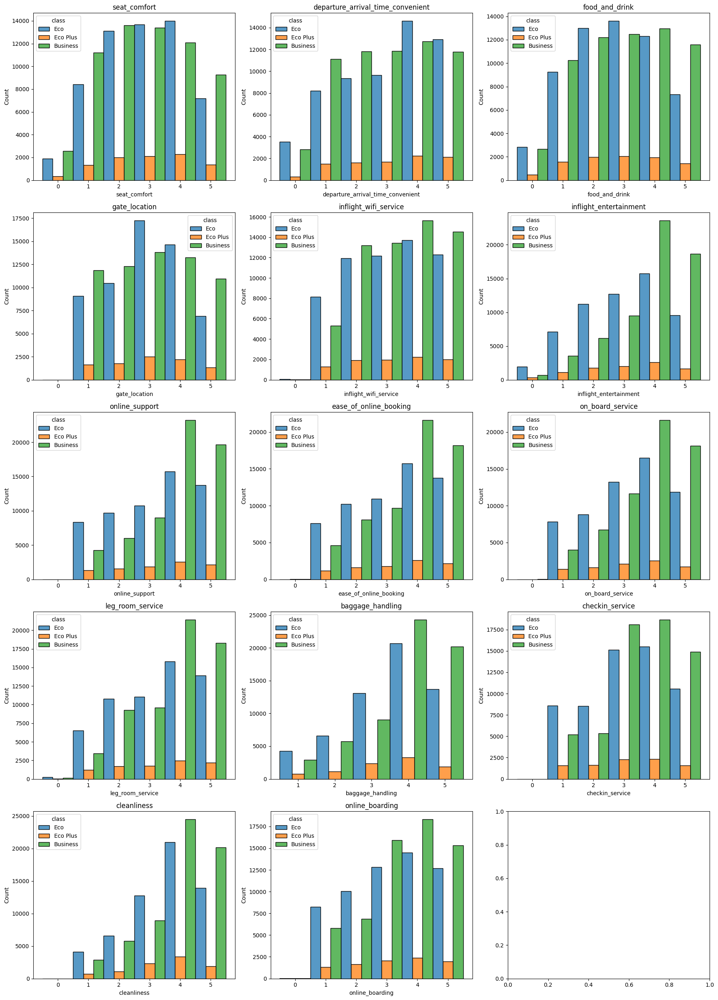

In [164]:
#################################################
#class count by rating score
#rating item
#################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
var_num=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
hue_order=class_hue_order
for var,ax in zip(var_num,axs.ravel()):
    sns.histplot(data=data_cat, x=var,ax=ax, 
             hue="class",element="bars", legend=True,
             stat="count", multiple="dodge",kde=False,hue_order=hue_order)
    ax.set_title(var)
plt.tight_layout()
plt.show()

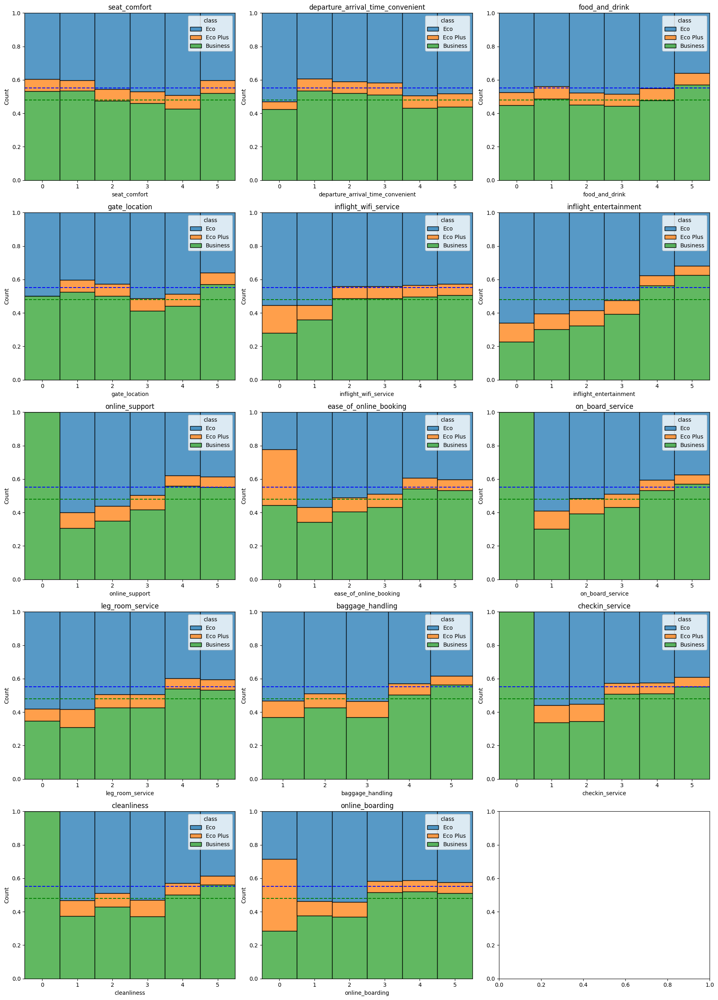

In [165]:
#################################################
#class proportion by rating score
#rating item
#################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
var_num=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
hue_order=class_hue_order
business_per=round(df_original[df_original['class']=='Business']['class'].count()/df_original.shape[0],3)
eco_per=round(df_original[df_original['class']=='Eco']['class'].count()/df_original.shape[0],3)
for var,ax in zip(var_num,axs.ravel()):
    sns.histplot(data=data_cat, x=var,hue='class', multiple="fill",ax=ax,hue_order=hue_order,legend=True,binwidth=1)
    #add a line of Business classratio
    ax.axhline(business_per,color="green",linestyle="--",label="Business ratio")
    #add a line of Eco class ratio
    ax.axhline(1-eco_per,color="blue",linestyle="--",label="Eco ratio")
    ax.set_title(var)
plt.tight_layout()
plt.show()
#=>inflight entertainment, lower score higher eco and eco plus proportion
#(lower score higher personal travel proportion)
##business travel =>people(more likely educated, adult, able to use technology system, able to read the menu(e.g. foreign language), like the contents)
##personal travel =>people(more diverse, young-senior, not every one could use technology system, some could not read the menu....)

### 5-21 Class VS Departure Delay in Minutes

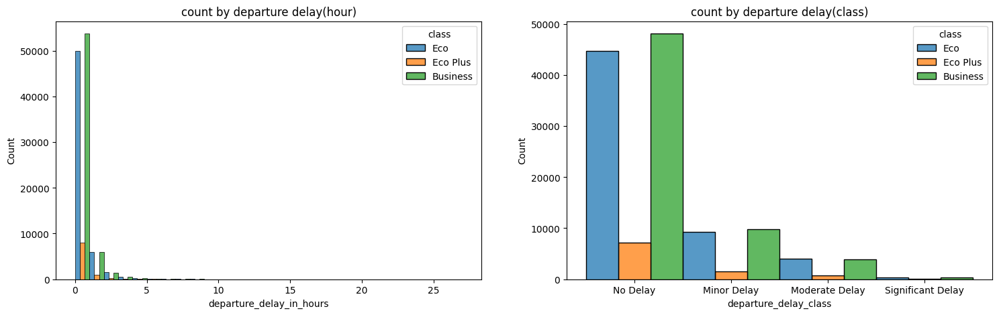

In [166]:
#################################################
#count by departure delay(class)
#################################################
fig, axs = plt.subplots(1,2,figsize=(18,5))
hue_order=class_hue_order
sns.histplot(data=data_cat, x="departure_delay_in_hours",hue='class', hue_order=hue_order,ax=axs[0],binwidth=1
             ,element="bars",stat="count", multiple="dodge")
sns.histplot(data=data_cat, x="departure_delay_class",hue='class', hue_order=hue_order,ax=axs[1],element="bars",
             stat="count", multiple="dodge")

#set title
axs[0].set_title("count by departure delay(hour)")
axs[1].set_title("count by departure delay(class)")
plt.show()

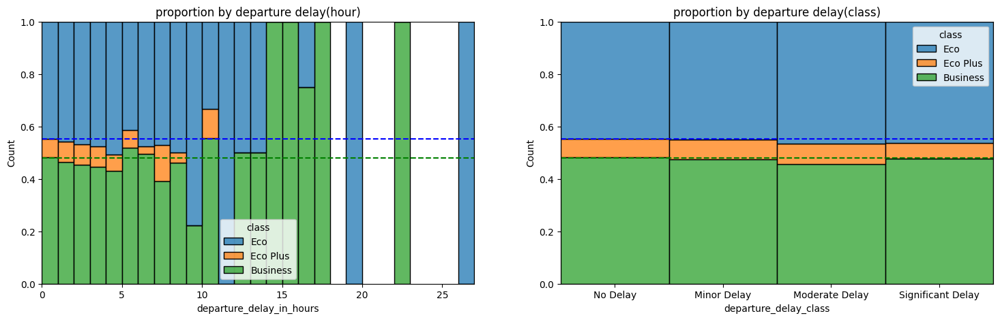

In [167]:
#################################################
#proportion by departure delay(class)
#################################################
fig, axs = plt.subplots(1,2,figsize=(18,5))
hue_order=class_hue_order
sns.histplot(data=data_cat, x="departure_delay_in_hours",hue='class', hue_order=hue_order, multiple="fill",ax=axs[0],binwidth=1)
sns.histplot(data=data_cat, x="departure_delay_class",hue='class', hue_order=hue_order, multiple="fill",ax=axs[1])

#set class ratio(total sample) line
business_per=round(df_original[df_original['class']=='Business']['class'].count()/df_original.shape[0],3)
eco_per=round(df_original[df_original['class']=='Eco']['class'].count()/df_original.shape[0],3)
axs[0].axhline(business_per,color="green",linestyle="--",label="Business class ratio")
axs[1].axhline(business_per,color="green",linestyle="--",label="Business class ratio")
axs[0].axhline(1-eco_per,color="blue",linestyle="--",label="Eco class ratio")
axs[1].axhline(1-eco_per,color="blue",linestyle="--",label="Eco class ratio")

#set title
axs[0].set_title("proportion by departure delay(hour)")
axs[1].set_title("proportion by departure delay(class)")
plt.show()


### 5-22 Class VS Arrival Delay in Minutes

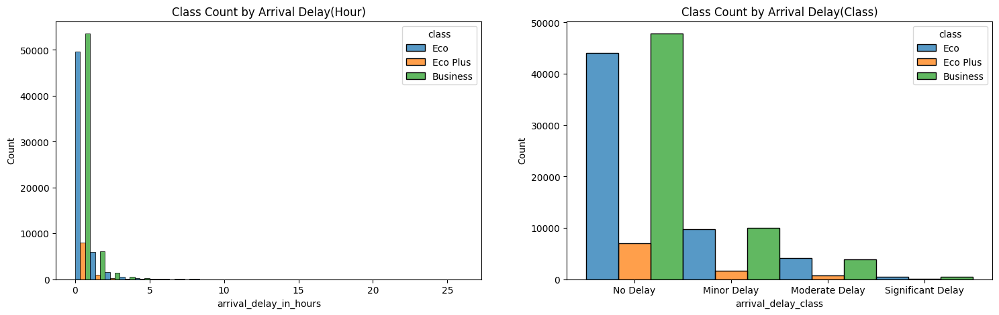

In [168]:
#################################################
#count by arrival delay(class)
#################################################
fig, axs = plt.subplots(1,2,figsize=(18,5))
hue_order=class_hue_order
sns.histplot(data=data_cat, x="arrival_delay_in_hours",hue='class', hue_order=hue_order,ax=axs[0],binwidth=1
             ,element="bars",stat="count", multiple="dodge")
sns.histplot(data=data_cat, x="arrival_delay_class",hue='class', hue_order=hue_order,ax=axs[1],element="bars",
             stat="count", multiple="dodge")

#set title
axs[0].set_title("Class Count by Arrival Delay(Hour)")
axs[1].set_title("Class Count by Arrival Delay(Class)")
plt.show()

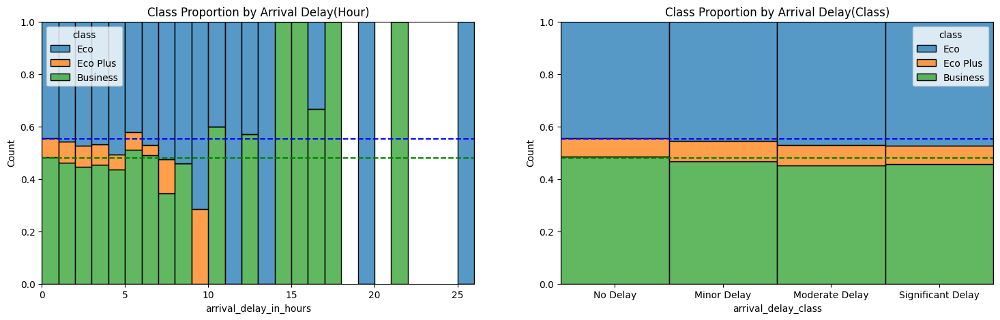

In [169]:
#################################################
#proportion by arrival delay(class)
#################################################
fig, axs = plt.subplots(1,2,figsize=(18,5))
hue_order=class_hue_order
sns.histplot(data=data_cat, x="arrival_delay_in_hours",hue='class', hue_order=hue_order, multiple="fill",ax=axs[0],binwidth=1)
sns.histplot(data=data_cat, x="arrival_delay_class",hue='class', hue_order=hue_order, multiple="fill",ax=axs[1],binwidth=1)

#set class ratio(total sample) line
business_per=round(df_original[df_original['class']=='Business']['class'].count()/df_original.shape[0],3)
eco_per=round(df_original[df_original['class']=='Eco']['class'].count()/df_original.shape[0],3)
axs[0].axhline(business_per,color="green",linestyle="--",label="Business class ratio")
axs[0].axhline(1-eco_per,color="blue",linestyle="--",label="Eco class ratio")
axs[1].axhline(business_per,color="green",linestyle="--",label="Business class ratio")
axs[1].axhline(1-eco_per,color="blue",linestyle="--",label="Eco class ratio")

#set title
axs[0].set_title("Class Proportion by Arrival Delay(Hour)")
axs[1].set_title("Class Proportion by Arrival Delay(Class)")
plt.show()
#=>

## 6 Flight Distance

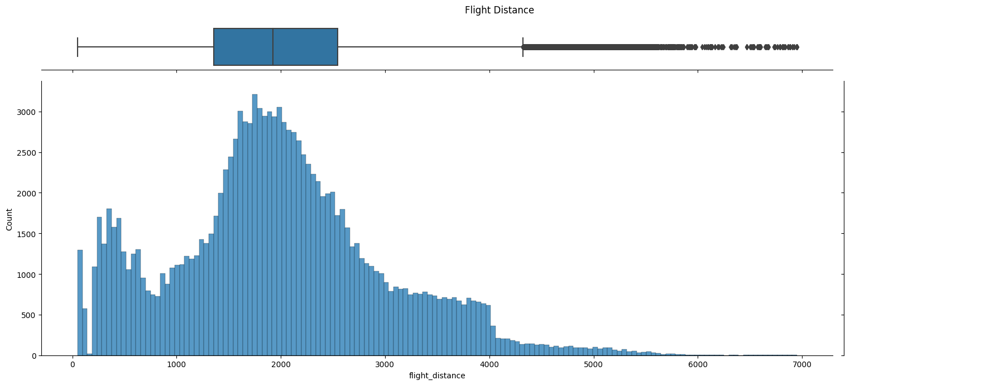

In [170]:
#################################################
#distribution and boxplot of flight_distance
#################################################
g = sns.JointGrid(data=data_cat, x="flight_distance")
g.plot(sns.histplot, sns.boxplot)
g.fig.set_size_inches((18, 7))
plt.suptitle("Flight Distance")
plt.tight_layout()
plt.show()

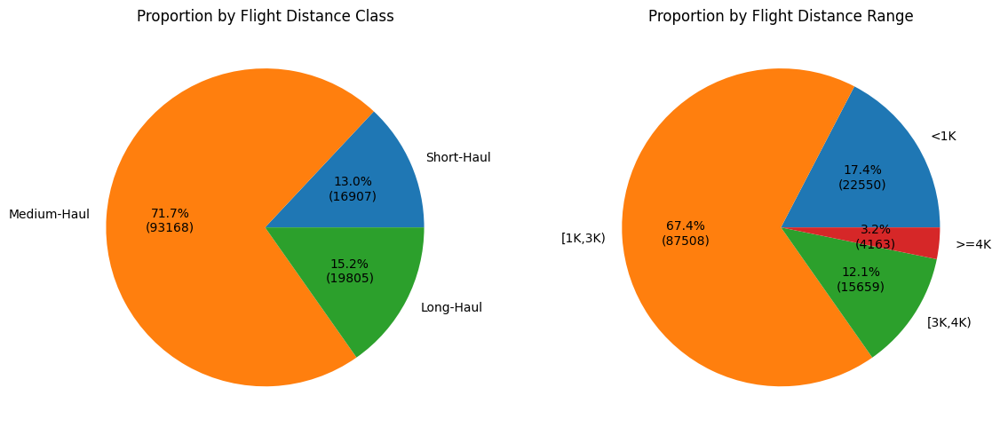

In [171]:
#######################################
#Pie Chart
#######################################
fig,axs=plt.subplots(1,2,figsize=(12,5))

#pie chart by Flight Distance type
result=data_cat.groupby(['flight_distance_class'])[['satisfaction']].count().reset_index().rename(columns={'satisfaction':'count'})
axs[0].pie(result['count'],labels = result["flight_distance_class"], autopct=autopct_format(result['count']))
axs[0].set_title("Proportion by Flight Distance Class")

#pie chart by Flight Distance class
result=data_cat.groupby(['flight_distance_range'])[['satisfaction']].count().reset_index().rename(columns={'satisfaction':'count'})
axs[1].pie(result['count'],labels = result["flight_distance_range"], autopct=autopct_format(result['count']))
axs[1].set_title("Proportion by Flight Distance Range")

plt.tight_layout()
plt.show()

### 6-(7~20) Flight Distance VS Rating

In [172]:
var_num=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
for var in var_num:
    display(data_cat.groupby([var])['flight_distance'].agg(['mean','median']).reset_index())

,seat_comfort,mean,median
0,0,1870.372108,1881.0
1,1,2045.958423,1979.0
2,2,2033.176774,1955.0
3,3,2030.862660,1956.0
4,4,1903.488168,1866.0
5,5,1895.186627,1850.0


,departure_arrival_time_convenient,mean,median
0,0,1837.598139,1786.5
1,1,1996.167755,1941.5
2,2,2013.275160,1960.0
3,3,2004.613613,1948.0
4,4,1982.493360,1930.0
5,5,1957.340120,1905.0


,food_and_drink,mean,median
0,0,1826.533053,1798.0
1,1,2005.961378,1951.0
2,2,2020.397922,1956.0
3,3,2003.039254,1945.0
4,4,1945.999192,1895.0
5,5,1966.650415,1895.0


,gate_location,mean,median
0,0,2015.500000,2015.5
1,1,1979.912165,1924.0
2,2,1985.440289,1920.0
3,3,1986.617361,1938.0
4,4,1978.367622,1924.0
5,5,1973.667502,1899.0


,inflight_wifi_service,mean,median
0,0,2716.113636,2403.5
1,1,1963.640609,1925.0
2,2,1956.390793,1917.0
3,3,1964.331172,1913.0
4,4,2025.186217,1943.5
5,5,1979.008984,1918.0


,inflight_entertainment,mean,median
0,0,1894.932505,1819.0
1,1,2032.264629,1978.0
2,2,2061.966116,1978.0
3,3,1989.574711,1934.0
4,4,1952.751952,1894.0
5,5,1951.714089,1893.0


,online_support,mean,median
0,0,1940.000000,1940.0
1,1,2022.054244,1961.0
2,2,2065.606315,1978.0
3,3,1978.821972,1925.0
4,4,1958.946423,1902.0
5,5,1952.408486,1896.0


,ease_of_online_booking,mean,median
0,0,2954.333333,2509.5
1,1,2015.048824,1956.0
2,2,1994.622325,1930.0
3,3,2016.365242,1940.0
4,4,1972.141859,1919.0
5,5,1947.814541,1898.0


,on_board_service,mean,median
0,0,4111.000000,4785.0
1,1,2029.501998,1933.0
2,2,1988.581227,1919.0
3,3,2047.702741,1959.0
4,4,1955.850522,1915.0
5,5,1933.351910,1897.0


,leg_room_service,mean,median
0,0,1076.858108,794.5
1,1,2036.358047,1943.0
2,2,2035.269073,1949.0
3,3,2058.582454,1971.0
4,4,1926.092398,1891.0
5,5,1954.663487,1911.0


,baggage_handling,mean,median
0,1,1864.923636,1813.0
1,2,1902.696694,1857.5
2,3,2036.079273,1956.0
3,4,2005.469859,1947.0
4,5,1967.056982,1920.0


,checkin_service,mean,median
0,0,1940.000000,1940.0
1,1,1982.577201,1925.0
2,2,1976.878083,1906.0
3,3,1972.865187,1925.0
4,4,1990.542831,1931.0
5,5,1982.248806,1926.0


,cleanliness,mean,median
0,0,4111.000000,4785.0
1,1,1942.471550,1879.0
2,2,1900.794438,1846.0
3,3,2027.205804,1941.0
4,4,1996.867261,1942.0
5,5,1968.054266,1927.0


,online_boarding,mean,median
0,0,2468.785714,2350.5
1,1,1955.789635,1923.0
2,2,2023.690572,1960.0
3,3,1929.124496,1884.0
4,4,2002.408630,1932.0
5,5,1997.153338,1929.0


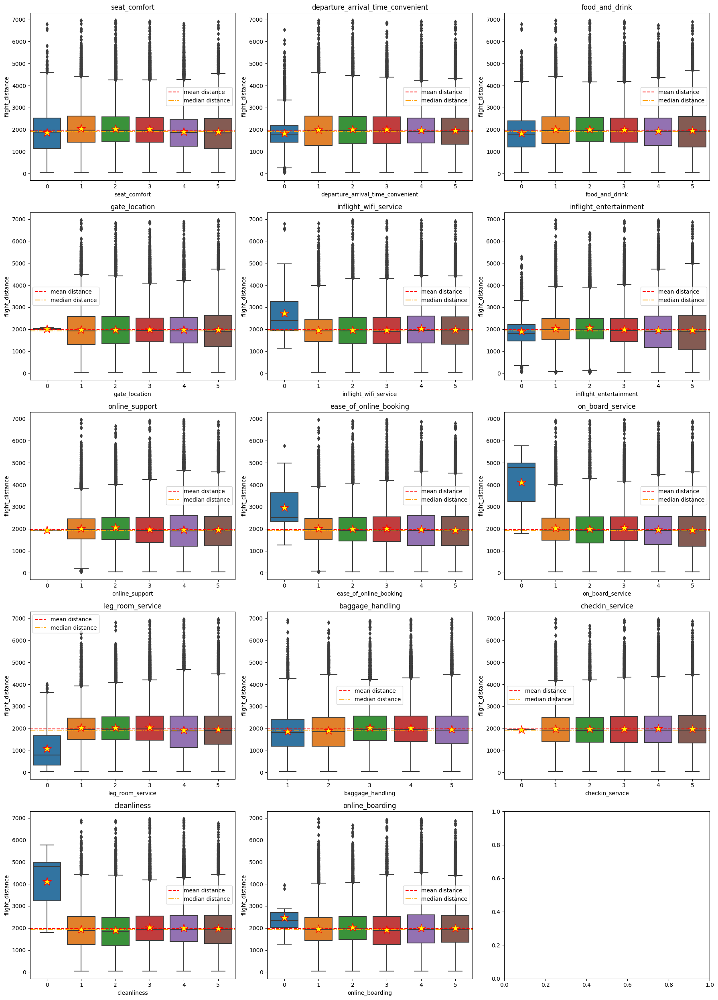

In [173]:
#############################################
#Box plot of flight_distance by different rating items
#############################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
mean_distance=df_original["flight_distance"].mean()
median_distance=df_original["flight_distance"].median()

for var,ax in zip(rating_list,axs.ravel()):
    target_data=data_cat
    sns.boxplot(data=target_data, y="flight_distance",ax=ax,x=var,
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})
    ax.axhline(mean_distance, color='red',linestyle='--',label="mean distance")
    ax.axhline(median_distance, color='orange',linestyle='-.',label="median distance")
    ax.legend()
    ax.set_title(var)
plt.tight_layout()
plt.show()
#The bellow items shorter distance tend to give 0 point () means the difference is not quite big
#=>('departure_arrival_time_convenient'),('food_and_drink'), ('inflight_entertainment'), 'leg_room_service', ('baggage_handling')

#The bellow items longer distance tend to give 0 point () means the difference is not quite big
#=>'inflight_wifi_service', 'ease_of_online_booking', 'on_board_service', 'Cleanliness', 'online_boarding'

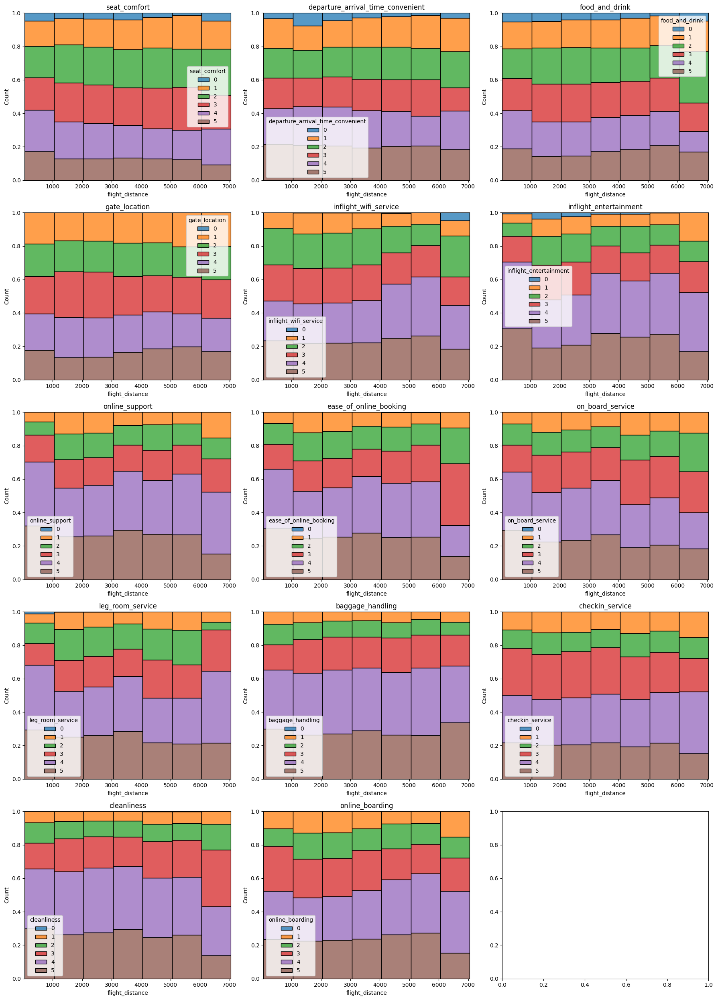

In [174]:
###############################################################
#hist plot of flight_distance by different rating items
###############################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
hue_order=rating_hue_order
for var,ax in zip(rating_list,axs.ravel()):
    target_data=data_cat
    sns.histplot(data=target_data, x="flight_distance",hue=var, multiple="fill"
                 ,ax=ax,legend=True,binwidth=1000,hue_order=hue_order)
    ax.set_title(var)
plt.tight_layout()
plt.show()

#Inflight entertainment
#=>rating4,5:
#=>0-700 or 800: relative high
#=>700 or 800 - 2000: decrease, relative low
#=>2000 - 4000: increase, relative high
#=>4000 above: decrease slowly

#==>flight distance might associated with rating


# food_and_drink, inflight_wifi_service, inflight_entertainment, online_support, ease_of_online_booking, 
# cleanliness and online_boarding suddenly decreased at distance 6k-7k 
# 6k-7k(maybe miles) These routes may trans-Pacific or trans-Atlantic flights connecting major hubs(We do not known what kind of flights they are, e.g. non-stop, one stop, etc).
# aircraft type, foreign language support, clean frequency during trip, entertainment contents(more diverse customers) may associated with these items

### 6-(7~20) Flight Distance VS Rating item class

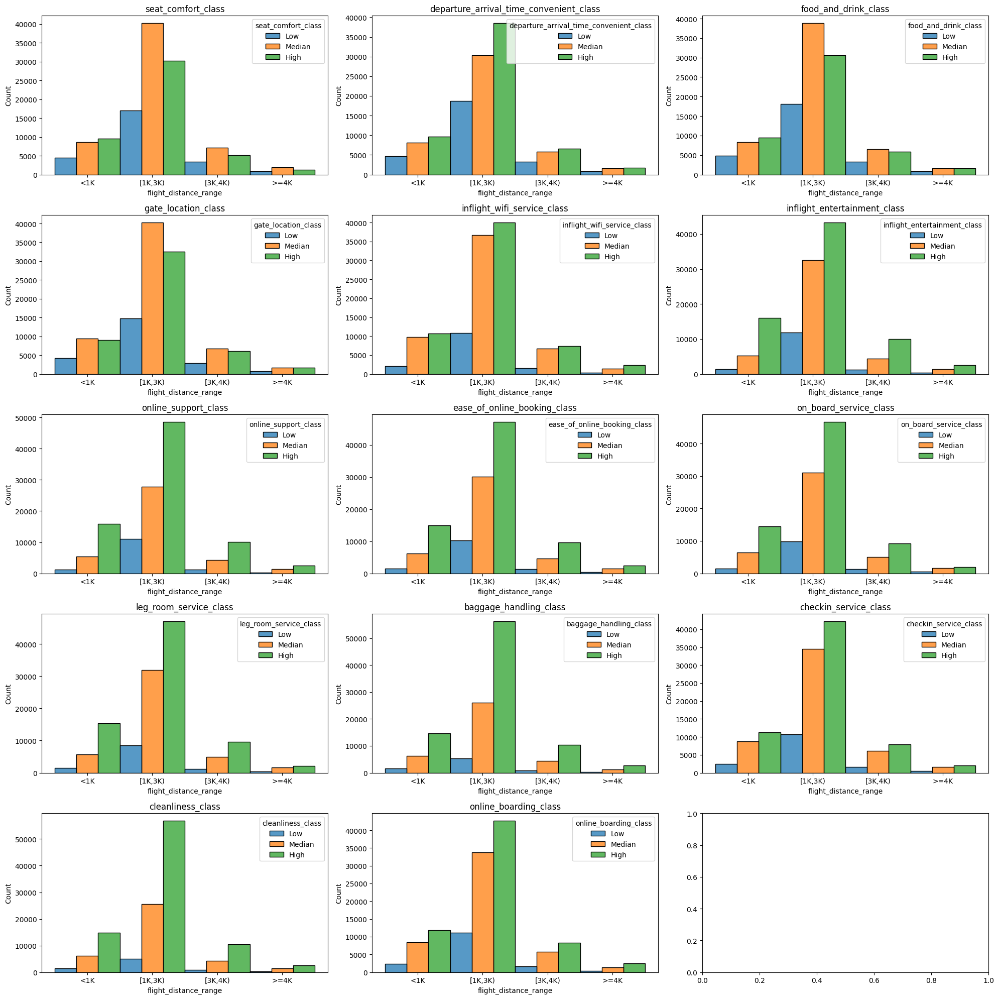

In [175]:
###############################################
#histplot
#Check survey variable
#By flight_distance_range
###############################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(20,20))
hue_order=rating_class_hue_order

rating_list=['seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']
for var,ax in zip(rating_list,axs.ravel()):
    sns.histplot(data=data_cat, x="flight_distance_range",ax=ax,stat='count',
                 hue=var, multiple="dodge",discrete=True,
                 hue_order=hue_order, palette="tab10")
    ax.set_title(var)
plt.tight_layout()
plt.show()

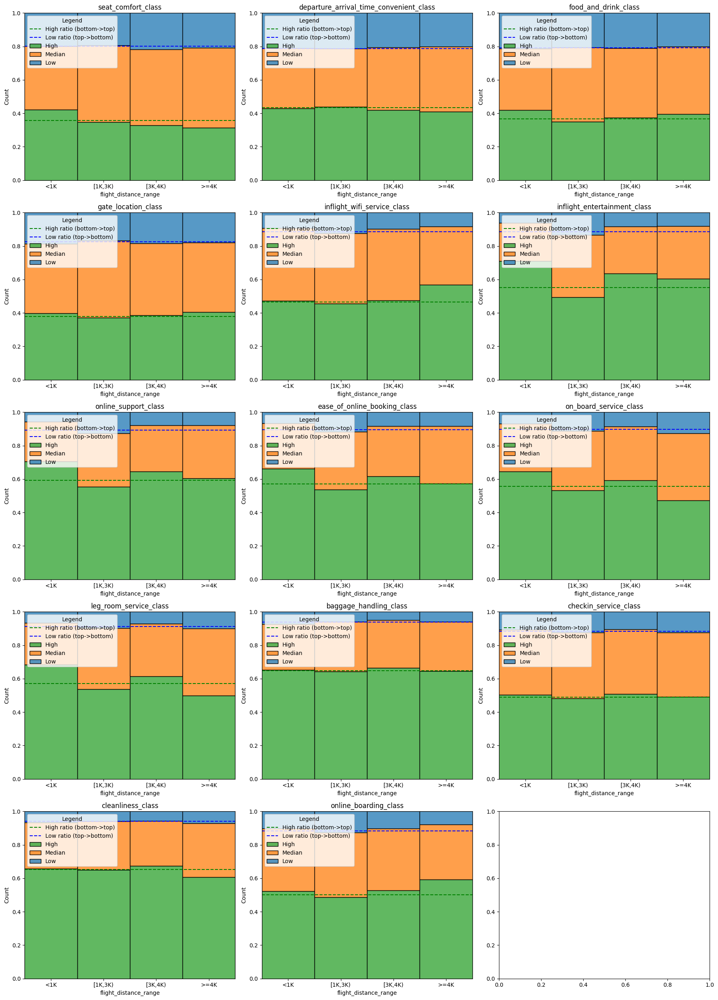

In [176]:
#############################################################
#Check survey variable
#By flight_distance_range
#Score proportion of flight_distance_range by different rating items
#############################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
hue_order=rating_class_hue_order

rating_list=['seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']
for var,ax in zip(rating_list,axs.ravel()):
    low_ratio,high_ratio=cal_rating_class_ratio(var,data_cat)
    
    sns.histplot(data=data_cat, x="flight_distance_range",ax=ax
                 ,hue=var, multiple="fill",discrete=True,hue_order=hue_order, palette="tab10")
    
    #draw line
    ax.axhline(high_ratio,color="green",linestyle="--",label="High ratio (bottom->top)")
    ax.axhline(1-low_ratio,color="blue",linestyle="--",label="Low ratio (top->bottom)")
    #edit legend
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    
    ax.set_title(var)
plt.tight_layout()
plt.show()

#=>About Inflight_entertainment, rating 'Low' ratio in [1K,3K) was higher than others

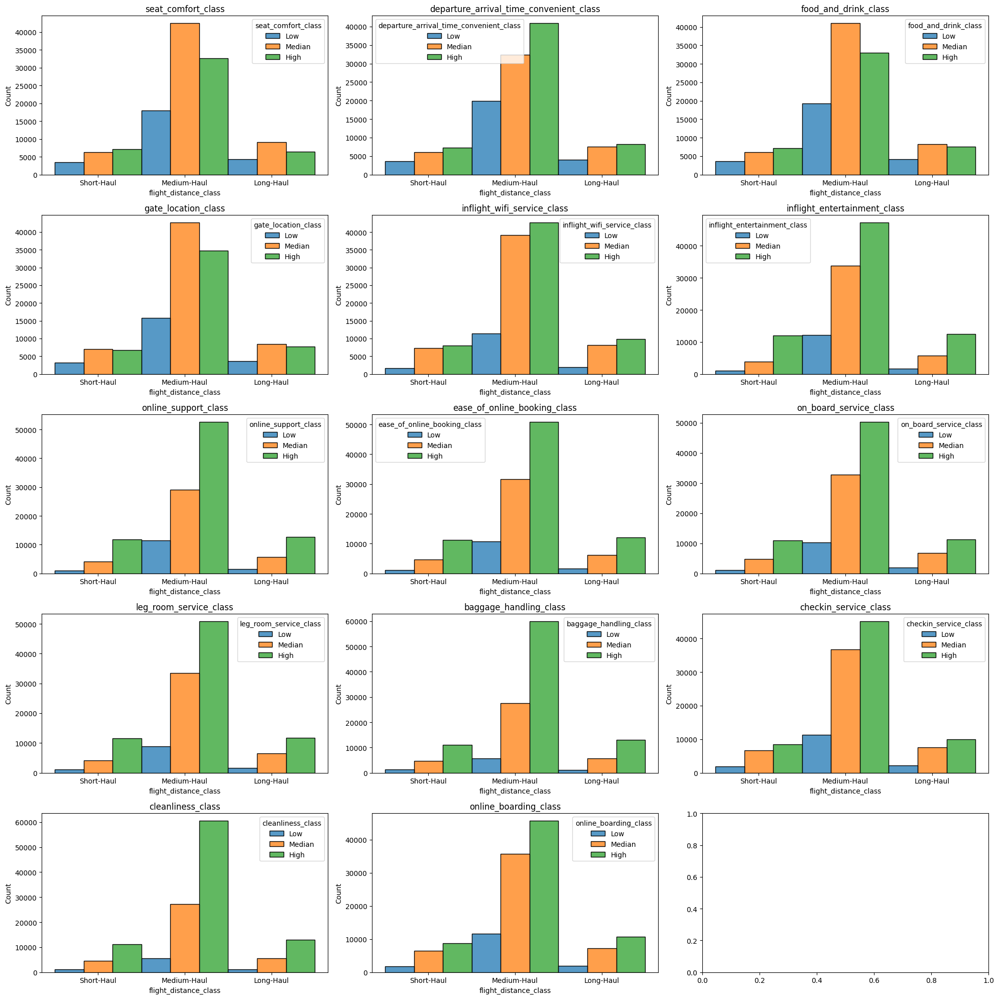

In [177]:
###############################################
#histplot
#Check survey variable
#By flight_distance_class
###############################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(20,20))
hue_order=rating_class_hue_order

rating_list=['seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']
for var,ax in zip(rating_list,axs.ravel()):
    sns.histplot(data=data_cat, x="flight_distance_class",ax=ax,stat='count',
                 hue=var, multiple="dodge",discrete=True,
                 hue_order=hue_order, palette="tab10")
    ax.set_title(var)
plt.tight_layout()
plt.show()

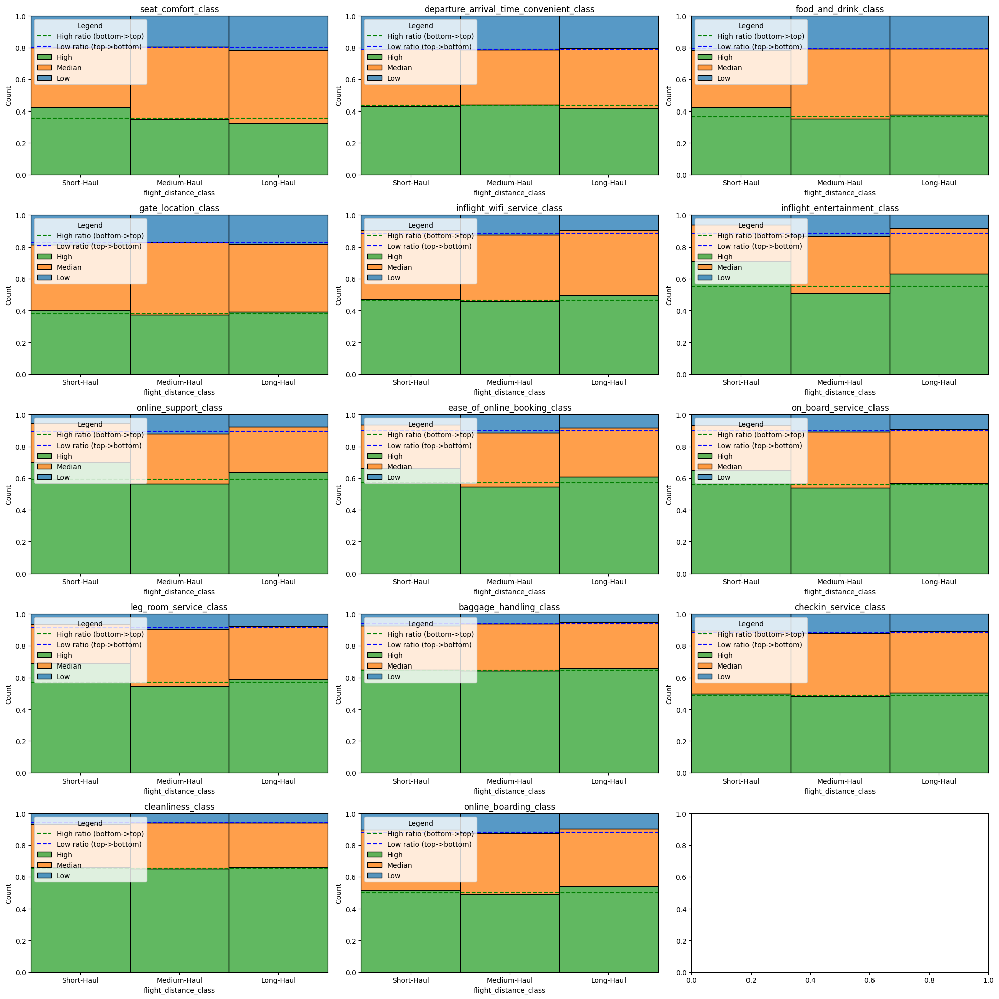

In [178]:
#############################################################
#Check survey variable
#By flight_distance_class
#Score proportion of flight_distance_class by different rating items
#############################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(20,20))
hue_order=rating_class_hue_order

rating_list=['seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']
for var,ax in zip(rating_list,axs.ravel()):
    low_ratio,high_ratio=cal_rating_class_ratio(var,data_cat)
    
    sns.histplot(data=data_cat, x="flight_distance_class",ax=ax
                 ,hue=var, multiple="fill",discrete=True,hue_order=hue_order, palette="tab10")
    
    #draw line
    ax.axhline(high_ratio,color="green",linestyle="--",label="High ratio (bottom->top)")
    ax.axhline(1-low_ratio,color="blue",linestyle="--",label="Low ratio (top->bottom)")
    #edit legend
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    
    ax.set_title(var)
plt.tight_layout()
plt.show()

#=>About Inflight_entertainment, rating 'Low' ratio in Median-Haul was higher than others

### 6-21  Flight Distance VS Departure Delay in Minutes

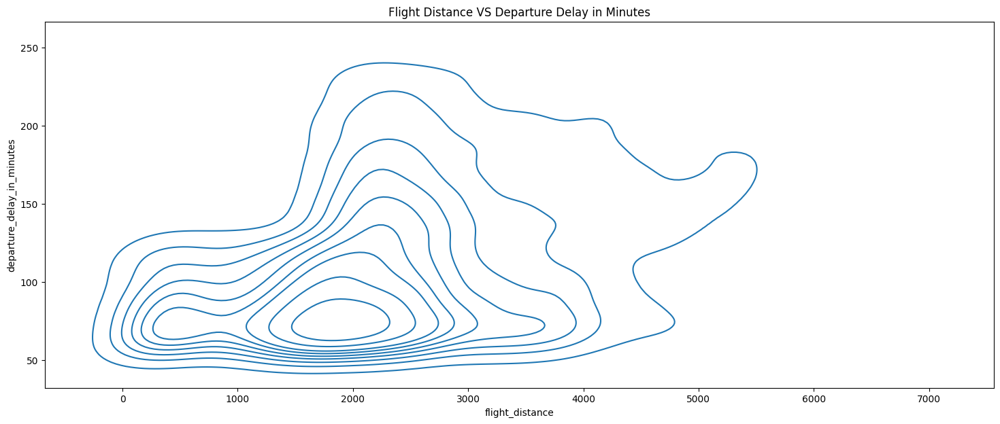

In [179]:
#############################################################
#Flight Distance VS Departure Delay in Minutes
#############################################################
plt.figure(figsize=(18,7))
hue_order=satisfaction_hue_order
sns.kdeplot(data=data, x="flight_distance", y="departure_delay_in_minutes", 
                  #hue="satisfaction", hue_order=hue_order
           )
plt.title("Flight Distance VS Departure Delay in Minutes")
plt.show()

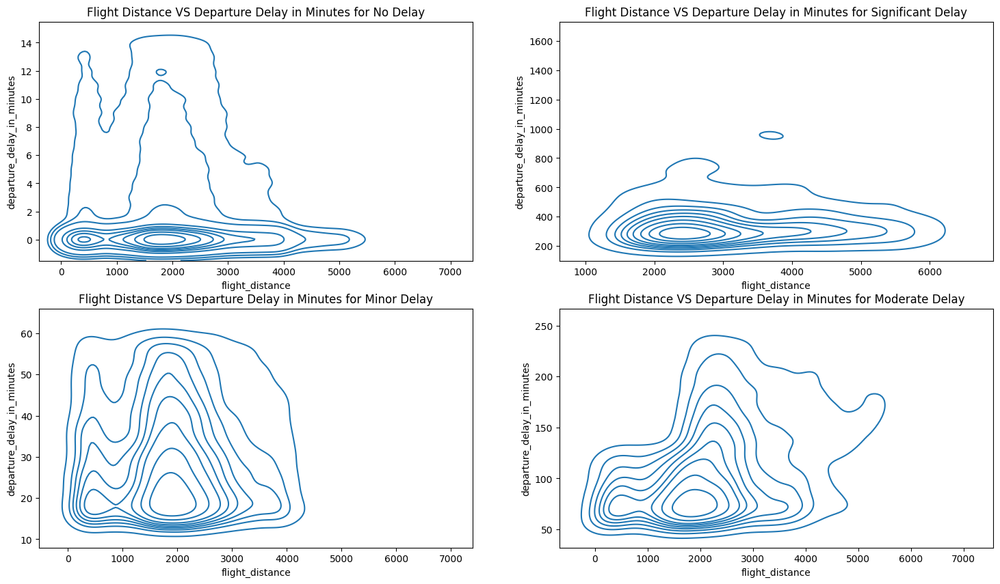

In [180]:
#############################################################
#Flight Distance VS Departure Delay in Minutes
#Keep delay type constant
#############################################################
fig,axs=plt.subplots(2,2,figsize=(18,10))
hue_order=satisfaction_hue_order
target_data=data_cat
delay_class=target_data["departure_delay_class"].unique().to_list()
for delaytype, ax in zip(delay_class,axs.ravel()):
    data=target_data[target_data["departure_delay_class"]==delaytype]
    sns.kdeplot(data=data, x="flight_distance", y="departure_delay_in_minutes", ax=ax,
                  #hue="satisfaction", hue_order=hue_order
               )
    ax.set_title(f"Flight Distance VS Departure Delay in Minutes for {delaytype}")
plt.show()

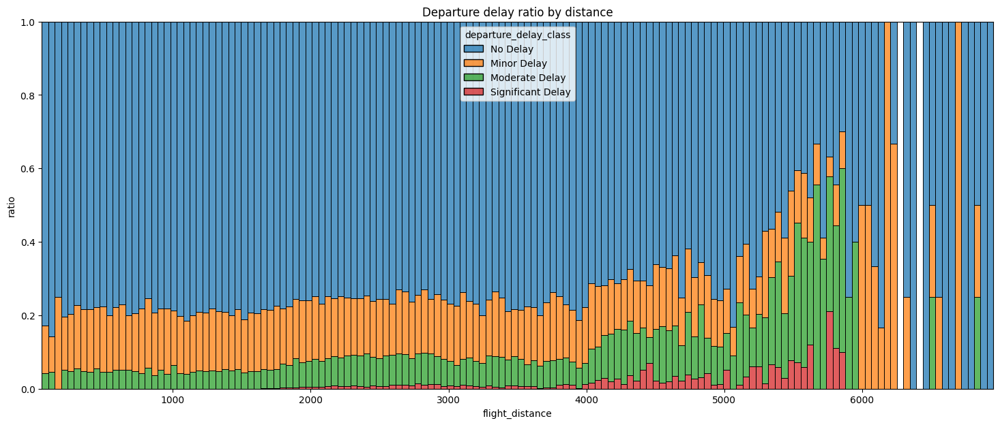

In [181]:
plt.figure(figsize=(18,7))
hue_order=delay_class_hue_order
sns.histplot(data=data_cat,hue="departure_delay_class",x="flight_distance", multiple="fill",hue_order=hue_order)
plt.ylabel("ratio")
plt.title("Departure delay ratio by distance")
plt.show()

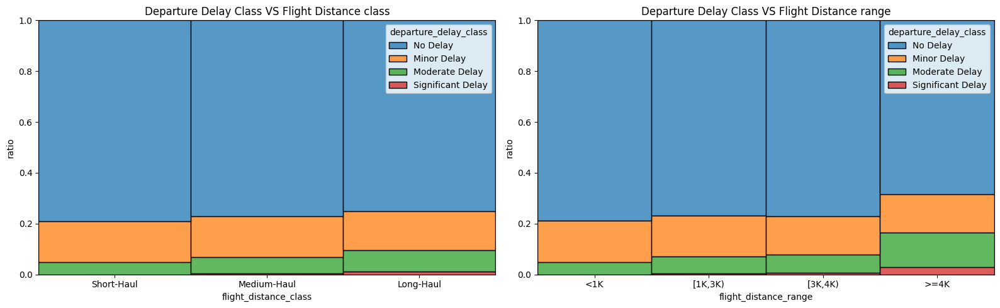

In [182]:
###########################################################
#Delay ratio by distance
###########################################################
fig,axs=plt.subplots(1,2,figsize=(16,5))

#heatmap departure_delay_class VS flight_distance_class
sns.histplot(data=data_cat,hue="departure_delay_class",x="flight_distance_class"
             , multiple="fill",discrete=True,ax=axs[0])
axs[0].set_ylabel("ratio")
axs[0].set_title("Departure Delay Class VS Flight Distance class")

#pie chart by Flight Distance class
sns.histplot(data=data_cat,hue="departure_delay_class",x="flight_distance_range"
             , multiple="fill",discrete=True,ax=axs[1])
axs[1].set_ylabel("ratio")
axs[1].set_title("Departure Delay Class VS Flight Distance range")

plt.tight_layout()
plt.show()
#=>When distance get longer, no delay proportion tends to decrease

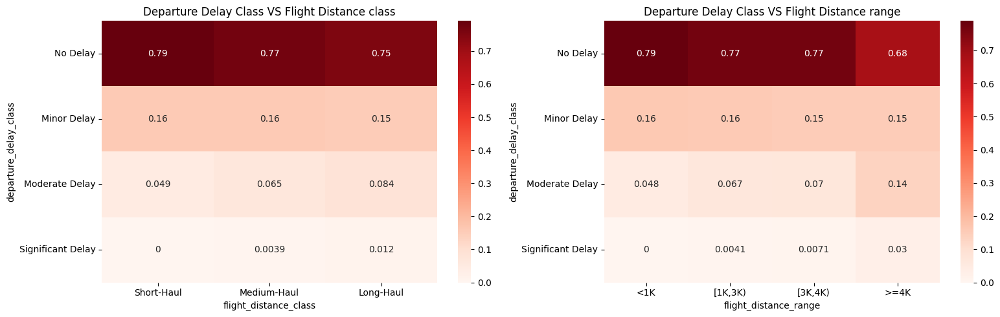

In [183]:
###########################################################
#Heatmap
###########################################################
fig,axs=plt.subplots(1,2,figsize=(16,5))

#heatmap departure_delay_class VS flight_distance_class
result=pd.crosstab(data_cat["departure_delay_class"],data_cat["flight_distance_class"],normalize='columns')
sns.heatmap(result, cmap="Reds",ax=axs[0],annot=True)
axs[0].set_title("Departure Delay Class VS Flight Distance class")

#pie chart by Flight Distance class
result=pd.crosstab(data_cat["departure_delay_class"],data_cat["flight_distance_range"],normalize='columns')
sns.heatmap(result, cmap="Reds",ax=axs[1],annot=True)
axs[1].set_title("Departure Delay Class VS Flight Distance range")

plt.tight_layout()
plt.show()


In [184]:
data_cat.groupby(['flight_distance_class'])['departure_delay_in_minutes'].describe()

,count,mean,std,min,25%,50%,75%,max
flight_distance_class,,,,,,,,
Short-Haul,16907.0,10.215059,20.861633,0.0,0.0,0.0,10.0,128.0
Medium-Haul,93168.0,14.310815,35.688607,0.0,0.0,0.0,12.0,921.0
Long-Haul,19805.0,20.449432,55.598011,0.0,0.0,0.0,14.0,1592.0


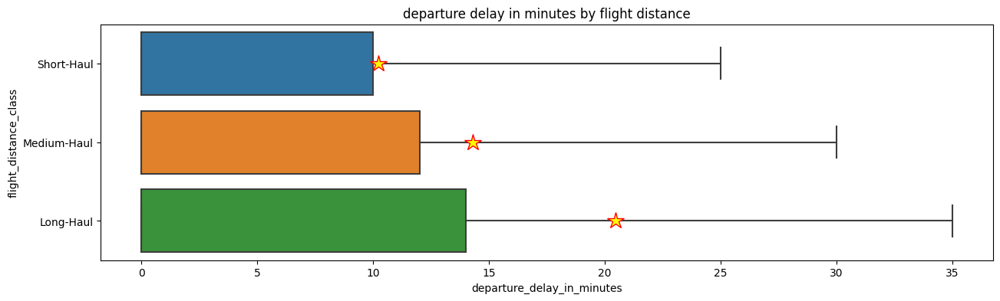

In [185]:
###########################################################
#Boxplot
#departure_delay_in_minutes by flight_distance_class
###########################################################
sns.boxplot(data=data_cat,y="flight_distance_class",x="departure_delay_in_minutes",
            showfliers=False,
            showmeans=True,
            meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})
plt.title('departure delay in minutes by flight distance')
plt.show()

In [186]:
#set significance_level 0.01
significance_level=0.01

##########################################################################################
#Kruskal-Wallis Test
#https://library.virginia.edu/data/articles/getting-started-with-the-kruskal-wallis-test
##########################################################################################
#H0:The samples are drawn from populations with the same distribution and have the same median
#HA:At least one group drawn from a different distribution and has a different median

##########################################################################################
#Mann-Whitney U Test
#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.mannwhitneyu.html
##########################################################################################
#Test 0
#H0: Average departure_delay_in_minutes of Long-Haul is less or equal to Medium-Haul
#HA: Average departure_delay_in_minutes of Long-Haul is greater than Medium-Haul

#Test 1
#H0: Average departure_delay_in_minutes of Long-Haul is less or equal to Short-Haul
#HA: Average departure_delay_in_minutes of Long-Haul is greater than Short-Haul

#Test 2
#H0: Average departure_delay_in_minutes of Medium-Haul is less or equal to Short-Haul
#HA: Average departure_delay_in_minutes of Medium-Haul is greater than Short-Haul

group_order=distance_type_hue_order
print(group_order)
kruskal_result, pairwise_results_df=test_multiple_non_parametric_ordered_means(data=data_cat, val_col='departure_delay_in_minutes', group_col='flight_distance_class', groups_order=group_order, alpha=significance_level, p_adjust='holm')


['Short-Haul', 'Medium-Haul', 'Long-Haul']
Kruskal-Wallis Test: Statistic = 163.028, p-value = 0.000

Kruskal-Wallis test is significant at significance level 0.01. Performing pairwise Mann-Whitney U tests

Pairwise Mann-Whitney U Tests (One-tailed based on order, with holm correction):


,comparison,p_value_uncorrected,p_value_corrected,reject_null
0,Long-Haul vs Medium-Haul,5.048699e-17,1.009740e-16,True
1,Long-Haul vs Short-Haul,2.606338e-37,7.819013e-37,True
2,Medium-Haul vs Short-Haul,9.476571e-17,1.009740e-16,True


In [187]:
data_cat.groupby(['flight_distance_range'])['departure_delay_in_minutes'].describe()

,count,mean,std,min,25%,50%,75%,max
flight_distance_range,,,,,,,,
<1K,22550.0,10.250554,20.790942,0.0,0.0,0.0,11.0,128.0
"[1K,3K)",87508.0,14.567011,36.436539,0.0,0.0,0.0,12.0,921.0
"[3K,4K)",15659.0,16.476659,46.908462,0.0,0.0,0.0,12.0,1592.0
>=4K,4163.0,35.342061,78.426989,0.0,0.0,1.0,26.0,1305.0


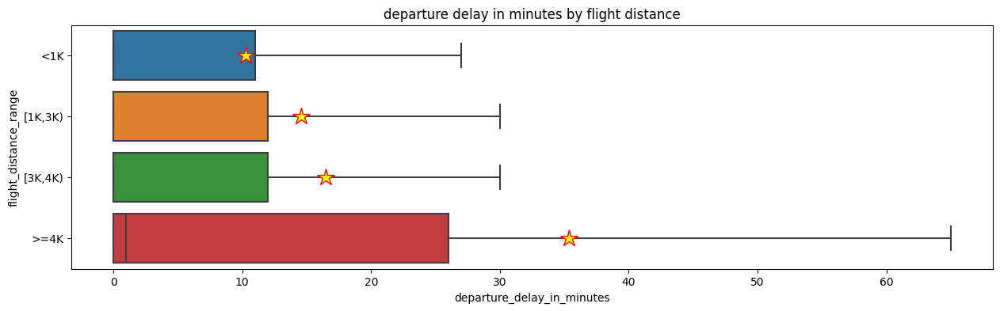

In [188]:
###########################################################
#Boxplot
#departure_delay_in_minutes by flight_distance_range
###########################################################
sns.boxplot(data=data_cat,y="flight_distance_range",x="departure_delay_in_minutes",
            showfliers=False,
            showmeans=True,
            meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"}
           )
plt.title('departure delay in minutes by flight distance')
plt.show()

### 6-22  Flight Distance VS Arrival Delay in Minutes

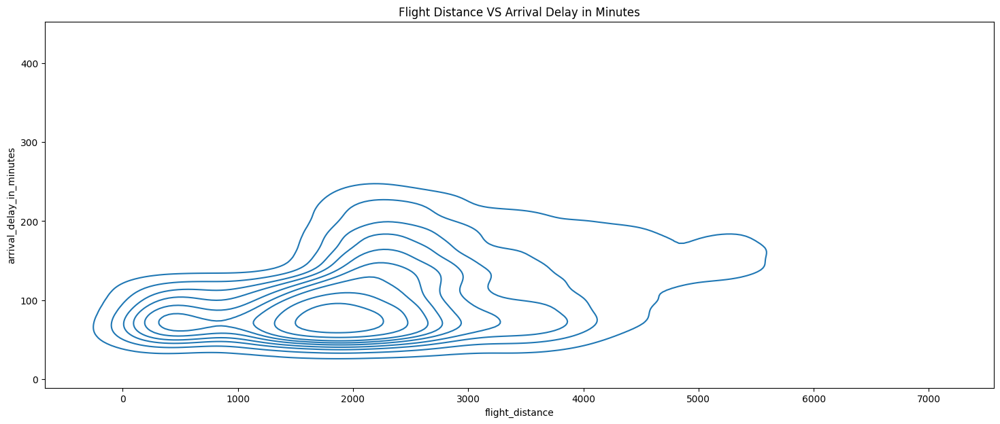

In [189]:
#############################################################
#Flight Distance VS Arrival Delay in Minutes
#############################################################
plt.figure(figsize=(18,7))
hue_order=satisfaction_hue_order
sns.kdeplot(data=data, x="flight_distance", y="arrival_delay_in_minutes", 
                  #hue="satisfaction", hue_order=hue_order
           )
plt.title("Flight Distance VS Arrival Delay in Minutes")
plt.show()

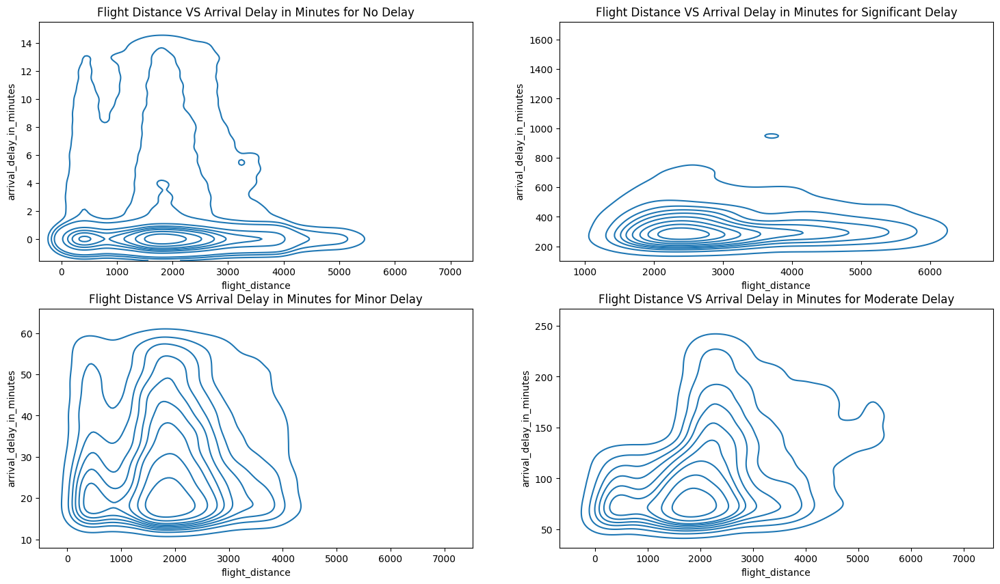

In [190]:
#############################################################
#Flight Distance VS Arrival Delay in Minutes
#Keep delay type constant
#############################################################
fig,axs=plt.subplots(2,2,figsize=(18,10))
hue_order=satisfaction_hue_order
target_data=data_cat
delay_class=target_data["arrival_delay_class"].unique().to_list()
for delaytype, ax in zip(delay_class,axs.ravel()):
    data=target_data[target_data["arrival_delay_class"]==delaytype]
    sns.kdeplot(data=data, x="flight_distance", y="arrival_delay_in_minutes", ax=ax,
                  #hue="satisfaction", hue_order=hue_order
               )
    ax.set_title(f"Flight Distance VS Arrival Delay in Minutes for {delaytype}")
plt.show()

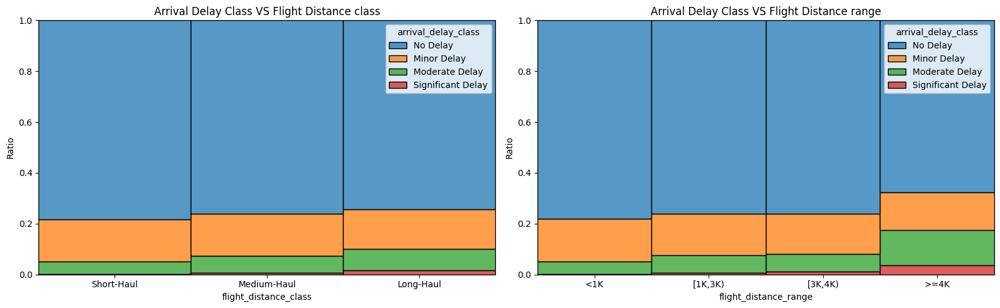

In [191]:
###########################################################
#Delay ratio by distance range
###########################################################
fig,axs=plt.subplots(1,2,figsize=(16,5))

hue_order=delay_class_hue_order

sns.histplot(data=data_cat,hue="arrival_delay_class",x="flight_distance_class"
             , multiple="fill",discrete=True,ax=axs[0],hue_order=hue_order)
axs[0].set_ylabel("Ratio")
axs[0].set_title("Arrival Delay Class VS Flight Distance class")

#pie chart by Flight Distance class
sns.histplot(data=data_cat,hue="arrival_delay_class",x="flight_distance_range"
             , multiple="fill",discrete=True,ax=axs[1],hue_order=hue_order)
axs[1].set_ylabel("Ratio")
axs[1].set_title("Arrival Delay Class VS Flight Distance range")

plt.tight_layout()
plt.show()

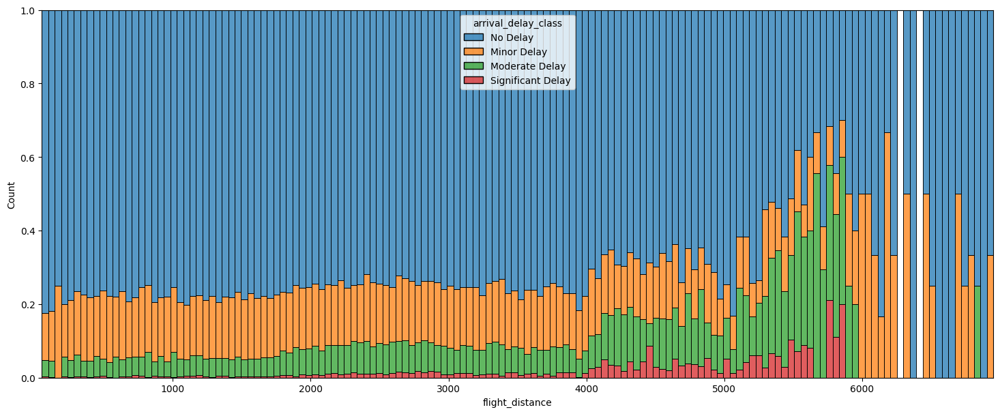

In [192]:
###########################################################
#Delay ratio by distance
###########################################################
plt.figure(figsize=(18,7))
hue_order=delay_class_hue_order
sns.histplot(data=data_cat,hue="arrival_delay_class",x="flight_distance", multiple="fill",hue_order=hue_order)
plt.show()

### 6-23  Keep Class and Travel Type constant

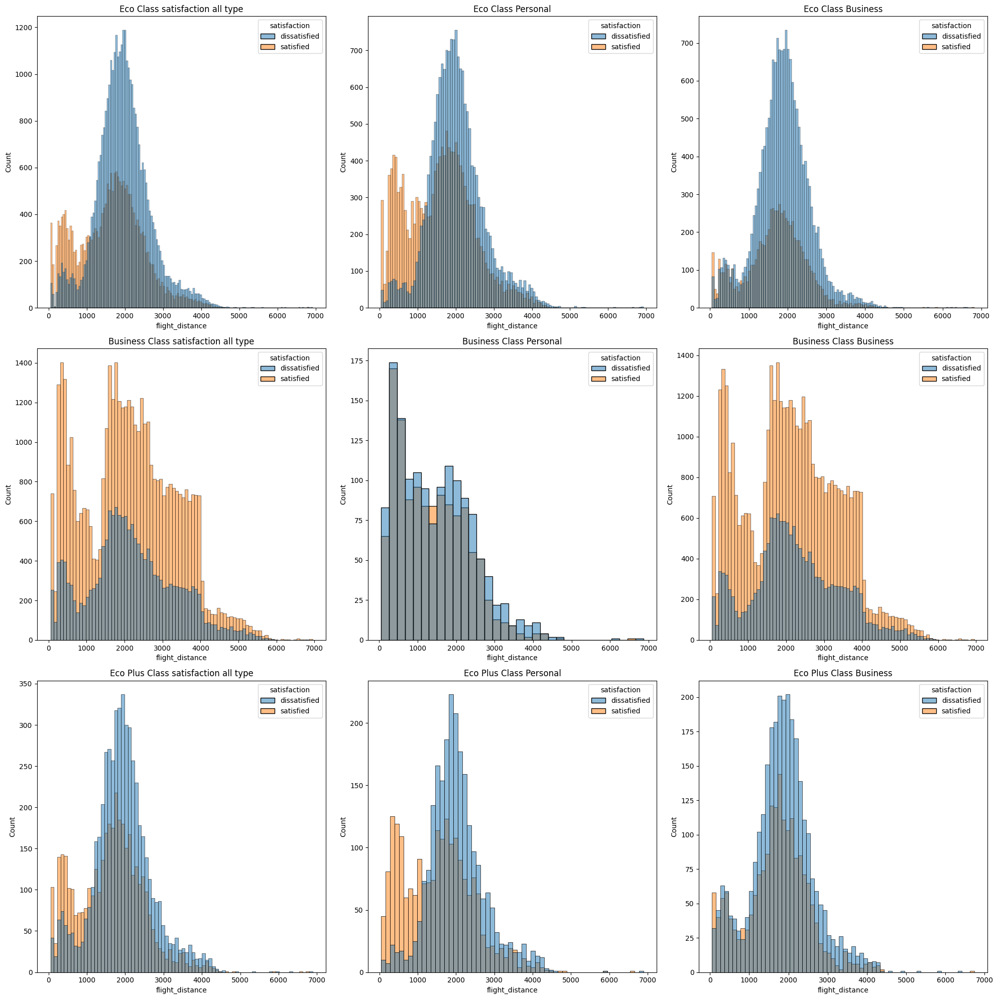

In [193]:
#####################################################################################
#Keep Class and Travel Type constant, satisfaction by different Class and travel type
#####################################################################################
fig,axs=plt.subplots(3,3,sharey=False,sharex=False,figsize=(20,20))
class_item=data_cat["class"].unique()
hue_order=satisfaction_hue_order
for i, class_type in zip(range(len(class_item)), class_item):
    mask=data_cat["class"]==class_type
    mask_personal=data_cat[mask]['type_of_travel']=='Personal Travel'
    mask_business=data_cat[mask]['type_of_travel']=='Business Travel'
    target_data=data_cat[mask]
    sns.histplot(data=target_data, x="flight_distance",ax=axs[i][0],hue='satisfaction',hue_order=hue_order,palette='tab10')
    sns.histplot(data=target_data[mask_personal], x="flight_distance",ax=axs[i][1],hue='satisfaction',hue_order=hue_order,palette='tab10')
    sns.histplot(data=target_data[mask_business], x="flight_distance",ax=axs[i][2],hue='satisfaction',hue_order=hue_order,palette='tab10')
    axs[i][0].set_title(f'{class_type} Class satisfaction all type')
    axs[i][1].set_title(f'{class_type} Class Personal')
    axs[i][2].set_title(f'{class_type} Class Business')
plt.tight_layout()
plt.show()

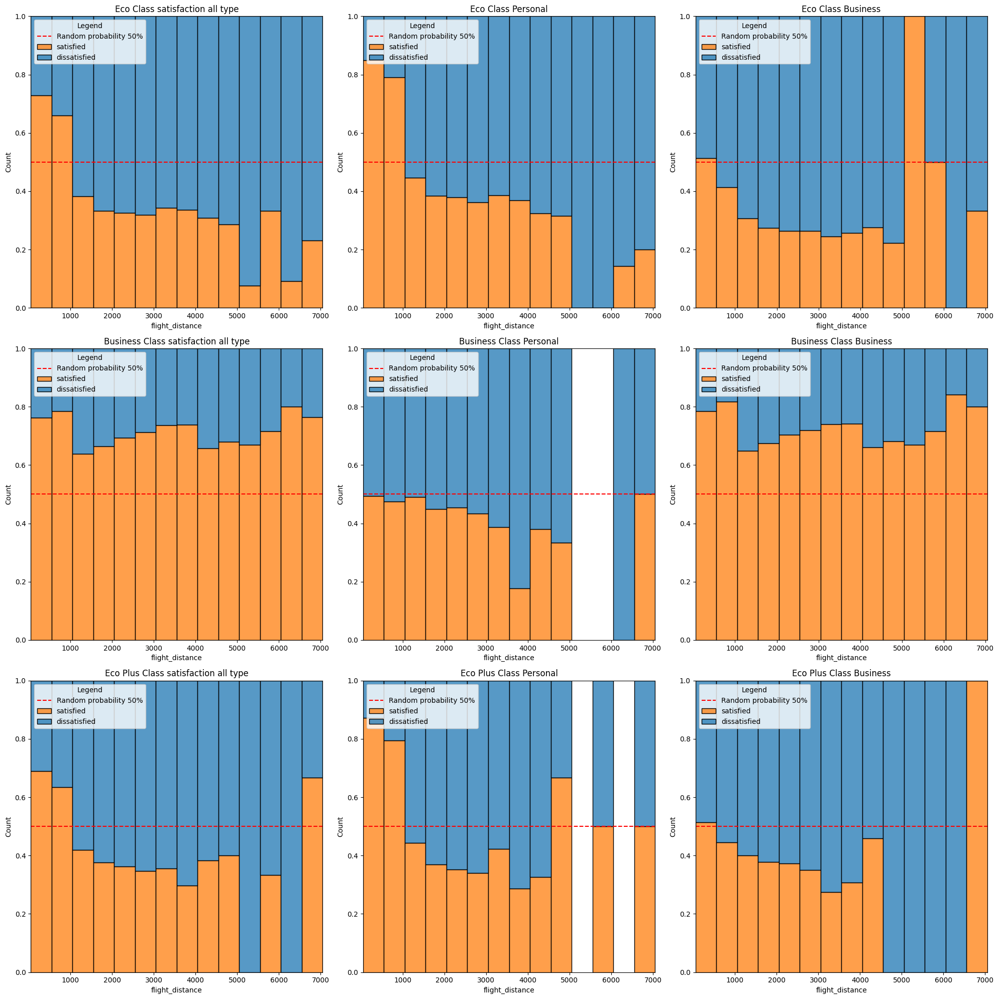

In [194]:
#####################################################################################
#Keep Class and Travel Type constant, satisfaction ratio by distance
#####################################################################################
fig,axs=plt.subplots(3,3,sharey=False,sharex=False,figsize=(20,20))
class_item=data_cat["class"].unique()
hue_order=satisfaction_hue_order
for i, class_type in zip(range(len(class_item)), class_item):
    mask=data_cat["class"]==class_type
    mask_personal=data_cat[mask]['type_of_travel']=='Personal Travel'
    mask_business=data_cat[mask]['type_of_travel']=='Business Travel'
    target_data=data_cat[mask]
    sns.histplot(data=target_data, x="flight_distance",ax=axs[i][0]
                 ,hue='satisfaction', multiple="fill",hue_order=hue_order,binwidth=500)
    sns.histplot(data=target_data[mask_personal], x="flight_distance",ax=axs[i][1]
                 ,hue='satisfaction', multiple="fill",hue_order=hue_order,binwidth=500)
    sns.histplot(data=target_data[mask_business], x="flight_distance",ax=axs[i][2]
                 ,hue='satisfaction', multiple="fill",hue_order=hue_order,binwidth=500)
    
    axs[i][0].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][1].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][2].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    
    axs[i][0].set_title(f'{class_type} Class satisfaction all type')
    axs[i][1].set_title(f'{class_type} Class Personal')
    axs[i][2].set_title(f'{class_type} Class Business')
    
    #edit legend
    handles, labels = axs[i][0].get_legend_handles_labels()
    axs[i][0].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    handles, labels = axs[i][1].get_legend_handles_labels()
    axs[i][1].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    handles, labels = axs[i][2].get_legend_handles_labels()
    axs[i][2].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    
plt.tight_layout()
plt.show()

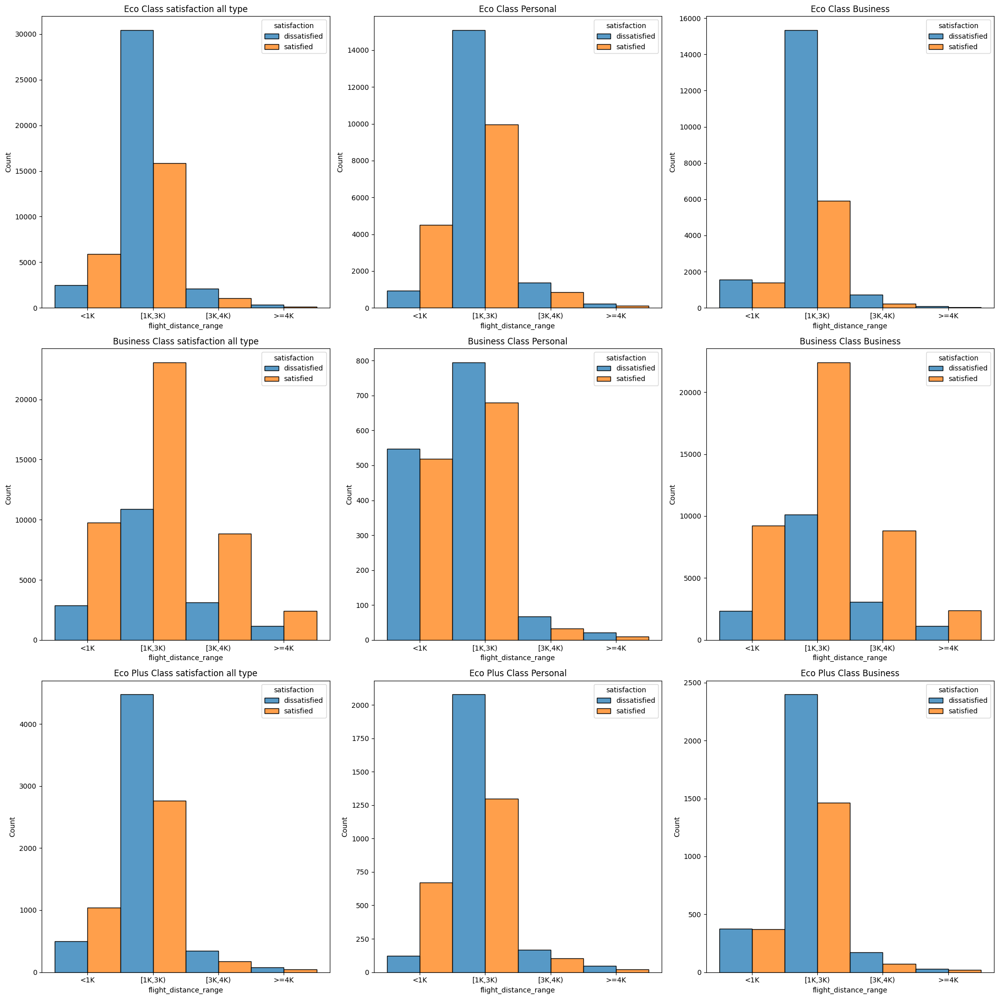

In [195]:
#####################################################################################
#Keep Class and Travel Type constant, satisfaction count by distance
#####################################################################################
fig,axs=plt.subplots(3,3,sharey=False,sharex=False,figsize=(20,20))
class_item=data_cat["class"].unique()
hue_order=satisfaction_hue_order
for i, class_type in zip(range(len(class_item)), class_item):
    mask=data_cat["class"]==class_type
    mask_personal=data_cat[mask]['type_of_travel']=='Personal Travel'
    mask_business=data_cat[mask]['type_of_travel']=='Business Travel'
    target_data=data_cat[mask]
    sns.histplot(data=target_data, x="flight_distance_range",ax=axs[i][0]
                 ,hue='satisfaction', multiple="dodge",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_personal], x="flight_distance_range",ax=axs[i][1]
                 ,hue='satisfaction', multiple="dodge",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_business], x="flight_distance_range",ax=axs[i][2]
                 ,hue='satisfaction', multiple="dodge",discrete=True,hue_order=hue_order)
    

    
    axs[i][0].set_title(f'{class_type} Class satisfaction all type')
    axs[i][1].set_title(f'{class_type} Class Personal')
    axs[i][2].set_title(f'{class_type} Class Business')
    

    
plt.tight_layout()
plt.show()

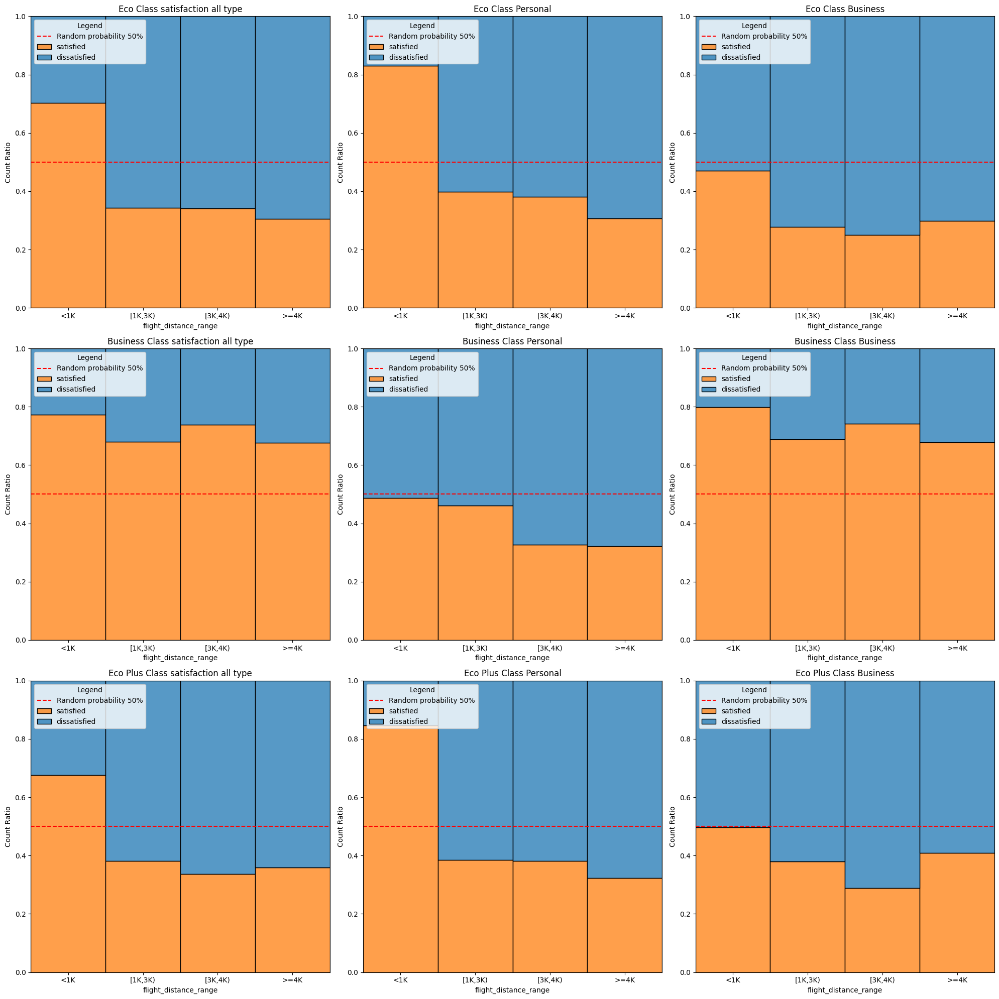

In [196]:
#####################################################################################
#Keep Class and Travel Type constant, satisfaction ratio by distance
#####################################################################################
fig,axs=plt.subplots(3,3,sharey=False,sharex=False,figsize=(20,20))
class_item=data_cat["class"].unique()
hue_order=satisfaction_hue_order
for i, class_type in zip(range(len(class_item)), class_item):
    mask=data_cat["class"]==class_type
    mask_personal=data_cat[mask]['type_of_travel']=='Personal Travel'
    mask_business=data_cat[mask]['type_of_travel']=='Business Travel'
    target_data=data_cat[mask]
    sns.histplot(data=target_data, x="flight_distance_range",ax=axs[i][0]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_personal], x="flight_distance_range",ax=axs[i][1]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_business], x="flight_distance_range",ax=axs[i][2]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    
    axs[i][0].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][1].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][2].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    
    axs[i][0].set_title(f'{class_type} Class satisfaction all type')
    axs[i][1].set_title(f'{class_type} Class Personal')
    axs[i][2].set_title(f'{class_type} Class Business')
    
    axs[i][0].set_ylabel('Count Ratio')
    axs[i][1].set_ylabel('Count Ratio')
    axs[i][2].set_ylabel('Count Ratio')
    
    #edit legend
    handles, labels = axs[i][0].get_legend_handles_labels()
    axs[i][0].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    handles, labels = axs[i][1].get_legend_handles_labels()
    axs[i][1].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    handles, labels = axs[i][2].get_legend_handles_labels()
    axs[i][2].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    
plt.tight_layout()
plt.show()

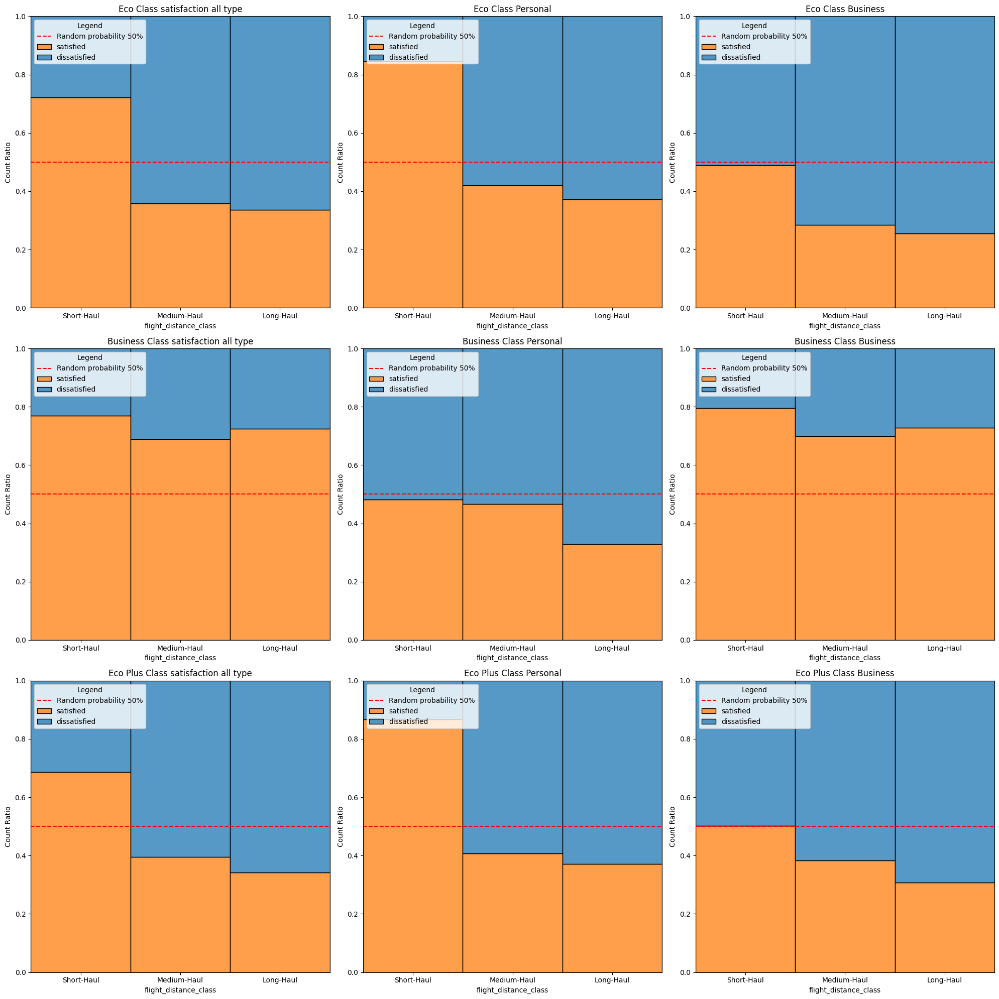

In [197]:
#####################################################################################
#Keep Class and Travel Type constant, satisfaction ratio by distance
#####################################################################################
fig,axs=plt.subplots(3,3,sharey=False,sharex=False,figsize=(20,20))
class_item=data_cat["class"].unique()
hue_order=satisfaction_hue_order

for i, class_type in zip(range(len(class_item)), class_item):
    mask=data_cat["class"]==class_type
    mask_personal=data_cat[mask]['type_of_travel']=='Personal Travel'
    mask_business=data_cat[mask]['type_of_travel']=='Business Travel'
    target_data=data_cat[mask]
    sns.histplot(data=target_data, x="flight_distance_class",ax=axs[i][0]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_personal], x="flight_distance_class",ax=axs[i][1]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_business], x="flight_distance_class",ax=axs[i][2]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    
    axs[i][0].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][1].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][2].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    
    axs[i][0].set_title(f'{class_type} Class satisfaction all type')
    axs[i][1].set_title(f'{class_type} Class Personal')
    axs[i][2].set_title(f'{class_type} Class Business')
    
    axs[i][0].set_ylabel('Count Ratio')
    axs[i][1].set_ylabel('Count Ratio')
    axs[i][2].set_ylabel('Count Ratio')
    
    #edit legend
    handles, labels = axs[i][0].get_legend_handles_labels()
    axs[i][0].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    handles, labels = axs[i][1].get_legend_handles_labels()
    axs[i][1].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    handles, labels = axs[i][2].get_legend_handles_labels()
    axs[i][2].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    
plt.tight_layout()
plt.show()
#=>for all class and travel type, Short-Haul is the most satisfied
#=>except business travel business class, others show that when distance increase satisfaction decrease

## 7~20 Rating items and Rating items class

* 7	Seat comfort
* 8	Departure/Arrival time convenient
* 9	Food and drink
* 10	Gate location
* 11	Inflight wifi service
* 12	Inflight entertainment
* 13	Online support
* 14	Ease of Online booking
* 15	On-board service
* 16	Leg room service
* 17	Baggage handling
* 18	Checkin service
* 19	Cleanliness
* 20	Online boarding

In [198]:
#rating items
var_num=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
df_original[var_num].describe(include="all")

,seat_comfort,departure_arrival_time_convenient,food_and_drink,gate_location,inflight_wifi_service,inflight_entertainment,online_support,ease_of_online_booking,on_board_service,leg_room_service,baggage_handling,checkin_service,cleanliness,online_boarding
count,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000
mean,2.838597,2.990645,2.851994,2.990422,3.249130,3.383477,3.519703,3.472105,3.465075,3.485902,3.695673,3.340807,3.705759,3.352587
std,1.392983,1.527224,1.443729,1.305970,1.318818,1.346059,1.306511,1.305560,1.270836,1.292226,1.156483,1.260582,1.151774,1.298715
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000
25%,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,3.000000,2.000000,3.000000,2.000000,3.000000,3.000000,3.000000,2.000000
50%,3.000000,3.000000,3.000000,3.000000,3.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,3.000000,4.000000,4.000000
75%,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,5.000000,5.000000,4.000000,5.000000,5.000000,4.000000,5.000000,4.000000
max,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000


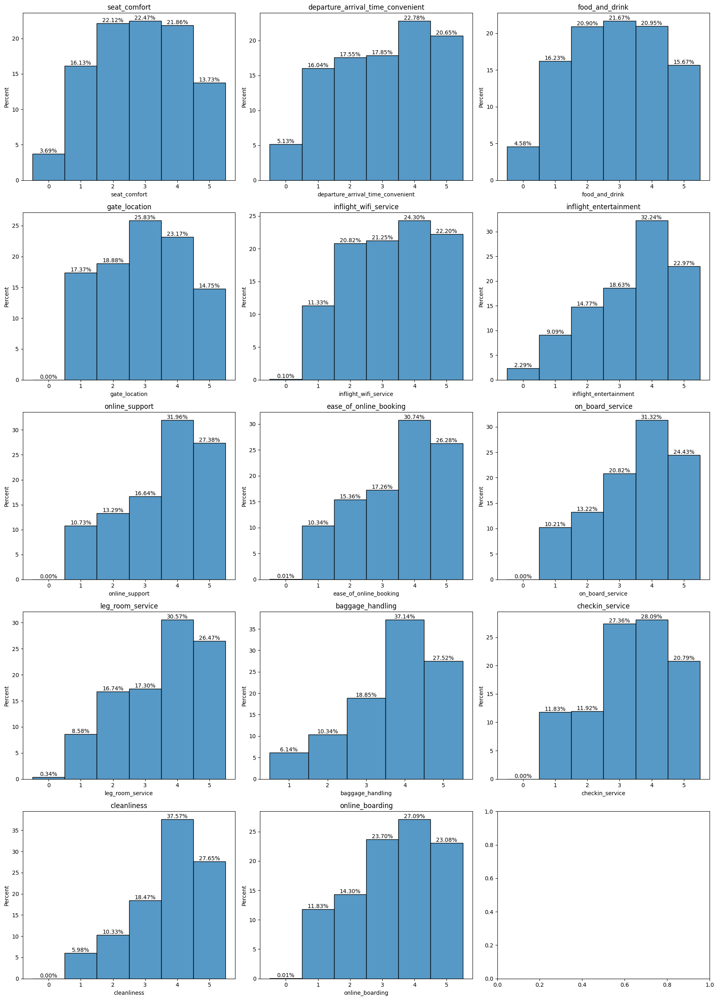

In [199]:
###############################################################
#hist plot of rating items
###############################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
for var,ax in zip(rating_list,axs.ravel()):
    target_data=data_cat
    sns.histplot(data=target_data, x=var, multiple="stack",ax=ax,discrete=True,stat='percent')
    for i in ax.containers:
        ax.bar_label(i,fmt='%.2f%%')
    ax.set_title(var)
plt.tight_layout()
plt.show()

#=>We could observe only a few passengers scored '0', satisfaction ratio may change a lot
#we can merge score 0 and 1 to 'low', 2 and 3 to 'median', 4 and 5 to 'high'

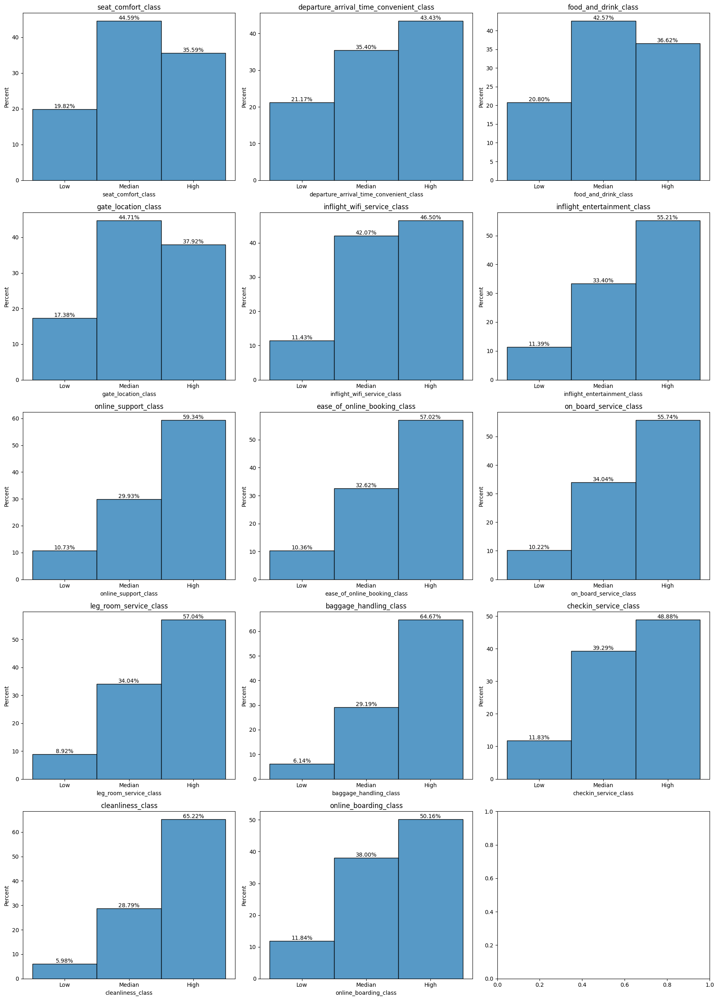

In [200]:
###############################################################
#hist plot of rating items class
###############################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
rating_list=['seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']
for var,ax in zip(rating_list,axs.ravel()):
    target_data=data_cat
    sns.histplot(data=target_data, x=var, multiple="stack",ax=ax,discrete=True,stat='percent')
    for i in ax.containers:
        ax.bar_label(i,fmt='%.2f%%')
    ax.set_title(var)
plt.tight_layout()
plt.show()

### (7~20)-21 Rating Items VS departure_delay_in_minutes

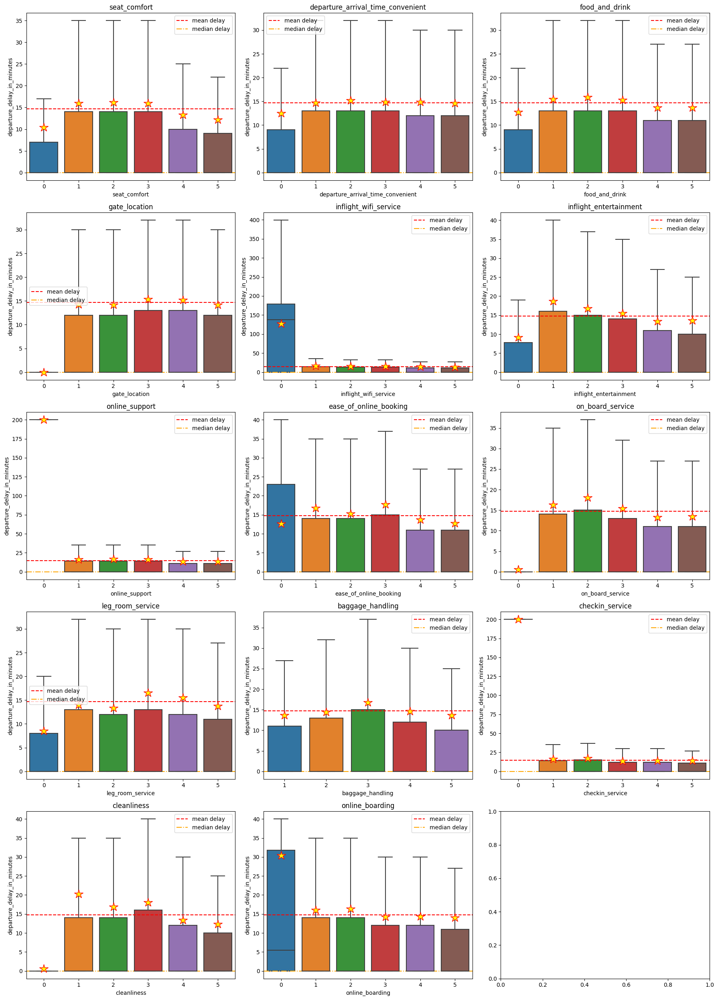

In [201]:
#####################################################################
#Box plot of departure_delay_in_minutes by different rating items
#####################################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
mean_Departure_Delay=df_original["departure_delay_in_minutes"].mean()
median_Departure_Delay=df_original["departure_delay_in_minutes"].median()

for var,ax in zip(rating_list,axs.ravel()):
    target_data=data_cat
    sns.boxplot(data=target_data, y="departure_delay_in_minutes",ax=ax,x=var,showfliers=False,
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})
    ax.axhline(mean_Departure_Delay, color='red',linestyle='--',label="mean delay")
    ax.axhline(median_Departure_Delay, color='orange',linestyle='-.',label="median delay")
    ax.legend()
    ax.set_title(var)
plt.tight_layout()
plt.show()

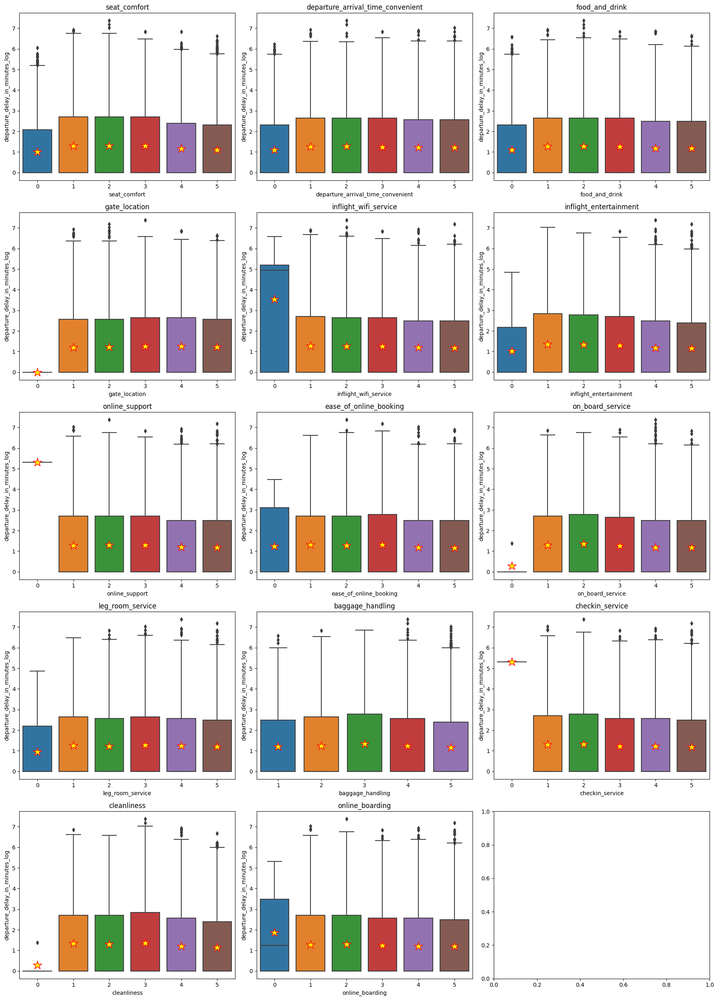

In [202]:
#############################################################
#Box plot of departure_delay_in_minutes_log by different rating items
#############################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
for var,ax in zip(rating_list,axs.ravel()):
    target_data=data_cat
    sns.boxplot(data=target_data, y="departure_delay_in_minutes_log",ax=ax,x=var,
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})
    ax.set_title(var)
plt.tight_layout()
plt.show()

#The bellowing items longer delay time tend to give 0 point
#==>'inflight_wifi_service', 'on_board_service'

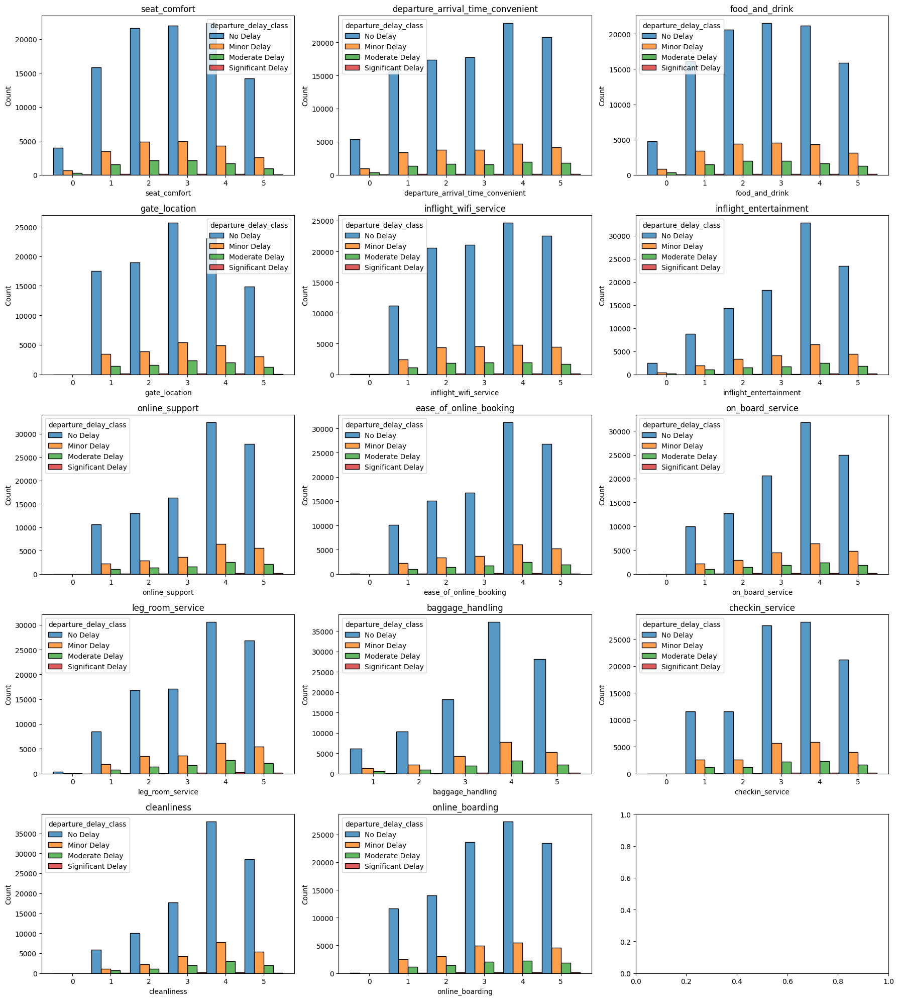

In [203]:
###############################################
#histplot
#Check survey variable
#By departure_delay_class
###############################################
hue_order=delay_class_hue_order
chk_columns_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']

fig, axs = plt.subplots(5,3,figsize=(18,20))
for col, ax in zip(chk_columns_list, axs.ravel()):
    sns.histplot(data=data_cat, x=col,
                 discrete=True,stat='count',
                 hue='departure_delay_class',
                 hue_order=hue_order,
                 multiple='dodge',ax=ax
                )
    ax.set_title(col)
plt.tight_layout()
plt.show()

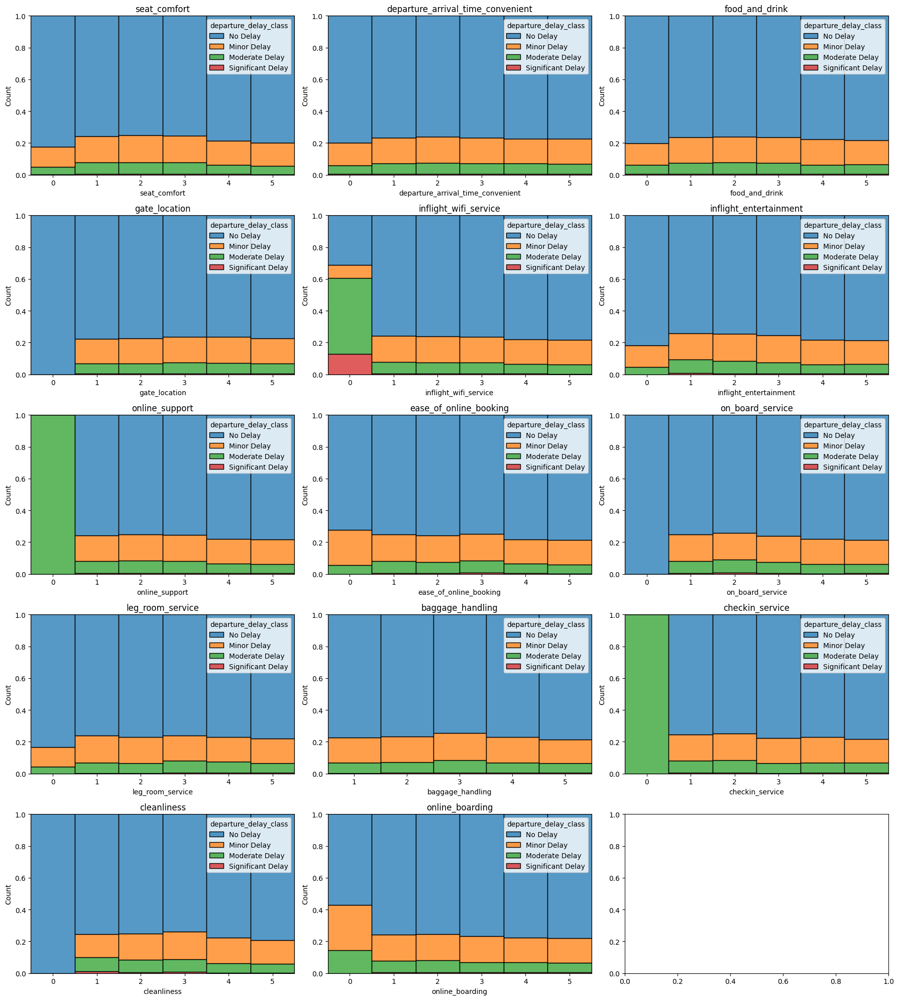

In [204]:
###############################################
#Check survey variable
#By departure_delay_class
#Score proportion by different departure_delay_class
###############################################
hue_order=delay_class_hue_order
chk_columns_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']

fig, axs = plt.subplots(5,3,figsize=(18,20))
for col, ax in zip(chk_columns_list, axs.ravel()):
    sns.histplot(data=data_cat, x=col,
                 discrete=True,
                 hue='departure_delay_class',
                 hue_order=hue_order,
                 multiple='fill',ax=ax
                )
    ax.set_title(col)
plt.tight_layout()
plt.show()

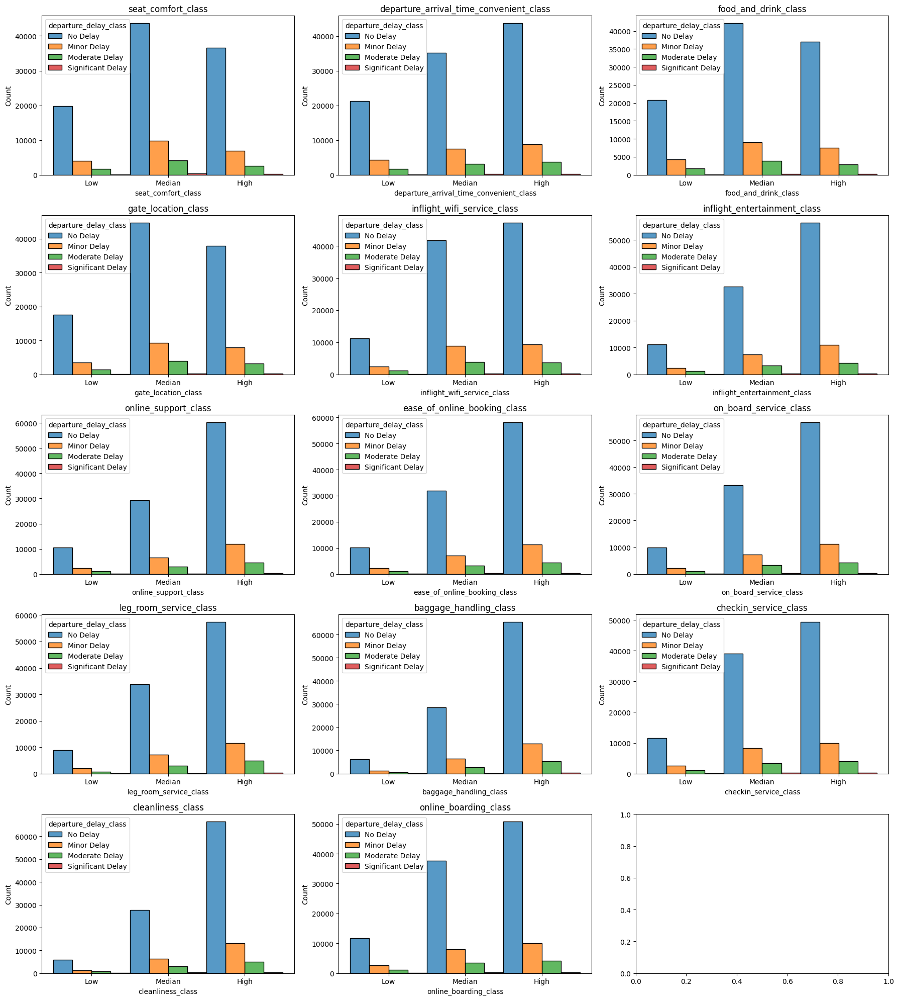

In [205]:
###############################################
#histplot
#Check survey variable
#By departure_delay_class
###############################################
hue_order=delay_class_hue_order
chk_columns_list=['seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']

fig, axs = plt.subplots(5,3,figsize=(18,20))
for col, ax in zip(chk_columns_list, axs.ravel()):
    sns.histplot(data=data_cat, x=col,
                 discrete=True,stat='count',
                 hue='departure_delay_class',
                 hue_order=hue_order,
                 multiple='dodge',ax=ax
                )
    ax.set_title(col)
plt.tight_layout()
plt.show()

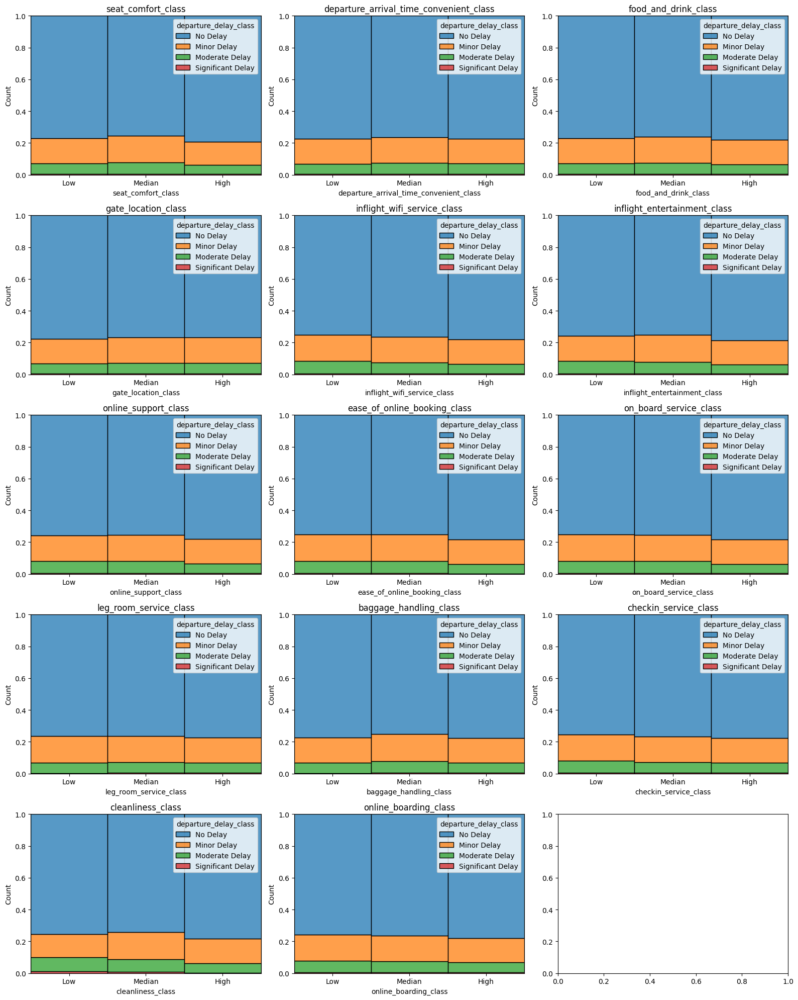

In [206]:
###############################################
#Check survey variable
#By departure_delay_class
#Score proportion by different departure_delay_class
###############################################
hue_order=delay_class_hue_order
chk_columns_list=['seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']

fig, axs = plt.subplots(5,3,figsize=(16,20))
for col, ax in zip(chk_columns_list, axs.ravel()):
    sns.histplot(data=data_cat, x=col,
                 discrete=True,
                 hue='departure_delay_class',
                 hue_order=hue_order,
                 multiple='fill',ax=ax
                )
    ax.set_title(col)
plt.tight_layout()
plt.show()

###  (7~20)-22 Rating Items VS arrival_delay_in_minutes

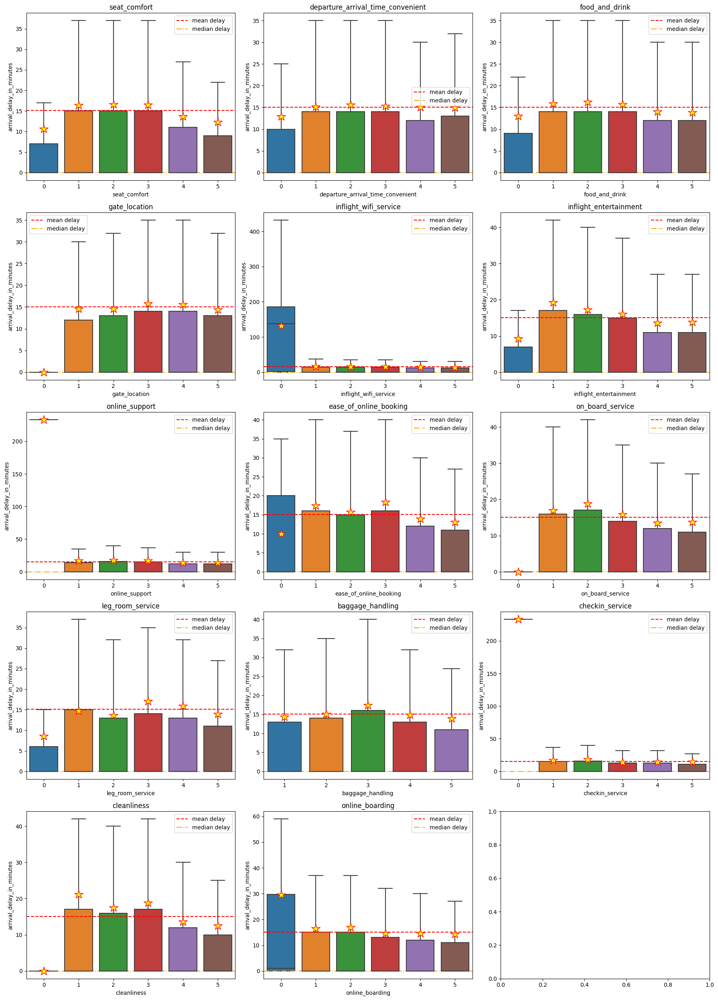

In [207]:
##############################################################
#Box plot of arrival_delay_in_minutes by different rating items
##############################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
mean_Arrival_Delay=df_original["arrival_delay_in_minutes"].mean()
median_Arrival_Delay=df_original["arrival_delay_in_minutes"].median()

for var,ax in zip(rating_list,axs.ravel()):
    target_data=data_cat
    sns.boxplot(data=target_data, y="arrival_delay_in_minutes",ax=ax,x=var,showfliers=False,
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})
    ax.axhline(mean_Arrival_Delay, color='red',linestyle='--',label="mean delay")
    ax.axhline(median_Arrival_Delay, color='orange',linestyle='-.',label="median delay")
    ax.legend()
    ax.set_title(var)
plt.tight_layout()
plt.show()

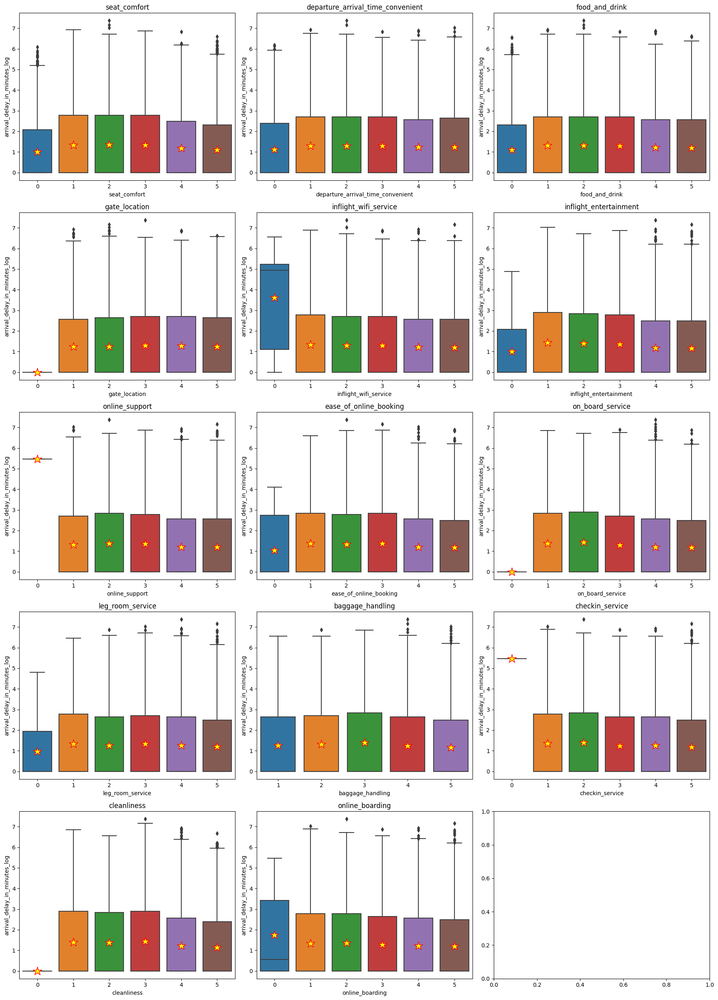

In [208]:
##################################################################
#Box plot of arrival_delay_in_minutes_log by different rating items
##################################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(18,25))
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
for var,ax in zip(rating_list,axs.ravel()):
    target_data=data_cat
    sns.boxplot(data=target_data, y="arrival_delay_in_minutes_log",ax=ax,x=var,
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"})
    ax.set_title(var)
plt.tight_layout()
plt.show()
#The bellowing items longer delay time tend to give 0 point
#==>'inflight_wifi_service', 'on_board_service'

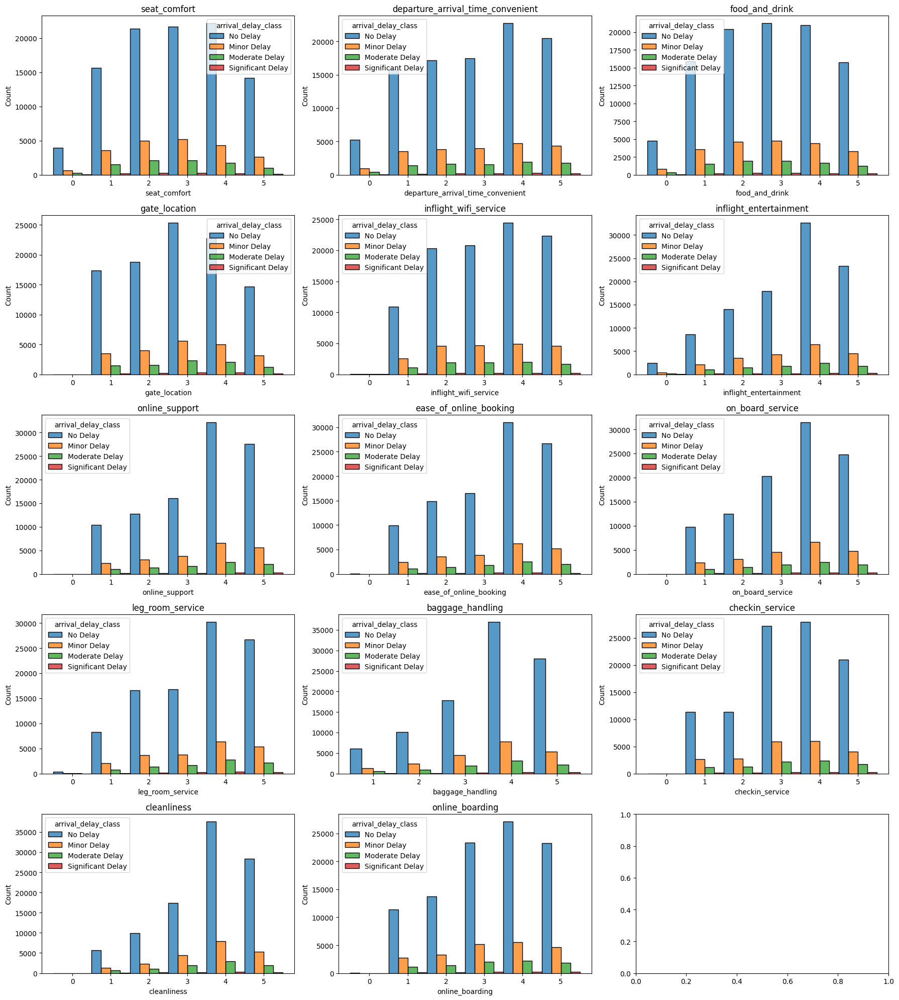

In [209]:
###############################################
#histplot
#Check survey variable
#By arrival_delay_class
###############################################
hue_order=delay_class_hue_order
chk_columns_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']

fig, axs = plt.subplots(5,3,figsize=(18,20))
for col, ax in zip(chk_columns_list, axs.ravel()):
    sns.histplot(data=data_cat, x=col,
                 discrete=True,stat='count',
                 hue='arrival_delay_class',
                 hue_order=hue_order,
                 multiple='dodge',ax=ax
                )
    ax.set_title(col)
plt.tight_layout()
plt.show()

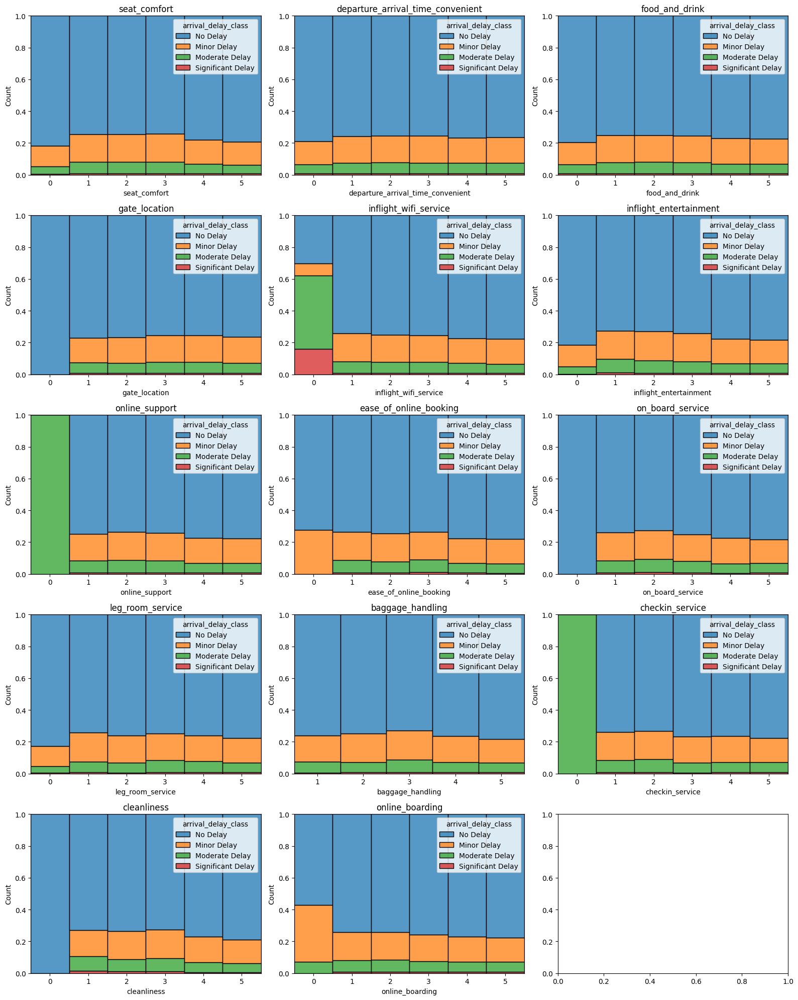

In [210]:
###############################################
#Check survey variable
#By arrival_delay_class
#Score proportion by arrival_delay_class
###############################################
hue_order=delay_class_hue_order
chk_columns_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']

fig, axs = plt.subplots(5,3,figsize=(16,20))
for col, ax in zip(chk_columns_list, axs.ravel()):
    sns.histplot(data=data_cat, x=col,
                 discrete=True,
                 hue='arrival_delay_class',
                 hue_order=hue_order,
                 multiple='fill',ax=ax
                )
    ax.set_title(col)
plt.tight_layout()
plt.show()

### (7~20) Keep Class and Travel Type Constant

In [211]:
df_type_class_age_distance=data_cat.groupby(['type_of_travel','class','age_range'])['flight_distance'].describe().reset_index()
df_type_class_age_distance
#For Age<10, both Personal Travel and Business Travel flight_distance>2000
#average flight_distance of Personal Travel were shorter than Business Travel
#average flight_distance of Business Travel business class was the longest

#For Age>70, their average flight_distance were shorter than other age range
#average flight_distance of Business Travel business class was the longest


,type_of_travel,class,age_range,count,mean,std,min,25%,50%,75%,max
0,Personal Travel,Eco,<10,1543.0,2078.127673,643.273649,777.0,1623.00,1985.0,2413.00,4502.0
1,Personal Travel,Eco,"[10,20)",5264.0,2117.843845,679.969602,791.0,1650.75,1997.0,2446.00,6792.0
2,Personal Travel,Eco,"[20,30)",5166.0,2111.590979,659.968367,754.0,1656.25,2002.5,2428.00,6907.0
3,Personal Travel,Eco,"[30,40)",5143.0,2085.464320,644.967087,728.0,1631.50,1992.0,2403.00,6470.0
4,Personal Travel,Eco,"[40,50)",5145.0,1597.543246,899.279688,50.0,868.00,1637.0,2175.00,6813.0
5,Personal Travel,Eco,"[50,60)",5128.0,1484.384945,911.990983,50.0,671.75,1466.0,2115.00,6924.0
6,Personal Travel,Eco,"[60,70)",5111.0,1493.642144,905.724859,50.0,672.50,1494.0,2118.50,6193.0
7,Personal Travel,Eco,>=70,505.0,1473.794059,912.182124,56.0,645.00,1408.0,2113.00,4193.0
8,Personal Travel,Eco Plus,<10,227.0,2094.845815,652.056209,943.0,1689.00,1961.0,2400.00,4325.0
9,Personal Travel,Eco Plus,"[10,20)",702.0,2097.183761,704.737040,720.0,1615.25,1972.5,2412.75,5920.0


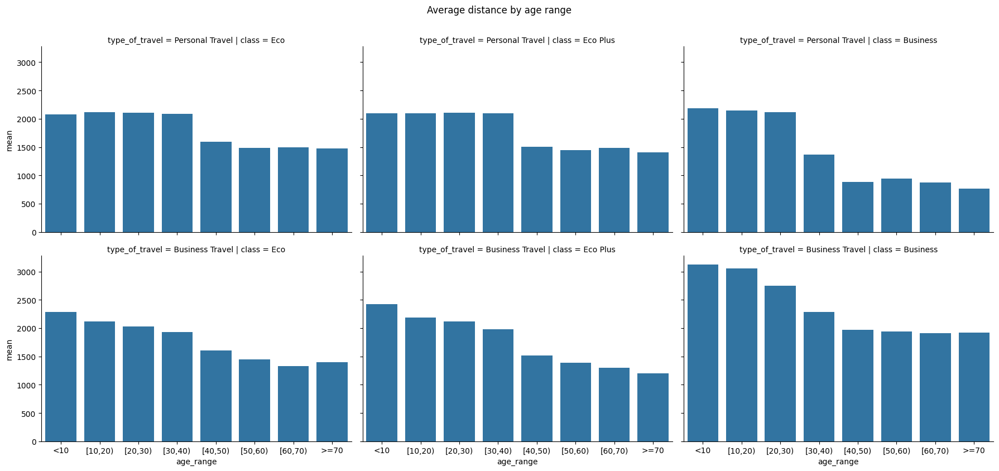

In [212]:

g = sns.FacetGrid(df_type_class_age_distance, col="class", row="type_of_travel", height=4, aspect=1.5)
g.map_dataframe(sns.barplot, x="age_range", y="mean")
plt.suptitle('Average distance by age range',y=1.05)
plt.show()

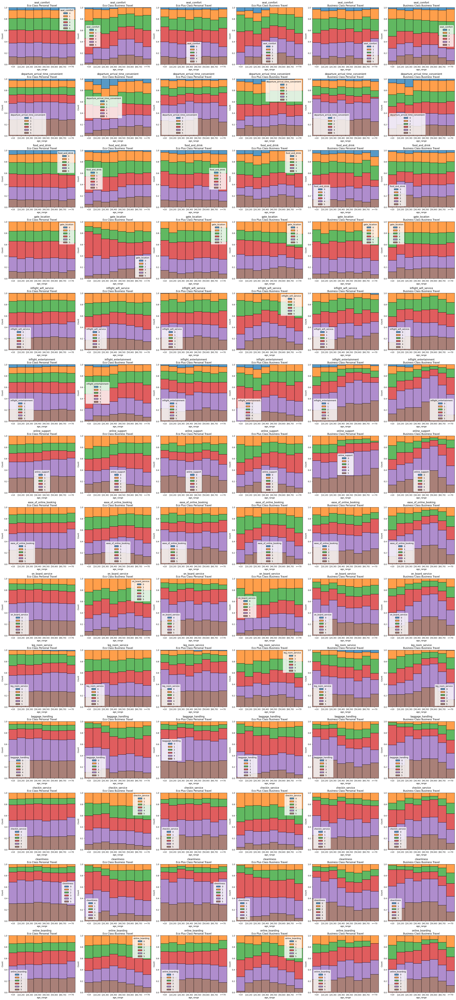

In [213]:
#####################################################################################
#Keep Class and Travel Type constant, rating point ratio by age
#####################################################################################
fig,axs=plt.subplots(14,6,sharey=False,figsize=(32,70))

hue_order=rating_hue_order
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']

data=data_cat
#mask of class and travel type
mask_eco_personal=(data["class"]=='Eco')&(data["type_of_travel"]=='Personal Travel')
mask_ecoplus_personal=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Personal Travel')
mask_business_personal=(data["class"]=='Business')&(data["type_of_travel"]=='Personal Travel')
mask_eco_business=(data["class"]=='Eco')&(data["type_of_travel"]=='Business Travel')
mask_ecoplus_business=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Business Travel')
mask_business_business=(data["class"]=='Business')&(data["type_of_travel"]=='Business Travel')
for i, var in zip(range(len(rating_list)), rating_list):
    #Eco Class and Personal Travel
    sns.histplot(data=data[mask_eco_personal], x="age_range",ax=axs[i][0],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][0].set_title(f'{var}\nEco Class Personal Travel')
    #Eco Class and Business Travel
    sns.histplot(data=data[mask_eco_business], x="age_range",ax=axs[i][1],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][1].set_title(f'{var}\nEco Class Business Travel')
    
    #Eco Plus Class and Personal Travel
    sns.histplot(data=data[mask_ecoplus_personal], x="age_range",ax=axs[i][2],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][2].set_title(f'{var}\nEco Plus Class Personal Travel')
    #Eco Plus Class and Business Travel
    sns.histplot(data=data[mask_ecoplus_business], x="age_range",ax=axs[i][3],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][3].set_title(f'{var}\nEco Plus Class Business Travel')
    
    #Business Class and Personal Travel
    sns.histplot(data=data[mask_business_personal], x="age_range",ax=axs[i][4],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][4].set_title(f'{var}\nBusiness Class Personal Travel')
    #Business Class and Business Travel
    sns.histplot(data=data[mask_business_business], x="age_range",ax=axs[i][5],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][5].set_title(f'{var}\nBusiness Class Business Travel')

plt.tight_layout()
plt.show()

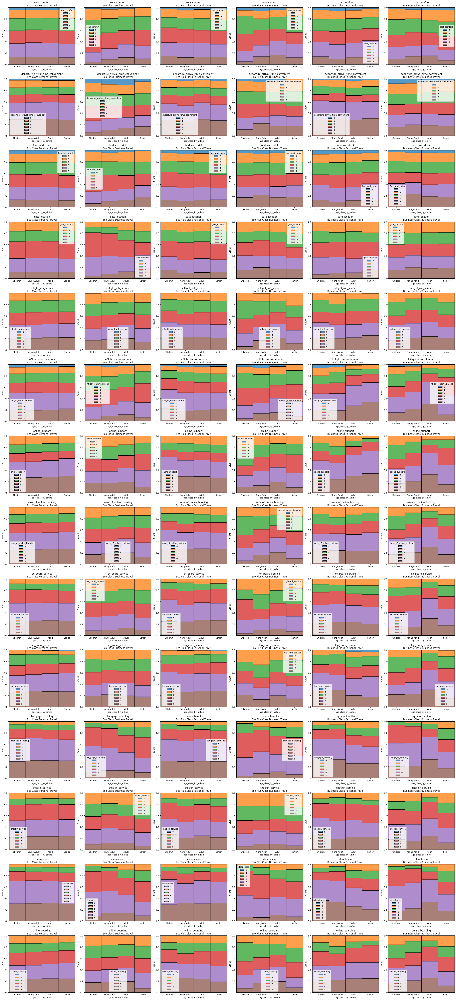

In [214]:
#####################################################################################
#Keep Class and Travel Type constant, rating point ratio by age
#####################################################################################
fig,axs=plt.subplots(14,6,sharey=False,figsize=(32,70))

hue_order=rating_hue_order
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']

data=data_cat
#mask of class and travel type
mask_eco_personal=(data["class"]=='Eco')&(data["type_of_travel"]=='Personal Travel')
mask_ecoplus_personal=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Personal Travel')
mask_business_personal=(data["class"]=='Business')&(data["type_of_travel"]=='Personal Travel')
mask_eco_business=(data["class"]=='Eco')&(data["type_of_travel"]=='Business Travel')
mask_ecoplus_business=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Business Travel')
mask_business_business=(data["class"]=='Business')&(data["type_of_travel"]=='Business Travel')
for i, var in zip(range(len(rating_list)), rating_list):
    #Eco Class and Personal Travel
    sns.histplot(data=data[mask_eco_personal], x="age_class_by_airline",ax=axs[i][0],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][0].set_title(f'{var}\nEco Class Personal Travel')
    #Eco Class and Business Travel
    sns.histplot(data=data[mask_eco_business], x="age_class_by_airline",ax=axs[i][1],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][1].set_title(f'{var}\nEco Class Business Travel')
    
    #Eco Plus Class and Personal Travel
    sns.histplot(data=data[mask_ecoplus_personal], x="age_class_by_airline",ax=axs[i][2],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][2].set_title(f'{var}\nEco Plus Class Personal Travel')
    #Eco Plus Class and Business Travel
    sns.histplot(data=data[mask_ecoplus_business], x="age_class_by_airline",ax=axs[i][3],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][3].set_title(f'{var}\nEco Plus Class Business Travel')
    
    #Business Class and Personal Travel
    sns.histplot(data=data[mask_business_personal], x="age_class_by_airline",ax=axs[i][4],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][4].set_title(f'{var}\nBusiness Class Personal Travel')
    #Business Class and Business Travel
    sns.histplot(data=data[mask_business_business], x="age_class_by_airline",ax=axs[i][5],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][5].set_title(f'{var}\nBusiness Class Business Travel')

plt.tight_layout()
plt.show()

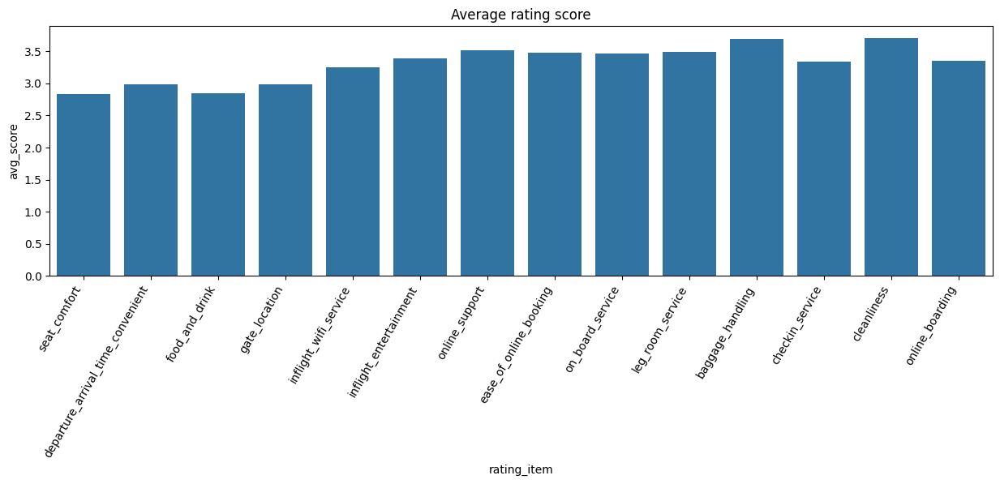

In [215]:
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
df_rating_average=df_trans[rating_list].mean().to_frame().reset_index()
df_rating_average.columns=['rating_item','avg_score']
#df_rating_average
sns.barplot(data=df_rating_average,x='rating_item',y='avg_score',color='tab:blue')
plt.title('Average rating score')
plt.xticks(rotation=60, ha='right')
plt.show()

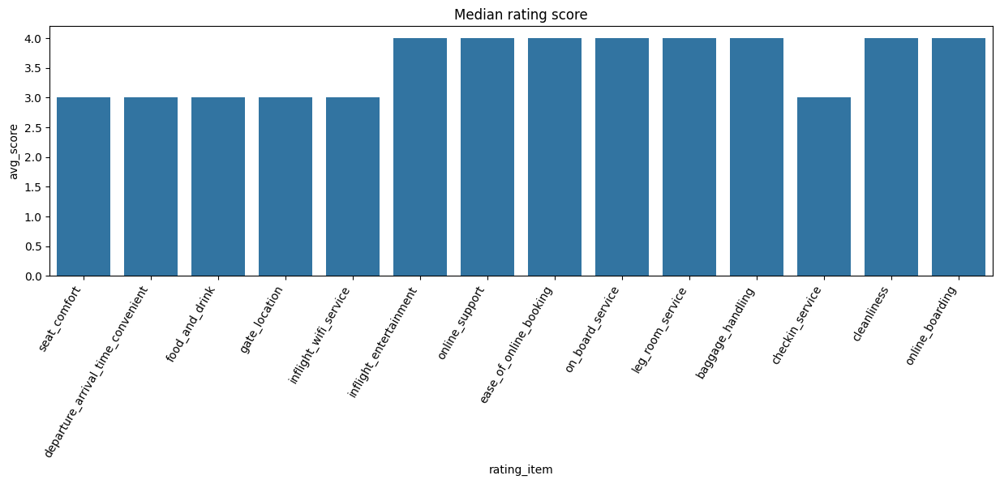

In [216]:
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
df_rating_average=df_trans[rating_list].median().to_frame().reset_index()
df_rating_average.columns=['rating_item','avg_score']
#df_rating_average
sns.barplot(data=df_rating_average,x='rating_item',y='avg_score',color='tab:blue')
plt.title('Median rating score')
plt.xticks(rotation=60, ha='right')
plt.show()

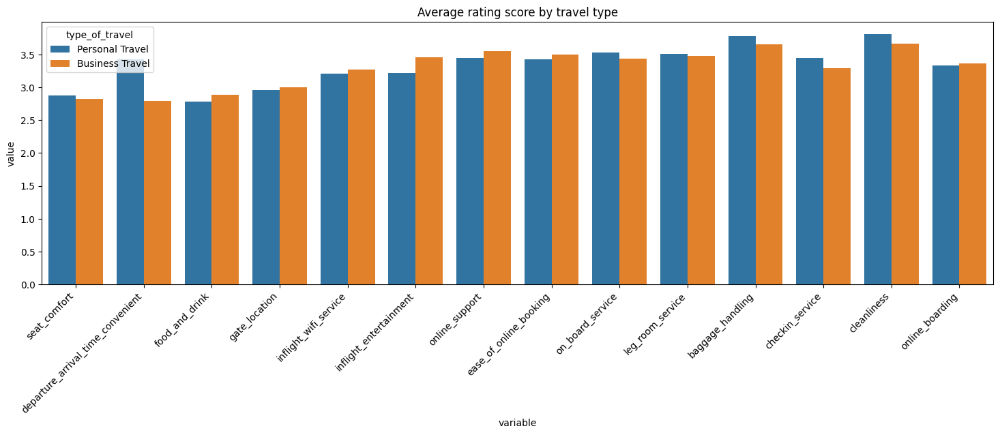

In [217]:
plt.figure(figsize=(18,5))
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
hue_order=travel_type_hue_order
df_travel_type_rating_average=df_trans.groupby(['type_of_travel'])[rating_list].mean().reset_index()
df_travel_type_rating_average=pd.melt(df_travel_type_rating_average, value_vars=rating_list,id_vars=['type_of_travel'])
sns.barplot(data=df_travel_type_rating_average,x='variable',y='value',hue='type_of_travel',hue_order=hue_order)
plt.title('Average rating score by travel type')
plt.xticks(rotation=45, ha='right')
plt.show()

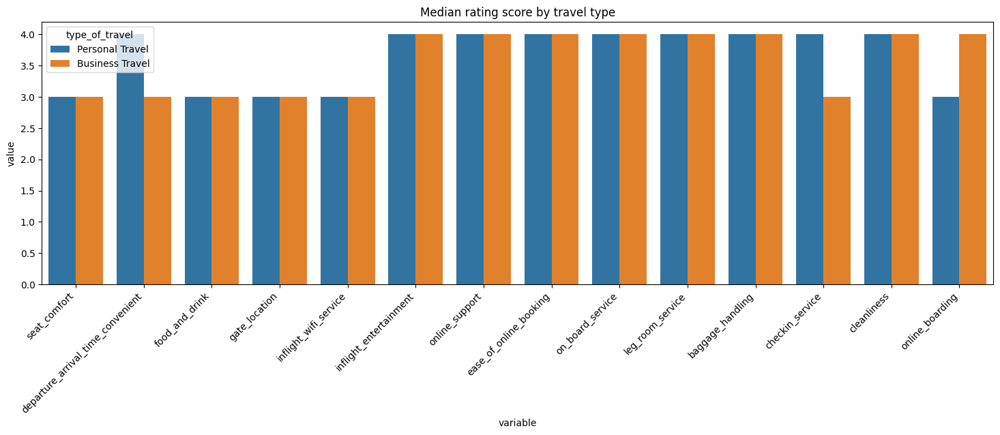

In [218]:
plt.figure(figsize=(18,5))
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
hue_order=travel_type_hue_order
df_travel_type_rating_average=df_trans.groupby(['type_of_travel'])[rating_list].median().reset_index()
df_travel_type_rating_average=pd.melt(df_travel_type_rating_average, value_vars=rating_list,id_vars=['type_of_travel'])
sns.barplot(data=df_travel_type_rating_average,x='variable',y='value',hue='type_of_travel',hue_order=hue_order)
plt.title('Median rating score by travel type')
plt.xticks(rotation=45, ha='right')
plt.show()

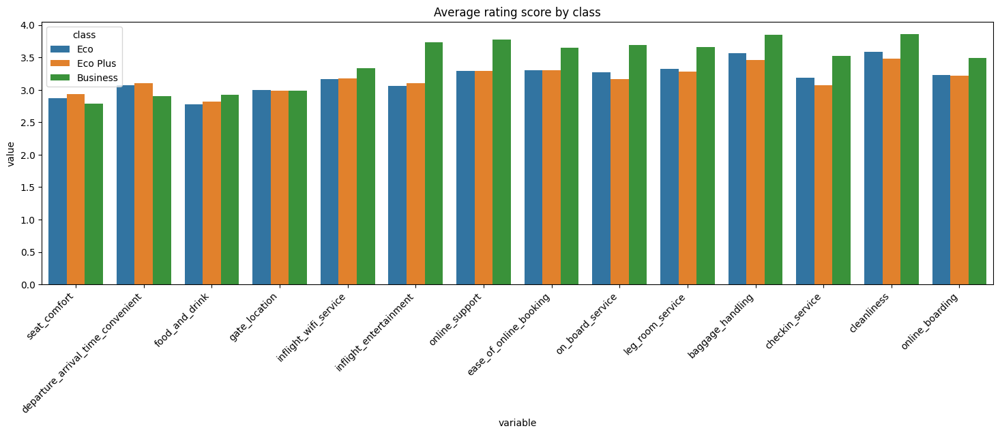

In [219]:
plt.figure(figsize=(18,5))
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
hue_order=class_hue_order
df_travel_type_rating_average=df_trans.groupby(['class'])[rating_list].mean().reset_index()
df_travel_type_rating_average=pd.melt(df_travel_type_rating_average, value_vars=rating_list,id_vars=['class'])
sns.barplot(data=df_travel_type_rating_average,x='variable',y='value',hue='class',hue_order=hue_order)
plt.title('Average rating score by class')
plt.xticks(rotation=45, ha='right')
plt.show()

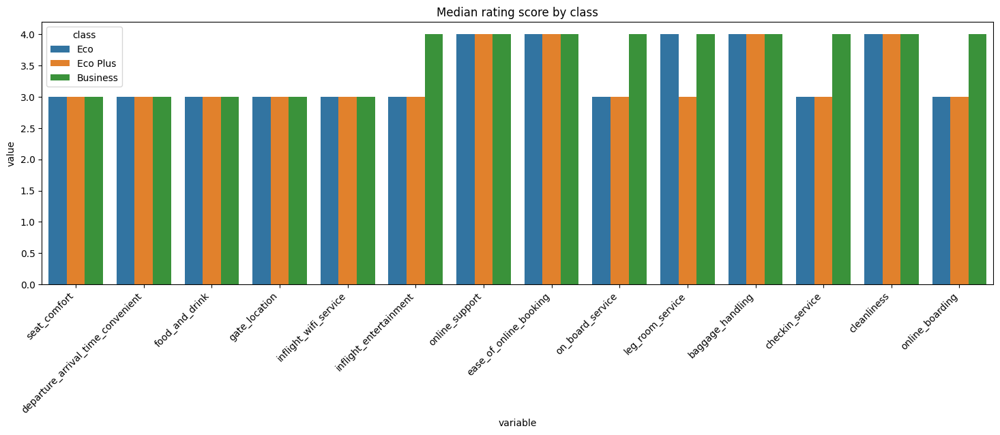

In [220]:
plt.figure(figsize=(18,5))
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
hue_order=class_hue_order
df_travel_type_rating_average=df_trans.groupby(['class'])[rating_list].median().reset_index()
df_travel_type_rating_average=pd.melt(df_travel_type_rating_average, value_vars=rating_list,id_vars=['class'])
sns.barplot(data=df_travel_type_rating_average,x='variable',y='value',hue='class',hue_order=hue_order)
plt.title('Median rating score by class')
plt.xticks(rotation=45, ha='right')
plt.show()

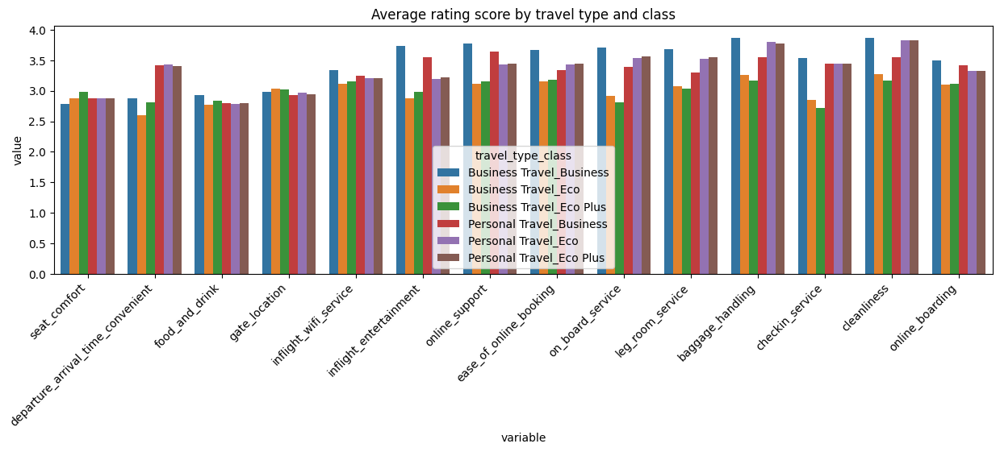

In [221]:
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
df_result=df_trans.groupby(['type_of_travel','class'])[rating_list].mean().reset_index()
df_result['travel_type_class']=df_result['type_of_travel']+'_'+df_result['class']
df_result=pd.melt(df_result, value_vars=rating_list,id_vars=['travel_type_class'])
sns.barplot(data=df_result,x='variable',y='value',hue='travel_type_class')
plt.title('Average rating score by travel type and class')
plt.xticks(rotation=45, ha='right')
plt.show()

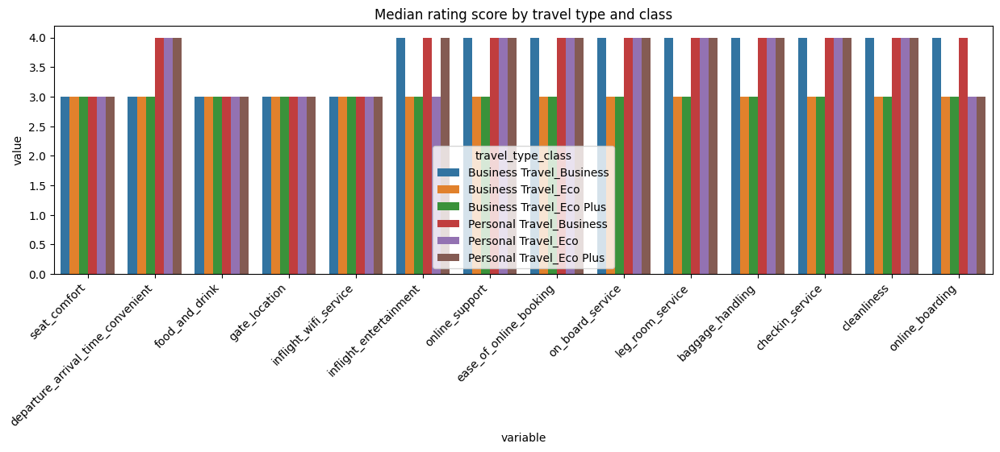

In [222]:
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']
df_result=df_trans.groupby(['type_of_travel','class'])[rating_list].median().reset_index()
df_result['travel_type_class']=df_result['type_of_travel']+'_'+df_result['class']
df_result=pd.melt(df_result, value_vars=rating_list,id_vars=['travel_type_class'])
sns.barplot(data=df_result,x='variable',y='value',hue='travel_type_class')
plt.title('Median rating score by travel type and class')
plt.xticks(rotation=45, ha='right')
plt.show()

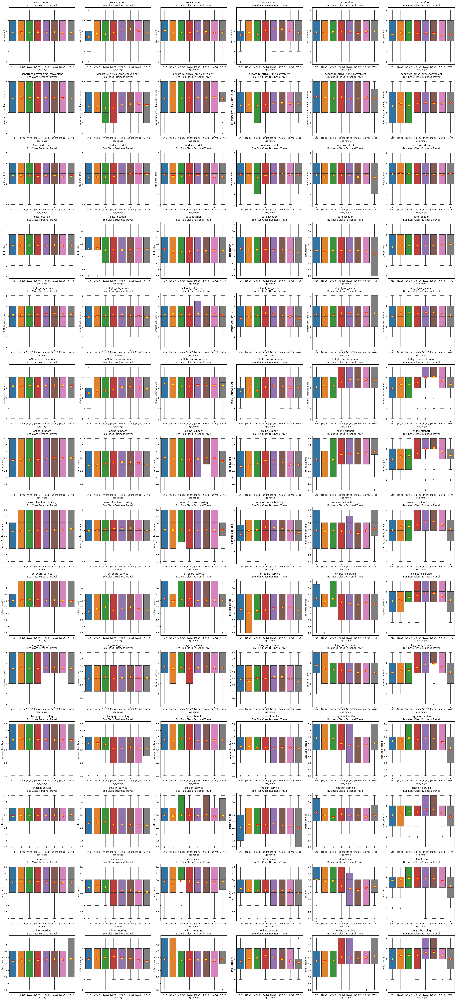

In [223]:
#####################################################################################
#Keep Class and Travel Type constant, rating point ratio by age
#####################################################################################
fig,axs=plt.subplots(14,6,sharey=False,figsize=(32,70))

hue_order=rating_hue_order
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']

data=data_cat
#mask of class and travel type
mask_eco_personal=(data["class"]=='Eco')&(data["type_of_travel"]=='Personal Travel')
mask_ecoplus_personal=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Personal Travel')
mask_business_personal=(data["class"]=='Business')&(data["type_of_travel"]=='Personal Travel')
mask_eco_business=(data["class"]=='Eco')&(data["type_of_travel"]=='Business Travel')
mask_ecoplus_business=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Business Travel')
mask_business_business=(data["class"]=='Business')&(data["type_of_travel"]=='Business Travel')
for i, var in zip(range(len(rating_list)), rating_list):
    #Eco Class and Personal Travel
    sns.boxplot(data=data[mask_eco_personal], x="age_range",ax=axs[i][0],y=data[var].astype(int),
                showmeans=True,
                meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][0].set_title(f'{var}\nEco Class Personal Travel')
    #Eco Class and Business Travel
    sns.boxplot(data=data[mask_eco_business], x="age_range",ax=axs[i][1],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][1].set_title(f'{var}\nEco Class Business Travel')
    
    #Eco Plus Class and Personal Travel
    sns.boxplot(data=data[mask_ecoplus_personal], x="age_range",ax=axs[i][2],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][2].set_title(f'{var}\nEco Plus Class Personal Travel')
    #Eco Plus Class and Business Travel
    sns.boxplot(data=data[mask_ecoplus_business], x="age_range",ax=axs[i][3],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][3].set_title(f'{var}\nEco Plus Class Business Travel')
    
    #Business Class and Personal Travel
    sns.boxplot(data=data[mask_business_personal], x="age_range",ax=axs[i][4],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][4].set_title(f'{var}\nBusiness Class Personal Travel')
    #Business Class and Business Travel
    sns.boxplot(data=data[mask_business_business], x="age_range",ax=axs[i][5],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][5].set_title(f'{var}\nBusiness Class Business Travel')

plt.tight_layout()
plt.show()

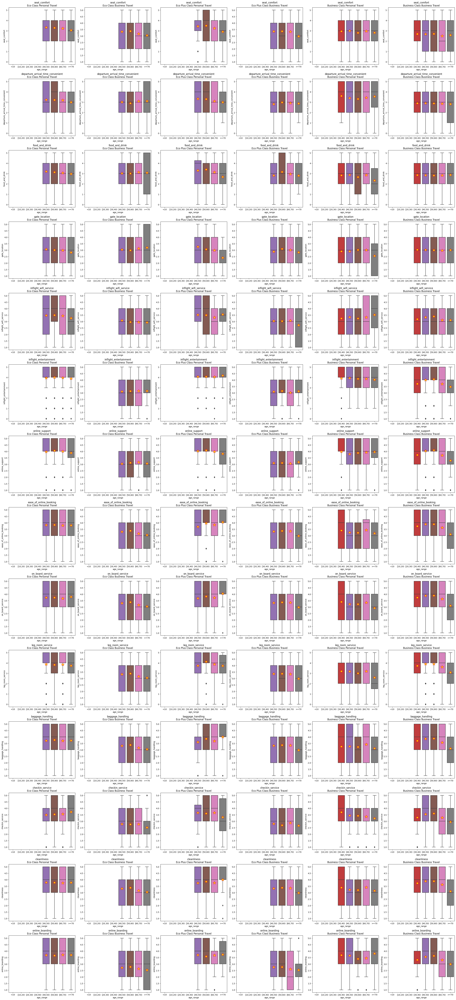

In [224]:
#####################################################################################
#Keep Class, Travel Type and Distance constant, rating point ratio by age
#trip distance Short-Haul
#####################################################################################
fig,axs=plt.subplots(14,6,sharey=False,figsize=(32,70))

hue_order=rating_hue_order
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']

mask=(data_cat['flight_distance_class']=='Short-Haul')

data=data_cat[mask]
#mask of class and travel type
mask_eco_personal=(data["class"]=='Eco')&(data["type_of_travel"]=='Personal Travel')
mask_ecoplus_personal=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Personal Travel')
mask_business_personal=(data["class"]=='Business')&(data["type_of_travel"]=='Personal Travel')
mask_eco_business=(data["class"]=='Eco')&(data["type_of_travel"]=='Business Travel')
mask_ecoplus_business=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Business Travel')
mask_business_business=(data["class"]=='Business')&(data["type_of_travel"]=='Business Travel')
for i, var in zip(range(len(rating_list)), rating_list):
    #Eco Class and Personal Travel
    sns.boxplot(data=data[mask_eco_personal], x="age_range",ax=axs[i][0],y=data[var].astype(int),
                showmeans=True,
                meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][0].set_title(f'{var}\nEco Class Personal Travel')
    #Eco Class and Business Travel
    sns.boxplot(data=data[mask_eco_business], x="age_range",ax=axs[i][1],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][1].set_title(f'{var}\nEco Class Business Travel')
    
    #Eco Plus Class and Personal Travel
    sns.boxplot(data=data[mask_ecoplus_personal], x="age_range",ax=axs[i][2],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][2].set_title(f'{var}\nEco Plus Class Personal Travel')
    #Eco Plus Class and Business Travel
    sns.boxplot(data=data[mask_ecoplus_business], x="age_range",ax=axs[i][3],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][3].set_title(f'{var}\nEco Plus Class Business Travel')
    
    #Business Class and Personal Travel
    sns.boxplot(data=data[mask_business_personal], x="age_range",ax=axs[i][4],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][4].set_title(f'{var}\nBusiness Class Personal Travel')
    #Business Class and Business Travel
    sns.boxplot(data=data[mask_business_business], x="age_range",ax=axs[i][5],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][5].set_title(f'{var}\nBusiness Class Business Travel')

plt.tight_layout()
plt.show()

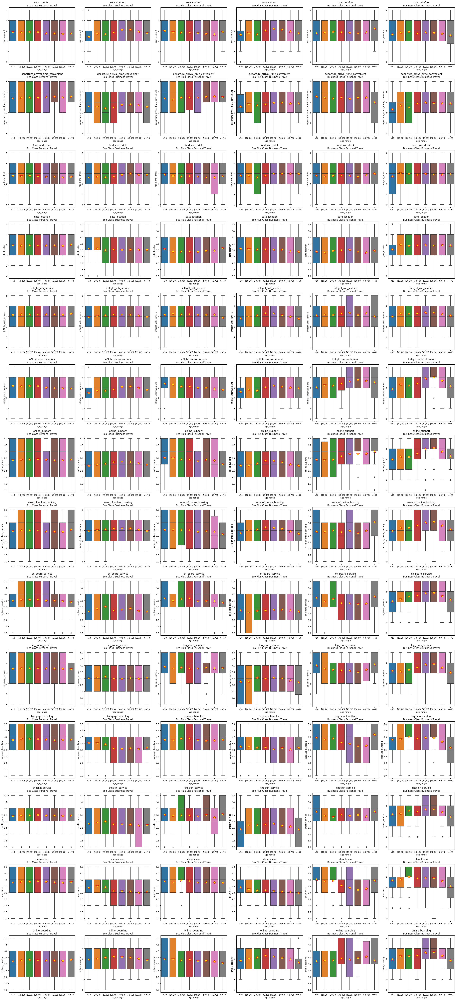

In [225]:
#####################################################################################
#Keep Class, Travel Type and Distance constant, rating point ratio by age
#trip distance Medium-Haul
#####################################################################################
fig,axs=plt.subplots(14,6,sharey=False,figsize=(32,70))

hue_order=rating_hue_order
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']

mask=(data_cat['flight_distance_class']=='Medium-Haul')

data=data_cat[mask]
#mask of class and travel type
mask_eco_personal=(data["class"]=='Eco')&(data["type_of_travel"]=='Personal Travel')
mask_ecoplus_personal=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Personal Travel')
mask_business_personal=(data["class"]=='Business')&(data["type_of_travel"]=='Personal Travel')
mask_eco_business=(data["class"]=='Eco')&(data["type_of_travel"]=='Business Travel')
mask_ecoplus_business=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Business Travel')
mask_business_business=(data["class"]=='Business')&(data["type_of_travel"]=='Business Travel')
for i, var in zip(range(len(rating_list)), rating_list):
    #Eco Class and Personal Travel
    sns.boxplot(data=data[mask_eco_personal], x="age_range",ax=axs[i][0],y=data[var].astype(int),
                showmeans=True,
                meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][0].set_title(f'{var}\nEco Class Personal Travel')
    #Eco Class and Business Travel
    sns.boxplot(data=data[mask_eco_business], x="age_range",ax=axs[i][1],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][1].set_title(f'{var}\nEco Class Business Travel')
    
    #Eco Plus Class and Personal Travel
    sns.boxplot(data=data[mask_ecoplus_personal], x="age_range",ax=axs[i][2],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][2].set_title(f'{var}\nEco Plus Class Personal Travel')
    #Eco Plus Class and Business Travel
    sns.boxplot(data=data[mask_ecoplus_business], x="age_range",ax=axs[i][3],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][3].set_title(f'{var}\nEco Plus Class Business Travel')
    
    #Business Class and Personal Travel
    sns.boxplot(data=data[mask_business_personal], x="age_range",ax=axs[i][4],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][4].set_title(f'{var}\nBusiness Class Personal Travel')
    #Business Class and Business Travel
    sns.boxplot(data=data[mask_business_business], x="age_range",ax=axs[i][5],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][5].set_title(f'{var}\nBusiness Class Business Travel')

plt.tight_layout()
plt.show()

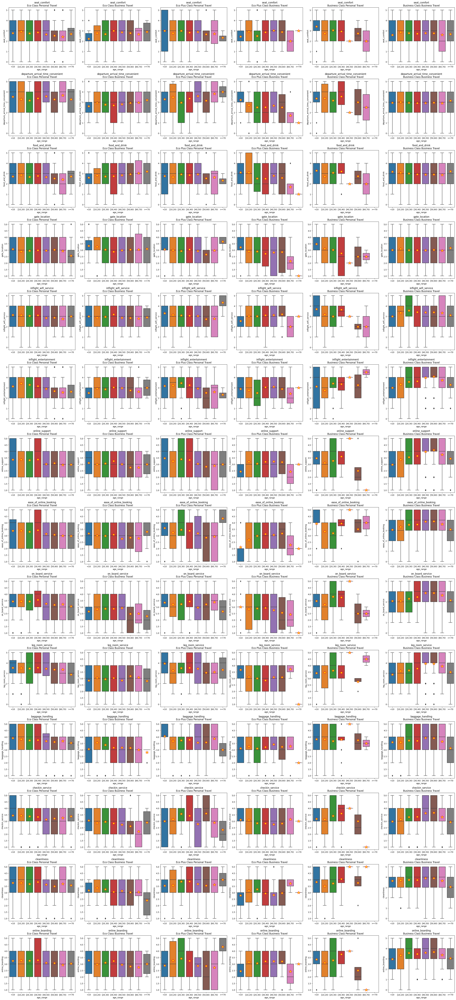

In [226]:
#####################################################################################
#Keep Class, Travel Type and Distance constant, rating point ratio by age
#trip distance Long-Haul
#####################################################################################
fig,axs=plt.subplots(14,6,sharey=False,figsize=(32,70))

hue_order=rating_hue_order
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']

mask=(data_cat['flight_distance_class']=='Long-Haul')

data=data_cat[mask]
#mask of class and travel type
mask_eco_personal=(data["class"]=='Eco')&(data["type_of_travel"]=='Personal Travel')
mask_ecoplus_personal=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Personal Travel')
mask_business_personal=(data["class"]=='Business')&(data["type_of_travel"]=='Personal Travel')
mask_eco_business=(data["class"]=='Eco')&(data["type_of_travel"]=='Business Travel')
mask_ecoplus_business=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Business Travel')
mask_business_business=(data["class"]=='Business')&(data["type_of_travel"]=='Business Travel')
for i, var in zip(range(len(rating_list)), rating_list):
    #Eco Class and Personal Travel
    sns.boxplot(data=data[mask_eco_personal], x="age_range",ax=axs[i][0],y=data[var].astype(int),
                showmeans=True,
                meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][0].set_title(f'{var}\nEco Class Personal Travel')
    #Eco Class and Business Travel
    sns.boxplot(data=data[mask_eco_business], x="age_range",ax=axs[i][1],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][1].set_title(f'{var}\nEco Class Business Travel')
    
    #Eco Plus Class and Personal Travel
    sns.boxplot(data=data[mask_ecoplus_personal], x="age_range",ax=axs[i][2],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][2].set_title(f'{var}\nEco Plus Class Personal Travel')
    #Eco Plus Class and Business Travel
    sns.boxplot(data=data[mask_ecoplus_business], x="age_range",ax=axs[i][3],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][3].set_title(f'{var}\nEco Plus Class Business Travel')
    
    #Business Class and Personal Travel
    sns.boxplot(data=data[mask_business_personal], x="age_range",ax=axs[i][4],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][4].set_title(f'{var}\nBusiness Class Personal Travel')
    #Business Class and Business Travel
    sns.boxplot(data=data[mask_business_business], x="age_range",ax=axs[i][5],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][5].set_title(f'{var}\nBusiness Class Business Travel')

plt.tight_layout()
plt.show()

**Comparison of personal travel and business travel**

* This part collaborated with AI(Gemini)

| Feature | Personal Travel| Business Travel |
|---|---|---|
| **Primary Purpose** | Vacation, visiting family/friends, leisure, exploration, events | Meetings, conferences, sales, client visits, training, project work |
| **Destination Choice** | Based on personal interest, attractions, family location, season | Based on business needs, client location, conference venue |
| **Travel Companions** | Family members, friends, partners, solo | Colleagues, clients, solo |
| **Cost & Funding** | Personally funded<BR/> budget-sensitive| Company-funded<BR/>focus on policy compliance and efficiency over lowest price<BR/> |
| **Expense Reporting** | None | Detailed expense reports required<BR/>may need airline ticket/invoice/itinerary with proof of payment  |
| **Time (Planning)** | More flexible, often booked far in advance, less change; can be spontaneous | Often last-minute bookings or subject to rapid changes; less flexibility in dates/times|
| **Flexibility** | High flexibility in dates, times, and destinations; changes less frequent but costly | Low flexibility in dates/times; changes are common and often necessary, requiring flexible tickets |
| **Booking Process** | Airline websites, Travel agencies | Corporate travel agencies or inner online booking tools ; subject to company policy |
| **Cabin Class Preference**| Predominantly Economy/Economy Plus<BR/>Business/First for special occasions<BR/>93% of personal travel was Eco/Eco Plus in this sample | Varies by company policy<BR/>66.3% of business travel was business class in this sample |
| **Luggage/Baggage** | Often more checked bags (for family, gifts, extended stays)<BR/>more conscious of baggage fees | Often carry-on only. if checked, usually just one bag<BR/>less concern for fees due to company policy |
| **In-flight Activities** | Leisurely entertainment (movies, games), napping, reading, family time | Working (laptops, emails), sleeping, inflight entertainment |
| **Pre/Post Trip Activities**| Sightseeing, leisure activities, dining out, visiting attractions | Adjust time difference(long-haul), work-related tasks |
| **Loyalty Programs** | Personal points/miles accumulation for future leisure travel | Subject to company(Points/miles may directed to corporate accounts or used for personal upgrades/perks) |
| **Document Requirements**|Domestic flights：<BR/>Age>=18: Valid, current U.S. federal or state-issued photo ID[[1]](#1)<BR/>Unaccompanied minors: some form of ID(recommend), unaccompanied minor tickets, contact info[[2]](#2)<BR/>Internal flights[[3]](#3):<BR/> Passport<BR/>Visa/Authorization(if necessary)<BR/>Vaccine requirements(if necessary)<BR/>Some forms/enrollment(if necessary)|Domestic flights：<BR/>Age>=18: Valid, current U.S. federal or state-issued photo ID[[1]](#1)<BR/>Unaccompanied minors: some form of ID(recommend), unaccompanied minor tickets, contact info, may need a form[[2]](#2)<BR/>Internal flights[[3]](#3):<BR/> Passport<BR/>Visa/Authorization(if necessary)<BR/>Vaccine requirements(if necessary)<BR/>Some forms/enrollment(if necessary)|


References:

<a id="1">[1]</a> 
[U.S. Travel document requirements](https://www.united.com/en/us/fly/travel/trip-planning/us-travel-document-requirements.html)

<a id="2">[2]</a> 
[Unaccompanied minors](https://www.united.com/en/us/fly/travel/accessibility-and-assistance/unaccompanied-minors.html)

<a id="3">[3]</a> 
[International travel requirements](https://www.united.com/en/us/fly/travel/trip-planning/international-travel-requirements.html)

**Observations & Potential reasons**

**This part collaborated with AI(Gemini)**

* Average/median flight distance of personal travel was shorter than business travel
* Average flight distance of Eco and Eco Plus class were shorter than Business class
* Average flight distance of age ranges
    * For business travel, as age increase average flight distance tend to decrease. Business class has longer average distance than Eco and Eco Plus within the same age range.
    * For personal travel, minor average distance change when age<40, sudden decrease at 40-50 then minor change.
    * Business travel seemed to have longer average flight distance than personal travel. 


* Seat Comfort
    * Observations:
        * Compared with other rating items, overall score was lower than others
        * Average score of business travel was a little lower than personal travel
        * For personal travel, minor change across different age ranges; longer flight distance lower score in Eco and Eco plus, distance less than 1000 had highert score; while in Business class, 3000-4000 showed a higher score.
        * For business travel, Eco and Eco Plus showed two curves, passengers under 10 and 20-30 showed lower score than others, increase trend 20-50, decrease trend from 50; Business class showed two curves, passengers under and 30-40 showed lower score than others, decrease trend from 40. Eco and Eco Plus distance less than 1000 had higher score,other distance range showed similar score; minor change across different distance range in Business class
    * Potential reasons:
        * Short-haul flights minor discomforts are more tolerable, longer distance discomforts are less tolerable.
        * Even the same class, different aircraft type different seat configuration. Some longer routes may use wide-body crafts, relatively larger space.
        * For business travel, Eco and Eco Plus travelers may have families at 20-30, balance work and personal life or bring a child in a business travel made them frustrated；while in business class, they may have families at 30-40, similar issues made them frustrated.
        * Personal travel often for leisure or visit families, which made them more relax and more tolerable. They balance service level and cost, usually service level meet their expectations.
        * Business travel are less flexible, need to follow company policies, they are more stressfull and less tolerable, some of them need to work during their flights, any discomfort may reduce their work efficiency, make them feel dissatisfied.
        * For elder business passengers, their physical condition make them less tolerable for discomfort.

  
* Departure Arrival Time Convenient
    * Observations:
        * Compared with other rating items, overall score was lower than others
        * Personal travel seemed to have higher score than business travel
        * Median age of 0 point(26) was younger than others(40-41)
        * For personal travel, minor change across different age ranges. 
        * For business travel, minor change across different age ranges except 20-30 showed lower score. In Business class passengers < 10 also showed a lower score.
        * For personal travel Eco and Eco Plus class, increase from distance 50-3000 then minor decrease, distance<1000 showed lowest score than other distance range; while in Business class, minor change 50-4000, decrease from 4000
        * For business travel, in Eco class 1000-3000 showed lower score; Business class showed minor change across different distance range
    * Potential reasons:
        * Personal travelers typically have more flexibility in their schedules, often booked far in advance, allowing them to choose from a wider range of available flights and book those that best suit their preferences
        * Business travel schedules are often dictated by external factors like meeting times, conference schedules. This significantly limits flexibility in choosing ideal flight times. Company policies often prioritize cost-efficiency, which might force business travelers into less convenient. Business travelers frequently use connecting flights to reach specific destinations efficiently. The convenience of the overall itinerary (e.g., minimal layover time) might outweigh the convenience of individual flight segment times.
        * Younger passengers often budget-sensitive, they may choose more cheaper flights(e.g. red eye) with less convient departure arrival time
        * Business travel 20-30 passengers may have families, inconvenient travel time leads to more unhappiness.
        * Company policy, Business travelers may need to use their private time to get to the destination, travel time were not counted as work time; Some companies may have price limit, which restrict their choice(e.g. red eye)[[9]](#9).
        * Business travel often have strict schedules,less flexibility, which fundamentally disrupt a child's natural routines and needs. This leads to general unhappiness for the child (and by proxy, the adult).For longer business trips that cross time zones, children often struggle more significantly with jet lag than adults, making arrival times particularly disruptive and inconvenient for their adjustment.
        * Some very long haul flight frequency might be lower, limiting the choices
        * The main passengers of some routes are not business travelers(e.g. travel， leisure).
        * Some short regional routes, flight frequency might be lower, limiting the choices
        * The relationship between departure and arrival time, public transportation operating time and road traffic conditions. For passengers who use public transportation, they may hope departure arrival time within the public transportation operating time; for passengers who drive to the airport, they may hope driving time could avoid peak traffic jams.
        * Transit time: Transit time was too long or too short; Transit time was not within the airport operation time, passengers need to find a place to stay.


* Food And Drink
    * Observations:
        * Compared with other rating items, overall score was lower than others
        * For personal travel Eco and Eco Plus class, as distance get longer score tend to decrease.
        * For personal travel minor change across different age range, except seniors in business class had lower score
        * For business travel Eco class, compared with other distance range <1000 had the highest score. Business class minor change across different distance range.
        * For business travel Eco class, passengers<40 had lower score than other age range; while Business class, passengers 10-30 had higher score than other age range
    * Potential reasons:
        * While a short flight's snack or basic meal might be acceptable, on longer flights, the need for satisfying and varied sustenance increases, the gap between expectation and reality widens, leading to lower scores.
        * The food and drink was good, but not outstanding compared with other airlines[[4]](#4)
        * Seniors often have health concerns, domestic short-haul only provide snacks, it did't meet seniors's needs.
        * Limited menu choices in Eco and Eco Plus class,especifically flight distance over 1000.
        * Quality Degradation & Freshness Concerns
        * Longer distance often more passengers, wait time will be longer.
        * Many passengers share the same similarity(same taste), they may select the same menu, shortage of certain food will occur.

* Gate Location
    * Observations:
        * Median age of 0 point(47.5) was older than others(38-42)
        * Among 0 point, 100% of them were loyal customer
        * Among 0,1,2 point, business class ratio were higher than overall sample ratio
        * Average score of Eco, Eco Plus, Business class were nearly equal
        * For personal travel Eco and Eco Plus class, minor change across different age range, age<10 in Eco Plus was a bit higher than others; In Business class, minor change across different age range except age>70 was a bit lower than others.
        * Personal travel minor change across different distance range in all cabin class except distance>4K was a bit higher than others in Eco Plus class.
        * For business travel minor change across different age range except age<10 in Business class was a bit lower than others.
        * Business travel minor change across different distance range in all cabin class except 3K-4K was a bit lower than others in Eco Plus
    * Potential reasons:
        * For loyal customers, they are frequent users, they know how much time is necessary and may have less buffer time to handle sudden gate location change.
        * Connections: For connecting passengers too long walking distance of connecting flights will lead to dissatisfaction.
        * International-domestic transit/transfer was too complex, e.g. international terminal(arrival) and domestic terminal(departure) were too far away
        * Gate Guide: For connecting passengers no guide/unclear guide of gate location will lead to dissatisfaction.
        * Mobility issues: A far gate or passengers need to take a shuttle bus and climb boarding stairs
        * Amenities: The gate area didn't have enough seating, power outlets, clean restrooms, and dining options.
        * Gate area was overly crowded

* Inflight Wifi Service[[5]](#5)
    * Observations:
        * Median age of 0 point(28) was younger than others(37-41)
        * Median distance of 0 point(around 2.4K) was longer than others(around 2K)
        * Among 0 point, significant delay and moderate delay proportion were higher than other groups; average departure_delay_in_minutes was around 130, arrival_delay_in_minutes was around 140, significantly higher than other score groups
        * Among 0 and 1 point, around 58% of each were Eco class
        * Average score of Business class was a bit higher than Eco and Eco Plus class
        * Average score of Business travel Business class was higher than others
        * For personal travel, increased at 40-60, decreased at 60-70 in Eco class. Increased at 40-50, decreased at 50-60 in Eco Plus class. Increased at 30-40 decreased at 50-60 then increased from 60 in Business class
        * Personal travel in Eco and Eco Plus average score tend to decrease as distance get longer; Business class distance<1K and 3K-4K were bit higher than others; Average score of distance<1K was the highest across all cabin class.
        * For business travel, in Eco and Eco Plus class  a curve shape, peak at 30-40. In Business class it showed two curves shape, peak at 20-30 and 50-60, a bit decrease at 30-40. Lowest average score at <10 and >70 in all cabin class
        * Business travel minor change across different distance range in Eco and Eco Plus; Business minor change across different distance range except distance>4K was higher than others.
    * Potential reasons:
        * When moderate/significant delay occured, passengers need to change their schedules(e.g. next flight, hotel, etc), growing demand for inflight wifi service, unavailable or unreliable wifi service will make them very dissatisfied.
        * Higher demand(or Sudden demand) when encounter some issues(e.g. flight delay), need Wi-Fi to change/cancel their schedules, request refunds for some canceled services, request compensation for significant delay.
        * Service level: Speed & Bandwidth, Reliability & Consistency(Uptime, coverage, stable performance), Pricing & Value, Ease of Use(Connection process, UI, device compatibility) didn't meet expectations
        * Wi-fi Availability: In some aircrafts Wi-Fi service was not available
        * Pricing and Value: Wi-Fi option was too high for some passengers
        * Customer support: Troubleshooting(fail to use), refunds(flight cancel or rebook),


* Inflight Entertainment[[6]](#6)
    * Observations:
        * Median age of 0 point(26) was younger than others(36-43)
        * As rating score get higher business class proportion tend to increase(higher score higher business class ratio).
        * Average rating score of business travel was higher than personal travel
        * Average score of business class was higher than others
        * Personal travel Eco class minor change across different age range; Eco Plus class <20, 40-60 were a bit higher than others, age<10 was the highest; Business class age>=30 were higher than age<30
        * Personal travel average score of distance < 1K were higher than other distance range groups across all cabin class; 
        * Business travel Eco and Eco Plus class, age<40 were lower than age>=40; Business class showed a curve, peak at 50-60, lowest point at age<10
        * Business travel average score of distance < 1K were a bit higher than other distance range groups across all cabin class; Average score of business class was higher than other class
    * Potential reasons:
        * Service demand: Short-haul always lower demand for inflight entertainment. Personal travelers have more diverse inflight entertainment, like games, reading, family time. etc, their average flight distance was shorter than business travelers, thus lower demand; while business travelers have limited entertainment, longer average distance, thus higher demand for inflight entertainment;
        * Cabin class service level: Business class always provide better inflight entertainment servie
        * Average distance of younger business travelers were longer than older business travelers, they have higher demand for inflight entertainment, however it may not avalable in some aircrafts, thus lower score
        * Passenger preferences: Personal travelers have more diverse backgrounds, while business travelers share many similarities(educated, most of them adults 22-60), inflight entertainment contents might be good enough for business travelers but didn't meet personal travelers's requirements
        * Accessibility & Usability design: Screen/menu might be difficult for younger children and seniors to use; limited language support could reduce forengners's satisfaction; For passengers with visual impairments text-to-speech, visual settings adjustments are necessary; For passengers with hearing impairments closed captions, subtitles, audio-based instructions, adjustable volume controls are necessary; 
        * Language settings are not initialized after the trip.
        * Broken device: inflight entertainment device was borken

* Online Support
    * Observations:
        * Higher rating, higher median age
        * Among 0 point(only one record, Business class, business travel), all were moderate delay; average departure_delay_in_minutes was 200, arrival_delay_in_minutes was around 260, significantly higher than other score groups; 
        * Among 0 point, 100% of them were loyal customer
        * Average score of business class was higher than others
        * Personal travel, in Eco class, average score remains flat for passengers age<10 to 20-30, shows a slight increase from 30-40 to 40-50, and then plateaus again. In Eco Plus, Overall decrease trend as passenger age get older; in Business class, average score of age groups from [30,40) to >= 70 were higher than <10 to [20,30)
        * Personal travel, overall decrease trend as distance get longer
        * Business travel, all cabin class showed a curve shape, in Eco and Eco Plus peak at 30-50, in Business class peak at 40-60.
        * Business travel, average score of distance>4K was higher than other distance range in Eco and Eco Plus class; in Business class decrease from distance<1K then minor change.
    * Potential reasons:
        * Demand for support: Average distance of younger personal travelers was longer than elder travers, longer distance often higher possibility to encounter delay or baggage issues, higher demand for support(e.g. change/cancel flights, refund, compensation)
        * Accessibility & Availability: Longer distance often associated with time difference, language options, limited language options or long time wait for resolving issues will lead to dissatisfaction.
        * Problem solving options: Business travelers(executive or senior leadership) may have other corporate tools or resources to help them resolve problems, thus higher score; Personal travelers or general business travelers need to use limited tool to get support.
        * Premium service: Business class may have wider range of rebooking options, more flexible to change/cancel, higher priority to get support, also have access to airline lounges which will provide them better experience.
        * Information transparency and accuracy: Outdated or inaccurate information, not transparent information of some situation lead to passenger support(e.g. rebook process when encounter delay)
        * System(Web,APP) performace&reliability&usability: Passengers may encounter some issues while using the related systems.



* Ease of Online Booking
    * Observations:
        * Median age of 0 point(23.5) was younger than others(36-41)
        * Median distance of 0 point(around 2.5K) was longer than others(around 2K)， average distance of 0 point (around 3K) was longer than others(around 2K)
        * Among 0 point, around 27% were minor delay; around 78% of them were Eco Plus and Business class
        * Among 0 point, 100% of them were loyal customer, 100% of them were business travel
        * Average score of business class was higher than others
        * Average score of business travel was a bit higher than personal travel
        * For personal travel, in Eco and Eco Plus class, median score were 4, except age<10 in Eco and age>=70 in Eco Plus; 
        * For Personal travel, in Eco and Eco Plus class, average score of distance <1K(3.7-3.8) were higher than other distance range(3.1-3.4); in Business class distance [3K,4K) was higher than other distance range.
        * For business travel, in Eco and Eco Plus class, median score of all distance range were 3; in Business class median score of all distance range were 4.
        * For business travel, in Eco and Eco Plus class, median score of all age range were 3; in Business class median score of [30,70) were 4, higher than median score of <10 to 30 and age>=70(around 3).
    * Potential reasons:
        * Booking tool: Business travelers may have to use corporate travel agencies or corporate online booking tools(third party tool), some may less easy and convient to use(e.g. UI/UX not accessible, difficult to book a ticket for a child, etc).
        * Seat selection: Business class ticket could freely select seats at the time of booking, with no additional fees. While Eco may need to pay additional fee to select seats.
        * Flexibility for Changes: Business Class tickets are more easy to change.
        * Simplicity of the Itinerar: Short-haul flights are often direct or involve only one simple connection, less filters,  less concerns(e.g. entertainment, wifi, meals) to compare flights.
        * Language options: Average/median distance of 0 point were higher than others, it might be internal flights. Limited language options will lead to dissatisfactions(e.g. Some residents[[7]](#7) in Italy, Spain, Greece, etc do not speak English)
        * Payment options: Payment options were limited for some passengers(e.g. foreign passengers, Non-credit card users).
        * Invoice/itinerary policy or corporate tool restriction: For business travelers, their company may require invoice/itinerary of their trip, when they bring other members(e.g. child), they need to exclude other members from their invoice/itinerary, if this function is not availbale they need to make separate reservations. In some case their company may require them book their own tickets through corporate tools. If they make separate reservations they may encounter challenges in boarding, seat selection, check-in, etc.
        * Customer support during booking: Passengers with special requests may encounter challenges while booking, slow/unprofessional customer support will frastrate them
        * Information transparency: Restrictions/Limitaions(e.g. change/cancel trip, food, available service), Extra fee(e.g. how to calculate checked bag fees, Wifi fee)


* On Board Service
    * Observations:
        * Median age of 0 point(50) was older than others(around 36-42)
        * Median distance of 0 point(around 4.8K) was longer than others(around 2K), average distance of 0 point(around 4.1K) was longer than others(around 2K)
        * All 0 point passengers were in Business class
        * Among 0 point, 100% of them were loyal customer, 100% of them were business travel
        * From rating 1-5, higher rating higher business class ratio
        * Average score of business class was higher than others
        * Average score order business travel business class > personal travel eco/eco plus > personal travel business class > business travel eco/eco plus.
        * For personal travel, in Eco and Eco Plus class average score was around 3.5 across all age ranges; in Business class, only <10 and [20,30) were around 3.5, other age ranges were lower than 3.5
        * For personal travel, in Eco and Eco Plus class average scores were higher than 3, <1K and [1K,3K) were higher than [3K,4K) and >=4K; in Business class, average scores were higher than 3, [3K,4K) was higher than others, median score of >=4K was the lowest.
        * For business travel, in Eco and Eco Plus class average scores were lower than 3.0; in Business class average scores were higher than 3, a curve shape, peak at 40-60.
        * For business travel, in Eco and Eco Plus clas average scores of [1K,3K) and [3K,4K) were lower than 3, <1K and >=4K were higher than 3; in Business class average scores were higher than 3 , <1K was near 4, >=4K was near 3.
    * Potential reasons:
        * Language Barriers: Boarding/inflight announcement did not consider foreign passengers(>=4K might be trans-Pacific or trans-Atlantic flights, English is not their official language).
        * Crew service and attitude didn't meet their expectations. 
        * Service level didn't meet their expectations. Business class passengers paid more for better experience, have higher service expectations.
        * Availability of amenities and supplies: e.g. Could not use Fly Tot or JetKids BedBox, No Baby meals, No toys or souvenirs, No hygiene items like adult diapers[[13]](#13), feminine hygiene products , or infant diapers.
        * Business travel Business class passengers, often their company paid for them, premium service without concerning the price, thus the highest average score.
        * Personal travel Eco/Eco Plus class passengers, they are for leisure, often budget-sensitive, they balance the service level and the price, lower expectation; while for personal travel Business class passengers, higher expectation for the extra price they paid, thus lower average score than Eco and Eco Plus class.
        * Business travel Eco/Eco Plus class passengers, they are for work, more stressful, less tolerable, cabin class often associated with positions/recognition/respectation, thus the lowest average score.

* Leg Room Service
    * Observations:
        * Median age of 0 point(51) was older than others(36-42)
        * Median distance of 0 point(around 0.8K) was shorter than others(around 2K); average distance of 0 point(around 1K) was shorter than others(around 2K).
        * Among 0 point, 100% of them were loyal customer, 80% of them were personal travelers
        * Average score order business travel business class > personal travel eco/eco plus > personal travel business class > business travel eco/eco plus.
        * For personal travelers, median score of all age ranges were 4, average scores were around 3.5 in Eco and Eco Plus; in Business class, median score of <10 and [10,20) were 4, others were lower than 4, showed a decrease trend
        * For personal travelers, average scores of all distance ranges were above 3 in Eco and Eco Plus; in Eco class, average score of <1K was around 4, others were around 3.5; in Eco Plus class, average score of <1K was around 4, [3K,4K) was the lowest score 3; in Business class, an increase trend, lowest score 3 at <1K, highest score 3.5 at >=4K
        * For business travelers, median score of all age ranges were 3, average scores were around 3 in Eco and Eco Plus; in Business class average scores showed a curve, all >= 3, slightly increase from <10 to [50,60) then descrese
        * For business travelers, average score of <1K were the highest; in Eco class, <1K was around 3.2, others were 3; in Eco Plus class, <1K was around 3.2, >=4K was around 3.1, others were 3; in Business class, average score ranged 3.2-4, <1K was the around 4, >=4K was the lowest around 3.2.
    * Potential reasons:
        * Aircraft: Some flights(e.g. short-haul, regional routes) use smaller aircrafts, some long-haul use wide-body aircrafts, even the same cabin class the leg room space was different.
        * Short duration with small leg room space is tolerable, longer duration with small leg room space is less tolerable.
        * Some passengers may have physical concerns, need larger space
        * Sudden aircraft change: Passengers selected the seat they wanted, due to aircraft change(e.g. smaller one), the new seats didn't meet their expectations.
        * For personal travel business class <10 and [10,20) passengers, their families(adults) paid for them, the average distance of them was longer than other age groups, larger space is valuable, they had good experience with larger space without concerning budget. Besides that, they also have relatively smaller body size, leg room space will be larger for them.
        * For personal travel business class distance <1K, demand for larger space was not as high as longer duration, because of the aircraft type the extra space may not be as large as long-haul flights, the extra price they paid didn't meet their expectations, thus lower score.
        * For business travel business class, aircrafts of some routes might be relatively small which lead to less satisfied; for business travelers, they need to carry important items with them(e.g. confidential documents, laptops, etc), they may need to work during the trip, store items under their seats will be more convinient and safe, thus need larger space; some passengers may travel a lot, have higher expectations.

* Baggage Handling
    * Observations:
        * Median age of all rating point were similar(38-41)
        * Average rating score of personal travel was higher than business travel
        * Average score of Business class > Eco class > Eco Plus class
        * Average score order business travel business class > personal travel eco/eco plus > personal travel business class > business travel eco/eco plus.
        * For personal travel Eco and Eco Plus class, average score of all distance range were around 3.6-3.8; in Business class, <1K was the lowest score 3.3, [1K,3K),[3K,4K) were around 3.7, >=4K was 4.
        * For personal travel Eco and Eco Plus class, average score of all age range were around 3.7-3.8; in Business class, <10, [10,20),[20,30) were around 3.8-3.9, others were around 3.2-3.5.
        * For business travel Eco and Eco Plus class, average score were around 3.1-3.3; in Business class average score were around 3.6-3.9
        * For business travel Eco class, average score of <10, [10,20),[20,30) were around 3.3-3.5, others were around 3; in Eco Plus class average score were around 3.1-3.2; in Business class, average score of >=70 was the lowest 3, others were around 3.5-4, children(<20) and seniors(>=60) were relatively low.
    * Potential reasons:
        * Baggage delay/lost/brokent[[10]](#10) impact: Personal travelers are more flexible, they could adjust their schedules or buy alternative items when their baggage delay/lost/broken, relatively less impactful; while for Business travelers, they are less flexible, tight schedule, stressful, when their baggage delay/lost/broken it's difficult for them to adjust schedule or buy alternative items(e.g. suit, product samples), more impactful; for elder passengers(e.g. wheelchair), these issues will be challenging for them because of physical condition and mobility limitations; for passengers who bring a child(e.g. car seat, stroller, folding wagon) more impactful. 
        * Business class often provide higher baggage allowance (included & weight limit), priority baggage handling and priority check-in counters, thus the highest score.
        * For personal travel business class elderly passengers, their average distance were short, some of them do not have checked bags, their generation might be cost-sensitive, high expectaion while low demand for this service, or some of them were frequent fliers with higher expectaions, thus the lowest score.
        * Business travel Eco/Eco Plus class passengers, they are for work, more stressful, less tolerable, cabin class often associated with positions/recognition/respectation, thus the lowest average score. Business class passengers, often company paid for them, premium service without concerning the price, thus the highest average score.


* Checkin Service
    * Observations:
        * Among 0 point(only one record, Business class), all were moderate delay; average departure_delay_in_minutes was 200, arrival_delay_in_minutes was around 260, significantly higher than other score groups; 
        * Among 0 point, 100% of them were loyal customer, 100% of them were business travel
        * Average rating score of personal travel was higher than business travel
        * Average score of business class was higher than others
        * Average score order business travel business class > personal travel eco/eco plus/business > business travel eco/eco plus.
        * For personal travel, average score of Eco and Eco Plus class were around 3.5 across all age ranges; in Business class average score were around 3.3-3.6, <10 was the highest, median score of <10 and >=70 were 4, higher than others.
        * For personal travel, average score of Eco class ranged 3.2-3.5, slightly decrease from <1K to >=4K; in Eco Plus class, average score ranged 3.2-3.6, slightly decrease from <1K to >=4K; in Business class, average score ranged 3-3.5, >=4K was significantly lower than other distance groups.
        * For business travel, average score of Eco,Eco Plus class were less than 3 across all age ranges; in Eco class, slightly decrease from [20,30) to >=70; in Eco Plus class, <10 and >=70 were the lowest; in Business class, average score ranges 3-3.7, <10 and >=70 were the lowest.
        * For business travel, average score of Eco,Eco Plus ranged 2.7-3, >=4K was the highest; in Business class, average score were around 3.5, >=4K was a bit lower than others.
    * Potential reasons:
        * Language Barriers: flight distance>=4K may be internal flights(trans-Pacific or trans-Atlantic), language barriers can complicate check-in process
        * Check-in time limit[[8]](#8): International flights often has longer check-in time limit, some airports or flights have special time limits which depend on location, if passengers don't realize the time limits and failed to check-in they would be frustrated.
        * Seat Selection: Personal travelers may have higher demand to sit together, while business travelers may have lower demand. Longer distance higher demand since some members need support/assistance, longer distance also higher difficulty to select seats, thus personal travel longer distance lower score.
        * Business travelers might be solo or less support network, especially passengers who bring a child or young children passengers or elderly passengers, digital boarding passes, long wait line, lifting luggage, complex document verification will be challenging for them.
        * Speed and efficiency: Waiting queue was too long, speed was slow.
        * Limited check in options(e.g. online/mobile check-in, self-service kiosks, agent-assisted check-in), limited payment methods.
        * Accuracy & Transparency: Information was not correct/realtime, not transparent fee(e.g. checked baggage fees), document requirements
        * Technology systems were not reliable.
        * Customer service: Staff was not friendly, professional, was not able to quick resolve their problems.

* Cleanliness
    * Observations:
        * Median age of 0 point(50) was older than others(38-42)
        * Median distance of 0 point(around 4.8K) was longer than others(around 1.9K); average distance of 0 point(around 4.1K) was longer than others(around 2K)
        * Among 0 point, 100% of them were loyal customer, 100% of them were business travel
        * Average rating score of personal travel was higher than business travel
        * Average score of business class was higher than others
        * Average score order business travel business class > personal travel eco/eco plus > personal travel business class > business travel eco/eco plus.
        * For personal travel, in Eco class average score of all distance ranges ranged from 3.5 to 3.8, >=4K was the lowest; in Eco Plus class, average score of all distance ranges ranged from 3.6 to 3.8, >=4K was the lowest; in Business class, average score of all distance ranges ranged from 3.3 to 3.8, lowest score at <1K, highest score at [3K,4K).
        * For personal travel, in Eco class average score of all age ranges ranged from 3.7 to 3.9, median score were 4; in Eco Plus class, average score of all age ranges ranged from 3.7 to 4; in Business class, average score of <10 to [20,30) ranged from 3.8 to 4, [30,40) to >=70 ranged from 3 to 3.5, lowest score at [50,60)
        * For business travel, in Eco and Eco Plus class, average score of all distance ranges ranged from 3.0 to 3.3, slightly decrease from <1K to >=4K; in Business class, average score of all distance ranges ranged from 3.6 to 3.9, slightly decrease from [1K,3K) to >=4K;
        * For business travel, in Eco class, average score of <10 to [20,30) ranged from 3.3 to 3.5, [30,40) to >=70 ranged from 3 to 3.1; in Eco Plus class, average score of all distance ranges ranged from 3.0 to 3.3; in Business class, average score of all distance ranges ranged from 3.0 to 4, children and seniors(>60) were lower.
    * Potential reasons:
        * Business travelers often head straight from a flight or hotel to client meetings. They need to arrive feeling fresh and presentable. A clean environment contributes to this sense of readiness. Business travelers often work during their flights, not clean environment could reduce their performance.
        * Long-haul flights often have more passengers, longer duration, higher frequency to use lavatory, limited time to clean, thus more difficult to keep clean.
        * Passenger Behavior: Some passengers may not be tidy, contributing to the rapid decline in cleanliness during a long flight.
        * Health Concerns: Seniors may be more acutely aware of hygiene due to potential health vulnerabilities.
        * Cabin Appearance: Visible dirt&residue(e.g. hair,dust, sticky or greasy surfaces, ), unpleasant odors(e.g. lavatory odors, body odor), damaged or worn furnishings(e.g. fraying upholstery, scratched or damaged plastic panels), lavatory(e.g. wet floors, overflowing bins).
        * Hygiene items availability: Business travelers often have less time to prepare for a trip, they may encounter shortage of hygiene items like adult diapers, feminine hygiene products or infant diapers.


* Online Boarding[[1]](#1)
    * Observations:
        * For personal travel, in Eco class, average score of all age ranges ranged from 3.2 to 3.5, slightly increase from <10 to >=70; in Eco Plus class, average score ranged from 3.2 to 3.4; in Business class, average score ranged from 3.2 to 3.5, slightly increase from <10 to [30,40), from [40,50) to >=70.
        * For personal travel, <1K were the highest in all cabin class; in Eco class, average score of all distance ranges ranged from 3.1 to 3.7, [1K,3K) to >=4K were around 3.1; in Eco Plus class, average score ranged from 3.1 to 3.6, [1K,3K) to >=4K were around 3.1; in Business class, average score ranged from 3 to 3.5, >=4K was the lowest.
        * For business travel, in Eco class, average score of all age ranges ranged from 2.8 to 3.1,  slightly increase from <10 to [30,40), slightly increase from [30,40) to >=70; in Eco Plus class, average score ranged from 2.8 to 3.2, slightly increase from <10 to [30,40), slightly increase from [30,40) to >=70; in Business class, average score ranged from 3 to 3.7, slightly increase from <10 to [20,30), [30,40) to [50,60), slightly decrease from [50,60) to >=70.
        * For business travel, in Eco class, average score of all distance ranges ranged from 2.8 to 3.1, <1K was the lowest, >=4K was the highest; in Eco Plus class, average score of all distance ranges ranged from 2.8 to 3.2, <1K was the lowest, >=4K was the highest;  in Business class, average score were around 3.5.
        * Median age of 0 point(22.5) was younger than others(37-42)
        * Median distance of 0 point(around 2.3K) was longer than others(around 1.9K)
        * Among 0 point, around 30% were minor delay; around 70% of them were Eco Plus and Business class; average departure_delay_in_minutes was 30, arrival_delay_in_minutes was around 30, significantly higher than other score groups; 
        * Among 0 point, 100% of them were loyal customer, 100% of them were business travel
        * Average score of business class was higher than others
        * Average score order business travel business class >= personal travel business class > personal travel eco/eco plus >  business travel eco/eco plus.
    * Potential reasons:
        * Passengers encounter some issues when flight delayed, e.g. mobile boarding pass was removed or invalid[[11]](#11)
        * For personal travel, 
            * Demand for online check-in: For short-haul personal trips typically less need for checked bags, online boarding could reduce time; For median-haul/long-haul personal trips typically have checked bags and may prefer check-in counter.
            * Lower Stakes: Less time pressure means minor digital hiccups are less impactful.
            * Support Network: Younger family members can assist older travelers if needed. Adults can assist children.
            * More freedom to plan itinerary: Their itinerary can be spontaneous
        * For business travelers
            * Higher demand for online check-in: They highly value time-saving solutions. Online boarding allows them to bypass lines, maximize productivity, and manage their own schedules efficiently.
            * Booking tool: They may have to use corporate travel agencies or inner online booking tools, they need to follow company policy, the reservation(e.g. paper ticket) may not allow them to board online.
        * For < 10 business travelers
            * Not eligible to check in online[[2]](#2): They may be unaccompanied minors,  reservation is paper-ticketed, itinerary has a total of more than four flight segments,etc
            * Passenger mood: Business travel may not be fun for this age group. If they are unaccompanied minors they may be not happy; If they travel for their business(e.g. child star, family business) exposure to the adult world too early may not be fun; if they travel with parents their parents may have to work and have fewer time to play with them or this score represents parents, managing a child during a business travel might be challenging.
            * Company policy restrictions/corporate tool limitations, adult and child were in different ticket, could not use online boarding[[12]](#12)
        * For > 70 business travelers
            * Not eligible to check in online: This age group is more likely to have specific health considerations or mobility needs that require special assistance[[3]](#3). They are more likely to be in executive or senior leadership roles((e.g., CEOs, board members, high-level consultants, specialized experts or are founders), their business trips tend to be more complex, often involving international travel, multiple destinations/connections and private/charter flights.  Online check-in systems are typically poor at confirming these arrangements, forcing the traveler to interact with an agent at the airport anyway.
            * Accessible System Design: Smaller fonts, busy layouts, reliance on precise touchscreen or mouse control, and even slightly longer load times can be more challenging for individuals with declining eyesight, fine motor skills, or slower cognitive processing. This makes the online process a chore.
            * Higher Expectation of Personalized Service[[3]](#3): Senior business travelers often expect and are accustomed to a higher level of personalized service, including check-in assistance. The "self-service" nature of online boarding, while efficient for others, might feel like a downgrade or an added burden they don't appreciate.
            * Risk Aversion and Assurance: Senior professionals may have a lower tolerance for risk. They might prefer the reassurance of a human agent physically checking their documents and confirming all details, ensuring no issues arise at the destination. The online process, being purely self-service, lacks this human element of confirmation and problem-solving.


References:

<a id="1">[1]</a> 
[Check-in](https://www.united.com/en/us/checkin)

<a id="2">[2]</a> 
[Airport Process](https://www.united.com/en/US/fly/travel/airport/airport-process.html)
>Online check-in is available in all locations, but not all locations allow a mobile boarding pass.

>Who is eligible to check in online?
>Your reservation is eligible for check-in on united.com if:
> * The first flight in your itinerary is operated by United.
> * Your itinerary has a total of four flight segments or less.
> * You are traveling with fewer than nine people.
> * You have previously scanned your passport when traveling with United.
> * You can scan your passport using the United app to complete check-in or use an airport kiosk.

>Reservations are currently not eligible for check-in on united.com if:
> * Your reservation contains certain special service requests that require you to see a United representative at the airport.
> * The reservation is paper-ticketed.
> * You're booked in Basic Economy, unless you specify that you're checking a bag.

<a id="3">[3]</a> 
[Senior travelers](https://www.united.com/en/us/fly/travel/accessibility-and-assistance/seniors.html#planning-your-trip)
>* [Wheelchairs](https://www.united.com/en/us/fly/travel/accessibility-and-assistance/wheelchair-assistance.html#ownwheelchair): Check a wheelchair, scooter or walker at the gate for free, and order wheelchair services for extra help.
>* Oxygen: You can travel with a portable oxygen concentrator for free, but it must meet FAA guidelines.
>* Service animals: Fly with up to 2 [service dogs](https://www.united.com/en/us/fly/travel/accessibility-and-assistance/service-animals.html) for free. However, only dogs who perform tasks for someone with a disability qualify.
>* Disability: If you have a disability, including hard of hearing or low vision, we’ll accommodate your needs.
>* With United [Signature ServiceSM](https://www.united.com/en/us/fly/travel/airport/united-signature-service.html) you can pay for a concierge to greet you and help to your gate at select airports.

<a id="4">[4]</a> 
[Delta and JetBlue lead on in-flight food and beverage satisfaction, survey finds](https://business.yougov.com/content/51928-delta-and-jetblue-lead-on-in-flight-food-and-beverage-satisfaction-survey-finds)

<a id="5">[5]</a> 
[Inflight Wi-Fi](https://www.united.com/en/us/fly/travel-experience/inflight-wifi.html)

<a id="6">[6]</a> 
[Inflight entertainment](https://www.united.com/en/us/fly/travel/inflight/inflight-entertainment.html)

<a id="7">[7]</a> 
[Airport and terminal maps](https://www.united.com/en/us/fly/travel/airport/maps.htmls)

<a id="8">[8]</a> 
[Check-in time limit](https://www.united.com/en/us/fly/travel/airport/airport-process.html)

<a id="9">[9]</a> 
[Business Travel: When do you travel?](https://www.flyertalk.com/forum/travelbuzz/2169661-business-travel-when-do-you-travel.html)

<a id="10">[10]</a> 
[Bag help](https://www.united.com/en/us/baggage/bag-help)

<a id="11">[11]</a>
[removed my mobile boarding pass](https://www.flyertalk.com/forum/united-airlines-mileageplus/2004035-united-removed-my-mobile-boarding-pass-ruined-my-trip-2.html), 
[Missed, delayed and canceled flights](https://www.united.com/en/us/fly/travel/missed-delayed-or-canceled-flights.html)

<a id="12">[12]</a>
[Unaccompanied minors](https://www.united.com/en/us/fly/travel/accessibility-and-assistance/unaccompanied-minors.html)
>What if I’m traveling with my kids but we’re on separate reservations?<BR/>
>In this case you don’t need to use our unaccompanied minor service. Just give us a call before your trip starts and we’ll make sure your reservation is updated. Your kids will need to check in at the airport ticket counter rather than our website or app. For travel to and from Ulaanbaatar, Mongolia (UBN), your reservation will need to be updated, as unaccompanied minors are not able to fly.

<a id="13">[13]</a><BR/>
[Toilet problems, continence and dementia](https://www.alzheimers.org.uk/get-support/daily-living/toilet-problems-continence#:~:text=There%20are%20lots%20of%20possible,or%20if%20they%20have%20dementia.) <BR/>
[Prevalence of faecal incontinence in adults aged 40 years or more living in the community](https://pmc.ncbi.nlm.nih.gov/articles/PMC1773171/)


[Airline Cancellation and Delay Dashboard](https://www.transportation.gov/airconsumer/airline-cancellation-delay-dashboard)





**Potential Issues**

|Rating Items|Low Score Groups|Potential Issues|Further invetigation points| 
|:-          |:-              |:-              |:-                         |
|Seat Comfort|Short-haul business class<BR/>Median-haul,Long-haul(especially business travel children and senior)|Long-haul seat ergonomics may not be suitable for seniors and children<BR/>Service quality and pricing(information transparency, expectation management)<BR/>Trip duration<BR/>Aircraft<BR/>Seat design|Compare score with competitors(industry benchmark)<BR/>Passenger layer<BR/>Current seat design, configuration, trip duration, departure/arrival time<BR/>Seats of competitors<BR/>Passenger requirements/concerns of each layer(size, usage, extra needs, compatible with infants/children/seniors other products)<BR/>Drawbacks/Limits of current design |
|Departure Arrival Time Convenient|Business travelers|Some routes business travelers have high demands, but they were not considered<BR/>Departure arrival time not within public transportation operation time<BR/>Departure arrival time close to road traffic peak time<BR/>Transit time not convenient|Compare score with competitors(industry benchmark)<BR/>Investigate departure arrival location and time of business travelers<BR/>Passenger layer<BR/>Trip purpose, passenger count, relation<BR/>Indentify airports or routes<BR/>Methods of arriving/leaving airports<BR/>Transit time<BR/>Public transportation method and operation time<BR/>Road traffic condition|
|Food And Drink|Short-haul seniors<BR/>All passengers(need to compare with competitors)|Limited menu choice<BR/>Taste didn't meet expectations<BR/>Not fresh<BR/>Food distribution time was long<BR/>Short-haul business class food(snacks) didn't meet seniors's needs|Compare score with competitors(industry benchmark)<BR/>Passengers layer<BR/>Health concerns of each layer<BR/>Current food&drink menu<BR/>Meal Service Speed/Efficiency, Distribution Time/Speed, Crew-to-Passenger Ratio, Waiting Time for Meal Service<BR/>Food&Drink requirements of different layers(e.g. Sugar-free, caffeine-free)<BR/>|
|Gate Location|Short-haul personal travel seniors<BR/>All passengers(need to compare with competitors)|Not enough amenities<BR/>Accessible<BR/>Gate guide unclear<BR/>Long walking distance<BR/>Crowded gate area|Compare score with competitors(industry benchmark)<BR/>Passenger request/question/complaints<BR/>Indentify airports or routes<BR/>Revenue, passenger counts, route counts of airports<BR/>Confirm wayfinding, accessible, amenities, passenger density data of airports<BR/>Indentify factors lead to dissatisfaction<BR/>|
|Inflight Wi-Fi Service|Delayed passengers<BR/>personal travel long-haul<BR/>Business travel young children and seniors<BR/>All passengers(need to compare with competitors)|Wifi Availability<BR/>Service quality and pricing(information transparency, expectation management)<BR/>Service level<BR/>Customer Support<BR/>Rebook/cancel/refound/compensation process/policy|Compare score with competitors(industry benchmark)<BR/>Passengers layer<BR/>Passengers requests/questions/complaints<BR/>Indentify factors lead to dissatisfaction<BR/>Passenger WiFi usage(e.g.work, game, chat,video)<BR/>Current aircraft Wifi availability<BR/>Current service level<BR/>Service level and Price of Competitors<BR/>Current process/policy<BR/>Drawbacks/Limits of current service/process|
|Inflight Entertainment|Business travel young children<BR/>Business travel Eco, Eco Plus class(especially young children and seniors)<BR/>Personal travel Median-haul,Long-haul Eco, Eco Plus class(especially elderly passengers)<BR/>Business class children|Content Library<BR/>Accessibility & Usability design<BR/>Reliability and Maintenance|Compare score with competitors(industry benchmark)<BR/>Passenger layer<BR/>Passenger preferences<BR/>Current entertainment service level and trip duration<BR/>Service level of competitors<BR/>Drawbacks/Limits of current service<BR/>Requirements of future service<BR/>|
|Online Support|Business travel Eco and Eco Plus class<BR/>Business travel children<BR/>Personal travel Long-haul|Accessibility and Availability(Ease of Finding Support, 24/7 Availability, Language Options), Speed, Effectiveness<BR/>Information transparency and accuracy<BR/>System(Web,APP) Accessibility&Reliability&Maintenance&Usability|Compare score with competitors(industry benchmark)<BR/>Passenger layer<BR/>Online support approach, ratio, count by time<BR/>Passenger complaints/feedbacks<BR/>Passenger support data(e.g. speed,effectiveness,resolution)<BR/>Current service level<BR/>Service level of competitors|
|Ease of Online Booking|Business travel Eco and Eco Plus class<BR/>Business travel children or seniors<BR/>Long-haul|Language Barriers<BR/>Payment options<BR/>Booking tool not accessible or reliable<BR/>Customer support<BR/>Information transparency|Compare score with competitors(industry benchmark)<BR/>Passenger layer<BR/>Booking approach, ratio,count<BR/>Passengers requests/questions/complaints<BR/>Airline booking tool data(e.g. error rate)<BR/>Booking process/policy<BR/>Current service level<BR/>Service level of competitors<BR/>Drawbacks/Limits of service and process|
|On-Board Service|Short-haul personal travel business class<BR/>Short-haul business class seniors<BR/>Business travel children and seniors<BR/>Median-haul,Long-haul Business travel Eco and Eco Plus class|Service quality and pricing(information transparency)<BR/>Language Barriers<BR/>Crew service and attitude<BR/>Availability of amenities and supplies|Compare score with competitors(industry benchmark)<BR/>Passenger layer<BR/>Low score flights/routes<BR/>Passenger requests/questions/complaints<BR/>On-Board languages<BR/>Crew traing data(e.g. program,completion rate)<BR/>Industry traing data<BR/>Requirements of passengers(special food, supplies, common health concerns of seniors)<BR/>Current service level<BR/>Service level of competitors<BR/>Drawbacks/Limits of current service|
|Leg Room Service|Short-haul personal travel business class<BR/>Business travel children and seniors<BR/>Median-haul,Long-haul Business travel Eco and Eco Plus class|Service quality and pricing(information transparency)<BR/>Aircraft type<BR/>Trip duration<BR/>Sudden aircraft change<BR/>Seat Pitch<BR/>Under-seat obstructions<BR/>Seat design|Compare score with competitors(industry benchmark)<BR/>Passenger layer<BR/>Passenger requests/questions/complaints/feedbacks of each layer<BR/>Current service level(duration,aircraft,space,seat design,configuration,obstructions)<BR/>Service level(features),price of competitors<BR/>Passenger requirements/concerns(bodysize, compatible with infants/children/seniors products)|
|Baggage Handling|Business travel Eco class adults<BR/>Business travel Eco Plus class<BR/>Business travel Business class seniors<BR/>Short-haul personal travel business class|Condition of baggage(broken,theft)<BR/>Airline and airport operational efficiency<BR/>Customer service for mishandled bags<BR/>On-time delivery<BR/>Service quality and pricing(information transparency)|Compare score with competitors(industry benchmark)<BR/>Bag issues data(e.g. bag category(suitcase, wheelchair,etc), issue type, material, count, rate, airports&routes, time)<BR/>Check-in/Bag Drop data(average time, on-time rate, bag count of hour/day/weekday/month/season/holiday)<BR/>Passenger layer<BR/>Checked bag count/rate of distance/class/passenger layer<BR/>Passenger requirements<BR/>Current service level and price<BR/>Passenger requests/questions and count by time/airport/route<BR/>Service and Price of competitors|
|Check-in Service|Business travel children and seniors<BR/>Business travel Eco and Eco Plus class<BR/>Personal travel Long-Haul|Language Barriers<BR/>Seat selection restrictions<BR/>Speed and efficiency<BR/>Convenient & flexible check-in and payment approach<BR/>Accuracy&transparent fee, information<BR/>Reliable systems<BR/>Professional customer service|Compare score with competitors(industry benchmark)<BR/>Passenger requests/questions/complaints/feedbacks<BR/>Check-in app/web log(request by time,error by time, max tps, etc)<BR/>Passenger layer<BR/>Check-in ratio and count(with/without checked bag) by method(counter,app,online) of passenger layer<BR/>Current Check-in policy and process<BR/>Current service level(e.g. counter, kiosk number, average/max check-in count by time, airport classification)<BR/>Service level of competitors<BR/> |
|Cleanliness|Short-haul personal travel Business class<BR/>Business travel seniors<BR/>Business travel Eco and Eco Plus class|Service quality and pricing<BR/>Cleaning frequency and time<BR/>Number of lavatory<BR/>Cabin appearance<BR/>Crew's ability to handle irregular operations|Compare score with competitors(industry benchmark)<BR/>Passenger layer<BR/>Passenger requests/questions/complaints/feedbacks<BR/>Cleaning frequency(Turnaround, Overnight, Deep)<BR/>Turnaround time<BR/>Ad-hoc Cleaning frequency and reason<BR/>Airline internal cleaning policies<BR/>Lavatory count, Ratio of lavatories to passengers, Lavatory supplies, Air filtration<BR/>Service level of competitors<BR/>Drawbacks/Limits of current service and process|
|Online Boarding|Short-haul Business travel Eco and Eco Plus class<BR/>Business travel children and senior|Poor UI/UX design<BR/>Specific groups are not able to checkin online<BR/>Lack of personalized service|Compare score with competitors(industry benchmark)<BR/>Passenger layer<BR/>Passenger requests/questions/complaints/feedbacks<BR/>Boarding approach and ratio<BR/>Reservation(paper/e-tickets) ratio<BR/>Current system design and boarding process<BR/>Airport mobile boarding pass coverage<BR/>Service of competitors<BR/>Drawbacks/Limits of current design and process|

**Rating items**

* This part collaborated with AI(Gemini)


|Rating Item|Associated Factors|Stakeholders|Improvement Difficulty/Cost|Affected Groups|
|:-|:-|:-|:-|:-|
|Seat Comfort|Seat Dimensions & Design: Seat pitch, width, recline, padding, contours, under-seat electronics boxes, armrest type. <BR/> Cabin Class: Economy, Premium Economy, Business, First Class configuration. <BR/> Aircraft Type: Older vs. Newer planes, narrow-body vs. wide-body. <BR/> Seat Location: Exit rows, bulkhead, proximity to lavatories/galleys. <BR/> Passenger Factors: Individual height, weight, body shape. <BR/> Flight Duration: Longer flights magnify discomfort.|Primary: Airlines,  Aviation Regulatory Authorities, Aircraft Seat Manufacturers , Aircraft Manufacturers <BR/> Secondary: Passengers |High (for fleet-wide changes): Requires significant capital investment in new seats, complex engineering/certification, can impact cabin capacity and aircraft availability. <BR/> Moderate (for new aircraft): Decision made at time of purchase. <BR/> Low: Minor alteration (e.g., replacing seat covers; minor repair of existing seats without affecting safety-critical aspects)| Aircraft Unit<BR/> Passengers who use relevent aircrafts|
|Departure/Arrival Time Convenient|Passenger Demand: Peak times for business (Mon AM, Thu/Fri PM) and leisure (Fri PM, Sun PM). <BR/> Hub & Spoke Operations: Banked connections, minimizing layovers. <BR/> Aircraft Utilization: Maximizing flying hours, overnight parking for maintenance. <BR/> Crew Scheduling: Duty limits, base returns. <BR/> Airport Constraints: Landing/takeoff slots, gate availability, noise curfews. <BR/> Competition: Matching or strategically counter-scheduling rivals.|Primary: Airlines<BR/>Change schedules: Airports, Air Traffic Control (ATC) / Air Navigation Service Providers (ANSPs), Aviation Regulatory Authorities, Government Regulators.<BR/>New membership: hotels, ride-share companies, taxi companies <BR/> Secondary: Alliance Partners / Codeshare Partners, Ground Handling Companies & Other Suppliers, Passengers.|High: Requires complex optimization models, can be constrained by airport slot availability, impacts operational costs (crew, fuel). Shifting schedules might mean losing market share. <BR/>Moderate: A new membership for business travelers, priority to upgrade, standby, mileage points can be accumulated and used for taxi-ride, ride-sharing services(Uber/Lyft/DiDi) and hotel services|Route unit<BR/>Passengers who use relevent routes<BR/> Business travelers(with new membership)|
|Food and Drink|Quality & Taste: Flavor, freshness, texture, temperature, presentation. <BR/> Variety & Choice: Meal options, snack diversity, drink selection. <BR/> Airline & Cabin Class: Offerings vary significantly by fare paid. <BR/> Availability & Frequency: Timeliness of service, number of rounds. <BR/> Dietary Accommodations: Accuracy and quality of special meals. <BR/> Crew Service: Attentiveness, friendliness, efficiency. <BR/> Passenger Expectations: Based on route length, airline, prior experience.|Primary: Airlines, Catering Companies, Food & Beverage Suppliers, Equipment Manufacturers(in-flight ovens, chilling units, trolleys, dishware, and other galley equipment), Waste Management & Recycling Partners. <BR/> Secondary: Passengers.|Moderate-High: Changing menus, suppliers, and training crew. Can be costly due to food waste, logistics, and quality ingredients. Can impact aircraft availability if upgrade galley equipment. Significant improvements (e.g., gourmet options) are high cost.|All Passengers (basic offerings)|
|Gate Location|Airline Contracts: Leased[[1]](#1) vs. common-use gates, alliance hubs. <BR/> Aircraft Type/Size: Gate compatibility (jet bridge length/height, wing span, weight). <BR/> Flight Schedule/Flow: Arrival/departure times, minimizing aircraft taxi time. <BR/> Connections: Proximity for transferring passengers. <BR/> International vs. Domestic: Customs access. <BR/> Maintenance Needs: Overnight access, special services. <BR/> Airport Design: Terminal layout, ramp space. <BR/> Dynamic Factors: Delays, diversions, weather (de-icing pads). <BR/>Airport amenities|Primary: Airports (Operations, Gate Management), Airlines <BR/> Secondary: Air Traffic Control, Ground Handlers, Passengers.|Low (Day-of Operations): Dynamic assignment within constraints. <BR/> High (Infrastructure): Building new gates/terminals, reconfiguring existing ones.|Airport unit<BR/>Passengers who use relevent airports|
|Inflight WiFi Service|Speed & Bandwidth: Perceived speed, bandwidth per user, streaming capability. <BR/> Reliability & Consistency: Uptime, coverage, stable performance. <BR/> Pricing & Value: Cost, tiered options, free access, loyalty benefits. <BR/> Ease of Use: Connection process, UI, device compatibility. <BR/> Content/Features: Messaging, IFE integration. <BR/> Customer Support: Troubleshooting, refunds. <BR/> Technology Provider: Viasat, Gogo, Panasonic, Starlink (underlying system). <BR/> Fleet Consistency: Uniformity across aircraft.|Primary: Airlines, Aviation Regulatory Authorities, Wi-Fi Service Providers (Viasat, Gogo, Starlink, etc.). <BR/> Secondary: Passengers, Device Manufacturers, Aircraft Manufacturers.|Moderate (for fleet-wide changes): Installing and maintaining complex satellite/ATG systems on aircraft. Significant recurring costs for bandwidth and service. Upgrading technology (e.g., to Starlink) requires massive investment per aircraft, can impact aircraft availability.|Aircraft unit<BR/>Passengers who use relevent aircraft|
|Inflight Entertainment|Content Library: Variety, new releases, quantity, kids' content, international options. <BR/> Technology & Hardware: Screen quality/size, touchscreen responsiveness, audio quality, charging ports. <BR/> Accessibility/Usability: Intuitive interface, language options, personal device streaming integration. <BR/> Cabin Class: Features vary by fare paid. <BR/> Cost: Free vs. paid content. <BR/> Reliability: System functionality, uptime.|Primary: Airlines, Content Providers (Studios, Music Labels), IFE System Manufacturers, Aviation Regulatory Authorities. <BR/> Secondary: Passengers.|High (for fleet-wide changes): Licensing content is expensive. Installing and maintaining seatback screens and systems is a significant capital investment, can impact cabin capacity and aircraft availability. Upgrading older systems is complex and costly. <BR/> Moderate (for streaming only): Requires robust Wi-Fi, app development, and content licensing.|Aircraft unit<BR/>Passengers who use relevent aircraft|
|Online Support|Accessibility & Availability: Ease of finding, 24/7 availability, language options. <BR/> Responsiveness & Speed: Wait times, real-time interaction. <BR/> Effectiveness & Resolution: First contact resolution, accuracy, problem-solving capability, actionable outcomes. <BR/> Channel Options and Seamless Transition: Chat, email, social media, FAQs. <BR/> Agent Quality: Knowledge, empathy, communication, empowerment. <BR/> Personalization: Booking context, past interactions. <BR/> Technology: UI, chatbot effectiveness, self-service tools. <BR/> Proactive Communication: Alerts, notifications.|Primary: Airlines, Technology Vendors (AI/Chatbot providers, CRM systems). <BR/> Secondary: Passengers.|Moderate: Investing in robust CRM systems, AI/chatbots, comprehensive knowledge bases. Training and staffing agents effectively across multiple channels is an an ongoing cost. Improving current process/policies and passenger-used systems to reduce total requests|All Passengers (anyone needing assistance)|
|Ease of Online Booking|UI/UX Design: Intuitiveness, clean design, responsiveness, minimal clicks. <BR/> Search Functionality: Accurate results, flexible options (dates, airports), robust filters. <BR/> Price Transparency: Upfront final price, clear cost breakdown, fare rule clarity. <BR/> Ancillary Services: Optionality, non-aggressive upselling. <BR/> Payment Process: Security, variety of methods, ease of input. <BR/> Confirmation & Post-Booking: Instant confirmation, clear details, manage booking access. <BR/> Performance & Reliability: System stability, real-time updates. <BR/> Personalization: Account integration, preference saving. <BR/> Customer Support: Accessible help during booking.|Primary: Airlines <BR/> Secondary: Passengers, OTAs (Online Travel Agencies), Travel Agents.|High: Continuous development of user-friendly websites/apps. Integrating complex pricing logic, ancillary sales, and payment systems. Ensuring seamless integration with various partners.|All Passengers|
|On-Board Service|Cabin Crew Attitude: Friendliness, helpfulness, empathy, professionalism. <BR/> Attentiveness & Responsiveness: Proactive service, quick responses. <BR/> Efficiency: Smooth service flow, quick clean-up, boarding/deplaning management. <BR/> Problem-Solving: Handling disruptions, complaint resolution. <BR/> Cabin Environment Management: Cleanliness maintenance (during flight), temperature control. <BR/> Communication Quality: Clear announcements. <BR/> Availability of Amenities: Stocked restrooms, requested items. <BR/> Safety/Security Focus: Crew competence in safety.|Primary: Airlines <BR/> Secondary: Passengers.|Moderate: Extensive crew training, ongoing performance management, proper staffing levels. Investing in in-flight amenities and supplies. Continuous operational cost.|All Passengers|
|Leg Room Service|Seat Pitch: The direct measurement of legroom. <BR/> Under-Seat Obstructions: Electronics boxes, support bars. <BR/> Recline of Seat in Front: Direct intrusion into personal space. <BR/> Seat Design (Slimline): Affects perceived space and comfort within available legroom. <BR/> Seat Location: Exit rows, bulkhead. <BR/> Passenger's Body Size: Height, build. <BR/> Flight Duration: Magnifies discomfort. <BR/> Airline Product Offerings: Paid upgrades (Economy Plus).|Primary: Airlines,  Aviation Regulatory Authorities, Aircraft Seat Manufacturers , Aircraft Manufacturers <BR/> Secondary: Passengers|High (for fleet-wide changes): Requires significant capital investment in new seats, complex engineering/certification. Can reduce cabin capacity and impact aircraft availability. <BR/> Moderate (for new aircraft): Decision made at time of purchase.| Aircraft Unit<BR/> Passengers who use relevent aircrafts|
|Baggage Handling|On-Time Delivery: Bags arriving with passenger, speed to carousel, efficiency for connecting flights. <BR/> Condition of Baggage: No damage, no pilferage. <BR/> Transparency & Tracking: Real-time tracking, proactive notifications, clear communication for mishandled bags. <BR/> Ease of Check-in/Bag Drop: Streamlined process, accuracy of tagging. <BR/> Customer Service: Accessibility, responsiveness, resolution for issues. <BR/> Physical Baggage Claim: Signage, space, security. <BR/> Airline/Airport Efficiency: Staffing levels, baggage system technology, coordination.|Primary: Airlines, Airports, Ground Handling Companies. <BR/> Secondary: Passengers.|High: Investing in advanced baggage tracking technology (RFID), airports build modernizing airport baggage systems(BHS), ensuring adequate and well-trained ground staff. Complex logistical coordination.|Baggage Tracking:All Passengers<BR/> BHS: Airport unit|
|Check-in Service|Speed & Efficiency: Queue length/movement, transaction speed, bag drop speed. <BR/> Convenience & Flexibility: Online/mobile check-in (UI, mobile boarding pass, early window), self-service kiosks (availability, usability), agent-assisted check-in. <BR/> Accuracy & Reliability: Correct information, functional technology. <BR/> Clarity & Transparency: Clear instructions, fee transparency, document requirements. <BR/> Customer Service: Staff friendliness, knowledge, problem resolution. <BR/> Personalization: Loyalty recognition, pre-filled info. <BR/> Seamless Airport Experience: Dedicated bag drop, security process.|Primary: Airlines, Airports, IT Vendors (kiosks, software). <BR/> Secondary: Passengers |Moderate: Developing robust mobile apps and online portals. Installing and maintaining kiosks. Training staff. Integrating systems. <BR/> Lower (for online): Compared to physical infrastructure.|All Passengers|
|Cleanliness|Visible Cleanliness of High-Touch Surfaces: Tray tables, armrests, seatbacks, buckles, overhead bins, windows. <BR/> Lavatory Cleanliness: Tidiness, smell, stocked supplies, frequency of maintenance. <BR/> General Cabin Appearance: Floor, seat condition, lingering odors. <BR/> Air Quality/Filtration: HEPA filters, perceived freshness. <BR/> Perceived Cleaning Protocols: Visible cleaning efforts, availability of hygiene tools. <BR/> Staff Appearance/Hygiene: Crew uniforms, hygiene practices. <BR/> Turnaround Time: Sufficient time for cleaning.|Primary: Airlines, Cleaning Companies, Cleaning Product & Equipment Suppliers, Waste Management Companies. <BR/> Secondary: Passengers, Airport.|Moderate: Requires consistent training, sufficient staffing, proper cleaning supplies, and adequate turnaround times. For deeper cleans, higher labor costs. <BR/> Low (for basic): But high for exceptional.|All Passengers|
|Online Boarding|Ease of Use & UI/UX: Intuitive design, minimal clicks, clear instructions, loading speed. <BR/> Functionality & Reliability: Consistent performance, accuracy, real-time updates, troubleshooting. <BR/> Mobile Boarding Pass Experience: Scannability, wallet integration, offline access, automatic updates. <BR/> Flexibility & Features: Early check-in, seat selection/changes, baggage declaration/payment, special requests. <BR/> Seamless Airport Experience: Dedicated bag drop, efficient security (for mobile boarding pass). <BR/> Communication & Transparency: Clear confirmation, troubleshooting guidance.|Primary: Airlines, Airports, Airport Security (TSA), App Developers, Device providers. <BR/> Secondary: Passengers |Moderate: Continuous development and maintenance of robust, user-friendly mobile apps and website portals. Ensuring seamless integration with airport systems (security, gates). <BR/> Low (for basic bug fixes): But high for innovative features.|All Passengers|


References:

<a id="1">[1]</a> 
[Airport Gate Lease Agreements In The US: Everything You Should Know](https://simpleflying.com/us-airport-gate-lease-agreements-guide/)


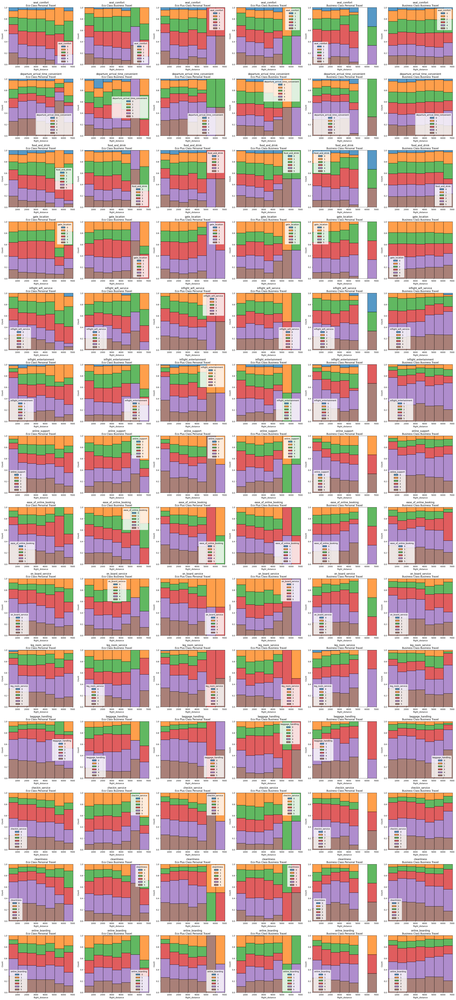

In [227]:
#####################################################################################
#Keep Class and Travel Type constant, rating point ratio by distance
#####################################################################################
fig,axs=plt.subplots(14,6,sharey=False,figsize=(32,70))

hue_order=rating_hue_order
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']

data=data_cat
#mask of class and travel type
mask_eco_personal=(data["class"]=='Eco')&(data["type_of_travel"]=='Personal Travel')
mask_ecoplus_personal=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Personal Travel')
mask_business_personal=(data["class"]=='Business')&(data["type_of_travel"]=='Personal Travel')
mask_eco_business=(data["class"]=='Eco')&(data["type_of_travel"]=='Business Travel')
mask_ecoplus_business=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Business Travel')
mask_business_business=(data["class"]=='Business')&(data["type_of_travel"]=='Business Travel')
for i, var in zip(range(len(rating_list)), rating_list):
    #Eco Class and Personal Travel
    sns.histplot(data=data[mask_eco_personal], x="flight_distance",ax=axs[i][0],hue=var
                 , multiple="fill",binwidth=1000,hue_order=hue_order)
    axs[i][0].set_title(f'{var}\nEco Class Personal Travel')
    #Eco Class and Business Travel
    sns.histplot(data=data[mask_eco_business], x="flight_distance",ax=axs[i][1],hue=var
                 , multiple="fill",binwidth=1000,hue_order=hue_order)
    axs[i][1].set_title(f'{var}\nEco Class Business Travel')
    
    #Eco Plus Class and Personal Travel
    sns.histplot(data=data[mask_ecoplus_personal], x="flight_distance",ax=axs[i][2],hue=var
                 , multiple="fill",binwidth=1000,hue_order=hue_order)
    axs[i][2].set_title(f'{var}\nEco Plus Class Personal Travel')
    #Eco Plus Class and Business Travel
    sns.histplot(data=data[mask_ecoplus_business], x="flight_distance",ax=axs[i][3],hue=var
                 , multiple="fill",binwidth=1000,hue_order=hue_order)
    axs[i][3].set_title(f'{var}\nEco Plus Class Business Travel')
    
    #Business Class and Personal Travel
    sns.histplot(data=data[mask_business_personal], x="flight_distance",ax=axs[i][4],hue=var
                 , multiple="fill",binwidth=1000,hue_order=hue_order)
    axs[i][4].set_title(f'{var}\nBusiness Class Personal Travel')
    #Business Class and Business Travel
    sns.histplot(data=data[mask_business_business], x="flight_distance",ax=axs[i][5],hue=var
                 , multiple="fill",binwidth=1000,hue_order=hue_order)
    axs[i][5].set_title(f'{var}\nBusiness Class Business Travel')

plt.tight_layout()
plt.show()

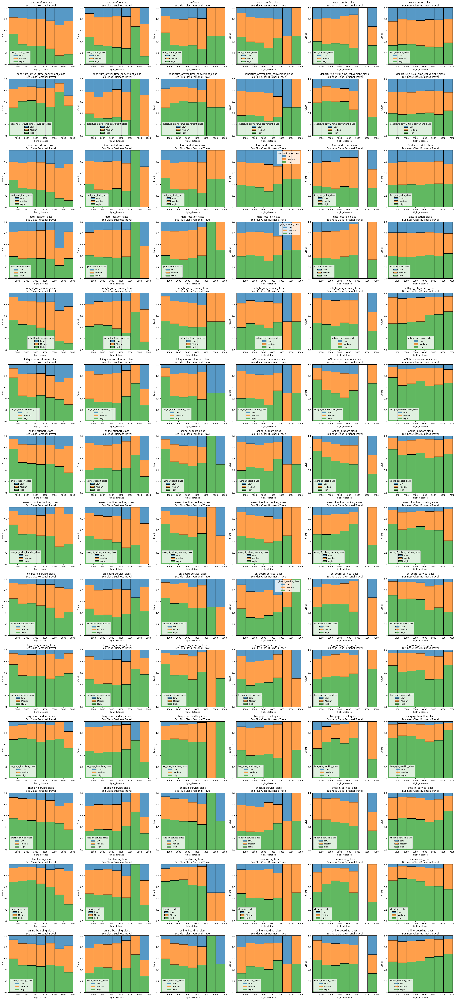

In [228]:
#####################################################################################
#Keep Class and Travel Type constant, rating point ratio by distance
#####################################################################################
fig,axs=plt.subplots(14,6,sharey=False,figsize=(32,70))

hue_order=rating_class_hue_order
rating_list=['seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']

data=data_cat
#mask of class and travel type
mask_eco_personal=(data["class"]=='Eco')&(data["type_of_travel"]=='Personal Travel')
mask_ecoplus_personal=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Personal Travel')
mask_business_personal=(data["class"]=='Business')&(data["type_of_travel"]=='Personal Travel')
mask_eco_business=(data["class"]=='Eco')&(data["type_of_travel"]=='Business Travel')
mask_ecoplus_business=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Business Travel')
mask_business_business=(data["class"]=='Business')&(data["type_of_travel"]=='Business Travel')
for i, var in zip(range(len(rating_list)), rating_list):
    #Eco Class and Personal Travel
    sns.histplot(data=data[mask_eco_personal], x="flight_distance",ax=axs[i][0],hue=var
                 , multiple="fill",binwidth=1000,hue_order=hue_order)
    axs[i][0].set_title(f'{var}\nEco Class Personal Travel')
    #Eco Class and Business Travel
    sns.histplot(data=data[mask_eco_business], x="flight_distance",ax=axs[i][1],hue=var
                 , multiple="fill",binwidth=1000,hue_order=hue_order)
    axs[i][1].set_title(f'{var}\nEco Class Business Travel')
    
    #Eco Plus Class and Personal Travel
    sns.histplot(data=data[mask_ecoplus_personal], x="flight_distance",ax=axs[i][2],hue=var
                 , multiple="fill",binwidth=1000,hue_order=hue_order)
    axs[i][2].set_title(f'{var}\nEco Plus Class Personal Travel')
    #Eco Plus Class and Business Travel
    sns.histplot(data=data[mask_ecoplus_business], x="flight_distance",ax=axs[i][3],hue=var
                 , multiple="fill",binwidth=1000,hue_order=hue_order)
    axs[i][3].set_title(f'{var}\nEco Plus Class Business Travel')
    
    #Business Class and Personal Travel
    sns.histplot(data=data[mask_business_personal], x="flight_distance",ax=axs[i][4],hue=var
                 , multiple="fill",binwidth=1000,hue_order=hue_order)
    axs[i][4].set_title(f'{var}\nBusiness Class Personal Travel')
    #Business Class and Business Travel
    sns.histplot(data=data[mask_business_business], x="flight_distance",ax=axs[i][5],hue=var
                 , multiple="fill",binwidth=1000,hue_order=hue_order)
    axs[i][5].set_title(f'{var}\nBusiness Class Business Travel')

plt.tight_layout()
plt.show()

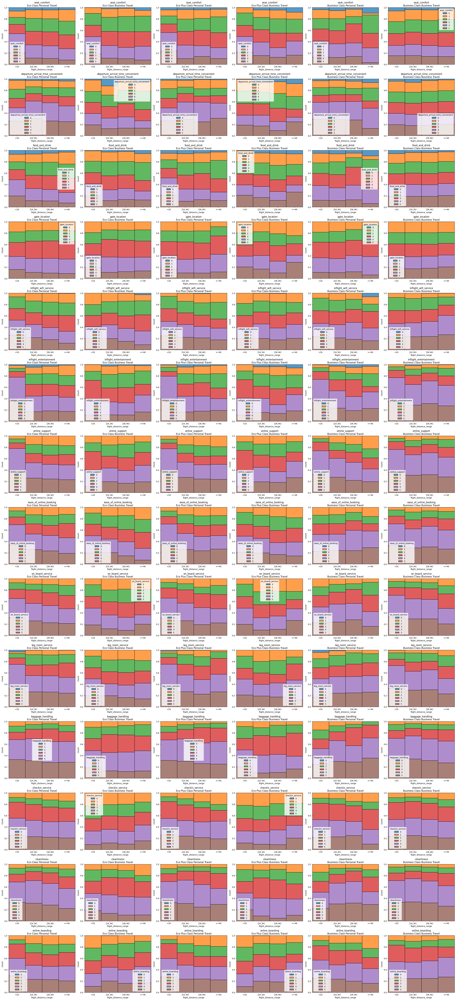

In [229]:
#####################################################################################
#Keep Class and Travel Type constant, rating point ratio by distance range
#####################################################################################
fig,axs=plt.subplots(14,6,sharey=False,figsize=(32,70))

hue_order=rating_hue_order
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']

data=data_cat
#mask of class and travel type
mask_eco_personal=(data["class"]=='Eco')&(data["type_of_travel"]=='Personal Travel')
mask_ecoplus_personal=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Personal Travel')
mask_business_personal=(data["class"]=='Business')&(data["type_of_travel"]=='Personal Travel')
mask_eco_business=(data["class"]=='Eco')&(data["type_of_travel"]=='Business Travel')
mask_ecoplus_business=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Business Travel')
mask_business_business=(data["class"]=='Business')&(data["type_of_travel"]=='Business Travel')
for i, var in zip(range(len(rating_list)), rating_list):
    #Eco Class and Personal Travel
    sns.histplot(data=data[mask_eco_personal], x="flight_distance_range",ax=axs[i][0],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][0].set_title(f'{var}\nEco Class Personal Travel')
    #Eco Class and Business Travel
    sns.histplot(data=data[mask_eco_business], x="flight_distance_range",ax=axs[i][1],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][1].set_title(f'{var}\nEco Class Business Travel')
    
    #Eco Plus Class and Personal Travel
    sns.histplot(data=data[mask_ecoplus_personal], x="flight_distance_range",ax=axs[i][2],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][2].set_title(f'{var}\nEco Plus Class Personal Travel')
    #Eco Plus Class and Business Travel
    sns.histplot(data=data[mask_ecoplus_business], x="flight_distance_range",ax=axs[i][3],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][3].set_title(f'{var}\nEco Plus Class Business Travel')
    
    #Business Class and Personal Travel
    sns.histplot(data=data[mask_business_personal], x="flight_distance_range",ax=axs[i][4],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][4].set_title(f'{var}\nBusiness Class Personal Travel')
    #Business Class and Business Travel
    sns.histplot(data=data[mask_business_business], x="flight_distance_range",ax=axs[i][5],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][5].set_title(f'{var}\nBusiness Class Business Travel')

plt.tight_layout()
plt.show()

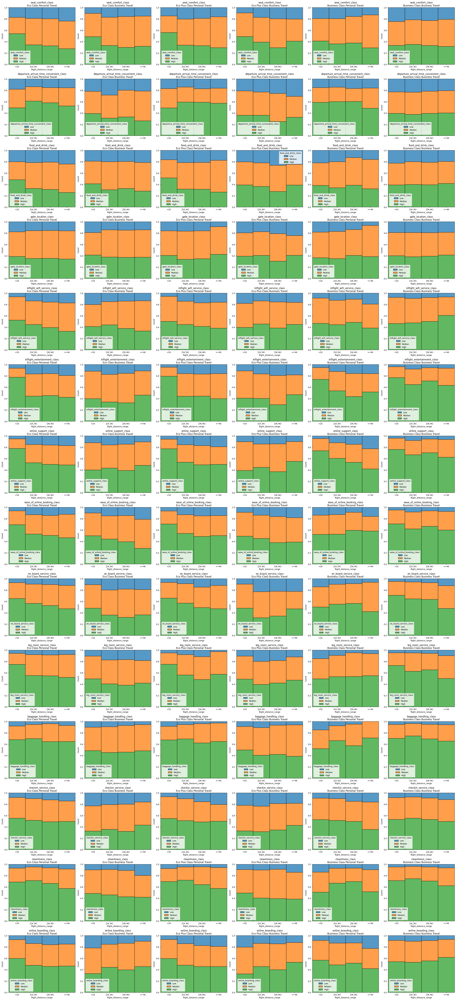

In [230]:
#####################################################################################
#Keep Class and Travel Type constant, rating point ratio by distance range
#####################################################################################
fig,axs=plt.subplots(14,6,sharey=False,figsize=(32,70))

hue_order=rating_class_hue_order
rating_list=['seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']

data=data_cat
#mask of class and travel type
mask_eco_personal=(data["class"]=='Eco')&(data["type_of_travel"]=='Personal Travel')
mask_ecoplus_personal=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Personal Travel')
mask_business_personal=(data["class"]=='Business')&(data["type_of_travel"]=='Personal Travel')
mask_eco_business=(data["class"]=='Eco')&(data["type_of_travel"]=='Business Travel')
mask_ecoplus_business=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Business Travel')
mask_business_business=(data["class"]=='Business')&(data["type_of_travel"]=='Business Travel')
for i, var in zip(range(len(rating_list)), rating_list):
    #Eco Class and Personal Travel
    sns.histplot(data=data[mask_eco_personal], x="flight_distance_range",ax=axs[i][0],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][0].set_title(f'{var}\nEco Class Personal Travel')
    #Eco Class and Business Travel
    sns.histplot(data=data[mask_eco_business], x="flight_distance_range",ax=axs[i][1],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][1].set_title(f'{var}\nEco Class Business Travel')
    
    #Eco Plus Class and Personal Travel
    sns.histplot(data=data[mask_ecoplus_personal], x="flight_distance_range",ax=axs[i][2],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][2].set_title(f'{var}\nEco Plus Class Personal Travel')
    #Eco Plus Class and Business Travel
    sns.histplot(data=data[mask_ecoplus_business], x="flight_distance_range",ax=axs[i][3],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][3].set_title(f'{var}\nEco Plus Class Business Travel')
    
    #Business Class and Personal Travel
    sns.histplot(data=data[mask_business_personal], x="flight_distance_range",ax=axs[i][4],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][4].set_title(f'{var}\nBusiness Class Personal Travel')
    #Business Class and Business Travel
    sns.histplot(data=data[mask_business_business], x="flight_distance_range",ax=axs[i][5],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][5].set_title(f'{var}\nBusiness Class Business Travel')

plt.tight_layout()
plt.show()

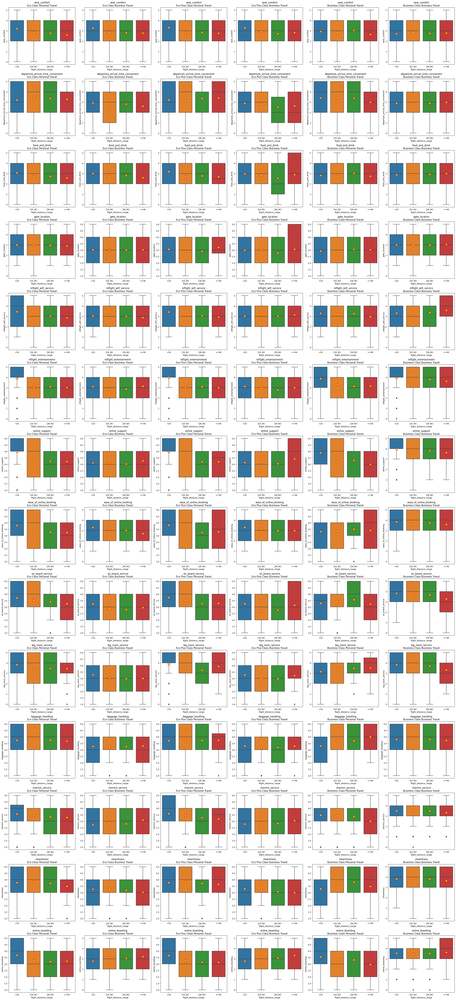

In [231]:
#####################################################################################
#Keep Class and Travel Type constant, rating point ratio by flight_distance_range
#####################################################################################
fig,axs=plt.subplots(14,6,sharey=False,figsize=(32,70))

hue_order=rating_hue_order
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']

data=data_cat
#mask of class and travel type
mask_eco_personal=(data["class"]=='Eco')&(data["type_of_travel"]=='Personal Travel')
mask_ecoplus_personal=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Personal Travel')
mask_business_personal=(data["class"]=='Business')&(data["type_of_travel"]=='Personal Travel')
mask_eco_business=(data["class"]=='Eco')&(data["type_of_travel"]=='Business Travel')
mask_ecoplus_business=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Business Travel')
mask_business_business=(data["class"]=='Business')&(data["type_of_travel"]=='Business Travel')
for i, var in zip(range(len(rating_list)), rating_list):
    #Eco Class and Personal Travel
    sns.boxplot(data=data[mask_eco_personal], x="flight_distance_range",ax=axs[i][0],y=data[var].astype(int),
                showmeans=True,
                meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][0].set_title(f'{var}\nEco Class Personal Travel')
    #Eco Class and Business Travel
    sns.boxplot(data=data[mask_eco_business], x="flight_distance_range",ax=axs[i][1],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][1].set_title(f'{var}\nEco Class Business Travel')
    
    #Eco Plus Class and Personal Travel
    sns.boxplot(data=data[mask_ecoplus_personal], x="flight_distance_range",ax=axs[i][2],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][2].set_title(f'{var}\nEco Plus Class Personal Travel')
    #Eco Plus Class and Business Travel
    sns.boxplot(data=data[mask_ecoplus_business], x="flight_distance_range",ax=axs[i][3],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][3].set_title(f'{var}\nEco Plus Class Business Travel')
    
    #Business Class and Personal Travel
    sns.boxplot(data=data[mask_business_personal], x="flight_distance_range",ax=axs[i][4],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][4].set_title(f'{var}\nBusiness Class Personal Travel')
    #Business Class and Business Travel
    sns.boxplot(data=data[mask_business_business], x="flight_distance_range",ax=axs[i][5],y=data[var].astype(int),
                 showmeans=True,
                 meanprops={"marker": "*",
                       "markeredgecolor": "red",
                       "markerfacecolor": "yellow",
                       "markersize": "16"} )
    axs[i][5].set_title(f'{var}\nBusiness Class Business Travel')

plt.tight_layout()
plt.show()

In [232]:
data_cat.groupby(['type_of_travel','class','age_range'])['departure_delay_in_minutes'].describe()

count       mean        std  min  25%  \
type_of_travel  class    age_range                                            
Personal Travel Eco      <10         1543.0  15.086844  48.246962  0.0  0.0   
                         [10,20)     5264.0  15.115122  38.509777  0.0  0.0   
                         [20,30)     5166.0  14.194348  33.992804  0.0  0.0   
                         [30,40)     5143.0  14.654287  39.108341  0.0  0.0   
                         [40,50)     5145.0  14.331973  43.944421  0.0  0.0   
                         [50,60)     5128.0  13.564353  34.697879  0.0  0.0   
                         [60,70)     5111.0  14.184308  34.847704  0.0  0.0   
                         >=70         505.0  13.021782  32.864403  0.0  0.0   
                Eco Plus <10          227.0  11.837004  28.077561  0.0  0.0   
                         [10,20)      702.0  13.076923  27.609201  0.0  0.0   
                         [20,30)      663.0  12.070890  31.316426  0.0  0.0   
                         [30,40)      711.0  15.843882  40.437217  0.0  0.0   
                         [40,50)      695.0  13.335252  34.488458  0.0  0.0   
                         [50,60)      733.0  14.972715  31.463212  0.0  0.0   
                         [60,70)      704.0  16.532670  43.400763  0.0  0.0   
                         >=70          74.0  11.635135  22.581102  0.0  0.0   
                Business <10          122.0  17.114754  35.231747  0.0  0.0   
                         [10,20)      412.0  16.099515  39.678174  0.0  0.0   
                         [20,30)      412.0  12.786408  29.871469  0.0  0.0   
                         [30,40)      417.0  14.220624  31.239833  0.0  0.0   
                         [40,50)      423.0  16.877069  52.898311  0.0  0.0   
                         [50,60)      423.0  14.924350  37.046134  0.0  0.0   
                         [60,70)      420.0  14.280952  30.522141  0.0  0.0   
                         >=70          44.0  14.295455  29.805243  0.0  0.0   
Business Travel Eco      <10          218.0  18.261468  43.863955  0.0  0.0   
                         [10,20)     1689.0  16.529307  38.363848  0.0  0.0   
                         [20,30)     8739.0  16.044399  40.020461  0.0  0.0   
                         [30,40)     5219.0  16.077793  41.134283  0.0  0.0   
                         [40,50)     4739.0  16.020468  38.516855  0.0  0.0   
                         [50,60)     3279.0  15.732540  37.760236  0.0  0.0   
                         [60,70)     1090.0  14.392661  32.610340  0.0  0.0   
                         >=70         331.0  19.329305  49.638728  0.0  0.0   
                Eco Plus <10           47.0  26.808511  48.771267  0.0  0.0   
                         [10,20)      294.0  17.017007  41.294287  0.0  0.0   
                         [20,30)     1125.0  15.656889  37.093221  0.0  0.0   
                         [30,40)     1346.0  14.893759  32.982747  0.0  0.0   
                         [40,50)      915.0  17.712568  41.326493  0.0  0.0   
                         [50,60)      697.0  15.979914  40.590040  0.0  0.0   
                         [60,70)      334.0  16.101796  38.953986  0.0  0.0   
                         >=70         144.0  12.472222  27.310426  0.0  0.0   
                Business <10          184.0  10.092391  25.702951  0.0  0.0   
                         [10,20)     1478.0  15.210419  46.675906  0.0  0.0   
                         [20,30)    10074.0  14.668156  37.911002  0.0  0.0   
                         [30,40)    12868.0  14.414827  39.168859  0.0  0.0   
                         [40,50)    17719.0  14.570348  39.004637  0.0  0.0   
                         [50,60)    13706.0  13.504305  33.918358  0.0  0.0   
                         [60,70)     2826.0  14.377212  34.997344  0.0  0.0   
                         >=70         632.0  12.164557  34.701509  0.0  0.0   

                                    50%    75%     max  
type_of_travel  class    age_r

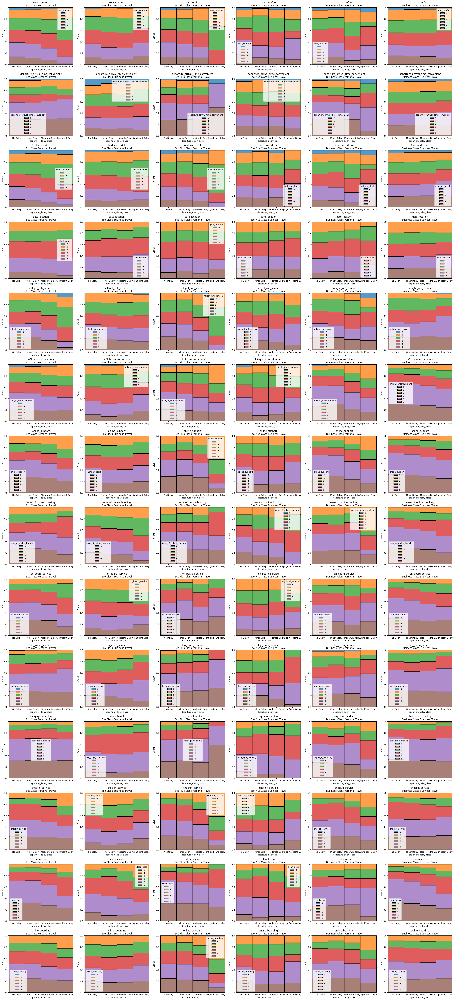

In [233]:
#####################################################################################
#Keep Class and Travel Type constant, rating point ratio by departure_delay_class
#####################################################################################
fig,axs=plt.subplots(14,6,sharey=False,figsize=(32,70))

hue_order=rating_hue_order
rating_list=['seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding']

data=data_cat
#mask of class and travel type
mask_eco_personal=(data["class"]=='Eco')&(data["type_of_travel"]=='Personal Travel')
mask_ecoplus_personal=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Personal Travel')
mask_business_personal=(data["class"]=='Business')&(data["type_of_travel"]=='Personal Travel')
mask_eco_business=(data["class"]=='Eco')&(data["type_of_travel"]=='Business Travel')
mask_ecoplus_business=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Business Travel')
mask_business_business=(data["class"]=='Business')&(data["type_of_travel"]=='Business Travel')
for i, var in zip(range(len(rating_list)), rating_list):
    #Eco Class and Personal Travel
    sns.histplot(data=data[mask_eco_personal], x="departure_delay_class",ax=axs[i][0],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][0].set_title(f'{var}\nEco Class Personal Travel')
    #Eco Class and Business Travel
    sns.histplot(data=data[mask_eco_business], x="departure_delay_class",ax=axs[i][1],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][1].set_title(f'{var}\nEco Class Business Travel')
    
    #Eco Plus Class and Personal Travel
    sns.histplot(data=data[mask_ecoplus_personal], x="departure_delay_class",ax=axs[i][2],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][2].set_title(f'{var}\nEco Plus Class Personal Travel')
    #Eco Plus Class and Business Travel
    sns.histplot(data=data[mask_ecoplus_business], x="departure_delay_class",ax=axs[i][3],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][3].set_title(f'{var}\nEco Plus Class Business Travel')
    
    #Business Class and Personal Travel
    sns.histplot(data=data[mask_business_personal], x="departure_delay_class",ax=axs[i][4],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][4].set_title(f'{var}\nBusiness Class Personal Travel')
    #Business Class and Business Travel
    sns.histplot(data=data[mask_business_business], x="departure_delay_class",ax=axs[i][5],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][5].set_title(f'{var}\nBusiness Class Business Travel')

plt.tight_layout()
plt.show()

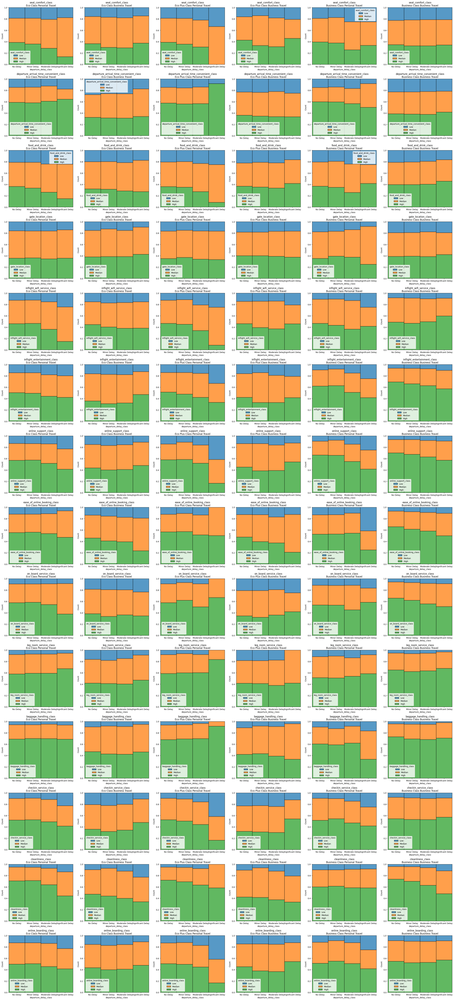

In [234]:
#####################################################################################
#Keep Class and Travel Type constant, rating point ratio by departure_delay_class
#####################################################################################
fig,axs=plt.subplots(14,6,sharey=False,figsize=(32,70))

hue_order=rating_class_hue_order
rating_list=['seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']

data=data_cat
#mask of class and travel type
mask_eco_personal=(data["class"]=='Eco')&(data["type_of_travel"]=='Personal Travel')
mask_ecoplus_personal=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Personal Travel')
mask_business_personal=(data["class"]=='Business')&(data["type_of_travel"]=='Personal Travel')
mask_eco_business=(data["class"]=='Eco')&(data["type_of_travel"]=='Business Travel')
mask_ecoplus_business=(data["class"]=='Eco Plus')&(data["type_of_travel"]=='Business Travel')
mask_business_business=(data["class"]=='Business')&(data["type_of_travel"]=='Business Travel')
for i, var in zip(range(len(rating_list)), rating_list):
    #Eco Class and Personal Travel
    sns.histplot(data=data[mask_eco_personal], x="departure_delay_class",ax=axs[i][0],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][0].set_title(f'{var}\nEco Class Personal Travel')
    #Eco Class and Business Travel
    sns.histplot(data=data[mask_eco_business], x="departure_delay_class",ax=axs[i][1],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][1].set_title(f'{var}\nEco Class Business Travel')
    
    #Eco Plus Class and Personal Travel
    sns.histplot(data=data[mask_ecoplus_personal], x="departure_delay_class",ax=axs[i][2],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][2].set_title(f'{var}\nEco Plus Class Personal Travel')
    #Eco Plus Class and Business Travel
    sns.histplot(data=data[mask_ecoplus_business], x="departure_delay_class",ax=axs[i][3],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][3].set_title(f'{var}\nEco Plus Class Business Travel')
    
    #Business Class and Personal Travel
    sns.histplot(data=data[mask_business_personal], x="departure_delay_class",ax=axs[i][4],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][4].set_title(f'{var}\nBusiness Class Personal Travel')
    #Business Class and Business Travel
    sns.histplot(data=data[mask_business_business], x="departure_delay_class",ax=axs[i][5],hue=var
                 , multiple="fill",discrete=True,hue_order=hue_order)
    axs[i][5].set_title(f'{var}\nBusiness Class Business Travel')

plt.tight_layout()
plt.show()

## 12 Inflight entertainment

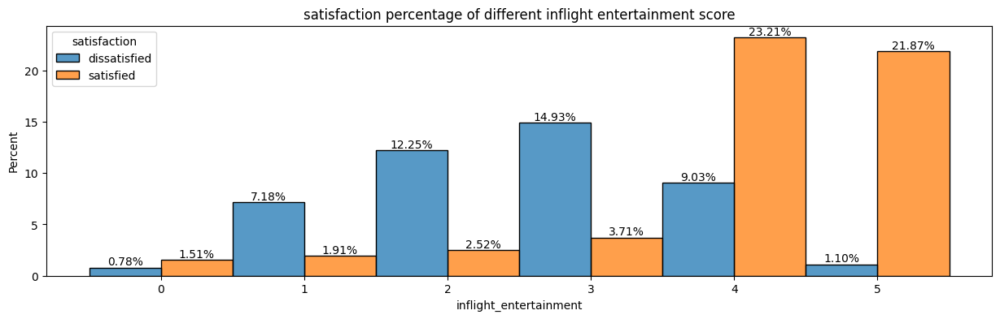

In [235]:
#################################################
#Inflight_entertainment
#################################################
ax=sns.histplot(
    data=data_cat, x="inflight_entertainment", hue="satisfaction", 
    palette='tab10',
    discrete=True,multiple='dodge',stat='percent'
)
for i in ax.containers:
    ax.bar_label(i,fmt='%.2f%%')
plt.title('satisfaction percentage of different inflight entertainment score')
plt.show()


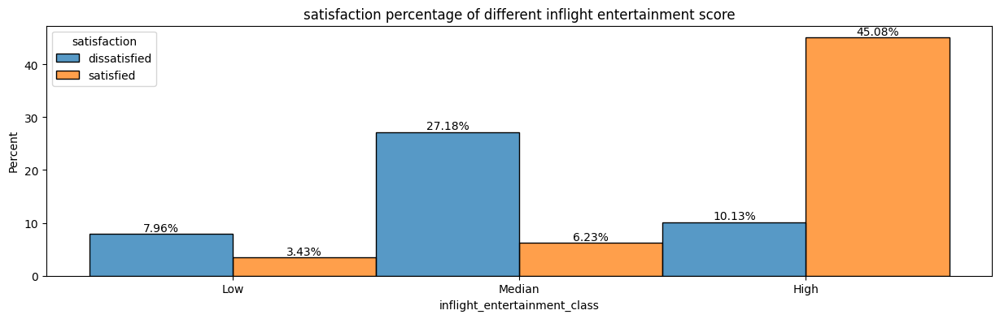

In [236]:
#################################################
#Inflight_entertainment_class
#################################################
ax=sns.histplot(
    data=data_cat, x="inflight_entertainment_class", hue="satisfaction", 
    palette='tab10',
    discrete=True,multiple='dodge',stat='percent'
)
for i in ax.containers:
    ax.bar_label(i,fmt='%.2f%%')
plt.title('satisfaction percentage of different inflight entertainment score')
plt.show()

inflight_entertainment_class,satisfaction,Low,Median,High
0,dissatisfied,10337,35297,13159
1,satisfied,4450,8086,58551


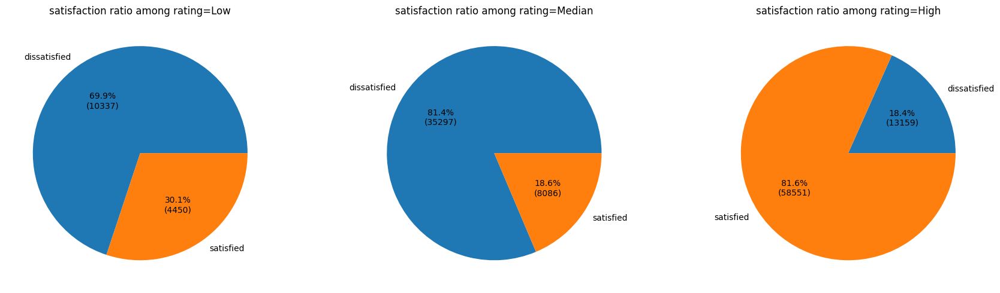

In [237]:
###############################################################
#pie plot
#satisfaction proportion of different Inflight_entertainment_class
###############################################################
result=pd.crosstab(data_cat['satisfaction'],data_cat['inflight_entertainment_class'],margins=False).reset_index()

display(result)
col_nm=rating_class_hue_order

#######################################
#Pie Chart
#######################################
colCnt=3
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(colCnt*6,rowCnt*5))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["satisfaction"], autopct=autopct_format(result[col]))
    ax.set_title(f"satisfaction ratio among rating={col}")
plt.tight_layout()
plt.show()

inflight_entertainment_class,class,Low,Median,High
0,Eco,9109,23945,25255
1,Eco Plus,1427,3763,4221
2,Business,4251,15675,42234


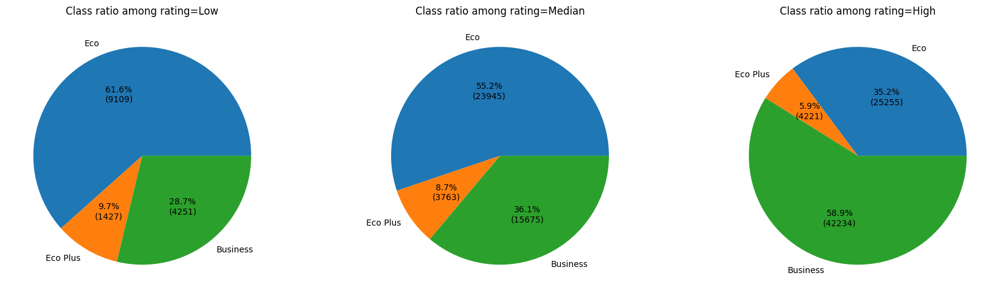

In [238]:
###############################################################
#pie plot
#Class proportion of different Inflight_entertainment_class
###############################################################
result=pd.crosstab(data_cat['class'],data_cat['inflight_entertainment_class'],margins=False).reset_index()

display(result)
col_nm=rating_class_hue_order

#######################################
#Pie Chart
#######################################
colCnt=3
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(colCnt*6,rowCnt*5))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["class"], autopct=autopct_format(result[col]))
    ax.set_title(f"Class ratio among rating={col}")
plt.tight_layout()
plt.show()
#=>Class ratio among each rating group seems vary a lot, it's difficult to say which factor contributes more to satisfaction

inflight_entertainment_class,customer_type,Low,Median,High
0,Disloyal Customer,4740,11884,7156
1,Loyal Customer,10047,31499,64554


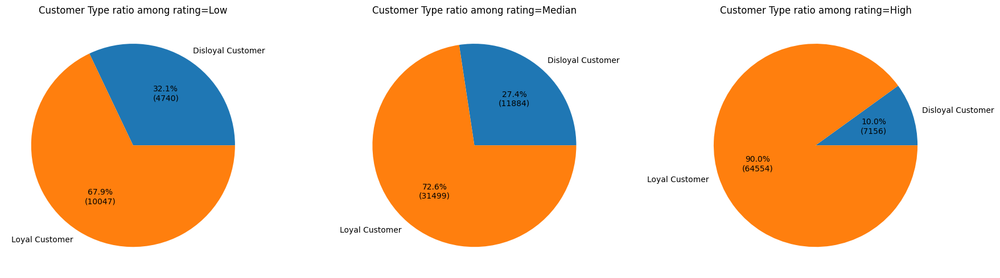

In [239]:
###############################################################
#pie plot
#customer_type proportion of different Inflight_entertainment_class
###############################################################
result=pd.crosstab(data_cat['customer_type'],data_cat['inflight_entertainment_class'],margins=False).reset_index()

display(result)
col_nm=rating_class_hue_order

#######################################
#Pie Chart
#######################################
colCnt=3
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(colCnt*6,rowCnt*5))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["customer_type"], autopct=autopct_format(result[col]))
    ax.set_title(f"Customer Type ratio among rating={col}")
plt.tight_layout()
plt.show()
#=>Customer Type ratio vary a lot

inflight_entertainment_class,type_of_travel,Low,Median,High
0,Personal Travel,5831,13983,20373
1,Business Travel,8956,29400,51337


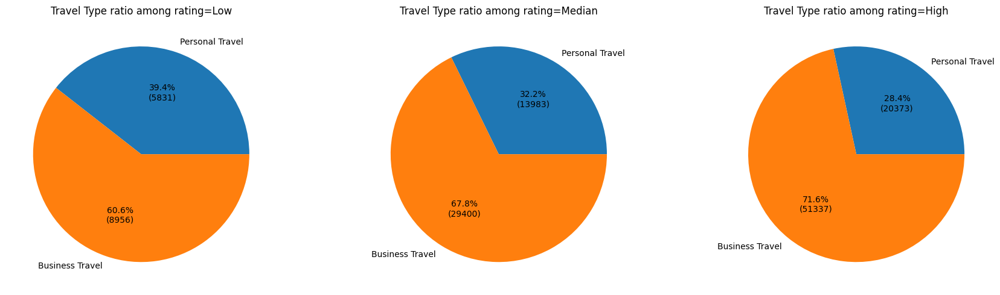

In [240]:
###############################################################
#pie plot
#type_of_travel proportion of different Inflight_entertainment_class
###############################################################
result=pd.crosstab(data_cat['type_of_travel'],data_cat['inflight_entertainment_class'],margins=False).reset_index()

display(result)
col_nm=rating_class_hue_order

#######################################
#Pie Chart
#######################################
colCnt=3
rowCnt=math.ceil(len(col_nm)/colCnt)

fig, axs = plt.subplots(rowCnt,colCnt,figsize=(colCnt*6,rowCnt*5))
for col,ax in zip(col_nm,axs.ravel()):
    ax.pie(result[col],labels = result["type_of_travel"], autopct=autopct_format(result[col]))
    ax.set_title(f"Travel Type ratio among rating={col}")
plt.tight_layout()
plt.show()
#=>Travel type ratio among each rating group seems no big difference(the ratio of business travel become smaller)

$H_0$: The proportion of Business Travel passengers is equal on any given Inflight entertainment class<BR>
$H_A$: The proportion of Business Travel passengers is not equal on any given Inflight entertainment class
    
significance level 0.05

In [241]:
#stats.chisquare

data=data_cat
business_ratio=data[data['type_of_travel']=='Business Travel']['satisfaction'].count()/data.shape[0]
print(f'business travel ratio of total sample: {business_ratio}')
result=pd.crosstab(data['type_of_travel'], data['inflight_entertainment_class'],margins=True).reset_index()
col_nm=data['inflight_entertainment_class'].unique().tolist()

mask_business=result['type_of_travel']=='Business Travel'
mask_all=result['type_of_travel']=='All'
observations=result[mask_business][col_nm].iloc[0].to_list()
expectations = (result[mask_all][col_nm]*business_ratio).iloc[0].to_list()
print(f'observations:{observations} \nexpectations:{expectations}')
chi_result = stats.chisquare(f_obs=observations, f_exp=expectations)
if chi_result.pvalue < 0.05:
    print('Reject H0')
else:
    print('Fail to reject H0')
print(chi_result)
#=>Reject H0
result

business travel ratio of total sample: 0.690583615645211
observations:[51337, 29400, 8956] 
expectations:[49521.75107791808, 29959.58899753619, 10211.659924545735]
Reject H0
Power_divergenceResult(statistic=231.39124356868683, pvalue=5.675836528190904e-51)


inflight_entertainment_class,type_of_travel,Low,Median,High,All
0,Personal Travel,5831,13983,20373,40187
1,Business Travel,8956,29400,51337,89693
2,All,14787,43383,71710,129880


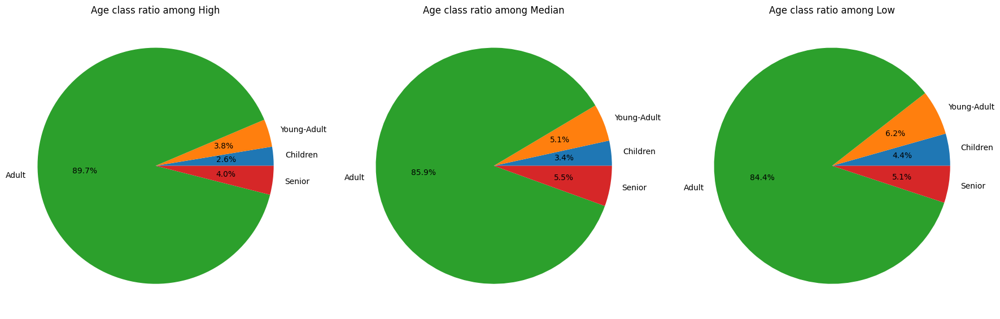

In [242]:
###############################################################
#pie plot
#age_class_by_airline proportion of different Inflight_entertainment_class
###############################################################
fig,axs=plt.subplots(1,3,sharey=False,figsize=(18,6))
rating_list=['inflight_entertainment_class']
target_data=data_cat
col_item=target_data['inflight_entertainment_class'].tolist()
result=pd.crosstab(target_data['age_class_by_airline'],target_data['inflight_entertainment_class'],normalize='columns',margins=True).reset_index()
for col,ax in zip(col_item,axs.ravel()):
    ax.pie(result[col],labels = result["age_class_by_airline"], autopct='%1.1f%%')
    ax.set_title(f'Age class ratio among {col}')
plt.tight_layout()
plt.show()
#=>Age class ratio of each rating group seems no big difference(the ratio of adult become smaller)

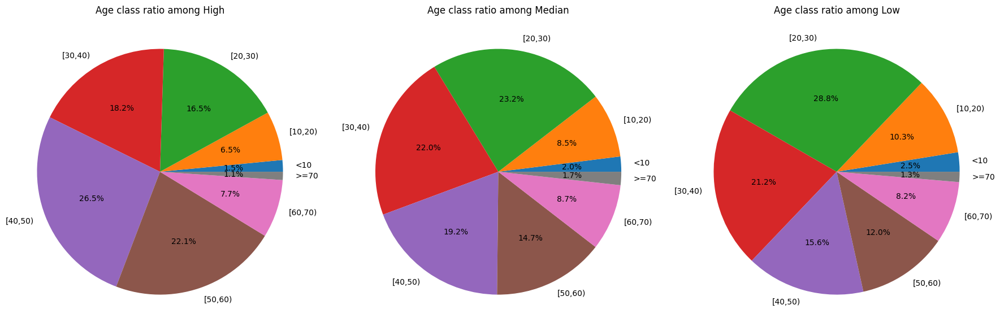

In [243]:
###############################################################
#pie plot
#age_range proportion of different Inflight_entertainment_class
###############################################################
fig,axs=plt.subplots(1,3,sharey=False,figsize=(18,6))
rating_list=['inflight_entertainment_class']
target_data=data_cat
col_item=target_data['inflight_entertainment_class'].tolist()
result=pd.crosstab(target_data['age_range'],target_data['inflight_entertainment_class'],normalize='columns',margins=True).reset_index()
for col,ax in zip(col_item,axs.ravel()):
    ax.pie(result[col],labels = result["age_range"], autopct='%1.1f%%')
    ax.set_title(f'Age class ratio among {col}')
plt.tight_layout()
plt.show()
#=>among High rating class, there are more passengers 30-60
#=>among Low and Median rating class, there are less passengers 30-60, more passengers under 30
#=>it's difficult to say which factor contributes more to satisfaction

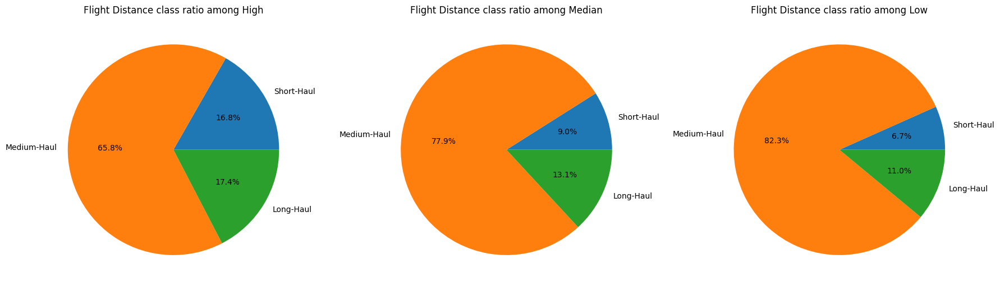

In [244]:
###############################################################
#pie plot
#flight_distance_class proportion of different Inflight_entertainment_class
###############################################################
fig,axs=plt.subplots(1,3,sharey=False,figsize=(18,6))
rating_list=['inflight_entertainment_class']
target_data=data_cat
col_item=target_data['inflight_entertainment_class'].tolist()
result=pd.crosstab(target_data['flight_distance_class'],target_data['inflight_entertainment_class'],normalize='columns',margins=True).reset_index()
for col,ax in zip(col_item,axs.ravel()):
    ax.pie(result[col],labels = result["flight_distance_class"], autopct='%1.1f%%')
    ax.set_title(f'Flight Distance class ratio among {col}')
plt.tight_layout()
plt.show()
#rating Low->High, Medium-Haul ratio decrease, Long-Haul and Short-Haul increase

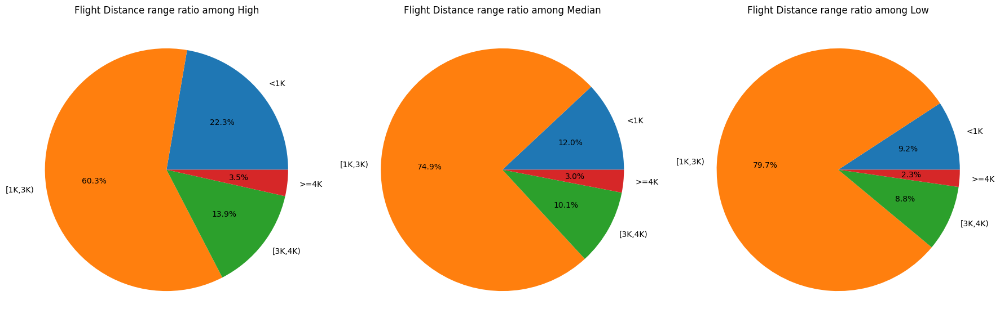

In [245]:
###############################################################
#pie plot
#flight_distance_range proportion of different Inflight_entertainment_class
###############################################################
fig,axs=plt.subplots(1,3,sharey=False,figsize=(18,6))
rating_list=['inflight_entertainment_class']
target_data=data_cat
col_item=target_data['inflight_entertainment_class'].tolist()
result=pd.crosstab(target_data['flight_distance_range'],target_data['inflight_entertainment_class'],normalize='columns',margins=True).reset_index()
for col,ax in zip(col_item,axs.ravel()):
    ax.pie(result[col],labels = result["flight_distance_range"], autopct='%1.1f%%')
    ax.set_title(f'Flight Distance range ratio among {col}')
plt.tight_layout()
plt.show()

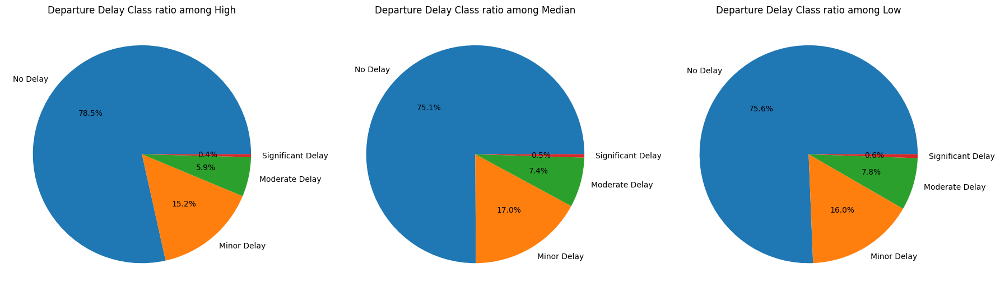

In [246]:
###############################################################
#pie plot
#departure_delay_class proportion of different Inflight_entertainment_class
###############################################################
fig,axs=plt.subplots(1,3,sharey=False,figsize=(18,6))
rating_list=['inflight_entertainment_class']
target_data=data_cat
col_item=target_data['inflight_entertainment_class'].tolist()
result=pd.crosstab(target_data['departure_delay_class'],target_data['inflight_entertainment_class'],normalize='columns',margins=True).reset_index()
for col,ax in zip(col_item,axs.ravel()):
    ax.pie(result[col],labels = result["departure_delay_class"], autopct='%1.1f%%')
    ax.set_title(f'Departure Delay Class ratio among {col}')
plt.tight_layout()
plt.show()
#rating low->high, no delay ratio decrease

In [247]:
data=data_cat
#data=data_cat.sample(n=5000, replace=True, random_state=RANDOM_STATE)
nodelay_ratio=data[data['departure_delay_class']=='No Delay']['satisfaction'].count()/data.shape[0]
print(f'no delay ratio of total sample: {nodelay_ratio}')
result=pd.crosstab(data['departure_delay_class'], data['inflight_entertainment_class'],margins=True).reset_index()
col_nm=data['inflight_entertainment_class'].unique().tolist()

mask_nodelay=result['departure_delay_class']=='No Delay'
mask_all=result['departure_delay_class']=='All'
observations=result[mask_nodelay][col_nm].iloc[0].to_list()
expectations = (result[mask_all][col_nm]*nodelay_ratio).iloc[0].to_list()
print(f'observations:{observations} \nexpectations:{expectations}')
chi_result = stats.chisquare(f_obs=observations, f_exp=expectations)
if chi_result.pvalue < 0.05:
    print('Reject H0')
else:
    print('Fail to reject H0')
print(chi_result)
#=>Reject H0
result

no delay ratio of total sample: 0.7702494610409609
observations:[56281, 32573, 11186] 
expectations:[55234.58885124731, 33415.73236834001, 11389.678780412689]
Reject H0
Power_divergenceResult(statistic=44.719839363975375, pvalue=1.946302167569004e-10)


inflight_entertainment_class,departure_delay_class,Low,Median,High,All
0,No Delay,11186,32573,56281,100040
1,Minor Delay,2368,7386,10918,20672
2,Moderate Delay,1148,3210,4213,8571
3,Significant Delay,85,214,298,597
4,All,14787,43383,71710,129880


### Keep Class and Travel Type constant, confirm Inflight entertainment

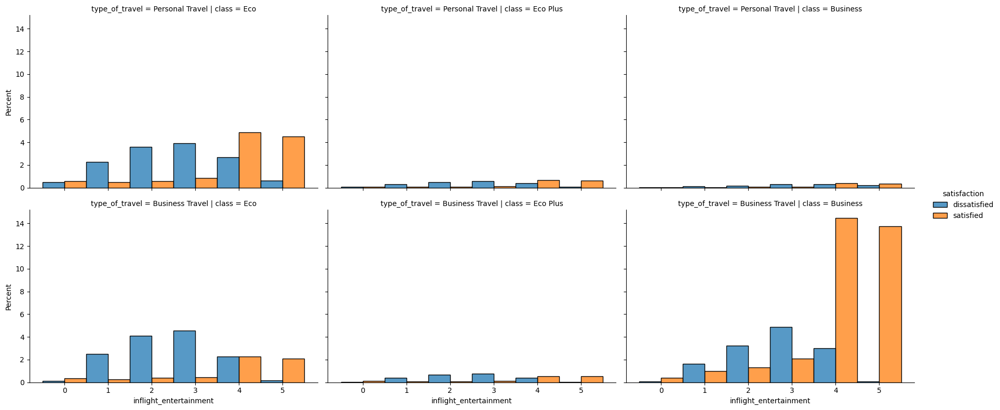

In [248]:
########################################################
#satisfaction count of Inflight_entertainment
#Keep Class and travel type constant
########################################################
sns.displot(
    data=data_cat, x="inflight_entertainment", hue="satisfaction", 
    hue_order=satisfaction_hue_order,
    row="type_of_travel",col="class",
    facet_kws={"sharey": True,"sharex": True},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='dodge',stat='percent'
)
plt.show()


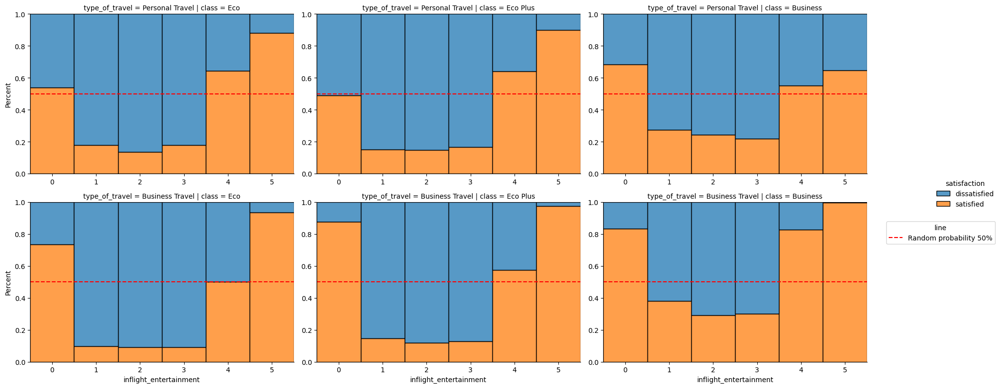

In [249]:
#################################################
#satisfaction ratio of Inflight_entertainment
#Keep Class and travel type constant
#################################################
g=sns.displot(
    data=data_cat, x="inflight_entertainment", hue="satisfaction", 
    legend=True,
    hue_order=satisfaction_hue_order,
    row="type_of_travel",col="class",
    facet_kws={"sharey": False,"sharex": False},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='fill',stat='percent'
)

g.refline(y=0.5,color="red",linestyle="--",label="Random probability 50%")
plt.legend(title='line',loc='upper right', bbox_to_anchor=(1.5, 0.9))
plt.show()

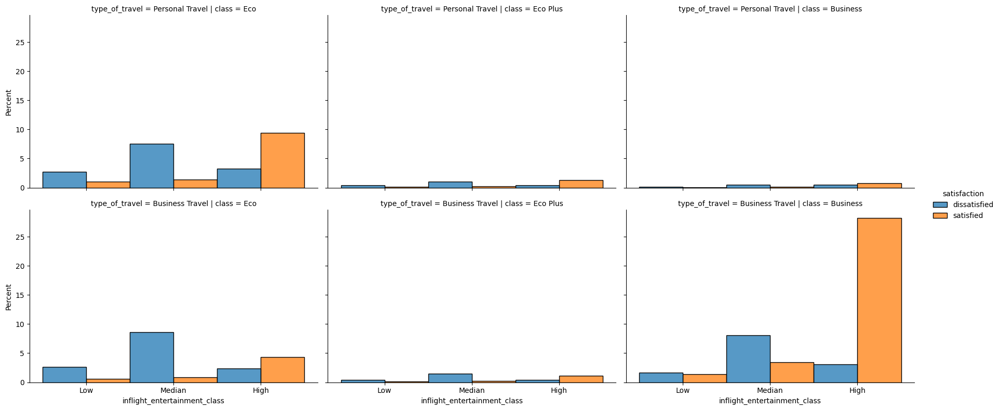

In [250]:
#####################################################
#satisfaction count of Inflight_entertainment_class
#Keep Class and travel type constant
#####################################################
sns.displot(
    data=data_cat, x="inflight_entertainment_class", hue="satisfaction", 
    hue_order=satisfaction_hue_order,
    row="type_of_travel",col="class",
    facet_kws={"sharey": True,"sharex": True},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='dodge',stat='percent'
)
plt.show()

#=>About satisfaction we can observe the same trend, as score went high(Low->Median->High) satisfaction increased
#=>About dissatisfaction except personal trip business class, others showed similar trend, Median was the highest
#for personal trip business class dissatisfaction increased as score went high(Low->Median->High)

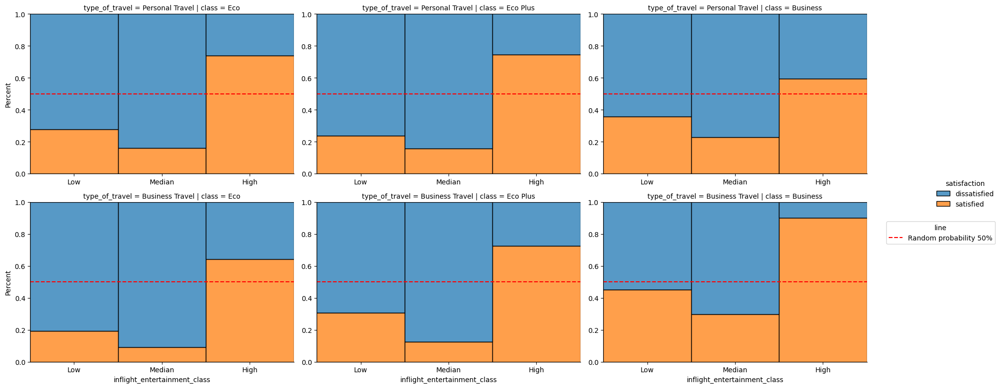

In [251]:
#################################################
#satisfaction ratio of Inflight_entertainment_class
#Keep Class and travel type constant
#################################################
g=sns.displot(
    data=data_cat, x="inflight_entertainment_class", hue="satisfaction", 
    hue_order=satisfaction_hue_order,
    row="type_of_travel",col="class",
    facet_kws={"sharey": False,"sharex": False},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='fill',stat='percent'
)


g.refline(y=0.5,color="red",linestyle="--",label="Random probability 50%")
plt.legend(title='line',loc='upper right', bbox_to_anchor=(1.5, 0.9))
plt.show()

#=>while keep class and travel type constant, 
#=>Medium score had the least satisfied ratio
#=>High score had the highest satisfied ratio

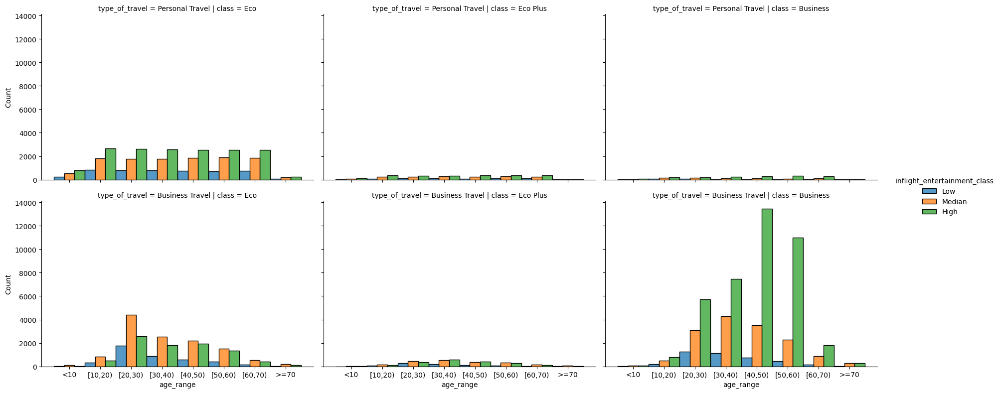

In [252]:
#################################################
#age_range count of Inflight_entertainment
#Keep Class and travel type constant
#################################################
g=sns.displot(
    data=data_cat, x="age_range", hue="inflight_entertainment_class", 
    row="type_of_travel",col="class",
    facet_kws={"sharey": True,"sharex": True},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='dodge',stat='count'
)
plt.show()
#=>most of the samples were business trip
#=>among personal trip, most of them were Eco Class

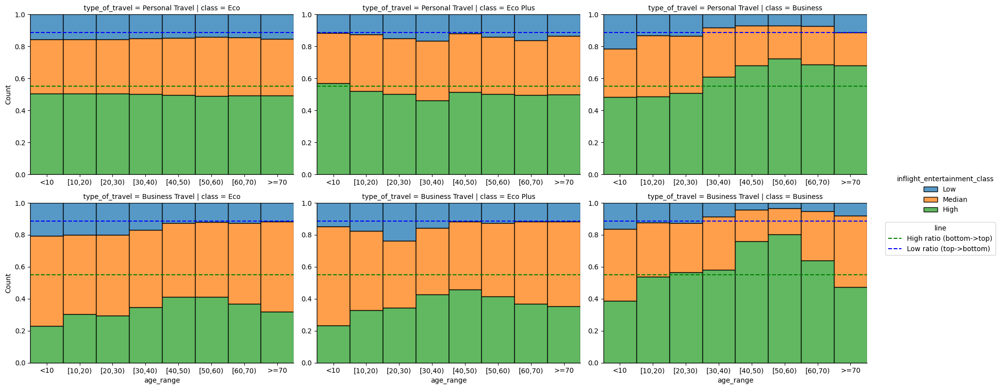

In [253]:
#################################################
#age_range ratio of Inflight_entertainment
#Keep Class and travel type constant
#################################################
g=sns.displot(
    data=data_cat, x="age_range", hue="inflight_entertainment_class", 
    row="type_of_travel",col="class",
    facet_kws={"sharey": False,"sharex": False},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='fill',stat='count'
)

low_ratio,high_ratio=cal_rating_class_ratio('inflight_entertainment_class',data_cat)
g.refline(y=high_ratio,color="green",linestyle="--",label="High ratio (bottom->top)")
g.refline(y=1-low_ratio,color="blue",linestyle="--",label="Low ratio (top->bottom)")
plt.legend(title='line',loc='upper right', bbox_to_anchor=(1.5, 0.9))

plt.show()

#=>For Eco and Eco Plus class, High score ratio were less than total sample
#=>For Business class, High score ratio were higher than total sample among some age groups
#=>Among personal travel,
#  High score ratio of Eco and Eco Plus class: minor change acorss different age group
#  High score ratio of Business class: increase from [30,40), peak at [50,60) then decrease
#=>Among business travel,
#  High score ratio of Eco and Eco Plus class: increase from <10, peak at [40,50) then decrease
#  High score ratio of Business class: increase from <10, peak at [50,60) then decrease

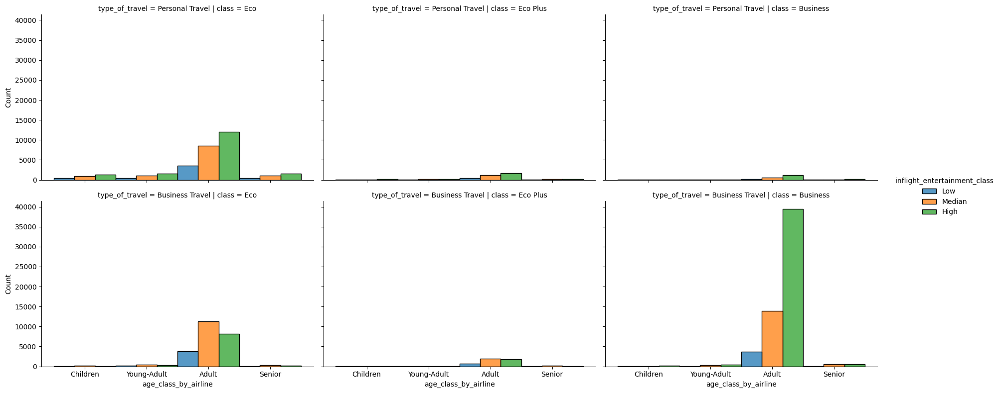

In [254]:
#################################################
#age_class_by_airline count of Inflight_entertainment_class
#Keep Class and travel type constant
#################################################
g=sns.displot(
    data=data_cat, x="age_class_by_airline", hue="inflight_entertainment_class", 
    row="type_of_travel",col="class",
    facet_kws={"sharey": True,"sharex": True},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='dodge',stat='count'
)
plt.show()

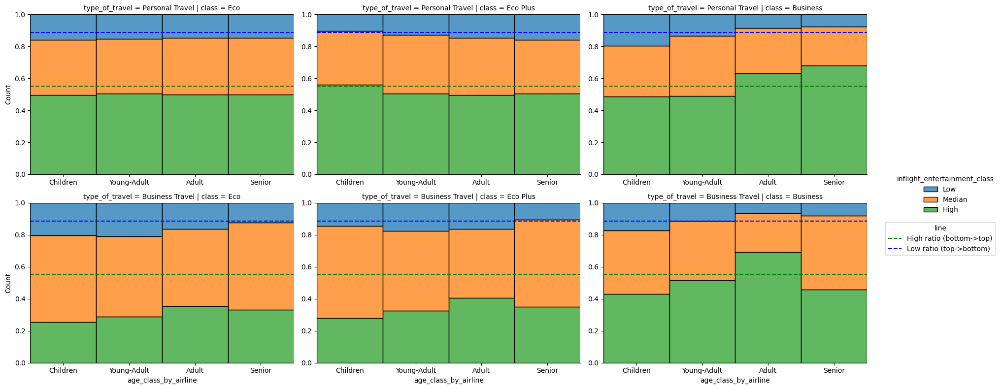

In [255]:
#################################################
#age_class_by_airline ratio of Inflight_entertainment_class
#Keep Class and travel type constant
#################################################
g=sns.displot(
    data=data_cat, x="age_class_by_airline", hue="inflight_entertainment_class", 
    row="type_of_travel",col="class",
    facet_kws={"sharey": False,"sharex": False},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='fill',stat='count'
)

low_ratio,high_ratio=cal_rating_class_ratio('inflight_entertainment_class',data_cat)
g.refline(y=high_ratio,color="green",linestyle="--",label="High ratio (bottom->top)")
g.refline(y=1-low_ratio,color="blue",linestyle="--",label="Low ratio (top->bottom)")
plt.legend(title='line',loc='upper right', bbox_to_anchor=(1.5, 0.9))

plt.show()
#=>Age was associated with trip distance in this dataset
#=>passenger more than 40 tend to have less Mid/Long-Haul trips and more Short-Haul
#==>High Inflight_entertainment score might indecate they really like it or it's not an important factor to them or something else made them satisfied so they gave High score

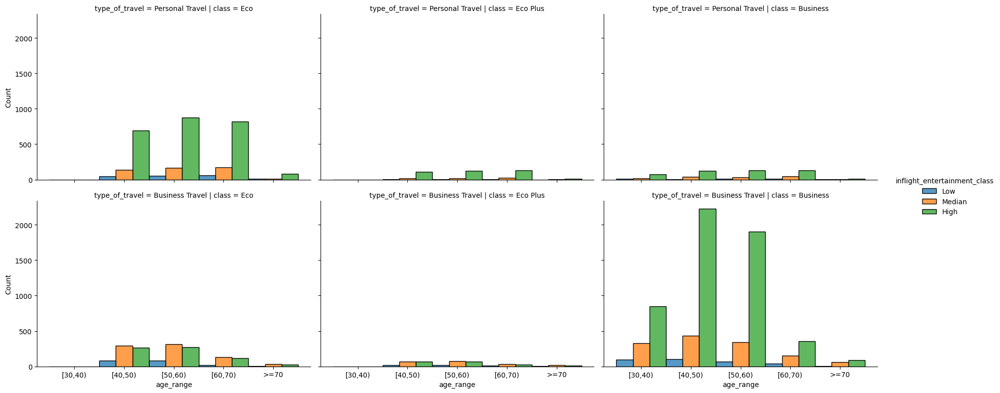

In [256]:
#################################################
#age_range count of Inflight_entertainment_class
#Keep Class ,travel type, trip distance,Departure_Delay constant
#trip distance Short-Haul
#No Delay
#################################################
mask=(data_cat['flight_distance_class']=='Short-Haul')&(data_cat['departure_delay_class']=='No Delay')
target_data=data_cat[mask]
g=sns.displot(
    data=target_data, x="age_range", hue="inflight_entertainment_class", 
    row="type_of_travel",col="class",
    facet_kws={"sharey": True,"sharex": True},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='dodge',stat='count'
)
plt.show()

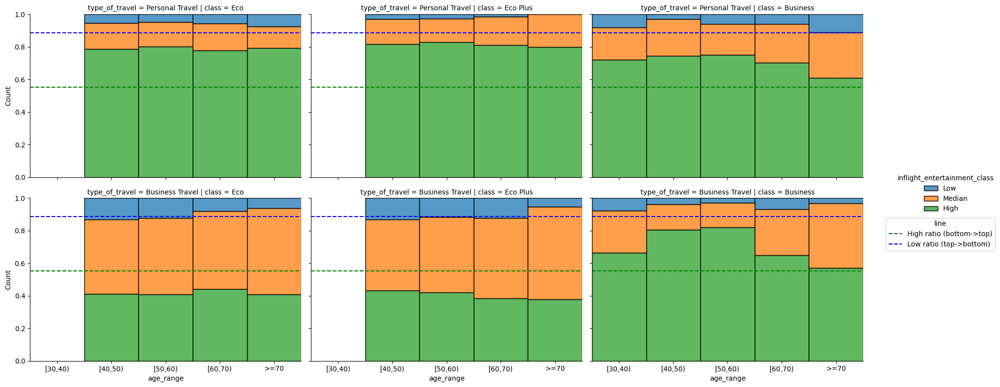

In [257]:
#################################################
#age_range ratio of Inflight_entertainment_class
#Keep Class ,travel type, trip distance,Departure_Delay constant
#trip distance Short-Haul
#No Delay
#################################################
mask=(data_cat['flight_distance_class']=='Short-Haul')&(data_cat['departure_delay_class']=='No Delay')
target_data=data_cat[mask]
g=sns.displot(
    data=target_data, x="age_range", hue="inflight_entertainment_class", 
    row="type_of_travel",col="class",
    facet_kws={"sharey": True,"sharex": True},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='fill',stat='count'
)

#add line
low_ratio,high_ratio=cal_rating_class_ratio('inflight_entertainment_class',data_cat)
g.refline(y=high_ratio,color="green",linestyle="--",label="High ratio (bottom->top)")
g.refline(y=1-low_ratio,color="blue",linestyle="--",label="Low ratio (top->bottom)")
plt.legend(title='line',loc='upper right', bbox_to_anchor=(1.5, 0.9))

plt.show()
#=>Senior had lower High score ratio than Adult

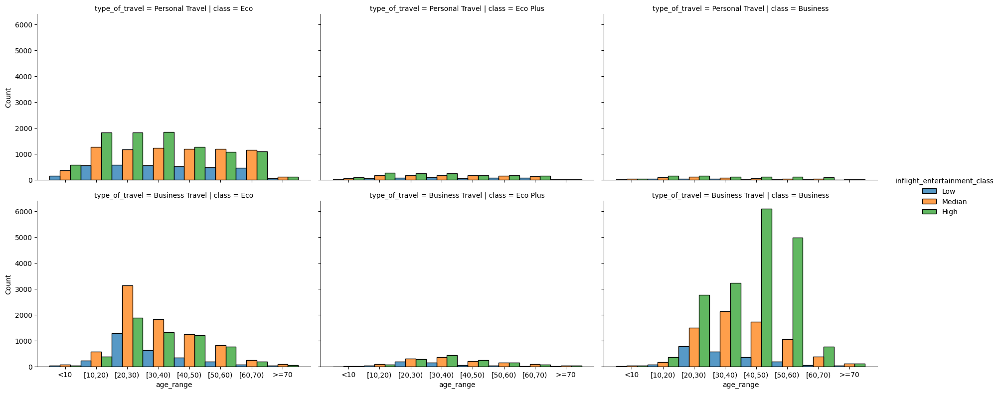

In [258]:
#################################################
#age_range count of Inflight_entertainment_class
#Keep Class ,travel type, trip distance,Departure_Delay constant
#trip distance Medium-Haul
#No Delay
#################################################
mask=(data_cat['flight_distance_class']=='Medium-Haul')&(data_cat['departure_delay_class']=='No Delay')
target_data=data_cat[mask]
g=sns.displot(
    data=target_data, x="age_range", hue="inflight_entertainment_class", 
    row="type_of_travel",col="class",
    facet_kws={"sharey": True,"sharex": True},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='dodge',stat='count'
)
plt.show()

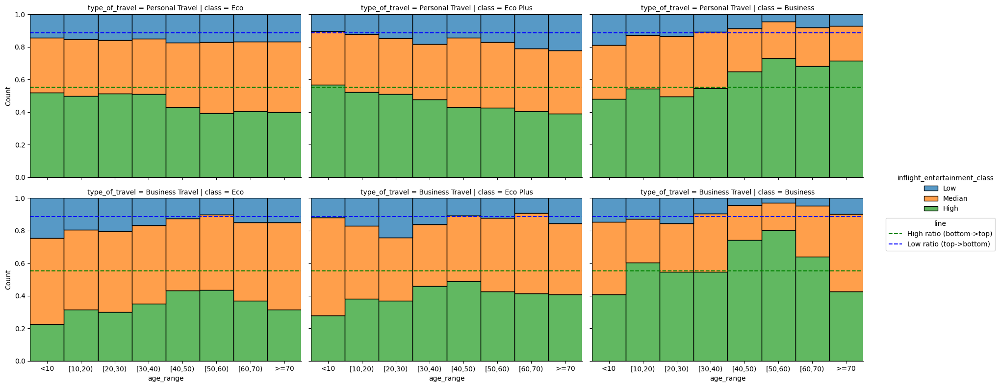

In [259]:
#################################################
#age_range ratio of Inflight_entertainment_class
#Keep Class ,travel type, trip distance,Departure_Delay constant
#trip distance Medium-Haul
#No Delay
#################################################
mask=(data_cat['flight_distance_class']=='Medium-Haul')&(data_cat['departure_delay_class']=='No Delay')
target_data=data_cat[mask]
g=sns.displot(
    data=target_data, x="age_range", hue="inflight_entertainment_class", 
    row="type_of_travel",col="class",
    facet_kws={"sharey": True,"sharex": True},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='fill',stat='count'
)

#add line
low_ratio,high_ratio=cal_rating_class_ratio('inflight_entertainment_class',data_cat)
g.refline(y=high_ratio,color="green",linestyle="--",label="High ratio (bottom->top)")
g.refline(y=1-low_ratio,color="blue",linestyle="--",label="Low ratio (top->bottom)")
plt.legend(title='line',loc='upper right', bbox_to_anchor=(1.5, 0.9))

plt.show()

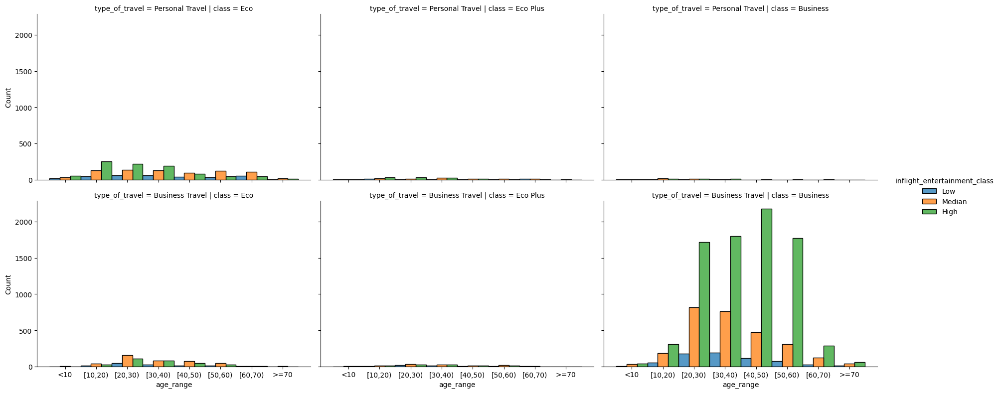

In [260]:
#################################################
#age_range count of Inflight_entertainment
#Keep Class ,travel type, trip distance,Departure_Delay constant
#trip distance Long-Haul
#No Delay
#################################################
mask=(data_cat['flight_distance_class']=='Long-Haul')&(data_cat['departure_delay_class']=='No Delay')
target_data=data_cat[mask]
g=sns.displot(
    data=target_data, x="age_range", hue="inflight_entertainment_class", 
    row="type_of_travel",col="class",
    facet_kws={"sharey": True,"sharex": True},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='dodge',stat='count'
)
plt.show()

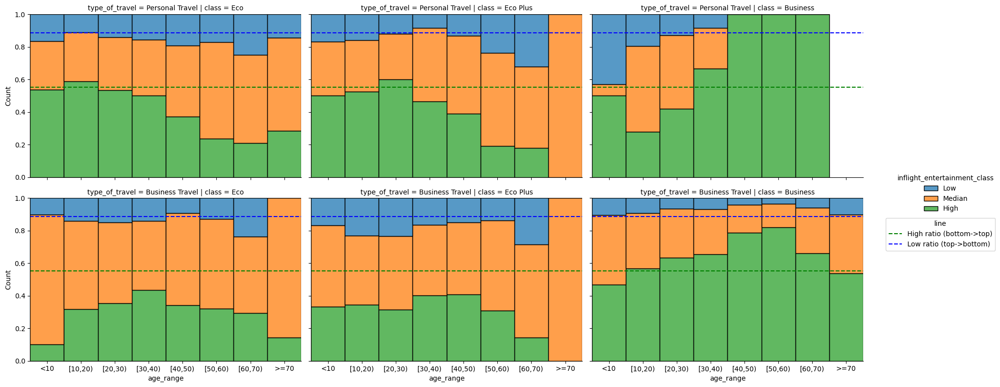

In [261]:
#################################################
#age_range ratio of Inflight_entertainment
#Keep Class ,travel type, trip distance,Departure_Delay constant
#trip distance Long-Haul
#No Delay
#################################################
mask=(data_cat['flight_distance_class']=='Long-Haul')&(data_cat['departure_delay_class']=='No Delay')
target_data=data_cat[mask]
g=sns.displot(
    data=target_data, x="age_range", hue="inflight_entertainment_class", 
    row="type_of_travel",col="class",
    facet_kws={"sharey": True,"sharex": True},
    kind="hist", height=4, aspect=1.5,palette='tab10',
    discrete=True,multiple='fill',stat='count'
)

#add line
low_ratio,high_ratio=cal_rating_class_ratio('inflight_entertainment_class',data_cat)
g.refline(y=high_ratio,color="green",linestyle="--",label="High ratio (bottom->top)")
g.refline(y=1-low_ratio,color="blue",linestyle="--",label="Low ratio (top->bottom)")
plt.legend(title='line',loc='upper right', bbox_to_anchor=(1.5, 0.9))

plt.show()

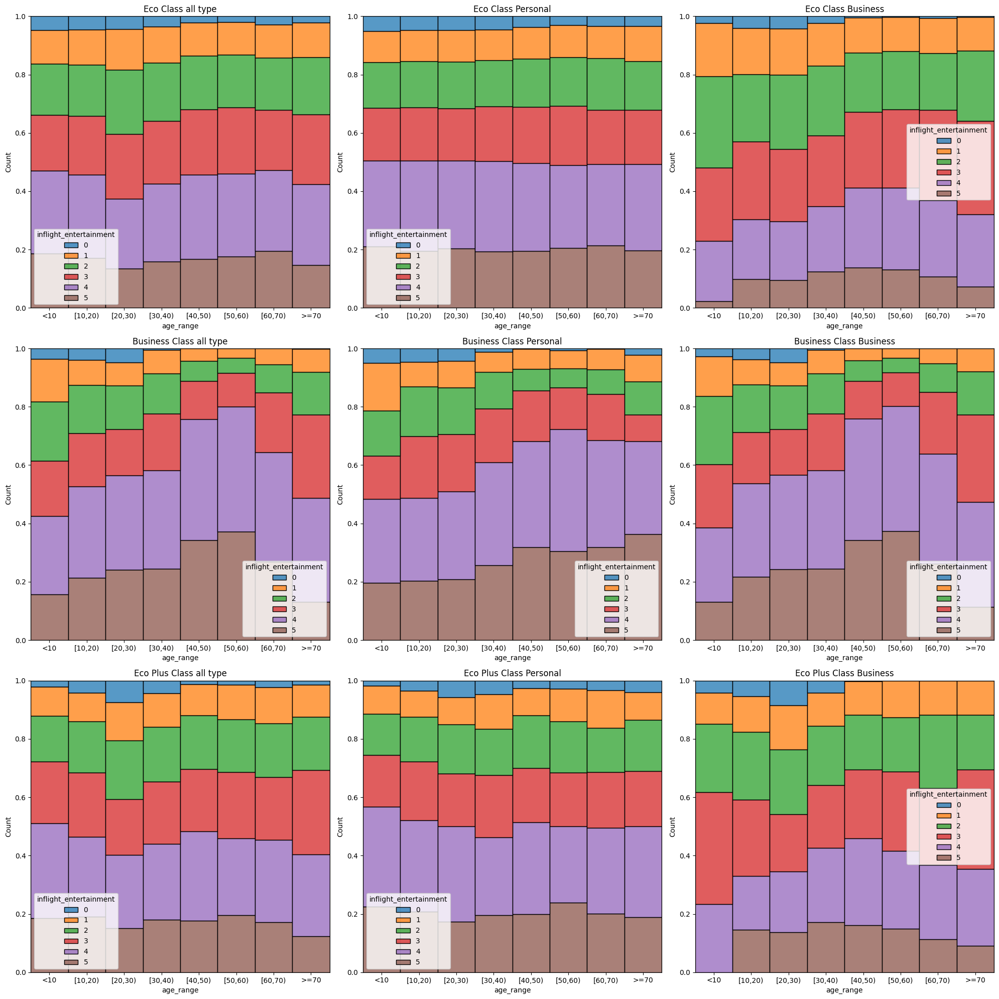

In [262]:
#####################################################################################
#keep Class and travel type constant
#Inflight_entertainment Ratio by Age range
#####################################################################################
fig,axs=plt.subplots(3,3,sharey=False,figsize=(20,20))
class_item=data_cat["class"].unique()
travel_type_item=data_cat["type_of_travel"].unique()
for i, class_type in zip(range(len(class_item)), class_item):
    mask=data_cat["class"]==class_type
    mask_personal=data_cat[mask]['type_of_travel']=='Personal Travel'
    mask_business=data_cat[mask]['type_of_travel']=='Business Travel'
    target_data=data_cat[mask]
    sns.histplot(data=target_data, x="age_range",ax=axs[i][0],hue='inflight_entertainment', multiple="fill")
    sns.histplot(data=target_data[mask_personal], x="age_range",ax=axs[i][1],hue='inflight_entertainment', multiple="fill")
    sns.histplot(data=target_data[mask_business], x="age_range",ax=axs[i][2],hue='inflight_entertainment', multiple="fill")
    axs[i][0].set_title(f'{class_type} Class all type')
    axs[i][1].set_title(f'{class_type} Class Personal')
    axs[i][2].set_title(f'{class_type} Class Business')
plt.tight_layout()
plt.show()
#=>Personal trip seems relatively stable and slow change through age(after 70 almost no personal trip in this dataset)
#=>Business trip seems change a lot,especially Business Class business trip
#==>Type of Travel might be an important factor

## 21  Departure Delay in Minutes

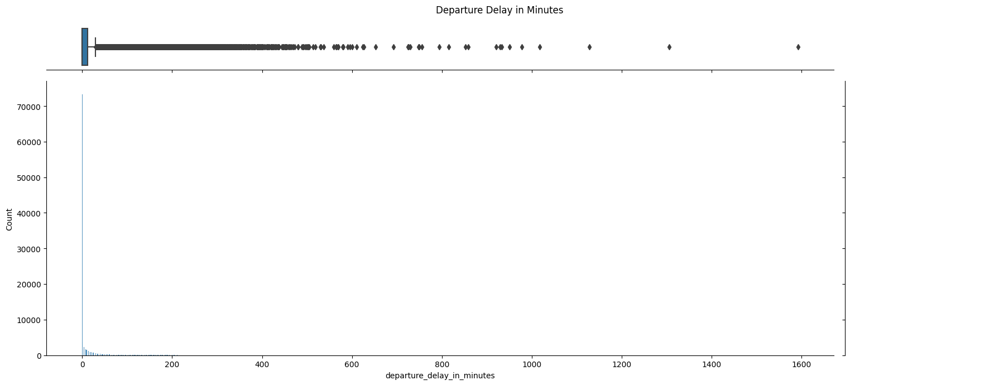

In [263]:
#######################################################
#distribution and boxplot of departure_delay_in_minutes
#######################################################
g = sns.JointGrid(data=data_cat, x="departure_delay_in_minutes")
g.plot(sns.histplot, sns.boxplot)
g.fig.set_size_inches((18, 7))
plt.suptitle("Departure Delay in Minutes")
plt.tight_layout()
plt.show()

<function matplotlib.pyplot.show(close=None, block=None)>

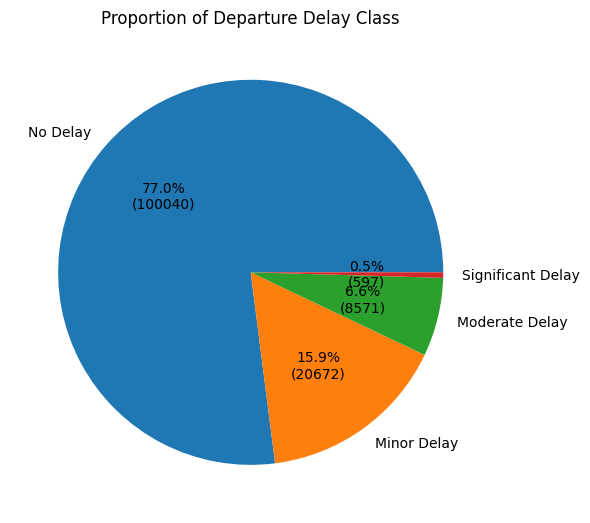

In [264]:
#######################################
#Pie Chart
#######################################
plt.figure(figsize=(6,6))
result=data_cat.groupby(['departure_delay_class'])[['satisfaction']].count().reset_index().rename(columns={'satisfaction':'count'})
plt.pie(result['count'],labels = result["departure_delay_class"], autopct=autopct_format(result['count']))
plt.title("Proportion of Departure Delay Class")
plt.tight_layout()
plt.show
#https://www.transtats.bts.gov/HomeDrillChart.asp
##=>around 20% flight delayed

### 21-1 Keep Class and Travel Type constant

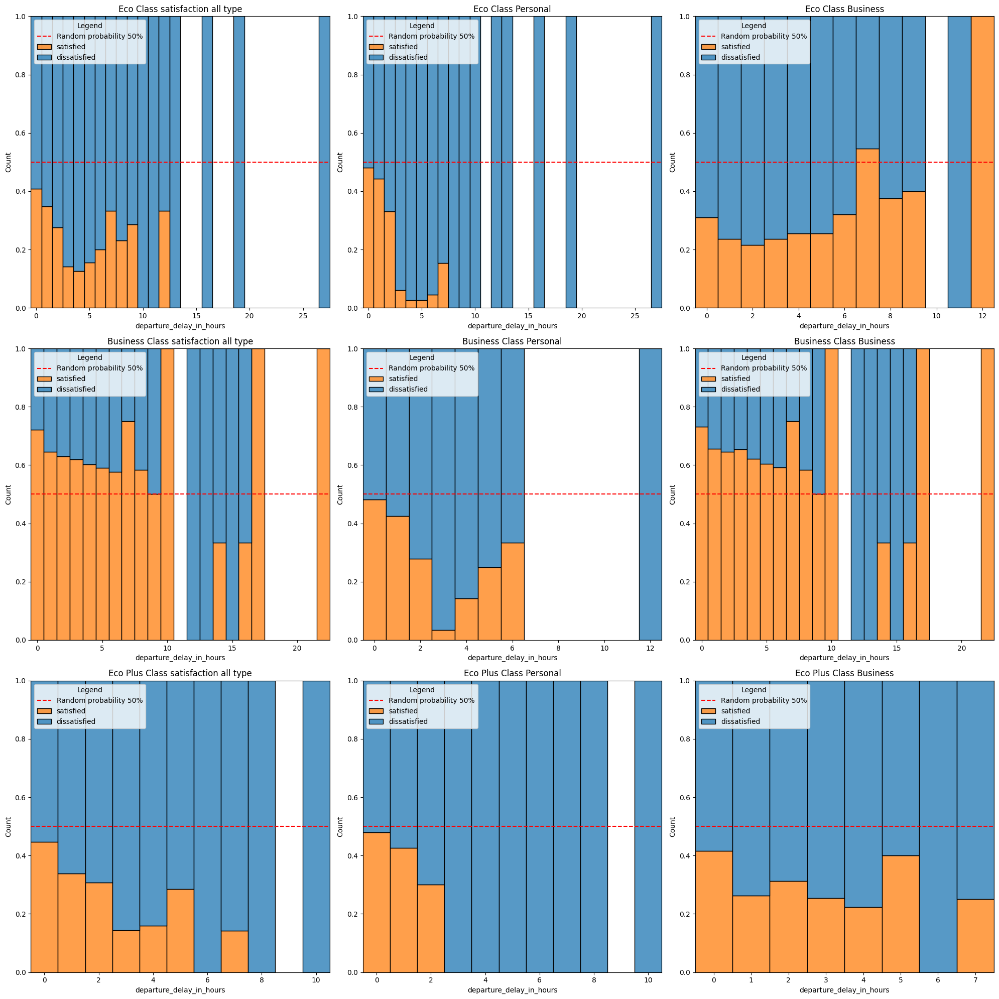

In [265]:
#####################################################################################
#Keep Class and Travel Type constant, satisfaction ratio by delay
#####################################################################################
fig,axs=plt.subplots(3,3,sharey=False,sharex=False,figsize=(20,20))
class_item=data_cat["class"].unique()
hue_order=satisfaction_hue_order

for i, class_type in zip(range(len(class_item)), class_item):
    mask=data_cat["class"]==class_type
    mask_personal=data_cat[mask]['type_of_travel']=='Personal Travel'
    mask_business=data_cat[mask]['type_of_travel']=='Business Travel'
    target_data=data_cat[mask]
    sns.histplot(data=target_data, x="departure_delay_in_hours",ax=axs[i][0]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_personal], x="departure_delay_in_hours",ax=axs[i][1]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_business], x="departure_delay_in_hours",ax=axs[i][2]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    
    axs[i][0].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][1].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][2].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    
    axs[i][0].set_title(f'{class_type} Class satisfaction all type')
    axs[i][1].set_title(f'{class_type} Class Personal')
    axs[i][2].set_title(f'{class_type} Class Business')
    
    #edit legend
    handles, labels = axs[i][0].get_legend_handles_labels()
    axs[i][0].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    handles, labels = axs[i][1].get_legend_handles_labels()
    axs[i][1].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    handles, labels = axs[i][2].get_legend_handles_labels()
    axs[i][2].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    
plt.tight_layout()
plt.show()
#https://www.seattletimes.com/life/travel/flight-delay-compensation-your-rights-by-each-major-u-s-airline/

#https://www.united.com/en/us/fly/travel/inflight/economy-plus.html
##"If you change your flight, you will get an automatic refund and have to repurchase Economy Plus for your new flight."
##"If we move you out of Economy Plus, you will get an automatic refund."
##"If there is a schedule change or your flight is canceled, we will try to give you an Economy Plus seat on your new flight. If there are no Economy Plus seats available, or you are rebooked on another airline, you will get an automatic refund."
##"Valid for travel on United and United Express only. Star Alliance® or marketed codeshare flights do not provide Economy Plus seating."
#==>Eco plus only available in very limited airlines, when delay oocurs and need to change to other airline could not(difficult) keep the same class

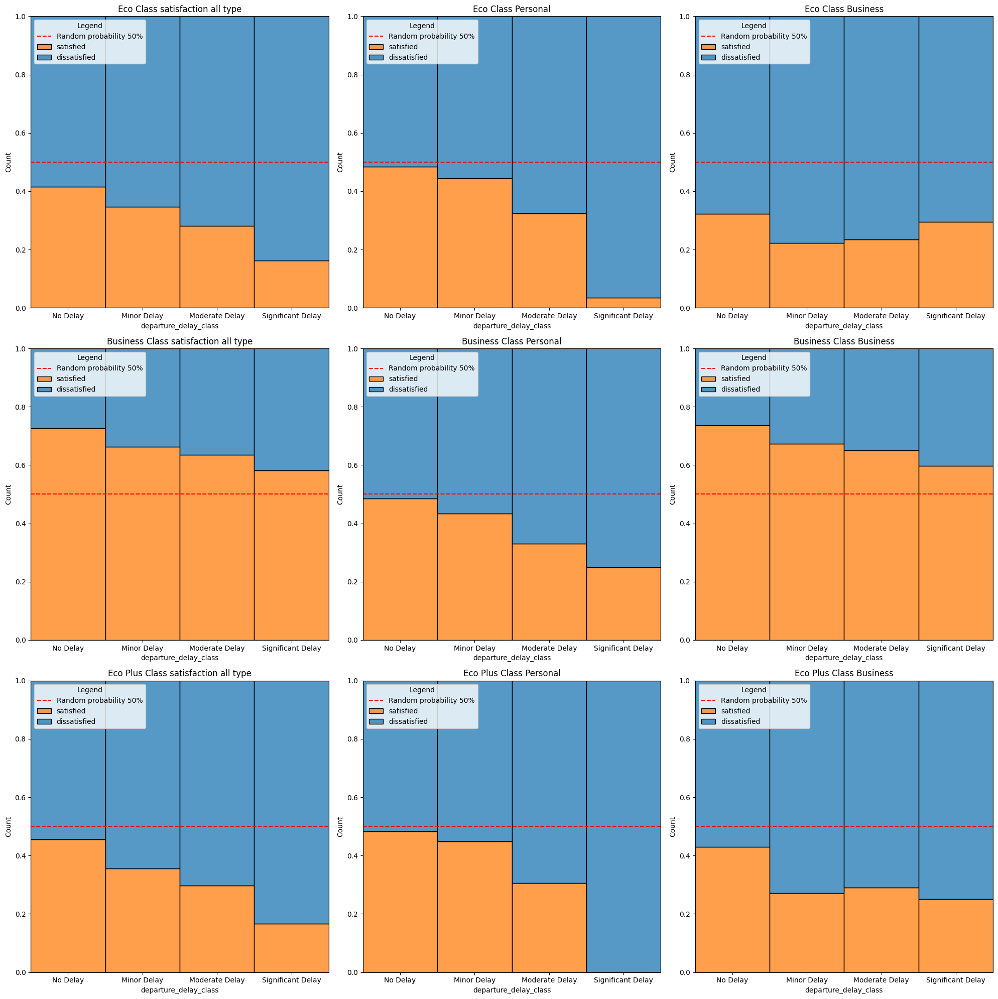

In [266]:
#####################################################################################
#Keep Class and Travel Type constant, satisfaction ratio by delay
#####################################################################################
fig,axs=plt.subplots(3,3,sharey=False,sharex=False,figsize=(20,20))
class_item=data_cat["class"].unique()
hue_order=satisfaction_hue_order
for i, class_type in zip(range(len(class_item)), class_item):
    mask=data_cat["class"]==class_type
    mask_personal=data_cat[mask]['type_of_travel']=='Personal Travel'
    mask_business=data_cat[mask]['type_of_travel']=='Business Travel'
    target_data=data_cat[mask]
    sns.histplot(data=target_data, x="departure_delay_class",ax=axs[i][0]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_personal], x="departure_delay_class",ax=axs[i][1]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_business], x="departure_delay_class",ax=axs[i][2]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    
    axs[i][0].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][1].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][2].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    
    axs[i][0].set_title(f'{class_type} Class satisfaction all type')
    axs[i][1].set_title(f'{class_type} Class Personal')
    axs[i][2].set_title(f'{class_type} Class Business')
    
    #edit legend
    handles, labels = axs[i][0].get_legend_handles_labels()
    axs[i][0].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    handles, labels = axs[i][1].get_legend_handles_labels()
    axs[i][1].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    handles, labels = axs[i][2].get_legend_handles_labels()
    axs[i][2].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    
plt.tight_layout()
plt.show()

### 21-(7~20) departure_delay_in_minutes VS Rating item class

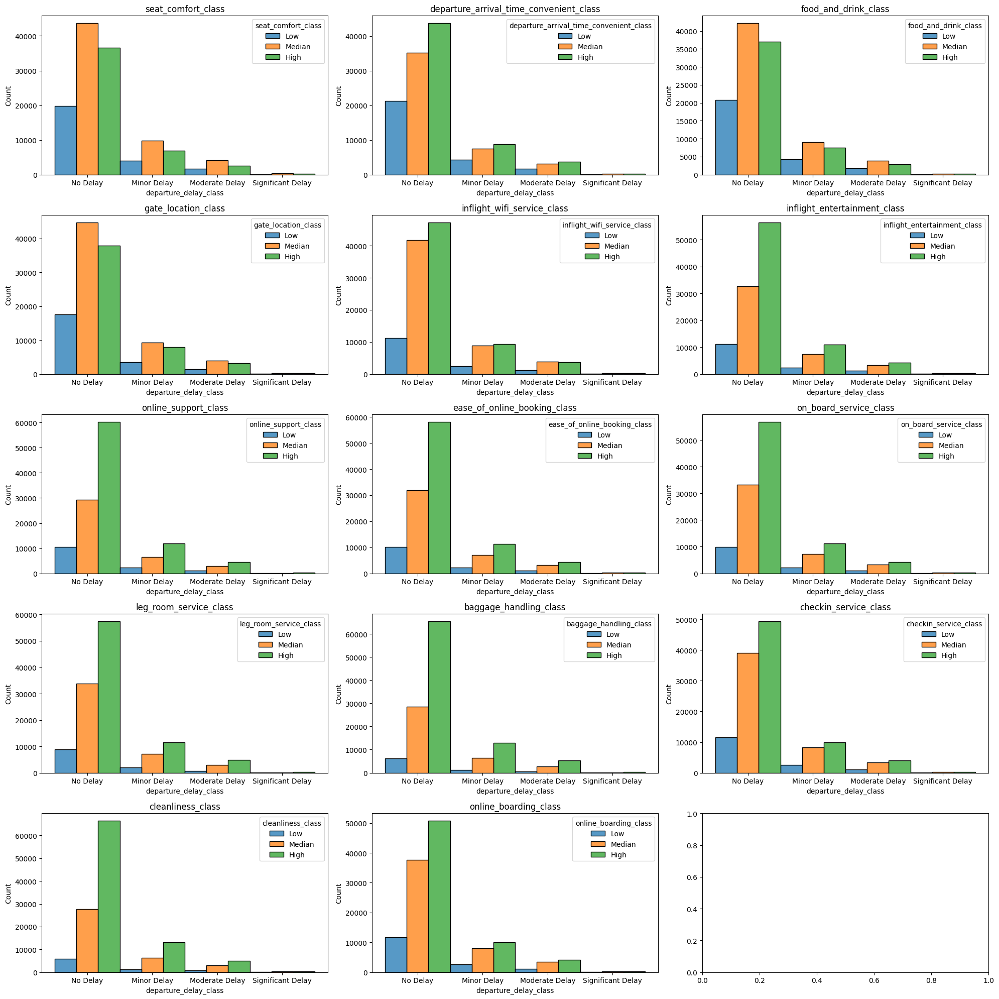

In [267]:
###############################################
#histplot
#Check survey variable
#By departure_delay_class
###############################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(20,20))
hue_order=rating_class_hue_order

rating_list=['seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']
for var,ax in zip(rating_list,axs.ravel()):
    sns.histplot(data=data_cat, x="departure_delay_class",ax=ax,stat='count',
                 hue=var, multiple="dodge",discrete=True,
                 hue_order=hue_order, palette="tab10")
    ax.set_title(var)
plt.tight_layout()
plt.show()

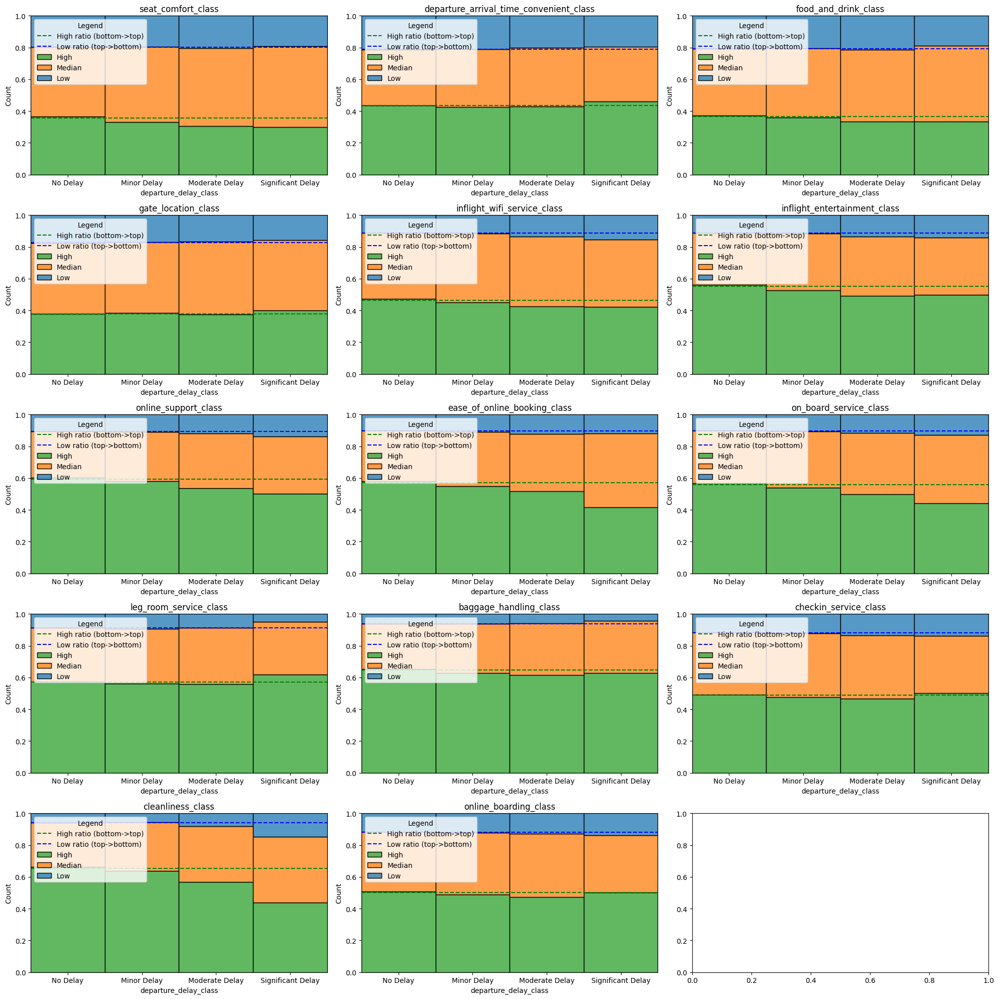

In [268]:
#############################################################
#Check survey variable
#By departure_delay_class
#Score proportion by different rating items
#############################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(20,20))
hue_order=rating_class_hue_order

rating_list=['seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']
for var,ax in zip(rating_list,axs.ravel()):
    low_ratio,high_ratio=cal_rating_class_ratio(var,data_cat)
    
    sns.histplot(data=data_cat, x="departure_delay_class",ax=ax
                 ,hue=var, multiple="fill",discrete=True,hue_order=hue_order, palette="tab10")
    
    #draw line
    ax.axhline(high_ratio,color="green",linestyle="--",label="High ratio (bottom->top)")
    ax.axhline(1-low_ratio,color="blue",linestyle="--",label="Low ratio (top->bottom)")
    #edit legend
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    
    ax.set_title(var)
plt.tight_layout()
plt.show()

## 22  Arrival Delay in Minutes

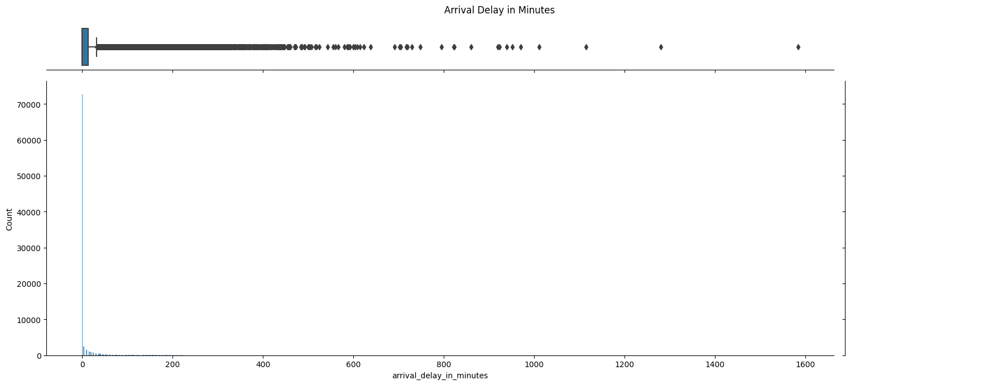

In [269]:
#######################################################
#distribution and boxplot of arrival_delay_in_minutes
#######################################################
g = sns.JointGrid(data=data_cat, x="arrival_delay_in_minutes")
g.plot(sns.histplot, sns.boxplot)
g.fig.set_size_inches((18, 7))
plt.suptitle("Arrival Delay in Minutes")
plt.tight_layout()
plt.show()

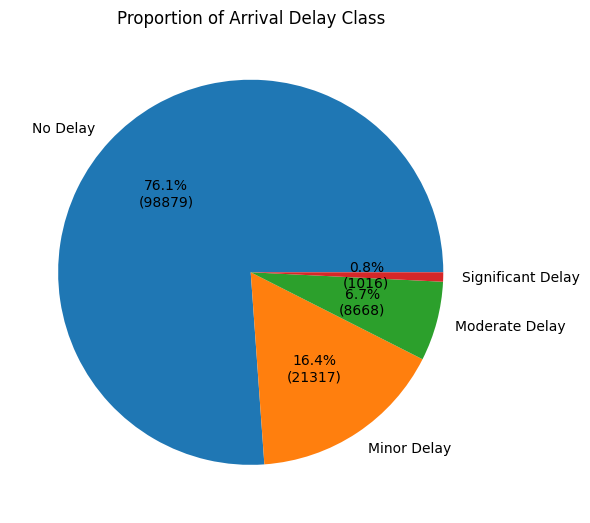

In [270]:
#######################################
#Pie Chart
#######################################
plt.figure(figsize=(6,6))
result=data_cat.groupby(['arrival_delay_class'])[['satisfaction']].count().reset_index().rename(columns={'satisfaction':'count'})
plt.pie(result['count'],labels = result["arrival_delay_class"], autopct=autopct_format(result['count']))
plt.title("Proportion of Arrival Delay Class")
plt.tight_layout()
plt.show()


### 22-1 Keep Class and Travel Type constant

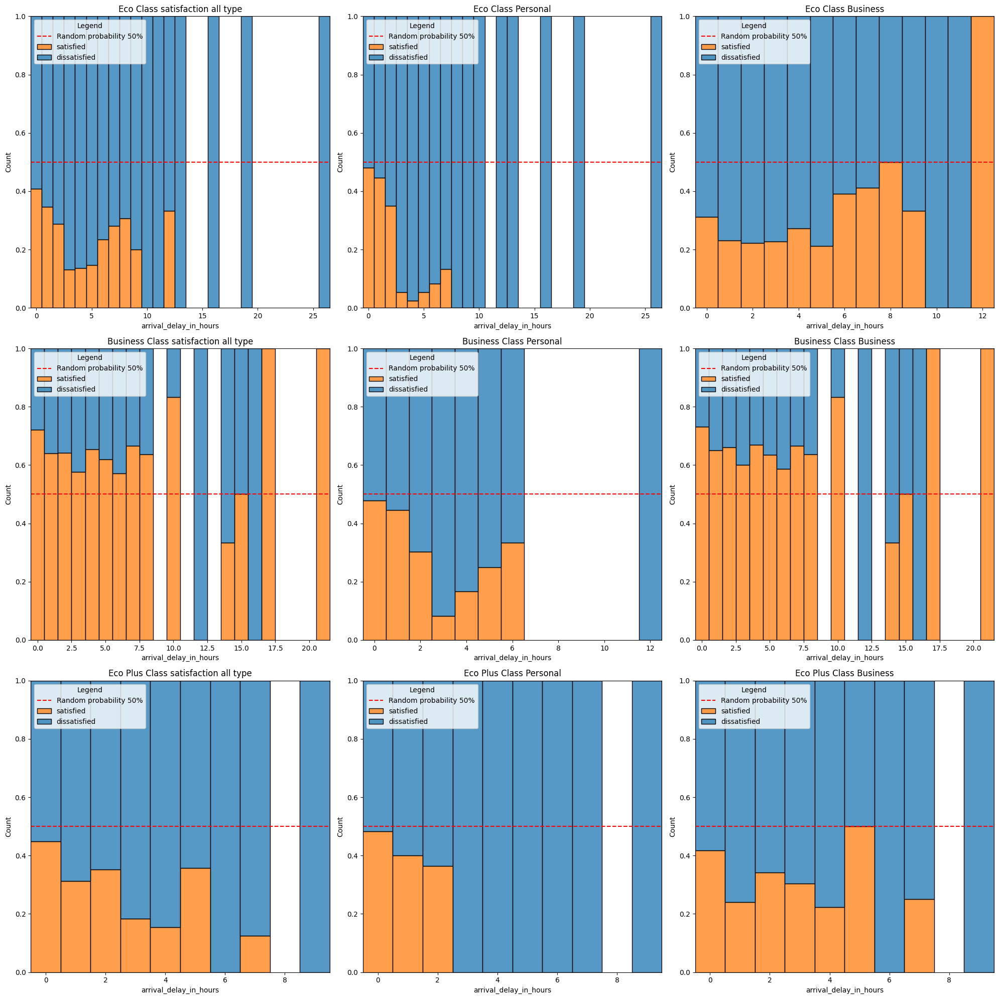

In [271]:
#####################################################################################
#Keep Class and Travel Type constant, satisfaction ratio by delay
#####################################################################################
fig,axs=plt.subplots(3,3,sharey=False,sharex=False,figsize=(20,20))
class_item=data_cat["class"].unique()
hue_order=satisfaction_hue_order
for i, class_type in zip(range(len(class_item)), class_item):
    mask=data_cat["class"]==class_type
    mask_personal=data_cat[mask]['type_of_travel']=='Personal Travel'
    mask_business=data_cat[mask]['type_of_travel']=='Business Travel'
    target_data=data_cat[mask]
    sns.histplot(data=target_data, x="arrival_delay_in_hours",ax=axs[i][0]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_personal], x="arrival_delay_in_hours",ax=axs[i][1]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_business], x="arrival_delay_in_hours",ax=axs[i][2]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    
    axs[i][0].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][1].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][2].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    
    axs[i][0].set_title(f'{class_type} Class satisfaction all type')
    axs[i][1].set_title(f'{class_type} Class Personal')
    axs[i][2].set_title(f'{class_type} Class Business')
    
    #edit legend
    handles, labels = axs[i][0].get_legend_handles_labels()
    axs[i][0].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    handles, labels = axs[i][1].get_legend_handles_labels()
    axs[i][1].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    handles, labels = axs[i][2].get_legend_handles_labels()
    axs[i][2].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    
plt.tight_layout()
plt.show()

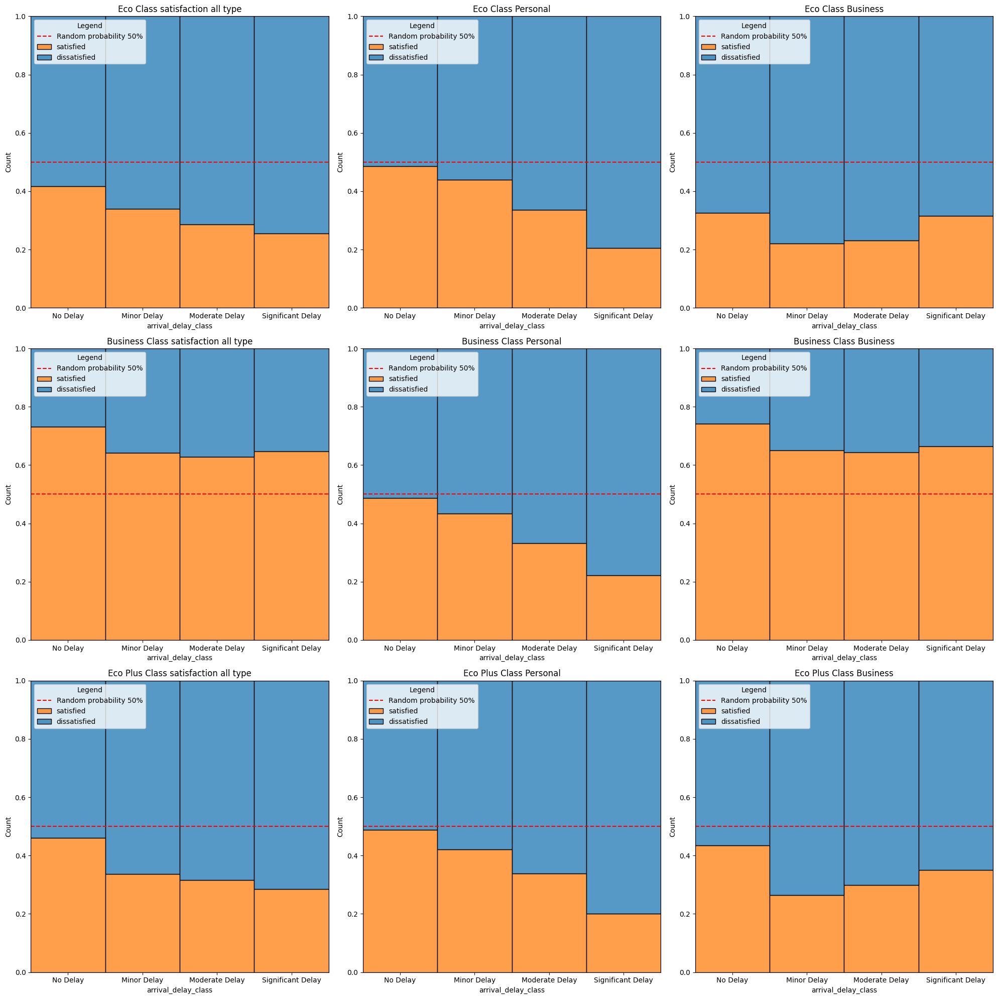

In [272]:
#####################################################################################
#Keep Class and Travel Type constant, satisfaction ratio by delay
#####################################################################################
fig,axs=plt.subplots(3,3,sharey=False,sharex=False,figsize=(20,20))
class_item=data_cat["class"].unique()
hue_order=satisfaction_hue_order
for i, class_type in zip(range(len(class_item)), class_item):
    mask=data_cat["class"]==class_type
    mask_personal=data_cat[mask]['type_of_travel']=='Personal Travel'
    mask_business=data_cat[mask]['type_of_travel']=='Business Travel'
    target_data=data_cat[mask]
    sns.histplot(data=target_data, x="arrival_delay_class",ax=axs[i][0]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_personal], x="arrival_delay_class",ax=axs[i][1]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    sns.histplot(data=target_data[mask_business], x="arrival_delay_class",ax=axs[i][2]
                 ,hue='satisfaction', multiple="fill",discrete=True,hue_order=hue_order)
    
    axs[i][0].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][1].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    axs[i][2].axhline(0.5,color="red",linestyle="--",label="Random probability 50%")
    
    axs[i][0].set_title(f'{class_type} Class satisfaction all type')
    axs[i][1].set_title(f'{class_type} Class Personal')
    axs[i][2].set_title(f'{class_type} Class Business')
    
    #edit legend
    handles, labels = axs[i][0].get_legend_handles_labels()
    axs[i][0].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    handles, labels = axs[i][1].get_legend_handles_labels()
    axs[i][1].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    handles, labels = axs[i][2].get_legend_handles_labels()
    axs[i][2].legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    
plt.tight_layout()
plt.show()

### 22-(7~20) arrival_delay_in_minutes VS Rating item class

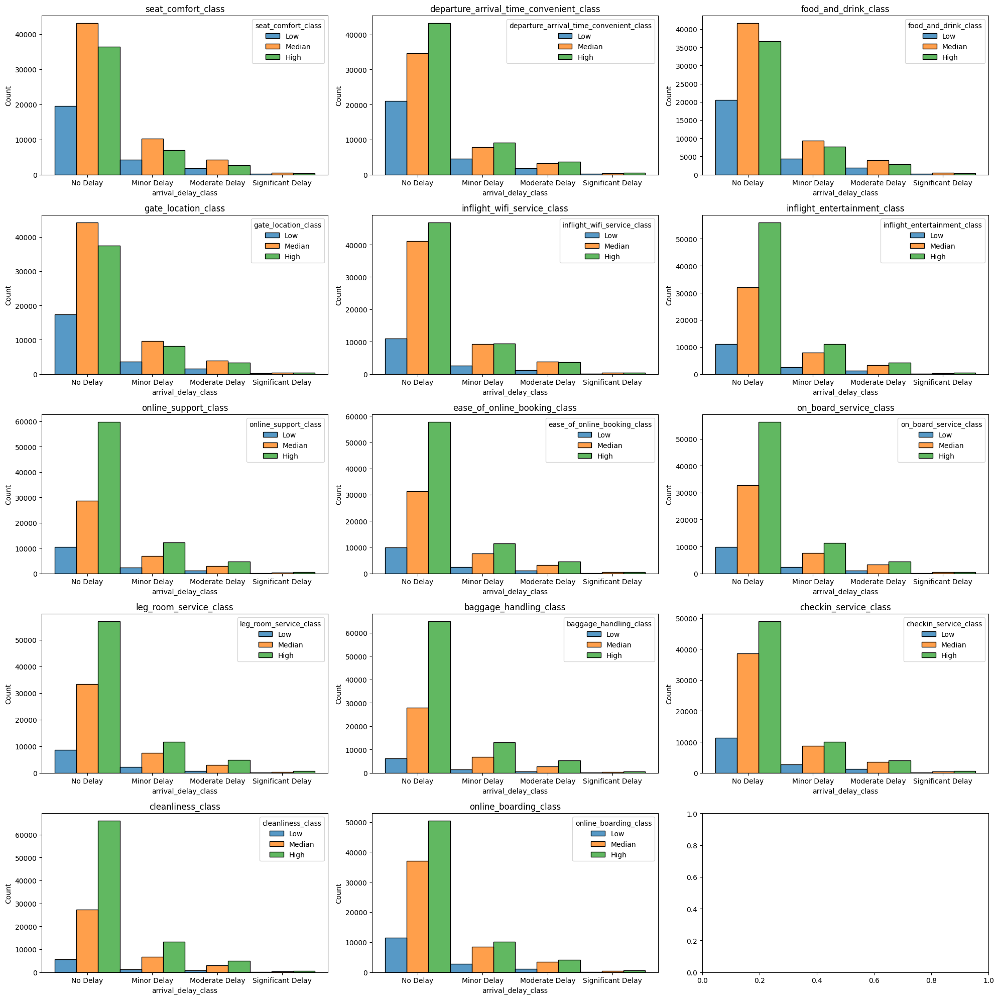

In [273]:
###############################################
#histplot
#Check survey variable
#By arrival_delay_class
###############################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(20,20))
hue_order=rating_class_hue_order

rating_list=['seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']
for var,ax in zip(rating_list,axs.ravel()):
    sns.histplot(data=data_cat, x="arrival_delay_class",ax=ax,stat='count',
                 hue=var, multiple="dodge",discrete=True,
                 hue_order=hue_order, palette="tab10")
    ax.set_title(var)
plt.tight_layout()
plt.show()

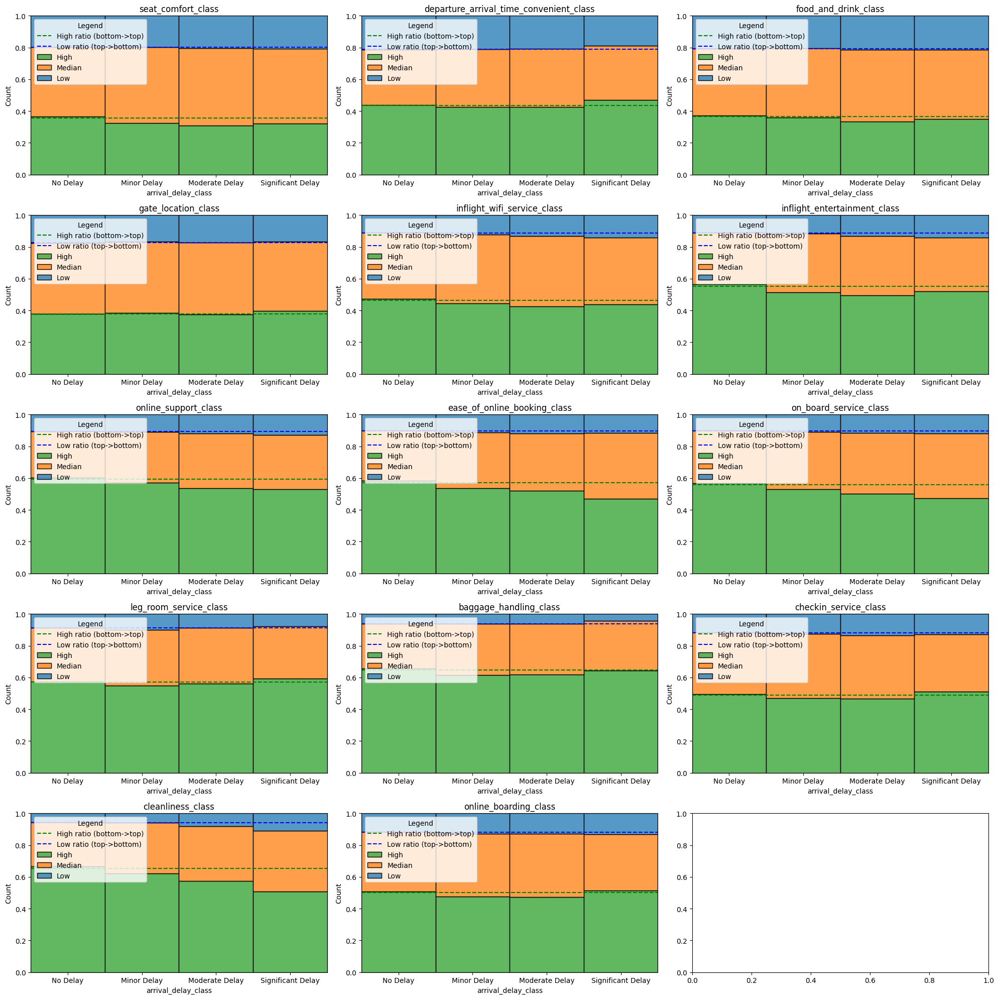

In [274]:
#############################################################
#Check survey variable
#By arrival_delay_class
#Score proportion by different rating items
#############################################################
fig,axs=plt.subplots(5,3,sharey=False,figsize=(20,20))
hue_order=rating_class_hue_order

rating_list=['seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']
for var,ax in zip(rating_list,axs.ravel()):
    low_ratio,high_ratio=cal_rating_class_ratio(var,data_cat)
    
    sns.histplot(data=data_cat, x="arrival_delay_class",ax=ax
                 ,hue=var, multiple="fill",discrete=True,hue_order=hue_order, palette="tab10")
    
    #draw line
    ax.axhline(high_ratio,color="green",linestyle="--",label="High ratio (bottom->top)")
    ax.axhline(1-low_ratio,color="blue",linestyle="--",label="Low ratio (top->bottom)")
    #edit legend
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(title='Legend',loc='upper left',labels=labels+hue_order[::-1])
    
    ax.set_title(var)
plt.tight_layout()
plt.show()

In [275]:
#########################################
#test which variable has the highest pobability of satisfaction
#P(satisfaction | variable)
#Probability of satisfaction given variable
#########################################
var_cat_all=['customer_type', 'type_of_travel', 'class', 'class_m',
       'seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class',
       'departure_delay_class', 'arrival_delay_class', 
       'age_class_by_airline', 'age_range', 'flight_distance_range','flight_distance_class']
#var_cat_rating=[
#       'seat_comfort', 'departure_arrival_time_convenient',
#       'food_and_drink', 'gate_location', 'inflight_wifi_service',
#       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
#       'on_board_service', 'leg_room_service', 'baggage_handling',
#       'checkin_service', 'cleanliness', 'online_boarding',
#       ]
var_cat_rating=[
       'seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'
       ]
result_rating=pd.DataFrame()
for rating_col in var_cat_rating:
    result=pd.crosstab(data_cat["satisfaction"],data_cat[rating_col],margins=True,normalize="columns").reset_index()
    result["variable"]=rating_col
    result_rating=pd.concat([result_rating,result],axis=0)
result_rating

,satisfaction,Low,Median,High,All,variable
0,dissatisfied,0.447176,0.643216,0.217025,0.452672,seat_comfort_class
1,satisfied,0.552824,0.356784,0.782975,0.547328,seat_comfort_class
0,dissatisfied,0.424487,0.460220,0.460255,0.452672,departure_arrival_time_convenient_class
1,satisfied,0.575513,0.539780,0.539745,0.547328,departure_arrival_time_convenient_class
0,dissatisfied,0.431997,0.569553,0.328533,0.452672,food_and_drink_class
1,satisfied,0.568003,0.430447,0.671467,0.547328,food_and_drink_class
0,dissatisfied,0.388975,0.487514,0.440781,0.452672,gate_location_class
1,satisfied,0.611025,0.512486,0.559219,0.547328,gate_location_class
0,dissatisfied,0.729974,0.494062,0.347061,0.452672,inflight_wifi_service_class
1,satisfied,0.270026,0.505938,0.652939,0.547328,inflight_wifi_service_class


In [276]:
def compute_odds(x):
    if(x>=0) & (x<1):
        result=x/(1-x)
    elif x==1:
        result=np.inf
    return result

def compute_logit(x):
    if (x>=0) & (x<1):
        result=np.log(x/(1-x))
    elif x==1:
        result=np.log(np.inf)
    return result


mask=result_rating['satisfaction']=='satisfied'

#x_list=["0","1","2","3","4","5"]
x_list=["Low","Median","High"]
x_odds_list=[]
logit_list=[]
variable_list=result_rating[mask]['variable'].to_list()
for x in x_list:
    result=result_rating[mask][x].apply(compute_odds).to_list()
    x_odds_list.append(result)
    logit_result=result_rating[mask][x].apply(compute_logit).to_list()
    logit_list.append(logit_result)
rating_odds_result=pd.DataFrame(data={
    "Variable": variable_list,
    "odds_of_low": x_odds_list[0],
    "odds_of_median": x_odds_list[1],
    "odds_of_high": x_odds_list[2],
})
rating_logit_result=pd.DataFrame(data={
    "Variable": variable_list,
    "logit_of_low": logit_list[0],
    "logit_of_median": logit_list[1],
    "logit_of_high": logit_list[2],
})
result_rating[mask]

,satisfaction,Low,Median,High,All,variable
1,satisfied,0.552824,0.356784,0.782975,0.547328,seat_comfort_class
1,satisfied,0.575513,0.539780,0.539745,0.547328,departure_arrival_time_convenient_class
1,satisfied,0.568003,0.430447,0.671467,0.547328,food_and_drink_class
1,satisfied,0.611025,0.512486,0.559219,0.547328,gate_location_class
1,satisfied,0.270026,0.505938,0.652939,0.547328,inflight_wifi_service_class
1,satisfied,0.300940,0.186386,0.816497,0.547328,inflight_entertainment_class
1,satisfied,0.295093,0.288893,0.723275,0.547328,online_support_class
1,satisfied,0.192656,0.323963,0.739552,0.547328,ease_of_online_booking_class
1,satisfied,0.266014,0.383389,0.699001,0.547328,on_board_service_class
1,satisfied,0.299353,0.374107,0.689483,0.547328,leg_room_service_class


In [277]:
rating_odds_result

,Variable,odds_of_low,odds_of_median,odds_of_high
0,seat_comfort_class,1.236255,0.554688,3.607755
1,departure_arrival_time_convenient_class,1.355784,1.172873,1.172707
2,food_and_drink_class,1.314829,0.755763,2.043837
3,gate_location_class,1.570859,1.051224,1.268703
4,inflight_wifi_service_class,0.369912,1.024038,1.881340
5,inflight_entertainment_class,0.430492,0.229085,4.449502
6,online_support_class,0.418626,0.406259,2.613700
7,ease_of_online_booking_class,0.238630,0.479210,2.839538
8,on_board_service_class,0.362423,0.621767,2.322274
9,leg_room_service_class,0.427251,0.597716,2.220440


In [278]:
rating_logit_result

,Variable,logit_of_low,logit_of_median,logit_of_high
0,seat_comfort_class,0.212086,-0.589350,1.283086
1,departure_arrival_time_convenient_class,0.304380,0.159457,0.159315
2,food_and_drink_class,0.273707,-0.280027,0.714829
3,gate_location_class,0.451623,0.049955,0.237995
4,inflight_wifi_service_class,-0.994489,0.023754,0.631984
5,inflight_entertainment_class,-0.842826,-1.473664,1.492792
6,online_support_class,-0.870777,-0.900764,0.960767
7,ease_of_online_booking_class,-1.432841,-0.735617,1.043641
8,on_board_service_class,-1.014943,-0.475189,0.842547
9,leg_room_service_class,-0.850383,-0.514639,0.797705


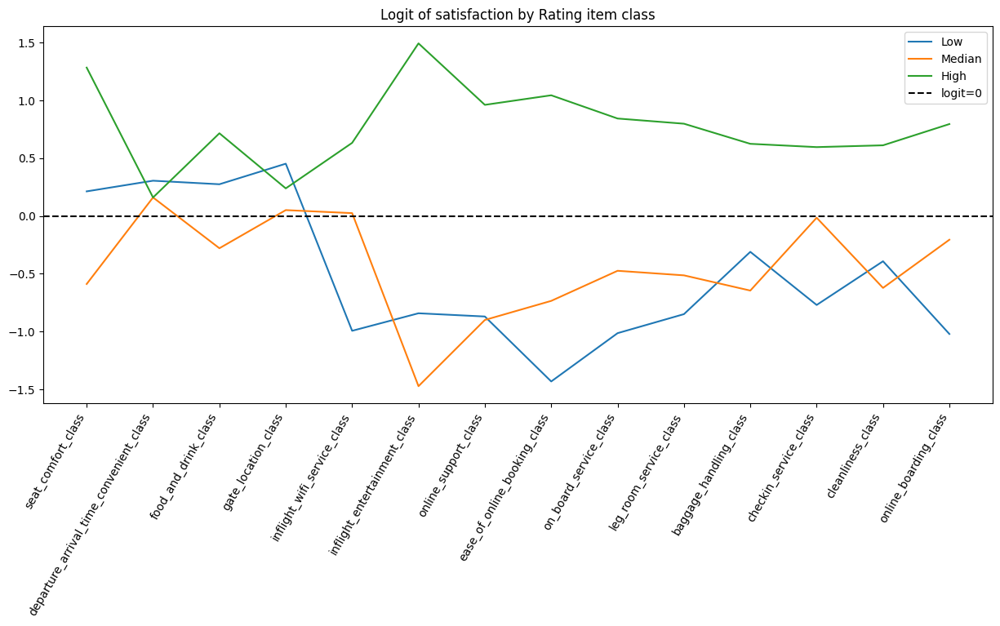

In [279]:
plt.figure(figsize=(15,6))
plt.plot(rating_logit_result['Variable'],rating_logit_result['logit_of_low'],label="Low")
plt.plot(rating_logit_result['Variable'],rating_logit_result['logit_of_median'],label="Median")
plt.plot(rating_logit_result['Variable'],rating_logit_result['logit_of_high'],label="High")
plt.axhline(0,linestyle="--",color='k',label="logit=0")
plt.xticks(rotation=60, ha='right')
plt.legend()
plt.title("Logit of satisfaction by Rating item class")
plt.show()

**satisfaction**
* $P(\text{satisfied})$=54.7328%
* $P(\text{dissatisfied})$=45.2672%

**Class**
* $P(\text{Class=Eco})$=44.8945%
* $P(\text{Class=Eco Plus})$=7.2459%
* $P(\text{Class=Business})$=47.8596%
* $P(\text{Class=Eco\&EcoPlus})$=52.1404%
* $P(\text{Class=Business})$=47.8596%

**Inflight_entertainment**
* $P(\text{Inflight entertainment=0})$=2.2929%
* $P(\text{Inflight entertainment=1})$=9.0922%
* $P(\text{Inflight entertainment=2})$=14.7698%
* $P(\text{Inflight entertainment=3})$=18.6326%
* $P(\text{Inflight entertainment=4})$=32.2444%
* $P(\text{Inflight entertainment=5})$=22.9681%
* $P(\text{Inflight entertainment class=Low})$=11.3851%
* $P(\text{Inflight entertainment class=Median})$=33.4024%
* $P(\text{Inflight entertainment class=High})$=55.2125%

**$\text{satisfied} \bigcap \text{Class}$**
* $P(\text{satisfied} \bigcap \text{Class=Eco})$ = 17.6879%
* $P(\text{satisfied} \bigcap \text{Class=Eco Plus})$ = 3.0944%
* $P(\text{satisfied} \bigcap \text{Class=Business})$ = 33.9506%
* $P(\text{satisfied} \bigcap \text{Class\_m=Eco\&EcoPlus})$ = 39.8583%
* $P(\text{satisfied} \bigcap \text{Class\_m=Business})$ = 33.9506%

**$P(A|B) = {P(A \bigcap B) \over P(B)}$**
* $P(\text{satisfied} | \text{Class=Eco})$ = 17.6879% / 44.8945% = 39.398813%
* $P(\text{satisfied} | \text{Class=Eco Plus})$ = 3.0944% / 7.2459% = 42.70553%
* $P(\text{satisfied} | \text{Class=Business})$ = 33.9506% / 47.8596% = 70.93791%
* $P(\text{satisfied} | \text{Class\_m=Eco\&EcoPlus})$ = 20.7823% / 52.1404% = 39.398813%
* $P(\text{satisfied} | \text{Class\_m=Business})$ = 33.9506% / 47.8596% = 70.93791%
* $P(\text{Class=Eco} | \text{satisfied})$ = 17.6879% / 54.7328% = 32.31682%
* $P(\text{Class=Eco Plus} | \text{satisfied})$ = 3.0944% / 54.7328% = 5.653648%
* $P(\text{Class=Business} | \text{satisfied})$ = 33.9506% / 54.7328% = 62.029715%
* $P(\text{Class\_m=Eco\&EcoPlus} | \text{satisfied})$ = 20.7823% / 54.7328% = 37.970467%
* $P(\text{Class\_m=Business} | \text{satisfied})$ = 33.9506% / 54.7328% = 62.029715%

$P(\text{satisfied} \bigcap  \text{Inflight entertainment=5} )$ = 21.8671%

$P(\text{satisfied} | \text{Inflight entertainment=5})$ = 21.8671% / 22.9681% = 95.206395%

$P(\text{Inflight entertainment=5} | \text{satisfied})$ = 21.8671% / 54.7328% = 39.95246%

In [280]:
#############################################################
#Probability of satisfaction & class
#############################################################
display(pd.crosstab(data_cat["satisfaction"],data_cat["class"],margins=True,normalize="all"))
display(pd.crosstab(data_cat["satisfaction"],data_cat["class_m"],margins=True,normalize="all"))

class,Eco,Eco Plus,Business,All
satisfaction,,,,
dissatisfied,0.272067,0.041515,0.139090,0.452672
satisfied,0.176879,0.030944,0.339506,0.547328
All,0.448945,0.072459,0.478596,1.000000


class_m,Eco&EcoPlus,Business,All
satisfaction,,,
dissatisfied,0.313582,0.139090,0.452672
satisfied,0.207823,0.339506,0.547328
All,0.521404,0.478596,1.000000


In [281]:
#########################################
#P(satisfaction | Class)
#Probability of satisfaction given Class
#########################################
display(pd.crosstab(data_cat["satisfaction"],data_cat["class"],margins=True,normalize="columns"))
display(pd.crosstab(data_cat["satisfaction"],data_cat["class_m"],margins=True,normalize="columns"))

class,Eco,Eco Plus,Business,All
satisfaction,,,,
dissatisfied,0.606013,0.572947,0.290621,0.452672
satisfied,0.393987,0.427053,0.709379,0.547328


class_m,Eco&EcoPlus,Business,All
satisfaction,,,
dissatisfied,0.601418,0.290621,0.452672
satisfied,0.398582,0.709379,0.547328


In [282]:
#########################################
#P(Class | satisfaction)
#Probability of Class given satisfaction
#########################################
display(pd.crosstab(data_cat["satisfaction"],data_cat["class"],margins=True,normalize="index"))
display(pd.crosstab(data_cat["satisfaction"],data_cat["class_m"],margins=True,normalize="index"))

class,Eco,Eco Plus,Business
satisfaction,,,
dissatisfied,0.601024,0.091712,0.307264
satisfied,0.323167,0.056536,0.620296
All,0.448945,0.072459,0.478596


class_m,Eco&EcoPlus,Business
satisfaction,,
dissatisfied,0.692736,0.307264
satisfied,0.379704,0.620296
All,0.521404,0.478596


In [283]:
#############################################################
#Probability of satisfaction & Inflight_entertainment
#############################################################
display(pd.crosstab(data_cat["satisfaction"],data_cat["inflight_entertainment"],margins=True,normalize="all"))
display(pd.crosstab(data_cat["satisfaction"],data_cat["inflight_entertainment_class"],margins=True,normalize="all"))

inflight_entertainment,0,1,2,3,4,5,All
satisfaction,,,,,,,
dissatisfied,0.007792,0.071797,0.122513,0.149253,0.090306,0.011010,0.452672
satisfied,0.015137,0.019125,0.025185,0.037073,0.232137,0.218671,0.547328
All,0.022929,0.090922,0.147698,0.186326,0.322444,0.229681,1.000000


inflight_entertainment_class,Low,Median,High,All
satisfaction,,,,
dissatisfied,0.079589,0.271766,0.101317,0.452672
satisfied,0.034262,0.062257,0.450808,0.547328
All,0.113851,0.334024,0.552125,1.000000


In [284]:
###################################################################
#P(satisfaction | Inflight_entertainment)
#Probability of satisfaction given Inflight_entertainment
###################################################################
display(pd.crosstab(data_cat["satisfaction"],data_cat["inflight_entertainment"],margins=True,normalize="columns"))

display(pd.crosstab(data_cat["satisfaction"],data_cat["inflight_entertainment_class"],margins=True,normalize="columns"))

inflight_entertainment,0,1,2,3,4,5,All
satisfaction,,,,,,,
dissatisfied,0.339825,0.789652,0.829484,0.801033,0.280069,0.047937,0.452672
satisfied,0.660175,0.210348,0.170516,0.198967,0.719931,0.952063,0.547328


inflight_entertainment_class,Low,Median,High,All
satisfaction,,,,
dissatisfied,0.69906,0.813614,0.183503,0.452672
satisfied,0.30094,0.186386,0.816497,0.547328


In [285]:
###################################################################
#P(Inflight_entertainment | satisfaction)
#Probability of Inflight_entertainment given satisfaction
###################################################################
display(pd.crosstab(data_cat["satisfaction"],data_cat["inflight_entertainment"],margins=True,normalize="index"))

display(pd.crosstab(data_cat["satisfaction"],data_cat["inflight_entertainment_class"],margins=True,normalize="index"))

inflight_entertainment,0,1,2,3,4,5
satisfaction,,,,,,
dissatisfied,0.017213,0.158607,0.270644,0.329716,0.199497,0.024323
satisfied,0.027656,0.034943,0.046014,0.067734,0.424128,0.399525
All,0.022929,0.090922,0.147698,0.186326,0.322444,0.229681


inflight_entertainment_class,Low,Median,High
satisfaction,,,
dissatisfied,0.175820,0.600361,0.223819
satisfied,0.062599,0.113748,0.823653
All,0.113851,0.334024,0.552125


In [286]:
###################################################################
#P(satisfaction | Inflight_entertainment, Class)
#Probability of satisfaction given Inflight_entertainment, Class
###################################################################
def combine_col(col1,col2):
    new_col=str(col1)+"_"+str(col2)
    return new_col

#create a new column to store Inflight_entertainment and Class
data_cat["combine"]=data_cat.apply(lambda x: combine_col(x["class"],x["inflight_entertainment"]), axis=1)
data_cat["combine_class"]=data_cat.apply(lambda x: combine_col(x["class"],x["inflight_entertainment_class"]), axis=1)

mask=data_cat["class"]=='Business'
display(pd.crosstab(data_cat["satisfaction"],data_cat["combine"],margins=True,normalize="columns"))
display(pd.crosstab(data_cat["satisfaction"],data_cat["combine_class"],margins=True,normalize="columns"))

combine,Business_0,Business_1,Business_2,Business_3,Business_4,Business_5,Eco Plus_0,Eco Plus_1,Eco Plus_2,Eco Plus_3,Eco Plus_4,Eco Plus_5,Eco_0,Eco_1,Eco_2,Eco_3,Eco_4,Eco_5,All
satisfaction,,,,,,,,,,,,,,,,,,,
dissatisfied,0.177253,0.627029,0.710658,0.703856,0.182061,0.017916,0.311573,0.852294,0.870434,0.854799,0.38958,0.06792,0.400713,0.861442,0.888425,0.865165,0.409264,0.103155,0.452672
satisfied,0.822747,0.372971,0.289342,0.296144,0.817939,0.982084,0.688427,0.147706,0.129566,0.145201,0.61042,0.93208,0.599287,0.138558,0.111575,0.134835,0.590736,0.896845,0.547328


combine_class,Business_High,Business_Low,Business_Median,Eco Plus_High,Eco Plus_Low,Eco Plus_Median,Eco_High,Eco_Low,Eco_Median,All
satisfaction,,,,,,,,,,
dissatisfied,0.109604,0.555399,0.706539,0.263919,0.724597,0.862078,0.293645,0.762103,0.876091,0.452672
satisfied,0.890396,0.444601,0.293461,0.736081,0.275403,0.137922,0.706355,0.237897,0.123909,0.547328


In [287]:
mask=(data_cat["class"]=='Business')&(data_cat["inflight_entertainment"]=='0')&(data_cat["satisfaction"]=='satisfied')
data_cat[mask]
print(data_cat[mask]["age_range"].value_counts())
print(data_cat[mask]["flight_distance_range"].value_counts())
#=>most of them were yong(under 30)
#=>most of them were [1K,3K)

age_range
[20,30)    453
[10,20)     62
[30,40)     27
<10          8
[40,50)      3
[50,60)      3
[60,70)      1
>=70         0
Name: count, dtype: int64
flight_distance_range
[1K,3K)    530
[3K,4K)     19
<1K          6
>=4K         2
Name: count, dtype: int64


In [288]:
mask=(data_cat["class"]=='Eco')&(data_cat["inflight_entertainment_class"]=='Low')&(data_cat["satisfaction"]=='satisfied')
print(data_cat[mask]["age_range"].value_counts())
print(data_cat[mask]["flight_distance_range"].value_counts())

age_range
[20,30)    584
[40,50)    343
[30,40)    318
[50,60)    302
[10,20)    297
[60,70)    221
<10         81
>=70        21
Name: count, dtype: int64
flight_distance_range
[1K,3K)    1528
<1K         530
[3K,4K)      98
>=4K         11
Name: count, dtype: int64


In [289]:
###################################################################
#P(satisfaction & Inflight_entertainment, Class)
###################################################################
display(pd.crosstab(data_cat["satisfaction"],data_cat["combine"],margins=True,normalize="all"))
display(pd.crosstab(data_cat["satisfaction"],data_cat["combine_class"],margins=True,normalize="all"))

combine,Business_0,Business_1,Business_2,Business_3,Business_4,Business_5,Eco Plus_0,Eco Plus_1,Eco Plus_2,Eco Plus_3,Eco Plus_4,Eco Plus_5,Eco_0,Eco_1,Eco_2,Eco_3,Eco_4,Eco_5,All
satisfaction,,,,,,,,,,,,,,,,,,,
dissatisfied,0.000924,0.017254,0.033831,0.051440,0.033069,0.002572,0.000808,0.007153,0.011742,0.013235,0.007715,0.000862,0.006059,0.047390,0.076940,0.084578,0.049523,0.007576,0.452672
satisfied,0.004289,0.010263,0.013774,0.021643,0.148568,0.140969,0.001786,0.001240,0.001748,0.002248,0.012088,0.011834,0.009062,0.007622,0.009663,0.013181,0.071481,0.065868,0.547328
All,0.005213,0.027518,0.047605,0.073083,0.181637,0.143540,0.002595,0.008392,0.013489,0.015484,0.019803,0.012696,0.015122,0.055012,0.086603,0.097759,0.121004,0.073445,1.000000


combine_class,Business_High,Business_Low,Business_Median,Eco Plus_High,Eco Plus_Low,Eco Plus_Median,Eco_High,Eco_Low,Eco_Median,All
satisfaction,,,,,,,,,,
dissatisfied,0.035641,0.018178,0.085271,0.008577,0.007961,0.024977,0.057099,0.053449,0.161518,0.452672
satisfied,0.289536,0.014552,0.035417,0.023922,0.003026,0.003996,0.137350,0.016685,0.022844,0.547328
All,0.325177,0.032730,0.120688,0.032499,0.010987,0.028973,0.194449,0.070134,0.184362,1.000000


In [290]:
###############################
#Control Class
#Class is Eco
###############################
mask=data_cat["class"]=='Eco'
pd.crosstab(data_cat[mask]["satisfaction"],data_cat[mask]["inflight_entertainment"],margins=True,normalize="all")

inflight_entertainment,0,1,2,3,4,5,All
satisfaction,,,,,,,
dissatisfied,0.013497,0.105558,0.171380,0.188393,0.110309,0.016876,0.606013
satisfied,0.020186,0.016979,0.021523,0.029361,0.159221,0.146718,0.393987
All,0.033683,0.122537,0.192903,0.217754,0.269530,0.163594,1.000000


In [291]:
###########################################
#Control Class
#P(satisfaction | Inflight_entertainment)
###########################################
var_class=data_cat["class"].unique().to_list()
df_entertainment_by_class=pd.DataFrame()
for var in var_class:
    mask=data_cat["class"]==var
    #print(var)
    df_tmp=pd.crosstab(data_cat[mask]["satisfaction"],data_cat[mask]["inflight_entertainment"],margins=True,normalize="columns")
    df_tmp['class']=var
    df_entertainment_by_class=pd.concat([df_tmp,df_entertainment_by_class],axis=0)
    #df_entertainment.index.name = 'inflight_entertainment'
    #df_entertainment=df_entertainment.reset_index()
df_entertainment_by_class

inflight_entertainment,0,1,2,3,4,5,All,class
satisfaction,,,,,,,,
dissatisfied,0.311573,0.852294,0.870434,0.854799,0.389580,0.067920,0.572947,Eco Plus
satisfied,0.688427,0.147706,0.129566,0.145201,0.610420,0.932080,0.427053,Eco Plus
dissatisfied,0.177253,0.627029,0.710658,0.703856,0.182061,0.017916,0.290621,Business
satisfied,0.822747,0.372971,0.289342,0.296144,0.817939,0.982084,0.709379,Business
dissatisfied,0.400713,0.861442,0.888425,0.865165,0.409264,0.103155,0.606013,Eco
satisfied,0.599287,0.138558,0.111575,0.134835,0.590736,0.896845,0.393987,Eco


## Hypothesis Test

**Test satisfaction and other categorical variables**

$H_{0}$:
* satisfaction and customer_type are independent
* satisfaction and type_of_travel are independent
* satisfaction and class are independent
* satisfaction and seat_comfort are independent
* satisfaction and departure_arrival_time_convenient are independent
* satisfaction and food_and_drink are independent
* satisfaction and gate_location are independent
* satisfaction and inflight_wifi_service are independent
* satisfaction and inflight_entertainment are independent
* satisfaction and online_support are independent
* satisfaction and ease_of_online_booking are independent
* satisfaction and board_service are independent
* satisfaction and leg_room_service are independent
* satisfaction and baggage_handling are independent
* satisfaction and checkin_service are independent
* satisfaction and cleanliness are independent
* satisfaction and online_boarding are independent
* satisfaction and age_cat are independent
* satisfaction and age_range are independent
* satisfaction and flight_distance_range are independent

$H_{A}$:
* satisfaction and customer_type are not independent
* satisfaction and type_of_travel are not independent
* satisfaction and class are not independent
* satisfaction and seat_comfort are not independent
* satisfaction and departure_arrival_time_convenient are not independent
* satisfaction and food_and_drink are not independent
* satisfaction and gate_location are not independent
* satisfaction and inflight_wifi_service are not independent
* satisfaction and inflight_entertainment are not independent
* satisfaction and online_support are not independent
* satisfaction and ease_of_online_booking are not independent
* satisfaction and board_service are not independent
* satisfaction and leg_room_service are not independent
* satisfaction and baggage_handling are not independent
* satisfaction and checkin_service are not independent
* satisfaction and cleanliness are not independent
* satisfaction and online_boarding are not independent
* satisfaction and age_cat are not independent
* satisfaction and age_range are not independent
* satisfaction and flight_distance_range are not independent

In [292]:
compare_var_list1=[
       'customer_type',
       'age_cat','age_range','age_class_by_airline',
       'type_of_travel', 'class',
       'seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding',
       'flight_distance_class','flight_distance_range',
       'departure_delay_in_hours', 'departure_delay_class',
       'arrival_delay_in_hours', 'arrival_delay_class',
       'seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'
    ]
compare_var_list2=['satisfaction']

significance_level=0.05

sample=data_cat
#sample=data_cat.sample(n=5000, replace=True, random_state=1)


result_var1_list=[]
result_var2_list=[]
statistic_list=[]
pvalue_list=[]
dof_list=[]
result_list=[]

for var1 in compare_var_list1:
    for var2 in compare_var_list2:
        obs_tb=pd.crosstab(sample[var1], sample[var2])
        statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(obs_tb, correction=False)
        result_var1_list.append(var1)
        result_var2_list.append(var2)
        statistic_list.append(statistic)
        pvalue_list.append(pvalue)
        dof_list.append(dof)
        if pvalue < significance_level:
            result_list.append("Reject H0")
        else:
            result_list.append("Fail to reject H0")
chi_test_satisfaction=pd.DataFrame(data={
    "variable1": result_var1_list,
    "variable2": result_var2_list,
    "statistic": statistic_list,
    "pvalue": pvalue_list,
    "dof": dof_list,
    "result":result_list
})
#chi_test_satisfaction.sort_values(by=['pvalue'], ascending=False)
chi_test_satisfaction

,variable1,variable2,statistic,pvalue,dof,result
0,customer_type,satisfaction,11119.055921,0.000000e+00,1,Reject H0
1,age_cat,satisfaction,5929.001871,0.000000e+00,74,Reject H0
2,age_range,satisfaction,5146.418428,0.000000e+00,7,Reject H0
3,age_class_by_airline,satisfaction,1070.661759,8.431877e-232,3,Reject H0
4,type_of_travel,satisfaction,1549.871129,0.000000e+00,1,Reject H0
5,class,satisfaction,12671.683816,0.000000e+00,2,Reject H0
6,seat_comfort,satisfaction,28685.135019,0.000000e+00,5,Reject H0
7,departure_arrival_time_convenient,satisfaction,210.038464,2.019214e-43,5,Reject H0
8,food_and_drink,satisfaction,9124.158213,0.000000e+00,5,Reject H0
9,gate_location,satisfaction,2642.495014,0.000000e+00,5,Reject H0


Since many factors are related to Class,
keep Class constant and check their independence

In [293]:
###################################################################
#Keep Class constant
#check the independence between satisfaction and other related factors
#H0:When keep Class constant, variable1 and satisfaction are independent
#HA:When keep Class constant, variable1 and satisfaction are not independent
###################################################################
compare_var_list1=[
       'customer_type',
       'age_cat','age_range','age_class_by_airline',
       'type_of_travel', 
#       'class',
       'seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding',
       'flight_distance_class','flight_distance_range',
       'departure_delay_in_hours', 'departure_delay_class',
       'arrival_delay_in_hours', 'arrival_delay_class',
       'seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'
    ]
compare_var_list2=['satisfaction']

class_item=data_cat['class'].unique().to_list()
significance_level=0.05

#store Class
class_list=[]
result_var1_list=[]
result_var2_list=[]
statistic_list=[]
pvalue_list=[]
dof_list=[]
result_list=[]

for cla in class_item:
    mask=data_cat['class']==cla
    target_data=data_cat[mask]
    for var1 in compare_var_list1:
        for var2 in compare_var_list2:
            obs_tb=pd.crosstab(target_data[var1], target_data[var2])
            statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(obs_tb, correction=False)
            class_list.append(cla)
            result_var1_list.append(var1)
            result_var2_list.append(var2)
            statistic_list.append(statistic)
            pvalue_list.append(pvalue)
            dof_list.append(dof)
            if pvalue < significance_level:
                result_list.append("Reject H0")
            else:
                result_list.append("Fail to reject H0")

chi_test_satisfaction_byClass=pd.DataFrame(data={
    "class":class_list,
    "variable1": result_var1_list,
    "variable2": result_var2_list,
    "statistic": statistic_list,
    "pvalue": pvalue_list,
    "dof": dof_list,
    "result":result_list
})
chi_test_satisfaction_byClass[chi_test_satisfaction_byClass['result']=='Fail to reject H0']
#=>except Eco Plus Class, age_class_by_airline VS satisfaction, all of them reject H0

,class,variable1,variable2,statistic,pvalue,dof,result
81,Eco Plus,age_class_by_airline,satisfaction,2.350093,0.502992,3,Fail to reject H0


In [294]:
###################################################################
#Keep Travel Type constant
#check the independence between satisfaction and other related factors
#H0:When keep Travel Type constant, variable1 and satisfaction are independent
#HA:When keep Travel Type constant, variable1 and satisfaction are not independent
###################################################################
compare_var_list1=[
       'customer_type',
       'age_cat','age_range','age_class_by_airline',
#       'type_of_travel', 
       'class',
       'seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding',
       'flight_distance_class','flight_distance_range',
       'departure_delay_in_hours', 'departure_delay_class',
       'arrival_delay_in_hours', 'arrival_delay_class',
       'seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'
    ]
compare_var_list2=['satisfaction']

class_item=data_cat['type_of_travel'].unique().tolist()
significance_level=0.05

#store Class
class_list=[]
result_var1_list=[]
result_var2_list=[]
statistic_list=[]
pvalue_list=[]
dof_list=[]
result_list=[]

for cla in class_item:
    mask=data_cat['type_of_travel']==cla
    target_data=data_cat[mask]
    for var1 in compare_var_list1:
        for var2 in compare_var_list2:
            obs_tb=pd.crosstab(target_data[var1], target_data[var2])
            statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(obs_tb, correction=False)
            class_list.append(cla)
            result_var1_list.append(var1)
            result_var2_list.append(var2)
            statistic_list.append(statistic)
            pvalue_list.append(pvalue)
            dof_list.append(dof)
            if pvalue < significance_level:
                result_list.append("Reject H0")
            else:
                result_list.append("Fail to reject H0")

chi_test_satisfaction_byTravelType=pd.DataFrame(data={
    "class":class_list,
    "variable1": result_var1_list,
    "variable2": result_var2_list,
    "statistic": statistic_list,
    "pvalue": pvalue_list,
    "dof": dof_list,
    "result":result_list
})
chi_test_satisfaction_byTravelType[chi_test_satisfaction_byTravelType['result']=='Fail to reject H0']
#=>For Personal Travel, fail to reject age_cat/age_range/age_class_by_airline/Class and satisfaction are independent

,class,variable1,variable2,statistic,pvalue,dof,result
1,Personal Travel,age_cat,satisfaction,51.534851,0.848615,63,Fail to reject H0
2,Personal Travel,age_range,satisfaction,5.976072,0.542546,7,Fail to reject H0
3,Personal Travel,age_class_by_airline,satisfaction,1.474097,0.688261,3,Fail to reject H0
4,Personal Travel,class,satisfaction,0.090516,0.955751,2,Fail to reject H0


In [295]:
#####################################################################################
#Keep age_range constant
#check the independence between satisfaction and other related factors
#H0:When keep Age constant, variable1 and variable2(satisfaction) are independent
#HA:When keep Age constant, variable1 and variable2(satisfaction) are not independent
#####################################################################################
compare_var_list1=[
       'customer_type',
#       'age_cat','age_range','age_class_by_airline',
       'type_of_travel', 
       'class',
       'seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding',
       'flight_distance_class','flight_distance_range',
       'departure_delay_in_hours', 'departure_delay_class',
       'arrival_delay_in_hours', 'arrival_delay_class',
       'seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'
    ]
compare_var_list2=['satisfaction']

class_item=data_cat['age_range'].unique().tolist()
significance_level=0.05

#store Class
class_list=[]
result_var1_list=[]
result_var2_list=[]
statistic_list=[]
pvalue_list=[]
dof_list=[]
result_list=[]

for cla in class_item:
    mask=data_cat['age_range']==cla
    target_data=data_cat[mask]
    for var1 in compare_var_list1:
        for var2 in compare_var_list2:
            obs_tb=pd.crosstab(target_data[var1], target_data[var2])
            statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(obs_tb, correction=False)
            class_list.append(cla)
            result_var1_list.append(var1)
            result_var2_list.append(var2)
            statistic_list.append(statistic)
            pvalue_list.append(pvalue)
            dof_list.append(dof)
            if pvalue < significance_level:
                result_list.append("Reject H0")
            else:
                result_list.append("Fail to reject H0")

chi_test_satisfaction_byAgeRange=pd.DataFrame(data={
    "age":class_list,
    "variable1": result_var1_list,
    "variable2": result_var2_list,
    "statistic": statistic_list,
    "pvalue": pvalue_list,
    "dof": dof_list,
    "result":result_list
})
chi_test_satisfaction_byAgeRange[chi_test_satisfaction_byAgeRange['result']=='Fail to reject H0']
#This dataset is unbalanced, over 70 almost no personal travel
#which means age range also contains other factors(e.g. have the same travel type and so on)

,age,variable1,variable2,statistic,pvalue,dof,result
113,>=70,class,satisfaction,2.675380,0.262451,2,Fail to reject H0
115,>=70,departure_arrival_time_convenient,satisfaction,4.410862,0.491898,5,Fail to reject H0
117,>=70,gate_location,satisfaction,5.542975,0.235978,4,Fail to reject H0
135,>=70,departure_arrival_time_convenient_class,satisfaction,1.404624,0.495439,2,Fail to reject H0
137,>=70,gate_location_class,satisfaction,4.648421,0.097861,2,Fail to reject H0
261,<10,class,satisfaction,2.563637,0.277532,2,Fail to reject H0
276,<10,flight_distance_class,satisfaction,1.124933,0.288859,1,Fail to reject H0
277,<10,flight_distance_range,satisfaction,2.534337,0.469117,3,Fail to reject H0


In [296]:
###################################################################################
#Keep age_class_by_airline constant
#check the independence between satisfaction and other related factors
#H0:When keep Age constant, variable1 and variable2(satisfaction) are independent
#HA:When keep Age constant, variable1 and variable2(satisfaction) are not independent
###################################################################################
compare_var_list1=[
       'customer_type',
#       'age_cat','age_range','age_class_by_airline',
       'type_of_travel', 
       'class',
       'seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding',
       'flight_distance_class','flight_distance_range',
       'departure_delay_in_hours', 'departure_delay_class',
       'arrival_delay_in_hours', 'arrival_delay_class',
       'seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'
    ]
compare_var_list2=['satisfaction']

class_item=data_cat['age_class_by_airline'].unique().tolist()
significance_level=0.05

#store Class
class_list=[]
result_var1_list=[]
result_var2_list=[]
statistic_list=[]
pvalue_list=[]
dof_list=[]
result_list=[]

for cla in class_item:
    mask=data_cat['age_class_by_airline']==cla
    target_data=data_cat[mask]
    for var1 in compare_var_list1:
        for var2 in compare_var_list2:
            obs_tb=pd.crosstab(target_data[var1], target_data[var2])
            statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(obs_tb, correction=False)
            class_list.append(cla)
            result_var1_list.append(var1)
            result_var2_list.append(var2)
            statistic_list.append(statistic)
            pvalue_list.append(pvalue)
            dof_list.append(dof)
            if pvalue < significance_level:
                result_list.append("Reject H0")
            else:
                result_list.append("Fail to reject H0")

chi_test_satisfaction_byAgeClass=pd.DataFrame(data={
    "age":class_list,
    "variable1": result_var1_list,
    "variable2": result_var2_list,
    "statistic": statistic_list,
    "pvalue": pvalue_list,
    "dof": dof_list,
    "result":result_list
})
chi_test_satisfaction_byAgeClass[chi_test_satisfaction_byAgeClass['result']=='Fail to reject H0']
#This dataset is unbalanced, short-Haul and long-Haul doesn't have children and Young-Adult

,age,variable1,variable2,statistic,pvalue,dof,result
2,Senior,class,satisfaction,1.932105,0.380582,2,Fail to reject H0
92,Young-Adult,flight_distance_range,satisfaction,5.085719,0.165627,3,Fail to reject H0
113,Children,class,satisfaction,3.593456,0.165841,2,Fail to reject H0
128,Children,flight_distance_class,satisfaction,0.046946,0.828465,1,Fail to reject H0
129,Children,flight_distance_range,satisfaction,3.575867,0.311055,3,Fail to reject H0


In [297]:
#################################################################################################
#Keep flight_distance_class constant
#check the independence between satisfaction and other related factors
#H0:When keep flight_distance_class constant, variable1 and variable2(satisfaction) are independent
#HA:When keep flight_distance_class constant, variable1 and variable2(satisfaction) are not independent
#################################################################################################
compare_var_list1=[
       'customer_type',
       'age_cat','age_range','age_class_by_airline',
       'type_of_travel', 
       'class',
       'seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding',
#       'flight_distance_class','flight_distance_range',
       'departure_delay_in_hours', 'departure_delay_class',
       'arrival_delay_in_hours', 'arrival_delay_class',
       'seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'
    ]
compare_var_list2=['satisfaction']

class_item=data_cat['flight_distance_class'].unique().tolist()
significance_level=0.05

#store Class
class_list=[]
result_var1_list=[]
result_var2_list=[]
statistic_list=[]
pvalue_list=[]
dof_list=[]
result_list=[]

for cla in class_item:
    mask=data_cat['flight_distance_class']==cla
    target_data=data_cat[mask]
    for var1 in compare_var_list1:
        for var2 in compare_var_list2:
            obs_tb=pd.crosstab(target_data[var1], target_data[var2])
            statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(obs_tb, correction=False)
            class_list.append(cla)
            result_var1_list.append(var1)
            result_var2_list.append(var2)
            statistic_list.append(statistic)
            pvalue_list.append(pvalue)
            dof_list.append(dof)
            if pvalue < significance_level:
                result_list.append("Reject H0")
            else:
                result_list.append("Fail to reject H0")

chi_test_satisfaction_byDistance_type=pd.DataFrame(data={
    "Flight Distance":class_list,
    "variable1": result_var1_list,
    "variable2": result_var2_list,
    "statistic": statistic_list,
    "pvalue": pvalue_list,
    "dof": dof_list,
    "result":result_list
})
chi_test_satisfaction_byDistance_type[chi_test_satisfaction_byDistance_type['result']=='Fail to reject H0']

,Flight Distance,variable1,variable2,statistic,pvalue,dof,result


In [298]:
#############################################################################################
#Keep flight_distance_range constant
#check the independence between satisfaction and other related factors
#H0:When keep flight_distance_range constant, variable1 and variable2(satisfaction) are independent
#HA:When keep flight_distance_range constant, variable1 and variable2(satisfaction) are not independent
#############################################################################################
compare_var_list1=[
       'customer_type',
       'age_cat','age_range','age_class_by_airline',
       'type_of_travel', 
       'class',
       'seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding',
#       'flight_distance_class','flight_distance_range',
       'departure_delay_in_hours', 'departure_delay_class',
       'arrival_delay_in_hours', 'arrival_delay_class',
       'seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'
    ]
compare_var_list2=['satisfaction']

class_item=data_cat['flight_distance_range'].unique().tolist()
significance_level=0.05

#store Class
class_list=[]
result_var1_list=[]
result_var2_list=[]
statistic_list=[]
pvalue_list=[]
dof_list=[]
result_list=[]

for cla in class_item:
    mask=data_cat['flight_distance_range']==cla
    target_data=data_cat[mask]
    for var1 in compare_var_list1:
        for var2 in compare_var_list2:
            obs_tb=pd.crosstab(target_data[var1], target_data[var2])
            statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(obs_tb, correction=False)
            class_list.append(cla)
            result_var1_list.append(var1)
            result_var2_list.append(var2)
            statistic_list.append(statistic)
            pvalue_list.append(pvalue)
            dof_list.append(dof)
            if pvalue < significance_level:
                result_list.append("Reject H0")
            else:
                result_list.append("Fail to reject H0")

chi_test_satisfaction_byDistance_class=pd.DataFrame(data={
    "Flight Distance":class_list,
    "variable1": result_var1_list,
    "variable2": result_var2_list,
    "statistic": statistic_list,
    "pvalue": pvalue_list,
    "dof": dof_list,
    "result":result_list
})
chi_test_satisfaction_byDistance_class[chi_test_satisfaction_byDistance_class['result']=='Fail to reject H0']

,Flight Distance,variable1,variable2,statistic,pvalue,dof,result
121,>=4K,departure_arrival_time_convenient,satisfaction,3.061140,0.690560,5,Fail to reject H0
139,>=4K,departure_arrival_time_convenient_class,satisfaction,2.162135,0.339233,2,Fail to reject H0
141,>=4K,gate_location_class,satisfaction,3.438061,0.179240,2,Fail to reject H0


In [299]:
###################################################################
#Keep departure_delay_class constant
#check the independence between satisfaction and other related factors
#H0:When keep departure_delay_class constant, variable1 and satisfaction are independent
#HA:When keep departure_delay_class constant, variable1 and satisfaction are not independent
###################################################################
compare_var_list1=[
       'customer_type',
       'age_cat','age_range','age_class_by_airline',
       'type_of_travel', 
       'class',
       'seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding',
       'flight_distance_class','flight_distance_range',
#       'departure_delay_in_hours', 'departure_delay_class',
       'arrival_delay_in_hours', 'arrival_delay_class',
       'seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class'
    ]
compare_var_list2=['satisfaction']

class_item=data_cat['departure_delay_class'].unique().tolist()
significance_level=0.05

#store Class
class_list=[]
result_var1_list=[]
result_var2_list=[]
statistic_list=[]
pvalue_list=[]
dof_list=[]
result_list=[]

for cla in class_item:
    mask=data_cat['departure_delay_class']==cla
    target_data=data_cat[mask]
    for var1 in compare_var_list1:
        for var2 in compare_var_list2:
            obs_tb=pd.crosstab(target_data[var1], target_data[var2])
            statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(obs_tb, correction=False)
            class_list.append(cla)
            result_var1_list.append(var1)
            result_var2_list.append(var2)
            statistic_list.append(statistic)
            pvalue_list.append(pvalue)
            dof_list.append(dof)
            if pvalue < significance_level:
                result_list.append("Reject H0")
            else:
                result_list.append("Fail to reject H0")

chi_test_satisfaction_byDelay_Class=pd.DataFrame(data={
    "Flight Distance":class_list,
    "variable1": result_var1_list,
    "variable2": result_var2_list,
    "statistic": statistic_list,
    "pvalue": pvalue_list,
    "dof": dof_list,
    "result":result_list
})
chi_test_satisfaction_byDelay_Class[chi_test_satisfaction_byDelay_Class['result']=='Fail to reject H0']
#Arrival_Delay is associated with Departure_Delay

,Flight Distance,variable1,variable2,statistic,pvalue,dof,result
45,Significant Delay,departure_arrival_time_convenient,satisfaction,7.616512,0.178675,5,Fail to reject H0
60,Significant Delay,arrival_delay_in_hours,satisfaction,17.888148,0.330487,16,Fail to reject H0
63,Significant Delay,departure_arrival_time_convenient_class,satisfaction,5.904649,0.052218,2,Fail to reject H0
98,Minor Delay,arrival_delay_in_hours,satisfaction,7.035241,0.134038,4,Fail to reject H0
137,Moderate Delay,arrival_delay_class,satisfaction,4.923942,0.085267,2,Fail to reject H0


In [300]:
#######################################################################################################
#Keep Class and Travel Type constant
#check the independence between satisfaction and other related factors
#H0:When keep Class and Travel Type constant, variable1 and variable2(satisfaction) are independent
#HA:When keep Class and Travel Type constant, variable1 and variable2(satisfaction) are not independent
#######################################################################################################


compare_var_list1=[
       'customer_type',
       'age_cat','age_range','age_class_by_airline',
       #'type_of_travel', 'class',
       'seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding',
       'flight_distance_class','flight_distance_range',
       'departure_delay_in_hours', 'departure_delay_class',
       'arrival_delay_in_hours', 'arrival_delay_class',
       'seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']
compare_var_list2=['satisfaction']

data_cat["combine"]=data_cat.apply(lambda x: combine_col(x["class"],x["type_of_travel"]), axis=1)
class_item=data_cat['combine'].unique()
significance_level=0.05

#store Class
class_list=[]
result_var1_list=[]
result_var2_list=[]
statistic_list=[]
pvalue_list=[]
dof_list=[]
result_list=[]

for cla in class_item:
    mask=data_cat['combine']==cla
    target_data=data_cat[mask]
    for var1 in compare_var_list1:
        for var2 in compare_var_list2:
            obs_tb=pd.crosstab(target_data[var1], target_data[var2])
            statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(obs_tb, correction=False)
            class_list.append(cla)
            result_var1_list.append(var1)
            result_var2_list.append(var2)
            statistic_list.append(statistic)
            pvalue_list.append(pvalue)
            dof_list.append(dof)
            if pvalue < significance_level:
                result_list.append("Reject H0")
            else:
                result_list.append("Fail to reject H0")

chi_test_satisfaction_byClassType=pd.DataFrame(data={
    "class":class_list,
    "variable1": result_var1_list,
    "variable2": result_var2_list,
    "statistic": statistic_list,
    "pvalue": pvalue_list,
    "dof": dof_list,
    "result":result_list
})
chi_test_satisfaction_byClassType[chi_test_satisfaction_byClassType['result']=='Fail to reject H0']
#=>For personal travel, no statiscally difference in age_cat and satisfaction, age_range and satisfaction are not independent

,class,variable1,variable2,statistic,pvalue,dof,result
1,Eco_Personal Travel,age_cat,satisfaction,66.656390,0.352420,63,Fail to reject H0
2,Eco_Personal Travel,age_range,satisfaction,7.770218,0.353291,7,Fail to reject H0
3,Eco_Personal Travel,age_class_by_airline,satisfaction,0.892193,0.827311,3,Fail to reject H0
39,Business_Personal Travel,age_cat,satisfaction,68.166295,0.305979,63,Fail to reject H0
40,Business_Personal Travel,age_range,satisfaction,6.300633,0.505117,7,Fail to reject H0
41,Business_Personal Travel,age_class_by_airline,satisfaction,1.140891,0.767213,3,Fail to reject H0
76,Eco Plus_Personal Travel,customer_type,satisfaction,3.471403,0.062438,1,Fail to reject H0
77,Eco Plus_Personal Travel,age_cat,satisfaction,62.390950,0.497986,63,Fail to reject H0
78,Eco Plus_Personal Travel,age_range,satisfaction,11.687543,0.111314,7,Fail to reject H0


In [301]:

##############################################################
#create all possible combinations of variables
##############################################################
import itertools

const_var_list=[
       'customer_type',
       'age',
       'type_of_travel',
       'class',
       'flight_distance',
       'departure_delay_class']
replace_age_list=['age_range','age_class_by_airline']
replace_flight_distance_list=['flight_distance_class','flight_distance_range']
replace_class_list=['class','class_m']

#store all possible combinations of variables
const_var_list_comb=[]
for select_nm in range(1,len(const_var_list) + 1):
    for subset in itertools.combinations(const_var_list, select_nm):
        subset=list(subset)
        const_var_list_comb.append(subset)
const_var_list_comb

const_var_list_comb_replace_age=[]
for row_item in const_var_list_comb:
    if 'age' in row_item:
        index = row_item.index('age')
        for age in replace_age_list:
            new_row_item=row_item.copy()
            new_row_item[index]=age
            const_var_list_comb_replace_age.append(new_row_item)
    else:
        const_var_list_comb_replace_age.append(row_item)

const_var_list_comb_replace_distance=[]
for row_item in const_var_list_comb_replace_age:
    if 'flight_distance' in row_item:
        index = row_item.index('flight_distance')
        for distance in replace_flight_distance_list:
            new_row_item=row_item.copy()
            new_row_item[index]=distance
            const_var_list_comb_replace_distance.append(new_row_item)
    else:
        const_var_list_comb_replace_distance.append(row_item) 

const_var_list_comb_replace_class=[]
for row_item in const_var_list_comb_replace_distance:
    if 'class' in row_item:
        index = row_item.index('class')
        for r_class in replace_class_list:
            new_row_item=row_item.copy()
            new_row_item[index]=r_class
            const_var_list_comb_replace_class.append(new_row_item)
    else:
        const_var_list_comb_replace_class.append(row_item) 

const_var_list_comb_replace_class

[['customer_type'],
 ['age_range'],
 ['age_class_by_airline'],
 ['type_of_travel'],
 ['class'],
 ['class_m'],
 ['flight_distance_class'],
 ['flight_distance_range'],
 ['departure_delay_class'],
 ['customer_type', 'age_range'],
 ['customer_type', 'age_class_by_airline'],
 ['customer_type', 'type_of_travel'],
 ['customer_type', 'class'],
 ['customer_type', 'class_m'],
 ['customer_type', 'flight_distance_class'],
 ['customer_type', 'flight_distance_range'],
 ['customer_type', 'departure_delay_class'],
 ['age_range', 'type_of_travel'],
 ['age_class_by_airline', 'type_of_travel'],
 ['age_range', 'class'],
 ['age_range', 'class_m'],
 ['age_class_by_airline', 'class'],
 ['age_class_by_airline', 'class_m'],
 ['age_range', 'flight_distance_class'],
 ['age_range', 'flight_distance_range'],
 ['age_class_by_airline', 'flight_distance_class'],
 ['age_class_by_airline', 'flight_distance_range'],
 ['age_range', 'departure_delay_class'],
 ['age_class_by_airline', 'departure_delay_class'],
 ['type_of_t

In [302]:
###############################################################################################
#Keep some conditions constant
#check the independence between satisfaction and other related factors
#H0:When keep some conditions constant, Inflight_entertainment_class and satisfaction are independent
#HA:When keep some conditions constant, Inflight_entertainment_class and satisfaction are not independent
###############################################################################################

significance_level=0.05

compare_var_list1=['inflight_entertainment_class']
compare_var_list2=['satisfaction']
const_column_list=[]
#store Class
class_list=[]
result_var1_list=[]
result_var2_list=[]
statistic_list=[]
pvalue_list=[]
dof_list=[]
result_list=[]

for const_var in const_var_list_comb_replace_class:
    data_cat["combine"]=data_cat[const_var].apply(combine_col_arr, axis=1)
    class_item=data_cat['combine'].unique()
    for cla in class_item:
        mask=data_cat['combine']==cla
        target_data=data_cat[mask]
        for var1 in compare_var_list1:
            for var2 in compare_var_list2:
                obs_tb=pd.crosstab(target_data[var1], target_data[var2])
                statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(obs_tb, correction=False)
                const_column_list.append(str(const_var))
                class_list.append(cla)
                result_var1_list.append(var1)
                result_var2_list.append(var2)
                statistic_list.append(statistic)
                pvalue_list.append(pvalue)
                dof_list.append(dof)
                if pvalue < significance_level:
                    result_list.append("Reject H0")
                else:
                    result_list.append("Fail to reject H0")

chi_test_satisfaction_entertainment_byConst=pd.DataFrame(data={
    "Constant column":const_column_list,
    "Constant value":class_list,
    "variable1": result_var1_list,
    "variable2": result_var2_list,
    "statistic": statistic_list,
    "pvalue": pvalue_list,
    "dof": dof_list,
    "result":result_list
})
chi_test_satisfaction_entertainment_byConst[chi_test_satisfaction_entertainment_byConst['result']=='Fail to reject H0']

,Constant column,Constant value,variable1,variable2,statistic,pvalue,dof,result
75,"['customer_type', 'flight_distance_class']",_Disloyal Customer_Short-Haul,inflight_entertainment_class,satisfaction,0.103022,0.748233,1,Fail to reject H0
91,"['customer_type', 'departure_delay_class']",_Disloyal Customer_Significant Delay,inflight_entertainment_class,satisfaction,2.825349,0.243491,2,Fail to reject H0
211,"['age_range', 'flight_distance_range']",_<10_<1K,inflight_entertainment_class,satisfaction,4.072727,0.130502,2,Fail to reject H0
228,"['age_range', 'flight_distance_range']",_>=70_>=4K,inflight_entertainment_class,satisfaction,5.656566,0.059114,2,Fail to reject H0
283,"['age_range', 'departure_delay_class']","_[60,70)_Significant Delay",inflight_entertainment_class,satisfaction,2.658588,0.264664,2,Fail to reject H0
...,...,...,...,...,...,...,...,...
20885,"['customer_type', 'age_class_by_airline', 'type_of_travel', 'class_m', 'flight_distance_range', 'departure_delay_class']","_Disloyal Customer_Senior_Personal Travel_Business_[1K,3K)_No Delay",inflight_entertainment_class,satisfaction,0.000000,1.000000,0,Fail to reject H0
20886,"['customer_type', 'age_class_by_airline', 'type_of_travel', 'class_m', 'flight_distance_range', 'departure_delay_class']","_Disloyal Customer_Senior_Personal Travel_Eco&EcoPlus_[1K,3K)_Moderate Delay",inflight_entertainment_class,satisfaction,0.000000,1.000000,0,Fail to reject H0
20887,"['customer_type', 'age_class_by_airline', 'type_of_travel', 'class_m', 'flight_distance_range', 'departure_delay_class']","_Disloyal Customer_Young-Adult_Personal Travel_Business_[1K,3K)_No Delay",inflight_entertainment_class,satisfaction,0.000000,1.000000,0,Fail to reject H0
20888,"['customer_type', 'age_class_by_airline', 'type_of_travel', 'class_m', 'flight_distance_range', 'departure_delay_class']",_Disloyal Customer_Adult_Personal Travel_Business_>=4K_No Delay,inflight_entertainment_class,satisfaction,0.000000,1.000000,0,Fail to reject H0


In [303]:
chi_test_satisfaction_entertainment_byConst[chi_test_satisfaction_entertainment_byConst['result']=='Reject H0']

,Constant column,Constant value,variable1,variable2,statistic,pvalue,dof,result
0,['customer_type'],_Loyal Customer,inflight_entertainment_class,satisfaction,35315.701689,0.000000e+00,2,Reject H0
1,['customer_type'],_Disloyal Customer,inflight_entertainment_class,satisfaction,7890.024275,0.000000e+00,2,Reject H0
2,['age_range'],"_[60,70)",inflight_entertainment_class,satisfaction,2867.927879,0.000000e+00,2,Reject H0
3,['age_range'],"_[40,50)",inflight_entertainment_class,satisfaction,9854.408911,0.000000e+00,2,Reject H0
4,['age_range'],"_[10,20)",inflight_entertainment_class,satisfaction,3476.134881,0.000000e+00,2,Reject H0
...,...,...,...,...,...,...,...,...
20850,"['customer_type', 'age_class_by_airline', 'type_of_travel', 'class_m', 'flight_distance_range', 'departure_delay_class']","_Loyal Customer_Young-Adult_Business Travel_Business_[3K,4K)_Moderate Delay",inflight_entertainment_class,satisfaction,3.937500,4.722090e-02,1,Reject H0
20863,"['customer_type', 'age_class_by_airline', 'type_of_travel', 'class_m', 'flight_distance_range', 'departure_delay_class']","_Disloyal Customer_Adult_Personal Travel_Eco&EcoPlus_[1K,3K)_No Delay",inflight_entertainment_class,satisfaction,38.704823,3.938715e-09,2,Reject H0
20866,"['customer_type', 'age_class_by_airline', 'type_of_travel', 'class_m', 'flight_distance_range', 'departure_delay_class']","_Disloyal Customer_Senior_Personal Travel_Eco&EcoPlus_[1K,3K)_No Delay",inflight_entertainment_class,satisfaction,12.000000,2.478752e-03,2,Reject H0
20868,"['customer_type', 'age_class_by_airline', 'type_of_travel', 'class_m', 'flight_distance_range', 'departure_delay_class']","_Disloyal Customer_Children_Personal Travel_Eco&EcoPlus_[1K,3K)_No Delay",inflight_entertainment_class,satisfaction,9.000000,1.110900e-02,2,Reject H0


In [304]:

#count by 'Constant column'
df_constant_col_count=chi_test_satisfaction_entertainment_byConst.groupby(['Constant column'])[['result']].count().reset_index().rename(columns={'result':'count'})
display(df_constant_col_count.info())

#count by 'Constant column' with condition 'Fail to reject H0'
df_fail_reject_h0_count=chi_test_satisfaction_entertainment_byConst[chi_test_satisfaction_entertainment_byConst['result']=='Fail to reject H0'].groupby(['Constant column'])[['result']].count().reset_index().rename(columns={'result':'fail reject H0 count'})
display(df_fail_reject_h0_count.info())

#join two data frame
df_constant_col_result=df_constant_col_count.merge(df_fail_reject_h0_count, how='left', left_on='Constant column',right_on='Constant column')
#fill null with zero
df_constant_col_result=df_constant_col_result.fillna(0)
df_constant_col_result['fail reject H0 ratio']=df_constant_col_result['fail reject H0 count']/df_constant_col_result['count']
df_constant_col_result=df_constant_col_result.sort_values(['fail reject H0 ratio'],ascending=False)
df_constant_col_result

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 215 entries, 0 to 214
Data columns (total 2 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Constant column  215 non-null    object
 1   count            215 non-null    int64 
dtypes: int64(1), object(1)
memory usage: 3.5+ KB


None

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170 entries, 0 to 169
Data columns (total 2 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   Constant column       170 non-null    object
 1   fail reject H0 count  170 non-null    int64 
dtypes: int64(1), object(1)
memory usage: 2.8+ KB


None

,Constant column,count,fail reject H0 count,fail reject H0 ratio
140,"['customer_type', 'age_range', 'type_of_travel', 'class', 'flight_distance_range', 'departure_delay_class']",807,504.0,0.624535
104,"['customer_type', 'age_class_by_airline', 'type_of_travel', 'class', 'flight_distance_range', 'departure_delay_class']",417,256.0,0.613909
146,"['customer_type', 'age_range', 'type_of_travel', 'class_m', 'flight_distance_range', 'departure_delay_class']",595,346.0,0.581513
110,"['customer_type', 'age_class_by_airline', 'type_of_travel', 'class_m', 'flight_distance_range', 'departure_delay_class']",305,176.0,0.577049
138,"['customer_type', 'age_range', 'type_of_travel', 'class', 'flight_distance_class', 'departure_delay_class']",599,342.0,0.570952
...,...,...,...,...
76,"['class', 'flight_distance_range']",12,0.0,0.000000
11,"['age_class_by_airline', 'class_m']",8,0.0,0.000000
77,['class'],3,0.0,0.000000
78,"['class_m', 'departure_delay_class']",8,0.0,0.000000


In [305]:
chi_test_satisfaction_entertainment_byConst[(chi_test_satisfaction_entertainment_byConst['Constant column']=="['customer_type', 'age_range', 'type_of_travel', 'class', 'flight_distance_range', 'departure_delay_class']")&(chi_test_satisfaction_entertainment_byConst['result']=='Reject H0')]

,Constant column,Constant value,variable1,variable2,statistic,pvalue,dof,result
18233,"['customer_type', 'age_range', 'type_of_travel', 'class', 'flight_distance_range', 'departure_delay_class']","_Loyal Customer_[60,70)_Personal Travel_Eco_<1K_No Delay",inflight_entertainment_class,satisfaction,23.983391,6.195450e-06,2,Reject H0
18235,"['customer_type', 'age_range', 'type_of_travel', 'class', 'flight_distance_range', 'departure_delay_class']","_Loyal Customer_[10,20)_Personal Travel_Eco_[1K,3K)_No Delay",inflight_entertainment_class,satisfaction,1121.790849,2.548075e-244,2,Reject H0
18236,"['customer_type', 'age_range', 'type_of_travel', 'class', 'flight_distance_range', 'departure_delay_class']",_Loyal Customer_>=70_Personal Travel_Eco_<1K_No Delay,inflight_entertainment_class,satisfaction,7.521425,2.326716e-02,2,Reject H0
18237,"['customer_type', 'age_range', 'type_of_travel', 'class', 'flight_distance_range', 'departure_delay_class']","_Loyal Customer_[30,40)_Personal Travel_Eco_[1K,3K)_No Delay",inflight_entertainment_class,satisfaction,1091.405641,1.009895e-237,2,Reject H0
18240,"['customer_type', 'age_range', 'type_of_travel', 'class', 'flight_distance_range', 'departure_delay_class']","_Loyal Customer_[20,30)_Personal Travel_Eco_[1K,3K)_Minor Delay",inflight_entertainment_class,satisfaction,267.964235,6.490913e-59,2,Reject H0
...,...,...,...,...,...,...,...,...
18997,"['customer_type', 'age_range', 'type_of_travel', 'class', 'flight_distance_range', 'departure_delay_class']","_Disloyal Customer_[60,70)_Personal Travel_Eco_[1K,3K)_No Delay",inflight_entertainment_class,satisfaction,23.000000,1.013009e-05,2,Reject H0
18998,"['customer_type', 'age_range', 'type_of_travel', 'class', 'flight_distance_range', 'departure_delay_class']","_Disloyal Customer_[20,30)_Personal Travel_Eco_[1K,3K)_No Delay",inflight_entertainment_class,satisfaction,8.603896,1.354215e-02,2,Reject H0
19008,"['customer_type', 'age_range', 'type_of_travel', 'class', 'flight_distance_range', 'departure_delay_class']","_Disloyal Customer_[30,40)_Personal Travel_Eco_[1K,3K)_Minor Delay",inflight_entertainment_class,satisfaction,5.000000,2.534732e-02,1,Reject H0
19009,"['customer_type', 'age_range', 'type_of_travel', 'class', 'flight_distance_range', 'departure_delay_class']","_Disloyal Customer_[10,20)_Personal Travel_Eco_[1K,3K)_No Delay",inflight_entertainment_class,satisfaction,6.625641,3.641332e-02,2,Reject H0


In [306]:
chi_test_satisfaction_entertainment_byConst.to_csv('inflight_entertainment_class_chitest.csv', index=False) 

**Test Class and other categorical variables**

$𝐻_0$:
variable1 and variable2(Class) are independent

$𝐻_𝐴$:
variable1 and variable2(Class) are not independent


In [307]:
compare_var_list1=[
       'customer_type',
       'age_cat','age_range','age_class_by_airline',
       'type_of_travel',
       'seat_comfort', 'departure_arrival_time_convenient',
       'food_and_drink', 'gate_location', 'inflight_wifi_service',
       'inflight_entertainment', 'online_support', 'ease_of_online_booking',
       'on_board_service', 'leg_room_service', 'baggage_handling',
       'checkin_service', 'cleanliness', 'online_boarding',
       'seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class',
       'flight_distance_class','flight_distance_range',
       'departure_delay_in_hours', 'departure_delay_class',
       'arrival_delay_in_hours', 'arrival_delay_class']
compare_var_list2=['class']
significance_level=0.05

result_var1_list=[]
result_var2_list=[]
statistic_list=[]
pvalue_list=[]
dof_list=[]
result_list=[]

for var1 in compare_var_list1:
    for var2 in compare_var_list2:
        obs_tb=pd.crosstab(data_cat[var1], data_cat[var2])
        statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(obs_tb, correction=False)
        result_var1_list.append(var1)
        result_var2_list.append(var2)
        statistic_list.append(statistic)
        pvalue_list.append(pvalue)
        dof_list.append(dof)
        if pvalue < significance_level:
            result_list.append("Reject H0")
        else:
            result_list.append("Fail to reject H0")
chi_test_class=pd.DataFrame(data={
    "variable1": result_var1_list,
    "variable2": result_var2_list,
    "statistic": statistic_list,
    "pvalue": pvalue_list,
    "dof": dof_list,
    "result":result_list
})
chi_test_class

,variable1,variable2,statistic,pvalue,dof,result
0,customer_type,class,1964.425971,0.000000e+00,2,Reject H0
1,age_cat,class,12783.335138,0.000000e+00,148,Reject H0
2,age_range,class,9950.364642,0.000000e+00,14,Reject H0
3,age_class_by_airline,class,5684.417848,0.000000e+00,6,Reject H0
4,type_of_travel,class,39886.218741,0.000000e+00,2,Reject H0
5,seat_comfort,class,848.850945,6.448466e-176,10,Reject H0
6,departure_arrival_time_convenient,class,1184.805697,2.728390e-248,10,Reject H0
7,food_and_drink,class,987.848690,7.750632e-206,10,Reject H0
8,gate_location,class,1765.932893,0.000000e+00,10,Reject H0
9,inflight_wifi_service,class,989.538818,3.351924e-206,10,Reject H0


In [308]:
compare_var_list1=['customer_type','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class',
       'age_class_by_airline', 'age_range', 
       'flight_distance_range', 'flight_distance_class']
compare_var_list2=['customer_type','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class',
       'age_class_by_airline', 'age_range', 
       'flight_distance_range', 'flight_distance_class']
significance_level=0.05

result_var1_list=[]
result_var2_list=[]
statistic_list=[]
pvalue_list=[]
dof_list=[]
result_list=[]

for i in range(len(compare_var_list1)):
    for j in range(len(compare_var_list2)):
        if i <= j:
            continue
        var1=compare_var_list1[i]
        var2=compare_var_list2[j]
        obs_tb=pd.crosstab(data_cat[var1], data_cat[var2])
        statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(obs_tb, correction=False)
        result_var1_list.append(var1)
        result_var2_list.append(var2)
        statistic_list.append(statistic)
        pvalue_list.append(pvalue)
        dof_list.append(dof)
        if pvalue < significance_level:
            result_list.append("Reject H0")
        else:
            result_list.append("Fail to reject H0")
chi_test=pd.DataFrame(data={
    "variable1": result_var1_list,
    "variable2": result_var2_list,
    "statistic": statistic_list,
    "pvalue": pvalue_list,
    "dof": dof_list,
    "result":result_list
})
chi_test[chi_test['result']=='Fail to reject H0']

,variable1,variable2,statistic,pvalue,dof,result
108,online_boarding_class,departure_arrival_time_convenient_class,9.299598,0.054032,4,Fail to reject H0


In [309]:
chi_test

,variable1,variable2,statistic,pvalue,dof,result
0,type_of_travel,customer_type,12339.796297,0.000000e+00,1,Reject H0
1,seat_comfort_class,customer_type,590.492220,5.973702e-129,2,Reject H0
2,seat_comfort_class,type_of_travel,101.356545,9.788268e-23,2,Reject H0
3,departure_arrival_time_convenient_class,customer_type,2989.316109,0.000000e+00,2,Reject H0
4,departure_arrival_time_convenient_class,type_of_travel,5563.686402,0.000000e+00,2,Reject H0
...,...,...,...,...,...,...
185,flight_distance_class,cleanliness_class,48.743687,6.603815e-10,4,Reject H0
186,flight_distance_class,online_boarding_class,251.685254,2.821674e-53,4,Reject H0
187,flight_distance_class,age_class_by_airline,3097.030238,0.000000e+00,6,Reject H0
188,flight_distance_class,age_range,13190.695683,0.000000e+00,14,Reject H0


In [310]:
###################################################################
#Keep Class constant
#check the independence between variable1 and variable2(both of them are independent variable)
#H0:When keep Class constant, variable1 and variable2 are independent
#HA:When keep Class constant, variable1 and variable2 are not independent
###################################################################
compare_var_list1=['customer_type','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class',
       'age_class_by_airline',
       'age_range', 'flight_distance_range']
compare_var_list2=['customer_type','type_of_travel',
       'seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class',
       'age_class_by_airline',
       'age_range', 'flight_distance_range']

class_item=data_cat['class'].unique().to_list()
significance_level=0.05


#store Class
class_list=[]
result_var1_list=[]
result_var2_list=[]
statistic_list=[]
pvalue_list=[]
dof_list=[]
result_list=[]

for cla in class_item:
    mask=data_cat['class']==cla
    target_data=data_cat[mask]
    for i in range(len(compare_var_list1)):
        for j in range(len(compare_var_list2)):
            if i <= j:
                continue
            var1=compare_var_list1[i]
            var2=compare_var_list2[j]
            obs_tb=pd.crosstab(target_data[var1], target_data[var2])
            statistic, pvalue, dof, expected_value_arr  = stats.contingency.chi2_contingency(obs_tb, correction=False)
            class_list.append(cla)
            result_var1_list.append(var1)
            result_var2_list.append(var2)
            statistic_list.append(statistic)
            pvalue_list.append(pvalue)
            dof_list.append(dof)
            if pvalue < significance_level:
                result_list.append("Reject H0")
            else:
                result_list.append("Fail to reject H0")
chi_test_byClass=pd.DataFrame(data={
    "class":class_list,
    "variable1": result_var1_list,
    "variable2": result_var2_list,
    "statistic": statistic_list,
    "pvalue": pvalue_list,
    "dof": dof_list,
    "result":result_list
})
chi_test_byClass

,class,variable1,variable2,statistic,pvalue,dof,result
0,Eco,type_of_travel,customer_type,22116.924696,0.000000e+00,1,Reject H0
1,Eco,seat_comfort_class,customer_type,1378.135087,5.517828e-300,2,Reject H0
2,Eco,seat_comfort_class,type_of_travel,177.820078,2.437029e-39,2,Reject H0
3,Eco,departure_arrival_time_convenient_class,customer_type,3501.684044,0.000000e+00,2,Reject H0
4,Eco,departure_arrival_time_convenient_class,type_of_travel,4162.332382,0.000000e+00,2,Reject H0
...,...,...,...,...,...,...,...
508,Eco Plus,flight_distance_range,checkin_service_class,15.186707,1.885322e-02,6,Reject H0
509,Eco Plus,flight_distance_range,cleanliness_class,20.910481,1.903804e-03,6,Reject H0
510,Eco Plus,flight_distance_range,online_boarding_class,5.210656,5.170928e-01,6,Fail to reject H0
511,Eco Plus,flight_distance_range,age_class_by_airline,459.026125,3.369531e-93,9,Reject H0


In [311]:
chi_test_byClass[chi_test_byClass['result']=='Fail to reject H0']

,class,variable1,variable2,statistic,pvalue,dof,result
108,Eco,online_boarding_class,departure_arrival_time_convenient_class,8.277785,0.081916,4,Fail to reject H0
124,Eco,age_class_by_airline,food_and_drink_class,4.774515,0.573041,6,Fail to reject H0
126,Eco,age_class_by_airline,inflight_wifi_service_class,10.806773,0.094535,6,Fail to reject H0
135,Eco,age_class_by_airline,online_boarding_class,9.948094,0.126855,6,Fail to reject H0
190,Business,inflight_wifi_service_class,food_and_drink_class,5.095885,0.277600,4,Fail to reject H0
191,Business,inflight_wifi_service_class,gate_location_class,6.395023,0.171526,4,Fail to reject H0
219,Business,on_board_service_class,departure_arrival_time_convenient_class,5.255187,0.262101,4,Fail to reject H0
231,Business,leg_room_service_class,gate_location_class,6.285733,0.178802,4,Fail to reject H0
279,Business,online_boarding_class,departure_arrival_time_convenient_class,5.254320,0.262184,4,Fail to reject H0
280,Business,online_boarding_class,food_and_drink_class,4.760673,0.312747,4,Fail to reject H0


In [312]:
mask=chi_test_byClass['class']=='Business'
chi_test_byClass[mask].sort_values(by=['pvalue'], ascending=False).head(60)

,class,variable1,variable2,statistic,pvalue,dof,result
295,Business,age_class_by_airline,food_and_drink_class,3.010185,8.075674e-01,6,Fail to reject H0
296,Business,age_class_by_airline,gate_location_class,3.542627,7.382900e-01,6,Fail to reject H0
280,Business,online_boarding_class,food_and_drink_class,4.760673,3.127469e-01,4,Fail to reject H0
190,Business,inflight_wifi_service_class,food_and_drink_class,5.095885,2.775998e-01,4,Fail to reject H0
279,Business,online_boarding_class,departure_arrival_time_convenient_class,5.254320,2.621837e-01,4,Fail to reject H0
219,Business,on_board_service_class,departure_arrival_time_convenient_class,5.255187,2.621014e-01,4,Fail to reject H0
231,Business,leg_room_service_class,gate_location_class,6.285733,1.788016e-01,4,Fail to reject H0
191,Business,inflight_wifi_service_class,gate_location_class,6.395023,1.715262e-01,4,Fail to reject H0
253,Business,checkin_service_class,food_and_drink_class,10.490004,3.293496e-02,4,Reject H0
281,Business,online_boarding_class,gate_location_class,12.051269,1.697406e-02,4,Reject H0


satisfied proportion<BR>
$H_0$: The proportion of satisfied passengers is equal on any given age range<BR>
$H_A$: The proportion of satisfied passengers is not equal on any given age range

In [313]:
#data=data_cat
data=data_cat.sample(n=5000, replace=True, random_state=RANDOM_STATE)
satisfied_ratio=data[data['satisfaction']=='satisfied']['satisfaction'].count()/data.shape[0]
result=pd.crosstab(data['satisfaction'], data['age_class_by_airline'],margins=True).reset_index()
col_nm=data['age_class_by_airline'].unique().to_list()
print(satisfied_ratio)
result

0.549


age_class_by_airline,satisfaction,Children,Young-Adult,Adult,Senior,All
0,dissatisfied,90,131,1889,145,2255
1,satisfied,64,98,2481,102,2745
2,All,154,229,4370,247,5000


In [314]:
mask_satisfied=result['satisfaction']=='satisfied'
mask_all=result['satisfaction']=='All'
observations=result[mask_satisfied][col_nm].iloc[0].to_list()
expectations = (result[mask_all][col_nm]*satisfied_ratio).iloc[0].to_list()

chi_result = stats.chisquare(f_obs=observations, f_exp=expectations)
chi_result

Power_divergenceResult(statistic=22.22614323082375, pvalue=5.8531726161385864e-05)

satisfied proportion<BR>
$H_0$: The proportion of satisfied passengers is equal on any given rating score<BR>
$H_A$: The proportion of satisfied passengers is not equal on any given rating score

In [315]:
rating_item_class_var_list=['seat_comfort_class', 'departure_arrival_time_convenient_class',
       'food_and_drink_class', 'gate_location_class', 'inflight_wifi_service_class',
       'inflight_entertainment_class', 'online_support_class', 'ease_of_online_booking_class',
       'on_board_service_class', 'leg_room_service_class', 'baggage_handling_class',
       'checkin_service_class', 'cleanliness_class', 'online_boarding_class']
significance_level=0.05

data=data_cat
satisfied_ratio=data[data['satisfaction']=='satisfied']['satisfaction'].count()/data.shape[0]


#store rating class column name(e.g low, high)
rating_col_nm_list=[]
#store statistic of chi test
statistic_list=[]
#store pvalue of chi test
pvalue_list=[]
#store result of chi test
result_list=[]

for raing_var in rating_item_class_var_list:
    result=pd.crosstab(data['satisfaction'], data[raing_var],margins=True).reset_index()
    rating_col_nm=data[raing_var].unique().tolist()
    #print(rating_col_nm)
    rating_col_nm_list.append(rating_col_nm)
    mask_satisfied=result['satisfaction']=='satisfied'
    mask_all=result['satisfaction']=='All'
    observations=result[mask_satisfied][rating_col_nm].iloc[0].to_list()
    expectations = (result[mask_all][rating_col_nm]*satisfied_ratio).iloc[0].to_list()
    #print(observations,expectations)
    statistic,pvalue = stats.chisquare(f_obs=observations, f_exp=expectations)
    statistic_list.append(statistic)
    pvalue_list.append(pvalue)
    if pvalue < significance_level:
        result_list.append("Reject H0")
    else:
        result_list.append("Fail to reject H0")

rating_class_chiFit=pd.DataFrame({
    "Rating Item": rating_item_class_var_list,
    "statistic": statistic_list,
    "pvalue": pvalue_list,
    "result":result_list  
})
rating_class_chiFit

,Rating Item,statistic,pvalue,result
0,seat_comfort_class,8532.584098,0.000000e+00,Reject H0
1,departure_arrival_time_convenient_class,50.614514,1.021405e-11,Reject H0
2,food_and_drink_class,2740.457901,0.000000e+00,Reject H0
3,gate_location_class,308.794633,8.832780e-68,Reject H0
4,inflight_wifi_service_class,3487.051284,0.000000e+00,Reject H0
5,inflight_entertainment_class,21458.952668,0.000000e+00,Reject H0
6,online_support_class,10722.553312,0.000000e+00,Reject H0
7,ease_of_online_booking_class,11953.849281,0.000000e+00,Reject H0
8,on_board_service_class,7132.651985,0.000000e+00,Reject H0
9,leg_room_service_class,6460.608773,0.000000e+00,Reject H0


In [316]:
#save dataframe to csv file
df_trans.to_csv('airline_data_transformed.csv', index=False) 

# Summary

## Data Check Results
* 393 rows(0.3% of total sample) of missing values, all of them were `Arrival Delay in Minutes`
* This data set may have bias
    * Lack of infants group
    * Business and first class seats ratio of many airlines are less than 12%~15%, in this dataset business class is 47.9%
    * In US business trip is around 12%(airline), in this dataset business trip is around 69%

## EDA Results

* `satisfaction` will be dependent variable. 45.3% of passengers were dissatisfied, 54.7% of passengers were satisfied, approximately balanced.
* Satisfaction ratio of loyal customer appear to be higher than disloyal customer.
* Average age of satisfied passengers is greater than dissatisfied passengers.
* Passengers aged 40-60 appear to be more satisfied than other age groups.
* Satisfaction ratios for personal travel showed minimal variation across all age groups.
* Satisfaction ratios for business travel varied significantly, exhibiting a bell-shaped distribution across age groups.
* Satisfaction ratio of business travel appear to be a little higher than personal travel.
* As class level increase(Eco->Eco Plus->Business), satisfaction ratio tend to increase.
* Satisfaction ratios are lowest for Medium-Haul and highest for Short-Haul flights.
* For personal travel, as flight distance increase(short-haul->median-haul->long-haul) satisfaction ratios tend to decrease across all classes. For business travel, except Business class, Eco and Eco Plus have similar trend
* Not all survey rating items appear to have linear relations with satisfaction ratio.
* Satisfaction ratios tend to decrease as delay time gets longer.
* For short-haul personal travel, satisfaction ratios exceeded 50% in Eco and Eco Plus class, while Business class showed a decreasing trend with increasing age. In short-haul business travel, Business class satisfaction ratios were high (over 50%, peaking in the 40-60 age range), whereas Eco class satisfaction decreased with age, and the lowest satisfaction across all classes was observed for business travelers aged 70 and above.
* For medium-haul personal travel, satisfaction ratio were generally below 50% across most age groups. In Eco class, satisfaction showed a slight decline from age 40 onwards, potentially related to physical well-being and comfort, while Business class exhibited minimal change. For medium-haul business travel, satisfaction ratios in Eco and Eco Plus were consistently below 50% and followed a bell-shaped distribution. Business class satisfaction also presented an approximately bell-shaped pattern, with most age groups exceeding 50%, except for passengers younger than 10 or older than 70.
* For long-haul personal travel, satisfaction ratios were predominantly at or below 50% across most age groups. In Eco class, satisfaction decreased significantly from 50% to below 30% starting at age 40, potentially linked to physical well-being and comfort. For long-haul business travel, satisfaction ratios in Eco and Eco Plus were consistently below 50%. In Business class, satisfaction ratios generally exceeded 50%, with the exception of passengers younger than 10 or older than 70.
* `customer_type`, `age`(`age_range`,`age_class_by_airline`), `type_of_travel`, `class`(`class_m`), `flight_distance`(`flight_distance_range`, `flight_distance_class`), `Departure Delay in Minutes`(`departure_delay_class`) are important factors to predict satisfaction
* `Departure Delay in Minutes` and `Arrival Delay in Minutes` are correlated
* Survey rating items are correlated.
* Survey rating items are correlated with class.

## New features created
| Feature                            | Type      | Description |
|------------------------------------|-----------|-------------|
| age_range                          | string    | age<10: <10<BR/>10<=age<20: [10,20)<BR/>20<=age<30: [20,30)<BR/>30<=age<40: [30,40)<BR/>40<=age<50: [40,50)<BR/>50<=age<60: [50,60)<BR/>age>=70: >=70<BR/>|
|age_class_by_airline                | string    | age<2: Infants<BR/>2<=age<12: Children<BR/>12<=age<18: Young-Adult<BR/>18<=age<65: Adult<BR/>age>=65: Senior|
| class_m                            | string    | class=Eco: Eco&EcoPlus<BR/>class=Eco Plu: Eco&EcoPlus<BR/>class=Business: Business<BR/>|
| flight_distance_range              | string    | flight_distance<1000: <1K<BR/> 1000<=flight_distance<3000: [1K,3K)<BR/>3000<=flight_distance<4000: [3K,4K)<BR/> 4000<=flight_distance: >=4K<BR/>|
| flight_distance_class              | string    | flight_distance<=700: Short-Haul<BR/> 700<flight_distance<=3000: Medium-Haul <BR/>3000<flight_distance: Long-Haul<BR/>|
| departure_delay_in_hours           | string    | round(T/60,0)|
| departure_delay_class              | string    | 0 min<=T<15 min: No Delay<BR/>15 min<=T<60 min: Minor Delay<BR/>60 min<=T<240 min: Moderate Delay<BR/>240 min<=T: Significant Delay|
| departure_delay_in_minutes_log     | number    | log(delay_in_minutes+1)|
| arrival_delay_in_hours             | string    | round(T/60,0)|
| arrival_delay_class                | string    | 0 min<=T<15 min: No Delay<BR/>15 min<=T<60 min: Minor Delay<BR/>60 min<=T<240 min: Moderate Delay<BR/>240 min<=T: Significant Delay|
| arrival_delay_in_minutes_log       | number    | log(delay_in_minutes+1)|
| seat_comfort_class                 | string    | 0<=rating<2: Low<BR/>2<=rating<4: Median<BR/>4<=rating<6: High|
| departure_arrival_time_convenient_class | string    | 0<=rating<2: Low<BR/>2<=rating<4: Median<BR/>4<=rating<6: High|
| food_and_drink_class               | string    | 0<=rating<2: Low<BR/>2<=rating<4: Median<BR/>4<=rating<6: High|
| gate_location_class                | string    | 0<=rating<2: Low<BR/>2<=rating<4: Median<BR/>4<=rating<6: High|
| inflight_wifi_service_class        | string    | 0<=rating<2: Low<BR/>2<=rating<4: Median<BR/>4<=rating<6: High|
| inflight_entertainment_class       | string    | 0<=rating<2: Low<BR/>2<=rating<4: Median<BR/>4<=rating<6: High|
| online_support_class               | string    | 0<=rating<2: Low<BR/>2<=rating<4: Median<BR/>4<=rating<6: High|
| ease_of_online_booking_class       | string    | 0<=rating<2: Low<BR/>2<=rating<4: Median<BR/>4<=rating<6: High|
| on_board_service_class             | string    | 0<=rating<2: Low<BR/>2<=rating<4: Median<BR/>4<=rating<6: High|
| leg_room_service_class             | string    | 0<=rating<2: Low<BR/>2<=rating<4: Median<BR/>4<=rating<6: High|
| baggage_handling_class             | string    | 0<=rating<2: Low<BR/>2<=rating<4: Median<BR/>4<=rating<6: High|
| checkin_service_class              | string    | 0<=rating<2: Low<BR/>2<=rating<4: Median<BR/>4<=rating<6: High|
| cleanliness_class                  | string    | 0<=rating<2: Low<BR/>2<=rating<4: Median<BR/>4<=rating<6: High|
| online_boarding_class              | string    | 0<=rating<2: Low<BR/>2<=rating<4: Median<BR/>4<=rating<6: High|

* T: departure_delay_in_minutes or arrival_delay_in_minutes